# Uniform Manifold Approximation and Projection

### Importation des modules

In [37]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import copy
from sklearn.metrics.pairwise import euclidean_distances
from scipy import optimize
from sklearn.manifold import SpectralEmbedding
from matplotlib import cm
import matplotlib.patches as mpatches

### Extraction du csv 

In [38]:
def extraction_CSV(nomfichier):
    
    """Get data of points in n dimensions from a CSV's file,
    return a position's matrix, the label of each point and the number of samples """
    
    expr = pd.read_csv('MNIST.csv', sep=',')
    y_train = expr.values[:,0] # Les Labels (pour les couleurs du plot)
    X_train = expr.values[:,1:] # Les Coordonnées dans l'espace à 784 dimensions
    X_train = np.log(X_train + 1)
    n = X_train.shape[0] # Nombre d'échantillons
    return(X_train,y_train,n)


### Calcul de la matrice de distances euclidiennes

In [39]:
def calcule_distances_euclidiennes(X_train):
    
    """Calcule des distances euclidiennes de chaque point à partir d'une liste de points dans n dimension,
    renvoit la matrice de distance ainsi que la liste pour chaque point de la distance à son voisin le plus proche"""
    
    dist = np.square(euclidean_distances(X_train,X_train)) #Matrice des distances euclidiennes des échantillons
    rho=[sorted(dist[i])[1] for i in range(len(dist))] #Pour chaque échantillon on prend le voisin le plus proche
    return(dist,rho)

# Partie I : Calcul des probabilités et des distances en haute dimension

### Calcul de la probabilité en haute dimension

In [40]:
def prob_high_dim(sigma, dist_row, dist, rho):
    """
    For each row of Euclidean distance matrix (dist_row) compute
    probability in high dimensions (1D array)
    """
    d = dist[dist_row] - rho[dist_row] 
    d[d < 0] = 0
    return np.exp(- d / sigma)


### Calcul des K plus proches voisins

In [41]:
def K(prob):
    """
    Compute n_neighbor = k (scalar) for each 1D array of high-dimensional probability
    """
    return np.power(2, np.sum(prob))

### Calcul du sigma approché

In [42]:
def sigma_binary_search(perp_of_sigma, fixed_perplexity):
    """
    Solve equation perp_of_sigma(sigma) = fixed_perplexity 
    with respect to sigma by the binary search algorithm
    """
    sigma_lower_limit = 0
    sigma_upper_limit = 1000
    for i in range(20):
        approx_sigma = (sigma_lower_limit + sigma_upper_limit) / 2
        if perp_of_sigma(approx_sigma) < fixed_perplexity:
            sigma_lower_limit = approx_sigma
        else:
            sigma_upper_limit = approx_sigma
        if np.abs(fixed_perplexity - perp_of_sigma(approx_sigma)) <= 1e-5:
            break
    return approx_sigma


# Partie II: Calcul des probabilités et des distances en basse dimension

### Calcul de la probabilité en basse dimension 

In [43]:
def prob_low_dim_UMAP(Y, a, b):
    """
    Compute matrix of probabilities q_ij in low-dimensional space
    """
    inv_distances = np.power(1 + a * np.square(euclidean_distances(Y, Y))**b, -1)
    return(inv_distances)

### Calcul de la cross-entropy

In [44]:
def CE(P, Y, a, b):
    """
    Compute Cross-Entropy (CE) from matrix of high-dimensional probabilities 
    and coordinates of low-dimensional embeddings
    """
    Q = prob_low_dim_UMAP(Y, a, b)
    return - P * np.log(Q + 0.01) - (1 - P) * np.log(1 - Q + 0.01)

### Optimisation de la cross-entropy

In [45]:
def CE_gradient(P, Y, a, b):
    """
    Compute the gradient of Cross-Entropy (CE)
    """
    y_diff = np.expand_dims(Y, 1) - np.expand_dims(Y, 0)
    inv_dist = np.power(1 + a * np.square(euclidean_distances(Y, Y))**b, -1)
    Q = np.dot(1 - P, np.power(0.001 + np.square(euclidean_distances(Y, Y)), -1))
    np.fill_diagonal(Q, 0)
    Q = Q / np.sum(Q, axis = 1, keepdims = True)
    fact=np.expand_dims(a*P*(1e-8 + np.square(euclidean_distances(Y, Y)))**(b-1) - Q, 2)
    return 2 * b * np.sum(fact * y_diff * np.expand_dims(inv_dist, 2), axis = 1)

# Enregistrement des matrices de positions au format CSV

In [46]:
def EnregistrementCSV(listeND,nomfichier,y_train):
    fichier = open(nomfichier,"w")
    for i in range(len(listeND)):
        for j in listeND[i]:
            fichier.write(str(j))
            fichier.write(",")
        fichier.write(str(y_train.astype(int)[i]))
        fichier.write("\n")
    fichier.close()

### Fonction d'optimisation pour les hyperparamètres en fonction de min_dist

In [48]:
def f(x, min_dist):
    y = []
    for i in range(len(x)):
        if(x[i] <= min_dist):
            y.append(1)
        else:
            y.append(np.exp(- x[i] + min_dist))
    return y

# UMAP

In [57]:
def UMAP_func(K_NEIGHBOR, X_train, y_train, n, dist, rho,MIN_DIST):
    X_train,y_train,n=extraction_CSV("MNIST.CSV")
    dist,rho=calcule_distances_euclidiennes(X_train)
    x = np.linspace(0, 3, 300)

    dist_low_dim = lambda x, a, b: 1 / (1 + a*x**(2*b))

    p , _ = optimize.curve_fit(dist_low_dim, x, f(x, MIN_DIST))
    a=p[0]
    b=p[1]
    N_LOW_DIMS = 3
    LEARNING_RATE = 1
    MAX_ITER = 100
    np.random.seed(12345)
    prob_UMAP = np.zeros((n,n))
    sigma_array_UMAP = []
    
    
    for dist_row in range(n):
        func = lambda sigma: K(prob_high_dim(sigma, dist_row, dist, rho))
        binary_search_result = sigma_binary_search(func, K_NEIGHBOR)
        prob_UMAP[dist_row] = prob_high_dim(binary_search_result, dist_row, dist, rho)
        sigma_array_UMAP.append(binary_search_result)
        if (dist_row + 1) % 100 == 0:
            print("Sigma binary search finished {0} of {1} cells".format(dist_row + 1, n))
    print("\nMean sigma = " + str(np.mean(sigma_array_UMAP)))
    
    
    #P = prob_UMAP + np.transpose(prob_UMAP) - np.multiply(prob_UMAP, np.transpose(prob_UMAP))
    P = (prob_UMAP + np.transpose(prob_UMAP)) / 2
    
    
    
    model = SpectralEmbedding(n_components = N_LOW_DIMS, n_neighbors = K_NEIGHBOR)
    y = model.fit_transform(np.log(X_train + 1))
    
    CE_array = []
    print("Running Gradient Descent: \n")
    for i in range(MAX_ITER):

        y = y - LEARNING_RATE * CE_gradient(P, y, a, b)
        
        #EnregistrementCSV(y,nomfichier,y_train)
        
    
        fig=plt.figure(figsize=(20,15))
        #ax = fig.add_subplot(111, projection='3d')
        #ax.scatter(y[:,0], y[:,1], y[:,2], c = y_train.astype(int), cmap = 'tab10', s = 50) 
        
        plt.scatter(y[:,0], y[:,1], c = y_train.astype(int), cmap = 'tab10', s = 50) 
        plt.title("UMAP on MNIST: Programmed from Scratch", 
                  fontsize = 20)
        plt.xlabel("UMAP1", fontsize = 20); plt.ylabel("UMAP2", fontsize = 20)
        #plt.savefig('UMAP_Plots_MNIST/UMAP_iter_' + str(i) + '.png')
        plt.close()
        
        
        
        CE_current = np.sum(CE(P, y, a, b)) / 1e+5
        CE_array.append(CE_current)
        if i % 10 == 0:
            print("Cross-Entropy = " + str(CE_current) + " after " + str(i) + " iterations")
            
    nomfichier="../CSVs/NN_"+str(K_NEIGHBOR)+"_DISTMIN_"+str(MIN_DIST)+".csv"
    
    EnregistrementCSV(y,nomfichier,y_train)
    plt.figure(figsize=(20,15))
    plt.plot(CE_array)
    plt.title("Cross-Entropy", fontsize = 20)
    plt.xlabel("ITERATION", fontsize = 20); plt.ylabel("CROSS-ENTROPY", fontsize = 20)
    plt.show()
    
    
    plt.figure(figsize=(20,15))
    plt.scatter(y[:,0], y[:,1], c = y_train.astype(int), cmap = 'tab10', s = 50)
    plt.title("UMAP on MNIST", fontsize = 20)
    plt.xlabel("UMAP1", fontsize = 20); plt.ylabel("UMAP2", fontsize = 20)


    cmap = cm.get_cmap('tab10', 10)
    listePopulations=[]
    for i in range(10):
        listePopulations.append(mpatches.Patch(color=cmap.colors[i], label=str(i)))

    plt.legend(handles=listePopulations)
    plt.show()

## Lancement


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 10.796008908382618 after 0 iterations
Cross-Entropy = 1.1790433635755533 after 10 iterations
Cross-Entropy = 0.42479184738255193 after 20 iterations
Cross-Entropy = 0.23920268689441743 after 30 iterations
Cross-Entropy = 0.15843256884252996 after 40 iterations
Cross-Entropy = 0.11270840664026546 after 50 iterations
Cross-Entropy = 0.08295699257757164 after 60 iterations
Cross-Entropy = 0.06326264700452096 after 70 iterations
Cross-Entropy = 0.04888546004965771 after 80 iterations
Cross-Entropy = 0.0387719324072968 after 90 iterations


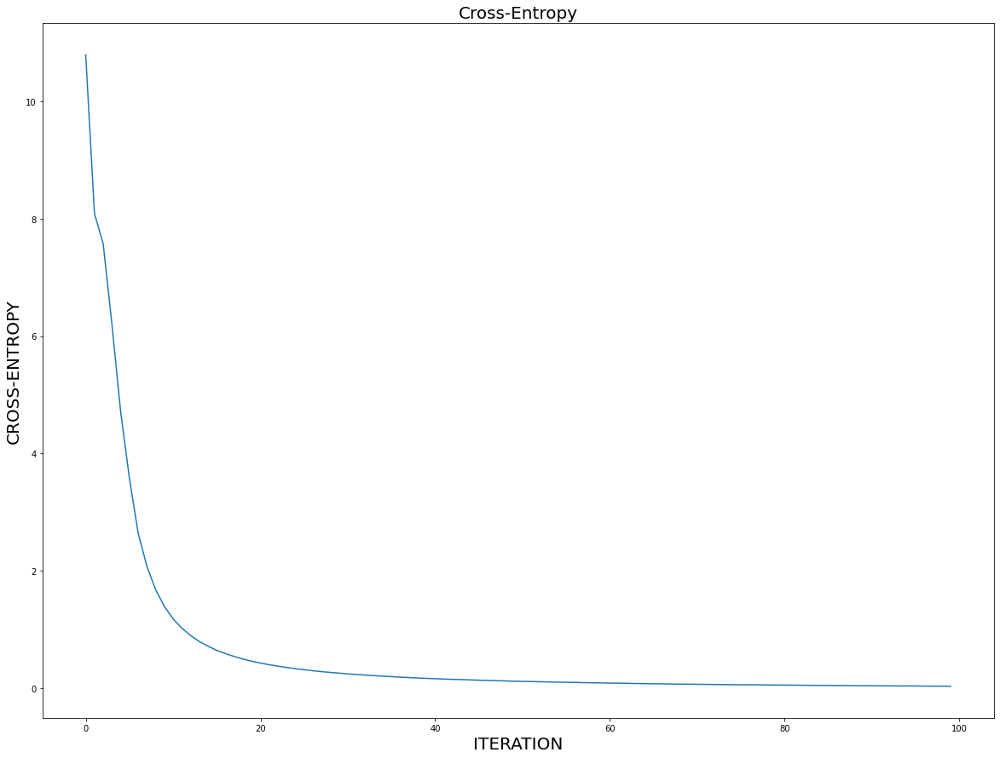

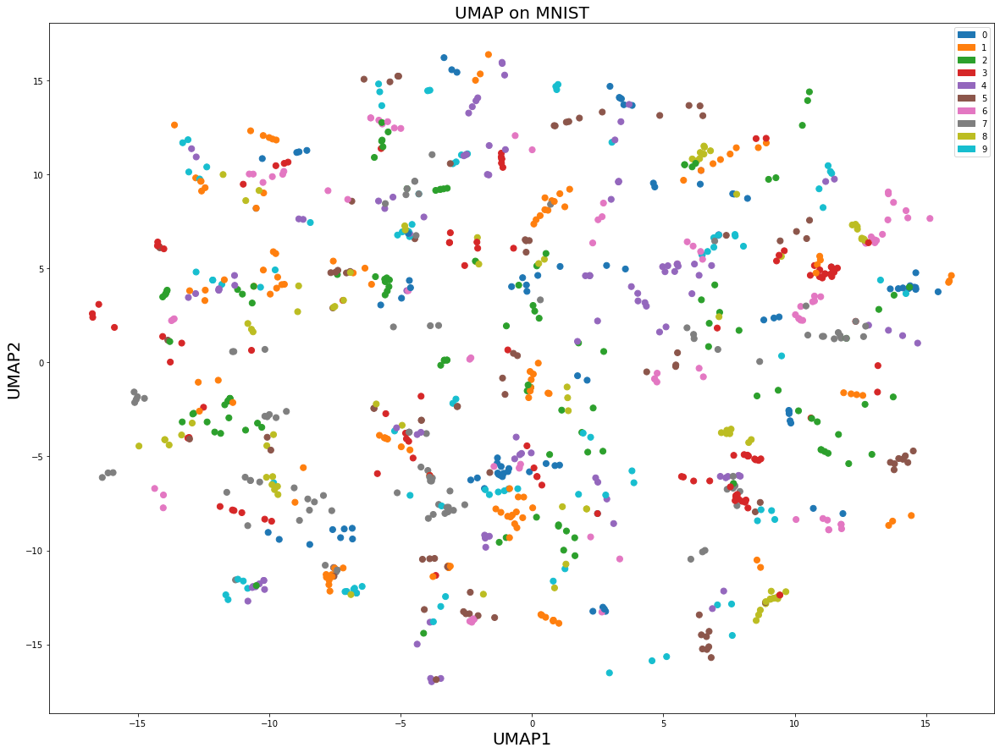


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 13.246205116316462 after 0 iterations
Cross-Entropy = 1.081721026451356 after 10 iterations
Cross-Entropy = 0.3967425953008483 after 20 iterations
Cross-Entropy = 0.2268236564221479 after 30 iterations
Cross-Entropy = 0.15060780305304514 after 40 iterations
Cross-Entropy = 0.10818444240820597 after 50 iterations
Cross-Entropy = 0.08118270145257332 after 60 iterations
Cross-Entropy = 0.06232961526226629 after 70 iterations
Cross-Entropy = 0.04901717080809598 after 80 iterations
Cross-Entropy = 0.03848822560737619 after 90 iterations


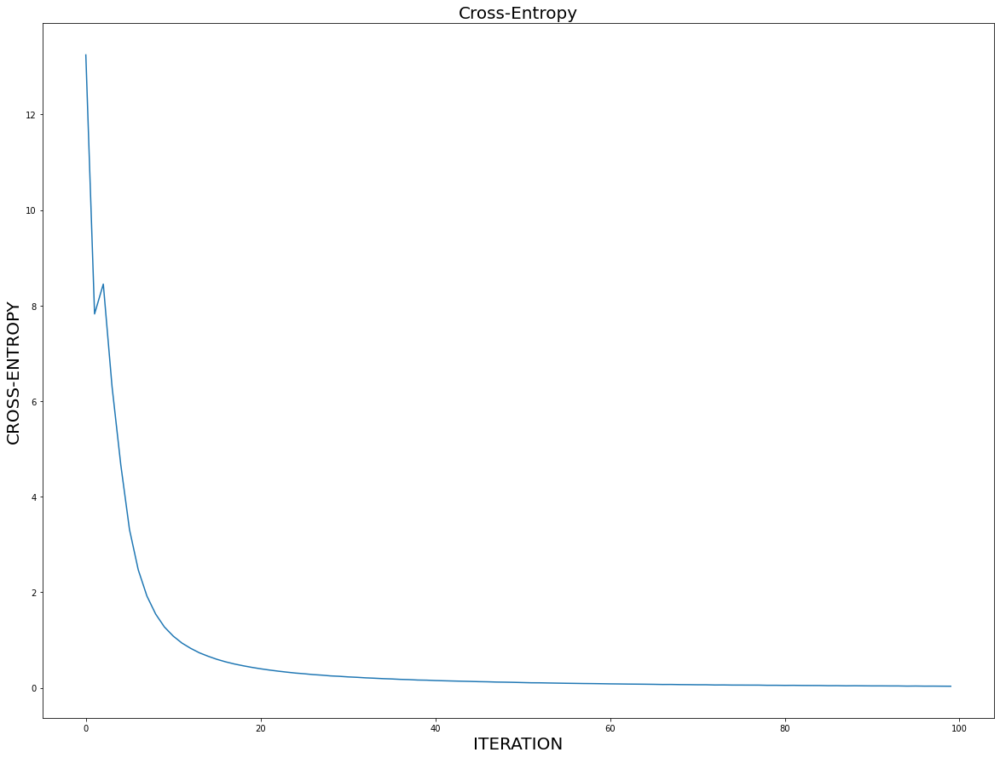

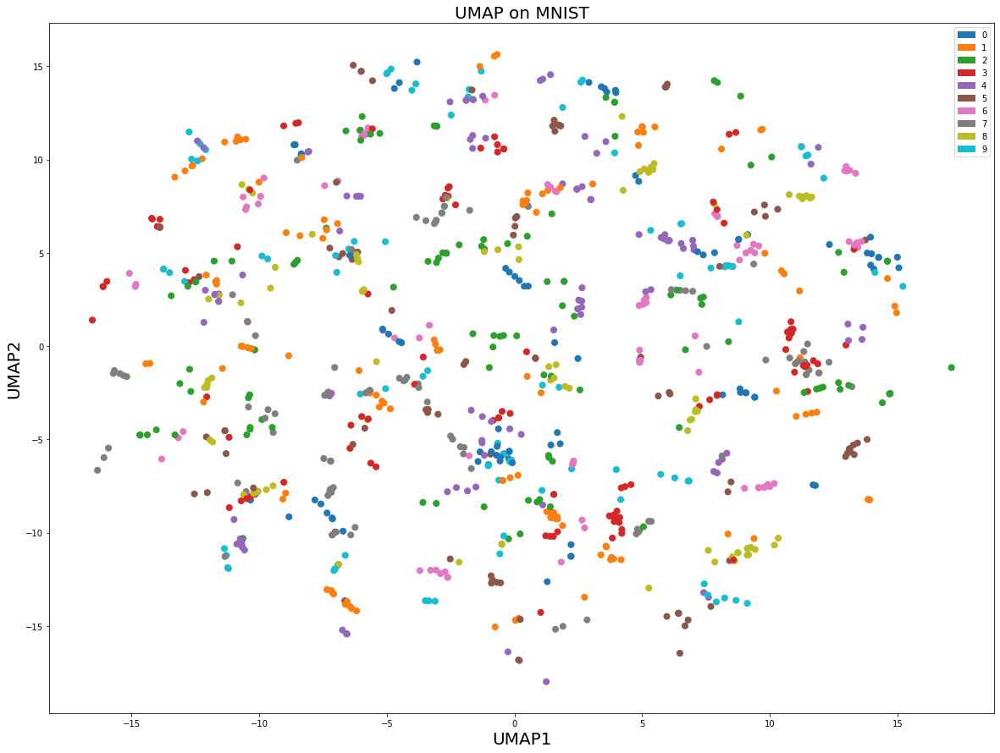


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 16.2070007049132 after 0 iterations
Cross-Entropy = 1.0062182284533276 after 10 iterations
Cross-Entropy = 0.37397150827554115 after 20 iterations
Cross-Entropy = 0.2171137347251025 after 30 iterations
Cross-Entropy = 0.14462697666818133 after 40 iterations
Cross-Entropy = 0.10376729793176274 after 50 iterations
Cross-Entropy = 0.07861646454959564 after 60 iterations
Cross-Entropy = 0.059937996805790435 after 70 iterations
Cross-Entropy = 0.04742033745743974 after 80 iterations
Cross-Entropy = 0.03720928892782297 after 90 iterations


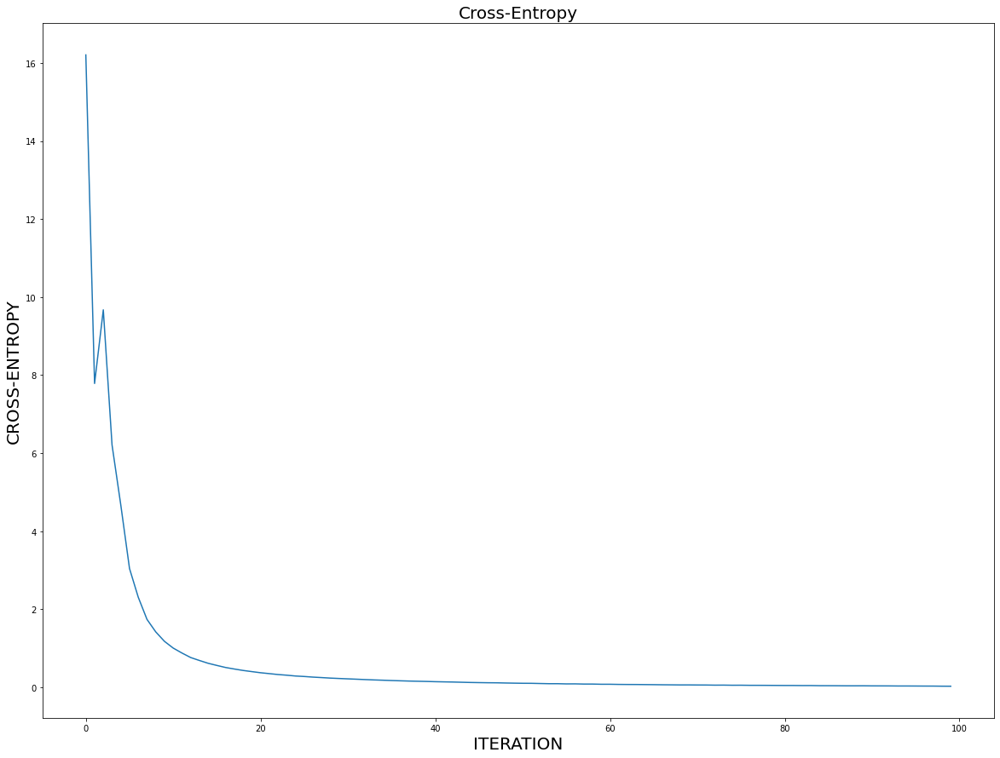

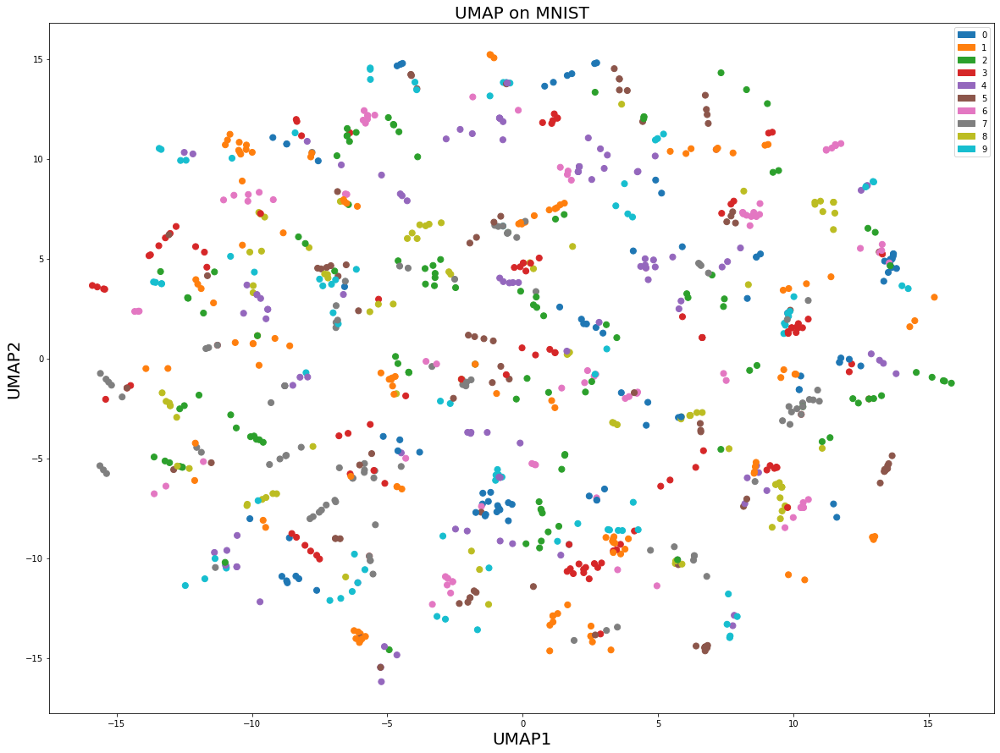


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 11.666596811015012 after 0 iterations
Cross-Entropy = 1.1487186259837119 after 10 iterations
Cross-Entropy = 0.4162601176600125 after 20 iterations
Cross-Entropy = 0.23470043788400716 after 30 iterations
Cross-Entropy = 0.15563655287207118 after 40 iterations
Cross-Entropy = 0.11103068420187542 after 50 iterations
Cross-Entropy = 0.0833862476112332 after 60 iterations
Cross-Entropy = 0.06527024247772961 after 70 iterations
Cross-Entropy = 0.05052967631842628 after 80 iterations
Cross-Entropy = 0.037053751544102134 after 90 iterations


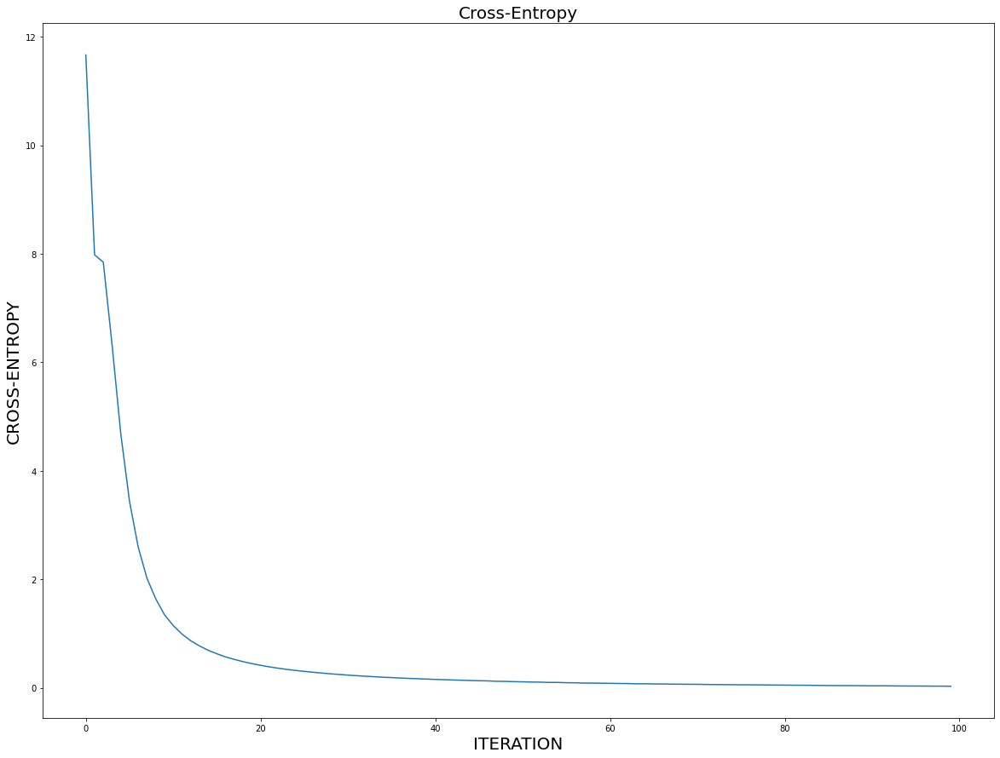

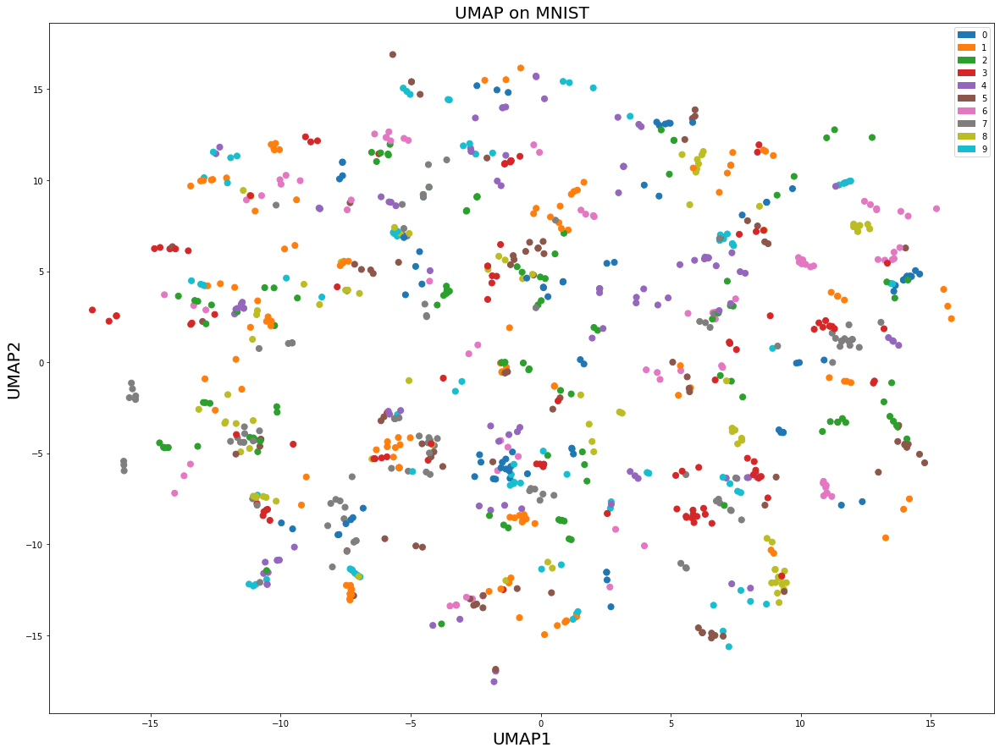


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 22.83305827520066 after 0 iterations
Cross-Entropy = 0.8654909909595419 after 10 iterations
Cross-Entropy = 0.34028777246377073 after 20 iterations
Cross-Entropy = 0.2007714137429869 after 30 iterations
Cross-Entropy = 0.13795263651478604 after 40 iterations
Cross-Entropy = 0.09707176641141826 after 50 iterations
Cross-Entropy = 0.07408467810081809 after 60 iterations
Cross-Entropy = 0.059014295693250035 after 70 iterations
Cross-Entropy = 0.048803885037594884 after 80 iterations
Cross-Entropy = 0.03849097849623384 after 90 iterations


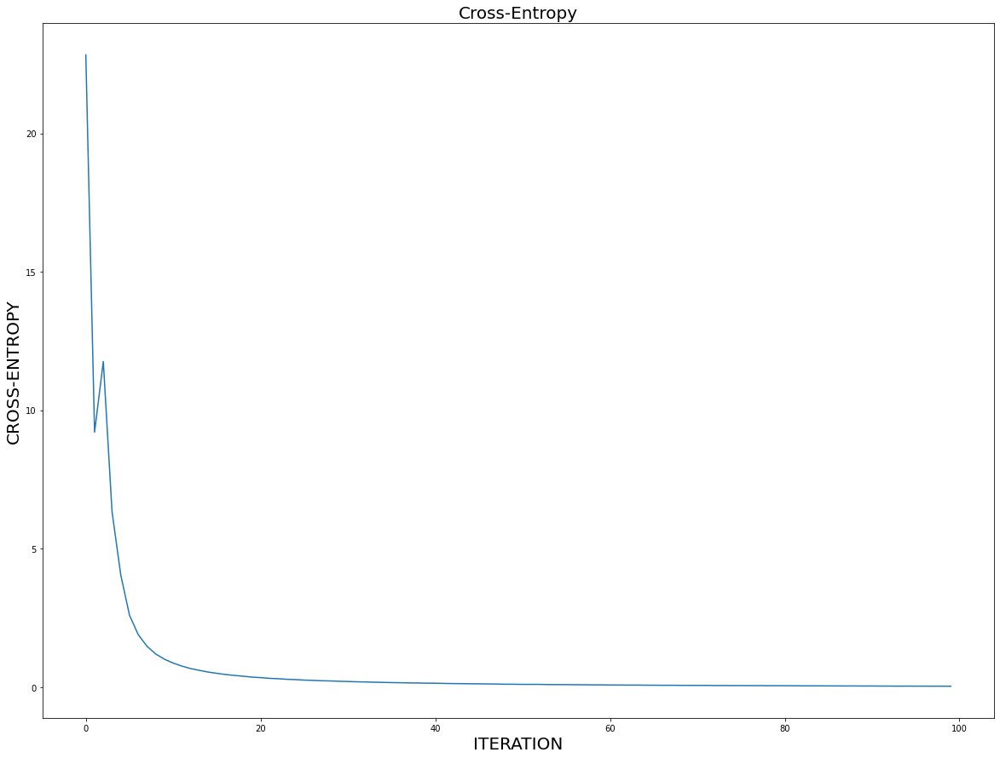

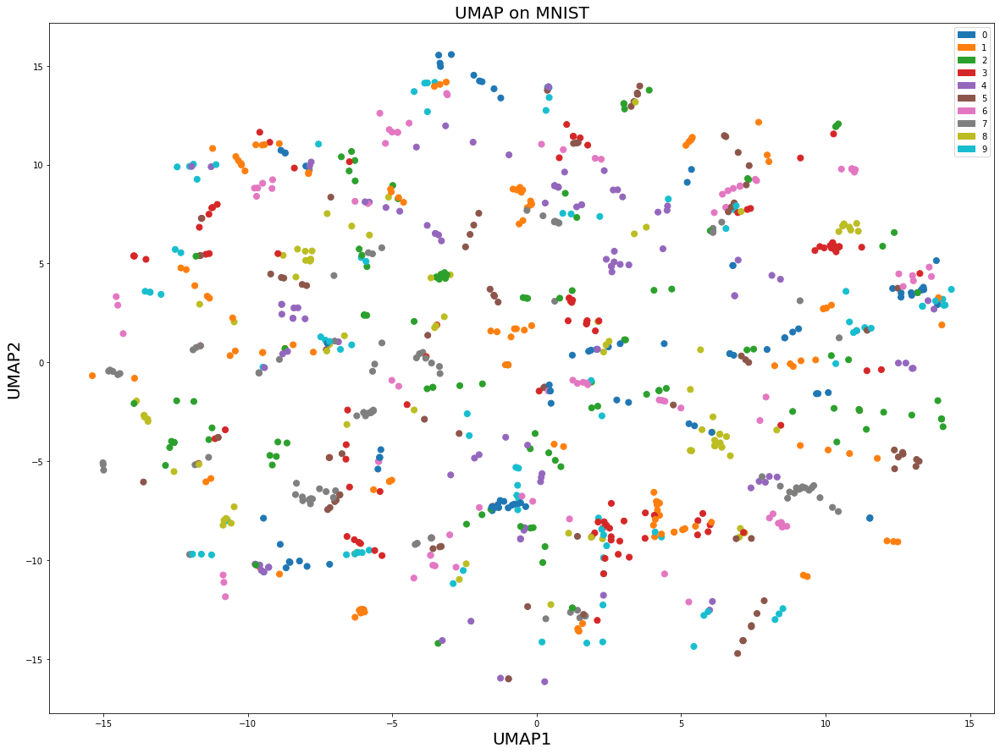


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 39.84890179050684 after 0 iterations
Cross-Entropy = 0.5967226407638434 after 10 iterations
Cross-Entropy = 0.2722265611275573 after 20 iterations
Cross-Entropy = 0.17483283065055838 after 30 iterations
Cross-Entropy = 0.12653848747309676 after 40 iterations
Cross-Entropy = 0.09972581771666986 after 50 iterations
Cross-Entropy = 0.0827277710059639 after 60 iterations
Cross-Entropy = 0.0716449979102382 after 70 iterations
Cross-Entropy = 0.06190035620299156 after 80 iterations
Cross-Entropy = 0.05442379046897544 after 90 iterations


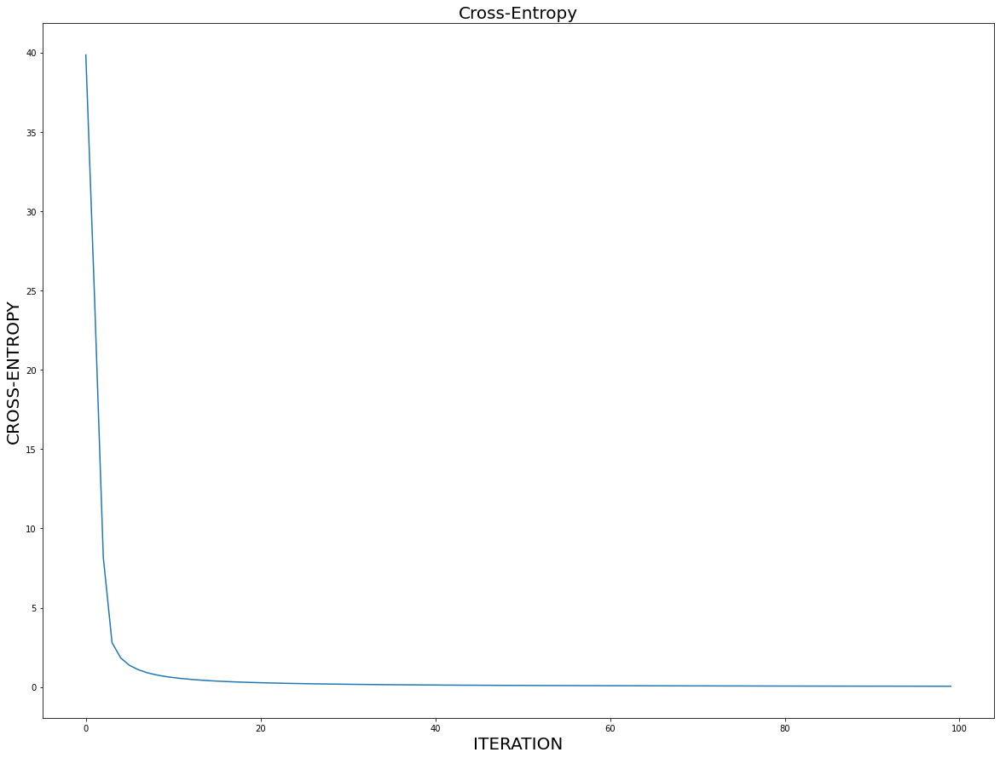

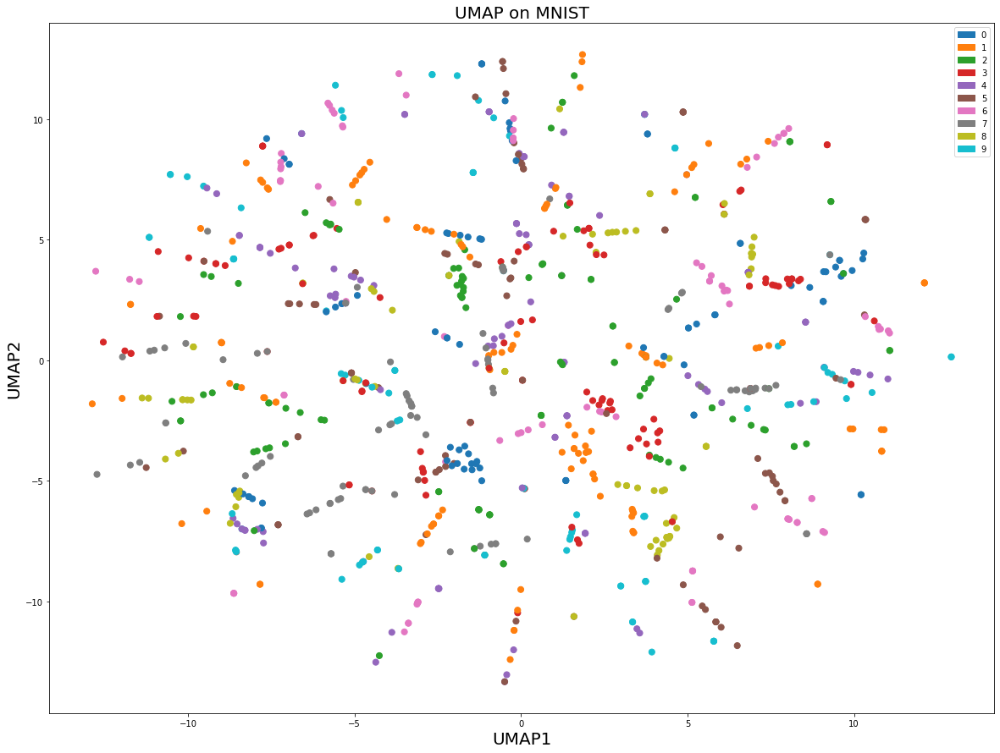


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 43.05196867625545 after 0 iterations
Cross-Entropy = 0.6927932635619813 after 10 iterations
Cross-Entropy = 0.34180166460217093 after 20 iterations
Cross-Entropy = 0.2120542473569869 after 30 iterations
Cross-Entropy = 0.14650835744680626 after 40 iterations
Cross-Entropy = 0.10725813473869353 after 50 iterations
Cross-Entropy = 0.08434009971401965 after 60 iterations
Cross-Entropy = 0.06900936737316934 after 70 iterations
Cross-Entropy = 0.05812401086498275 after 80 iterations
Cross-Entropy = 0.04972263635656801 after 90 iterations


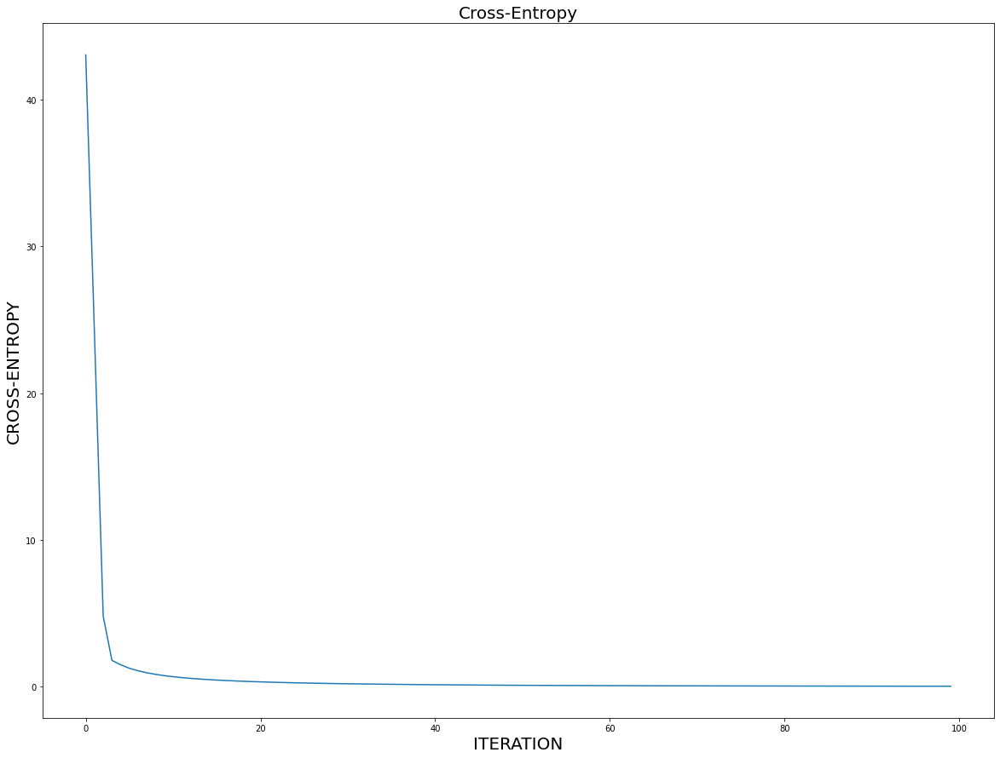

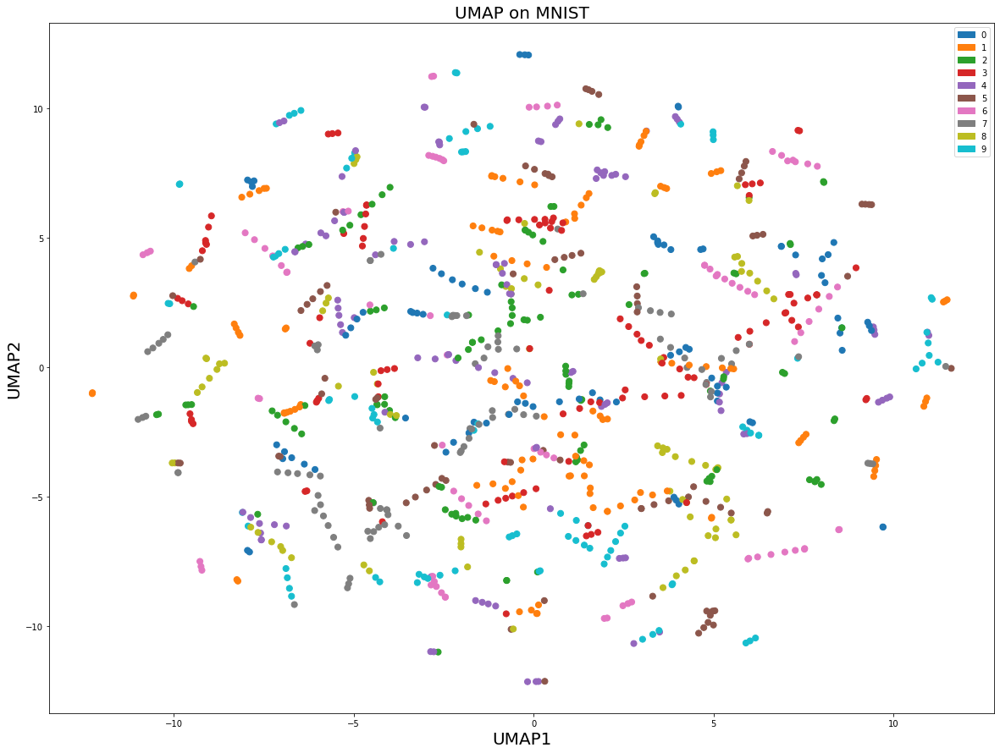


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 23.953232397026795 after 0 iterations
Cross-Entropy = 0.9316817782677289 after 10 iterations
Cross-Entropy = 0.3822004130958642 after 20 iterations
Cross-Entropy = 0.2267768451169011 after 30 iterations
Cross-Entropy = 0.15547910138156842 after 40 iterations
Cross-Entropy = 0.11132259500613069 after 50 iterations
Cross-Entropy = 0.08440233492200312 after 60 iterations
Cross-Entropy = 0.06540523675961098 after 70 iterations
Cross-Entropy = 0.05037140223484664 after 80 iterations
Cross-Entropy = 0.04251360975058643 after 90 iterations


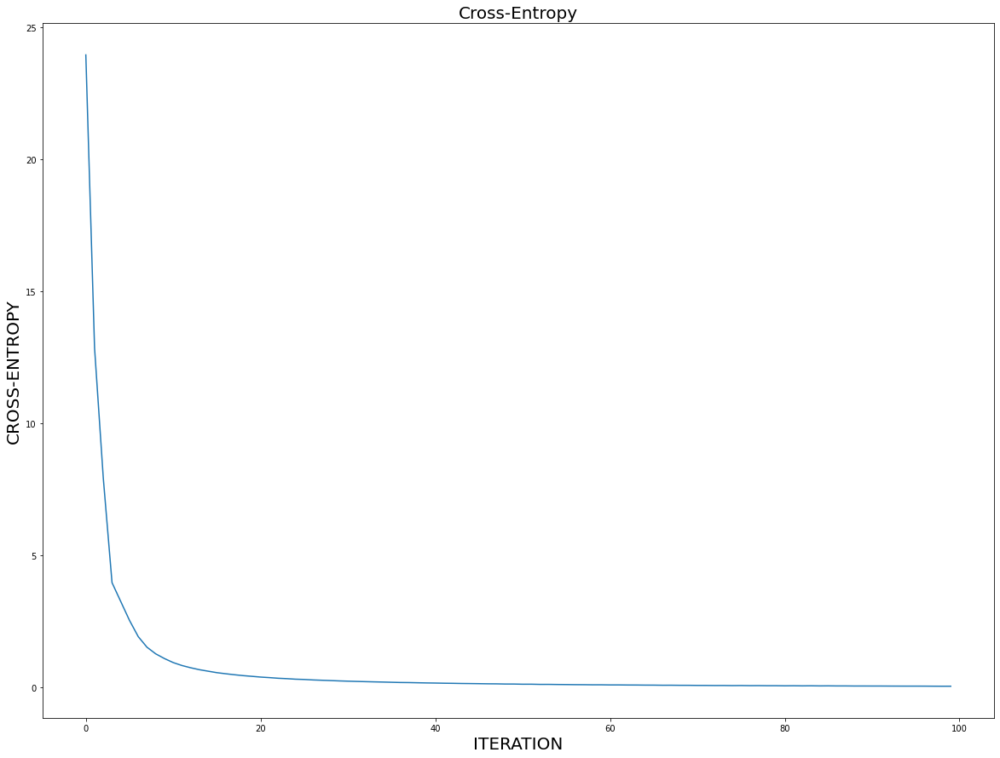

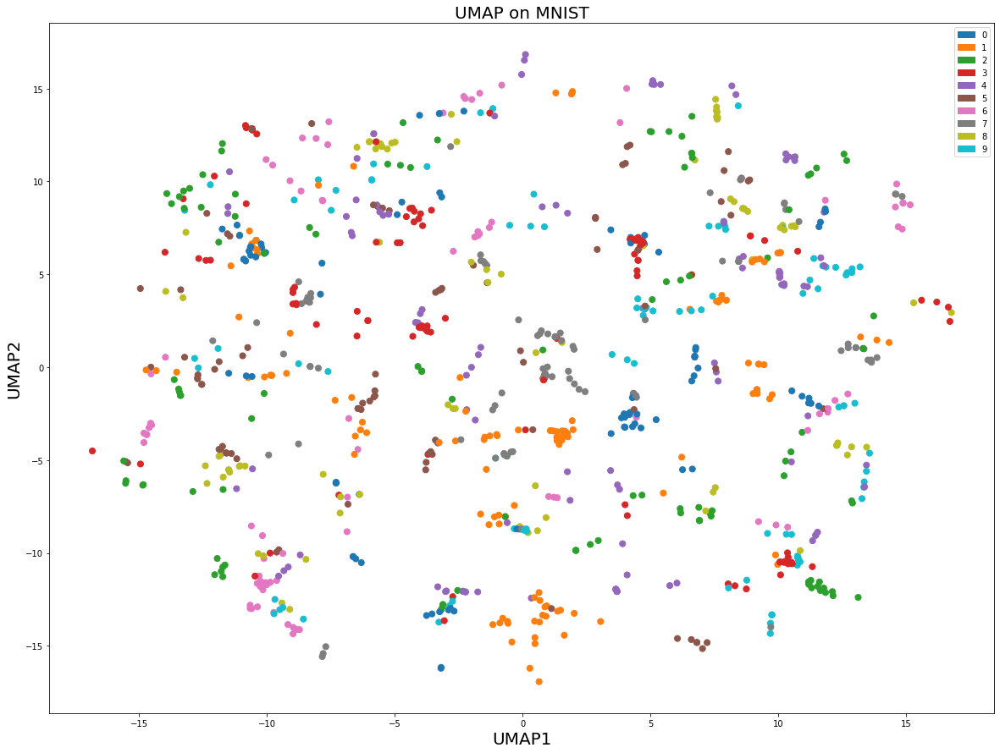


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 25.17537385564631 after 0 iterations
Cross-Entropy = 0.8690524076676299 after 10 iterations
Cross-Entropy = 0.3626543473243093 after 20 iterations
Cross-Entropy = 0.21621136608935004 after 30 iterations
Cross-Entropy = 0.14936550216019634 after 40 iterations
Cross-Entropy = 0.11107279420905108 after 50 iterations
Cross-Entropy = 0.08541824978440883 after 60 iterations
Cross-Entropy = 0.06833319791110351 after 70 iterations
Cross-Entropy = 0.05139007100815642 after 80 iterations
Cross-Entropy = 0.040917260074616546 after 90 iterations


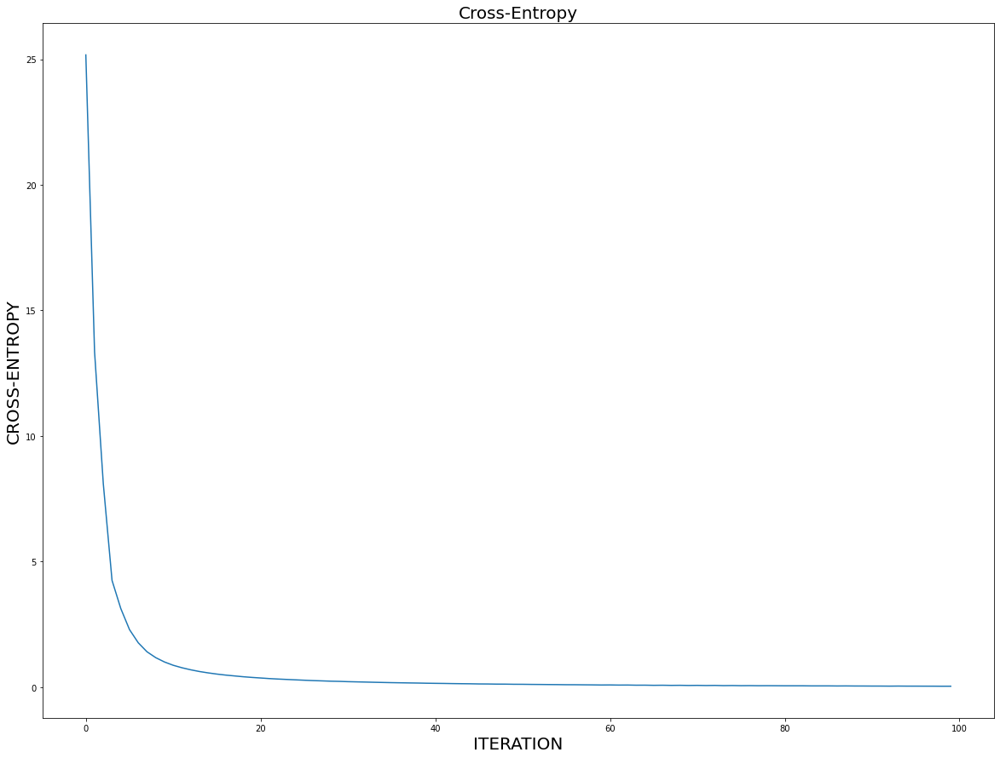

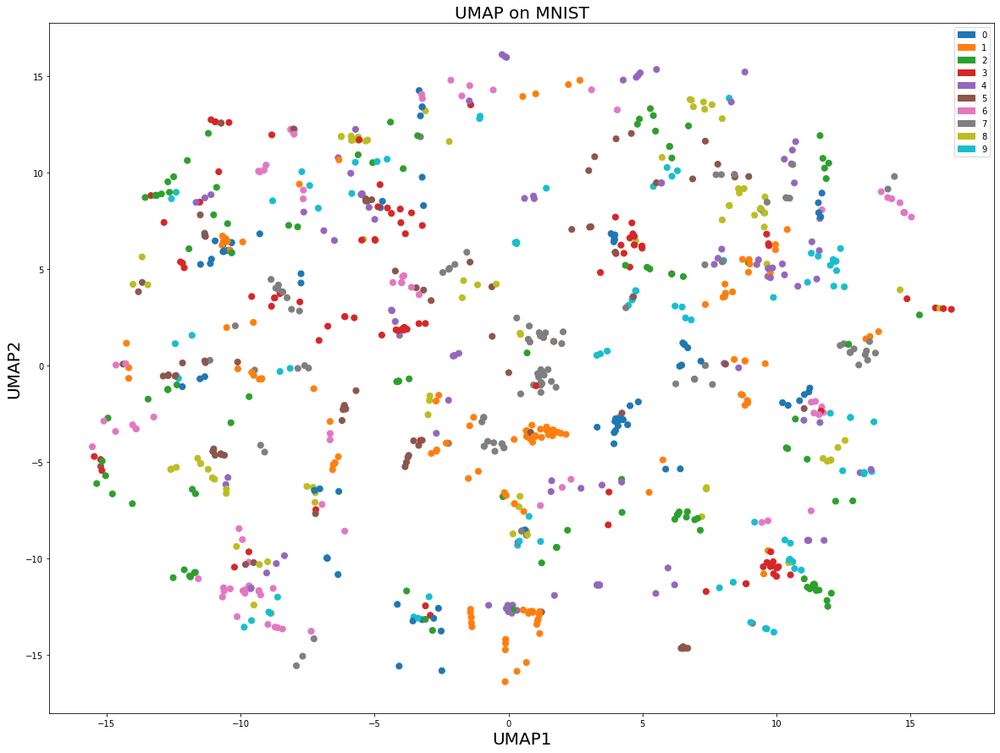


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 26.41634151047749 after 0 iterations
Cross-Entropy = 0.8186559253563578 after 10 iterations
Cross-Entropy = 0.34480171865404047 after 20 iterations
Cross-Entropy = 0.21113486539494464 after 30 iterations
Cross-Entropy = 0.14435103347783595 after 40 iterations
Cross-Entropy = 0.10561952085992894 after 50 iterations
Cross-Entropy = 0.08247394163475583 after 60 iterations
Cross-Entropy = 0.06500272950602105 after 70 iterations
Cross-Entropy = 0.0501622331317094 after 80 iterations
Cross-Entropy = 0.04195614710391109 after 90 iterations


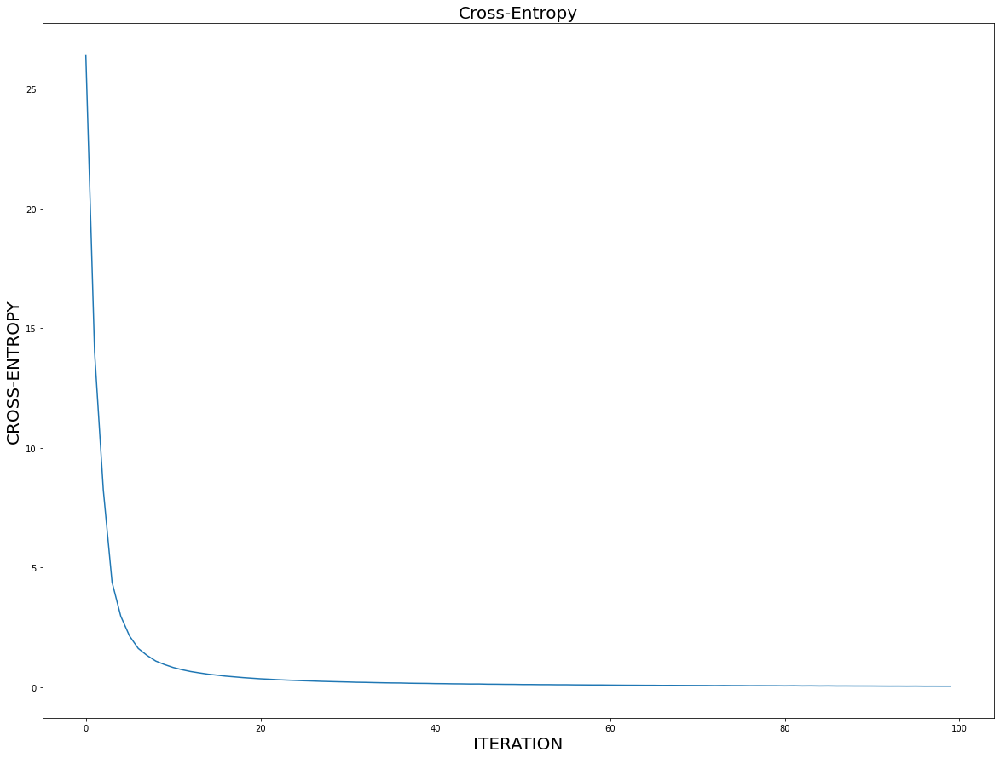

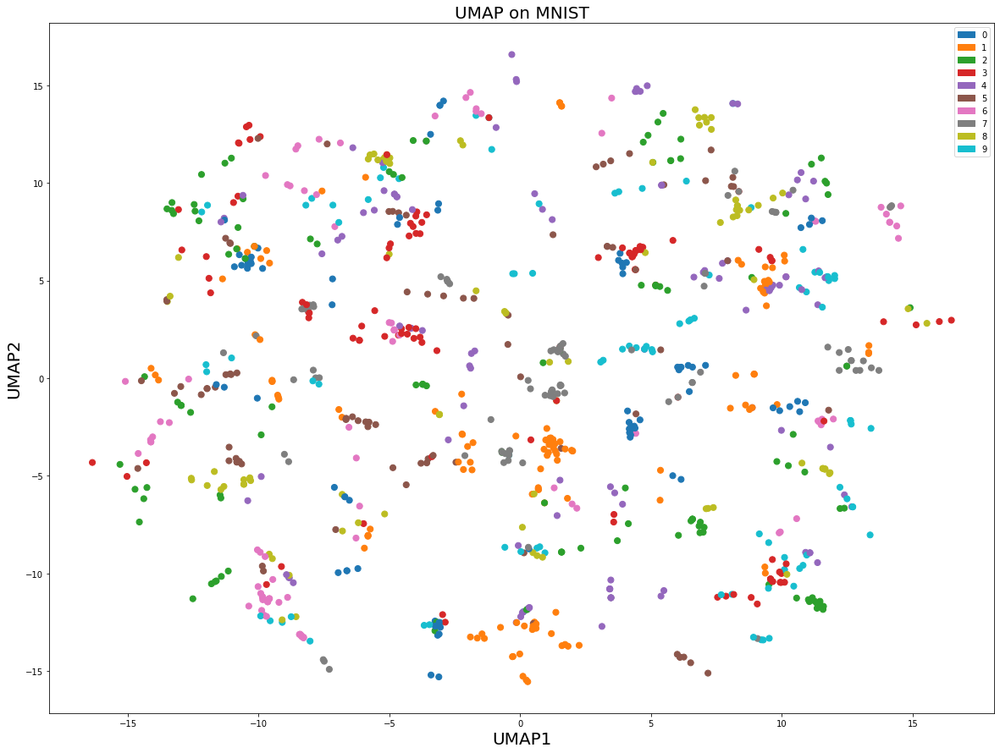


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 24.411612737353643 after 0 iterations
Cross-Entropy = 0.9107075250895531 after 10 iterations
Cross-Entropy = 0.3762121396043221 after 20 iterations
Cross-Entropy = 0.22429146362406635 after 30 iterations
Cross-Entropy = 0.15232671178787496 after 40 iterations
Cross-Entropy = 0.11165371186469447 after 50 iterations
Cross-Entropy = 0.0849279929585086 after 60 iterations
Cross-Entropy = 0.06554605829202381 after 70 iterations
Cross-Entropy = 0.053489989801785424 after 80 iterations
Cross-Entropy = 0.03919689592792754 after 90 iterations


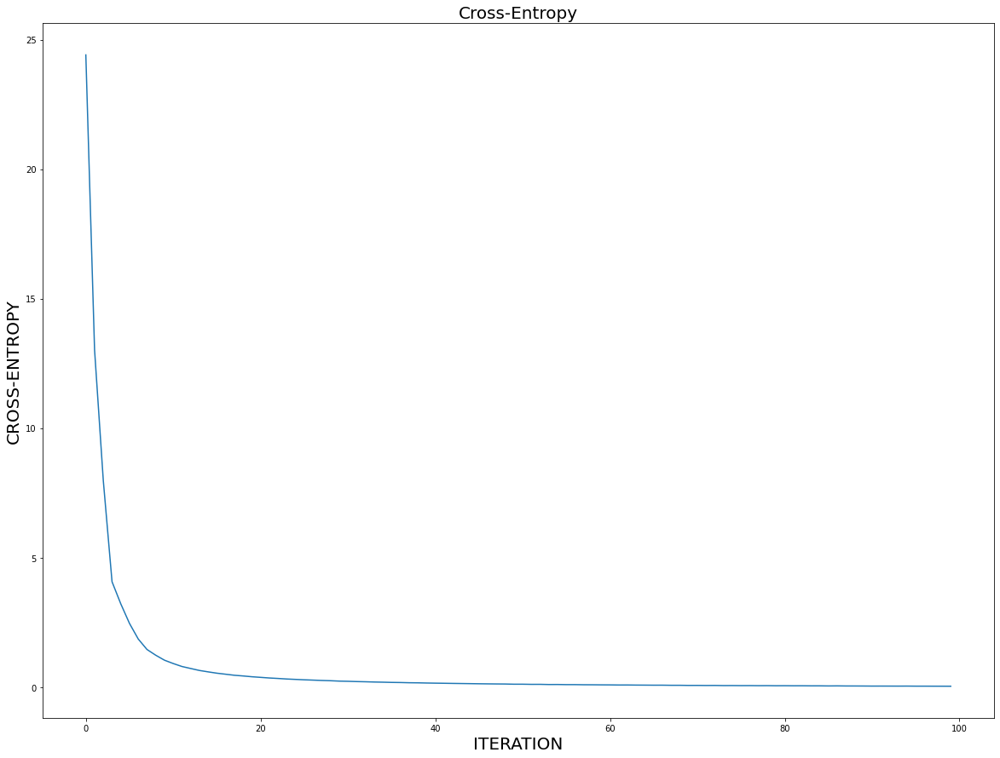

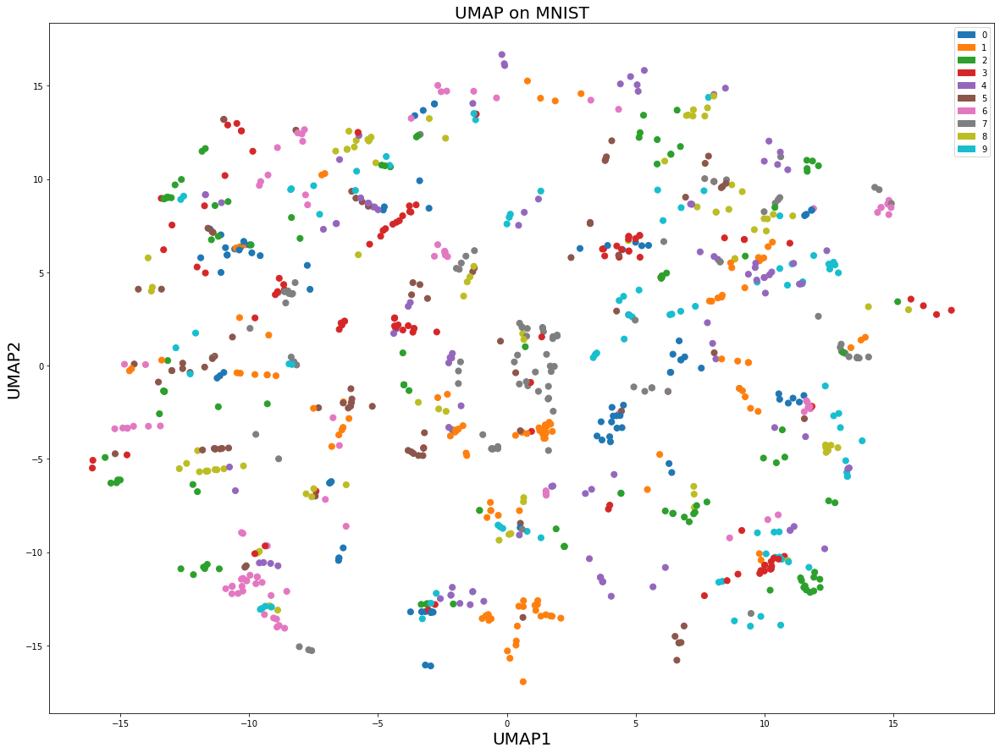


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 28.57183650414114 after 0 iterations
Cross-Entropy = 0.7387840907146068 after 10 iterations
Cross-Entropy = 0.3206205012540662 after 20 iterations
Cross-Entropy = 0.1964323769277885 after 30 iterations
Cross-Entropy = 0.1378067438163167 after 40 iterations
Cross-Entropy = 0.10028808034094372 after 50 iterations
Cross-Entropy = 0.07836606670539135 after 60 iterations
Cross-Entropy = 0.06663514826893756 after 70 iterations
Cross-Entropy = 0.05240570100634066 after 80 iterations
Cross-Entropy = 0.041074192270083194 after 90 iterations


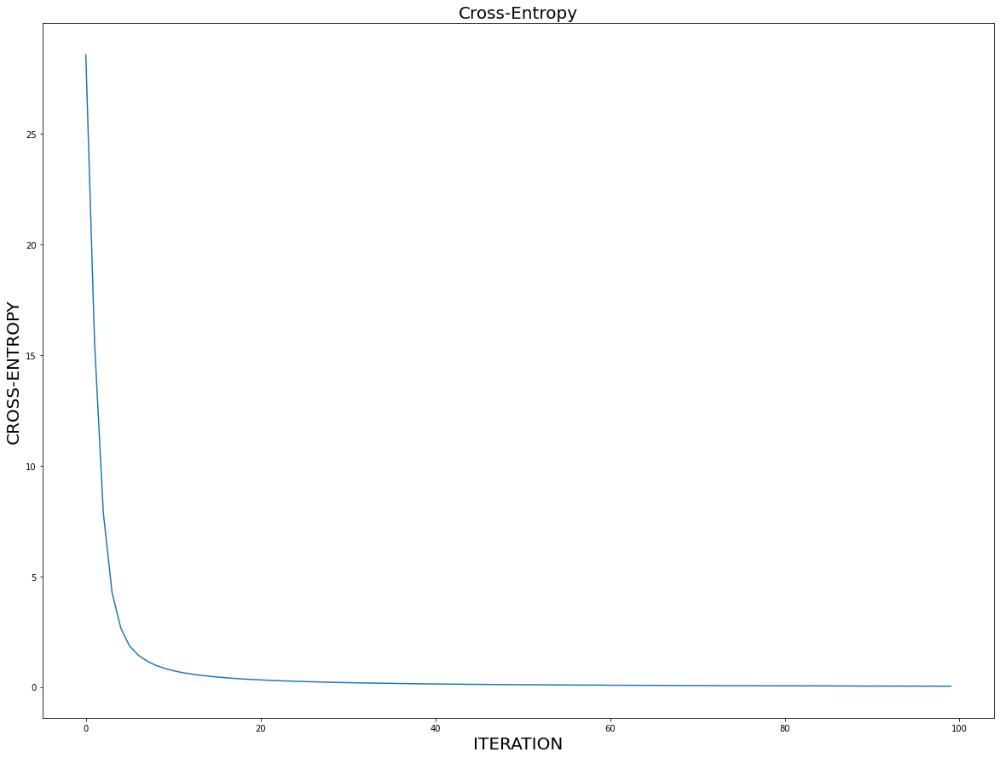

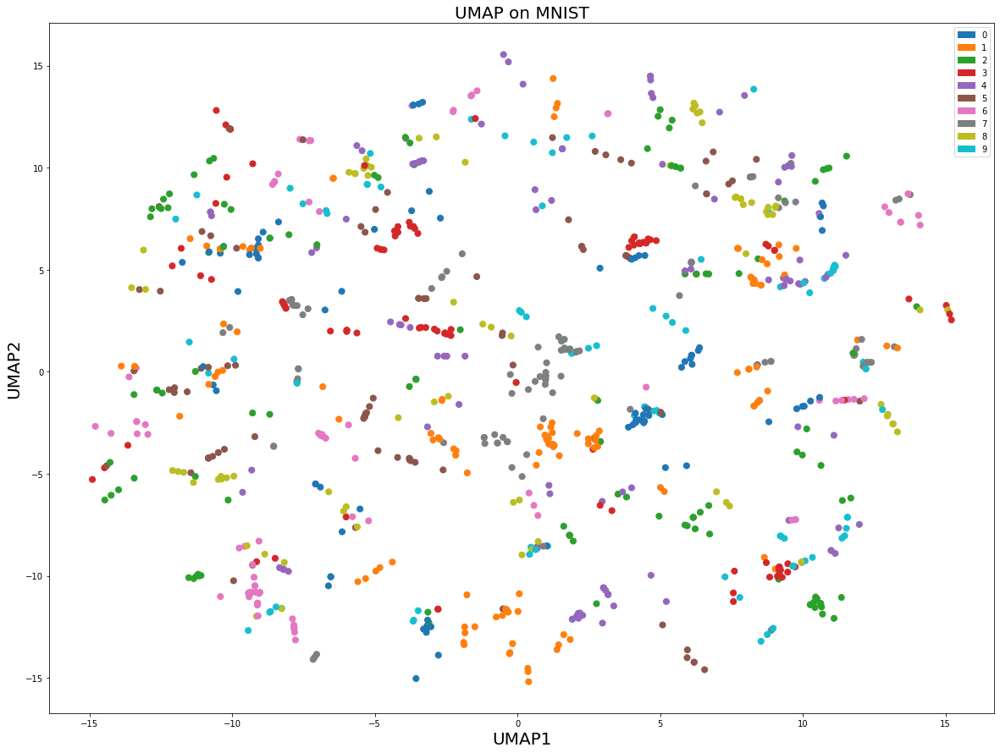


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 37.942861257688094 after 0 iterations
Cross-Entropy = 0.5790109744118426 after 10 iterations
Cross-Entropy = 0.3125506493456257 after 20 iterations
Cross-Entropy = 0.2299892627189214 after 30 iterations
Cross-Entropy = 0.18852719385354136 after 40 iterations
Cross-Entropy = 0.16426943091358978 after 50 iterations
Cross-Entropy = 0.14809569075805878 after 60 iterations
Cross-Entropy = 0.13544029607660113 after 70 iterations
Cross-Entropy = 0.12591893737905124 after 80 iterations
Cross-Entropy = 0.11740837517341957 after 90 iterations


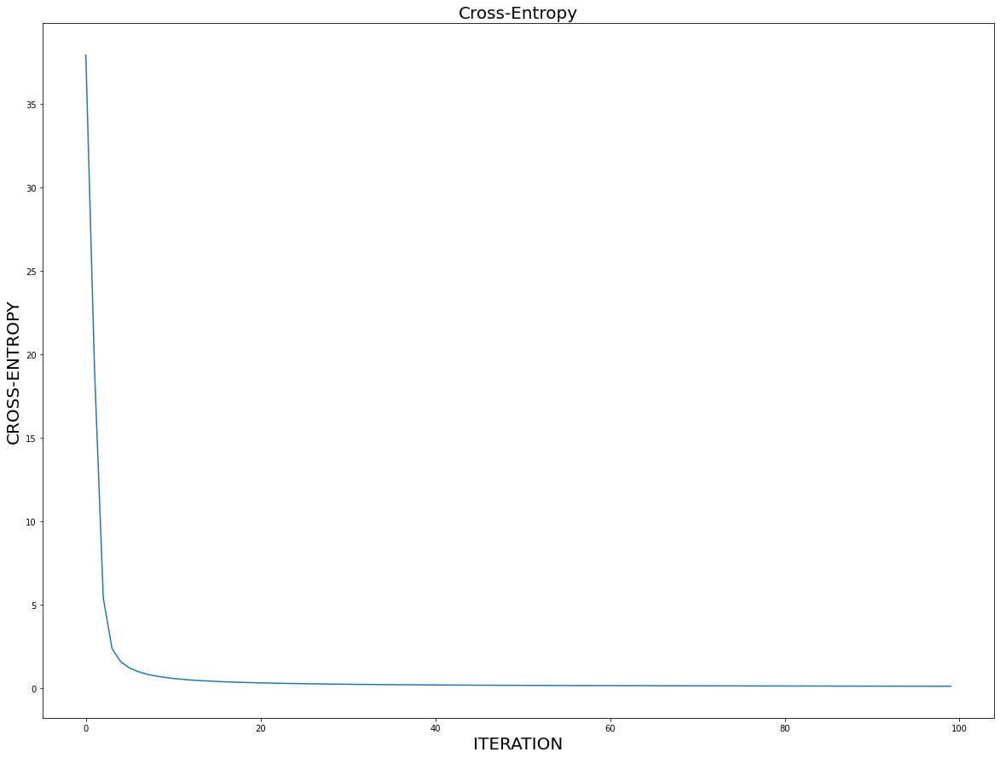

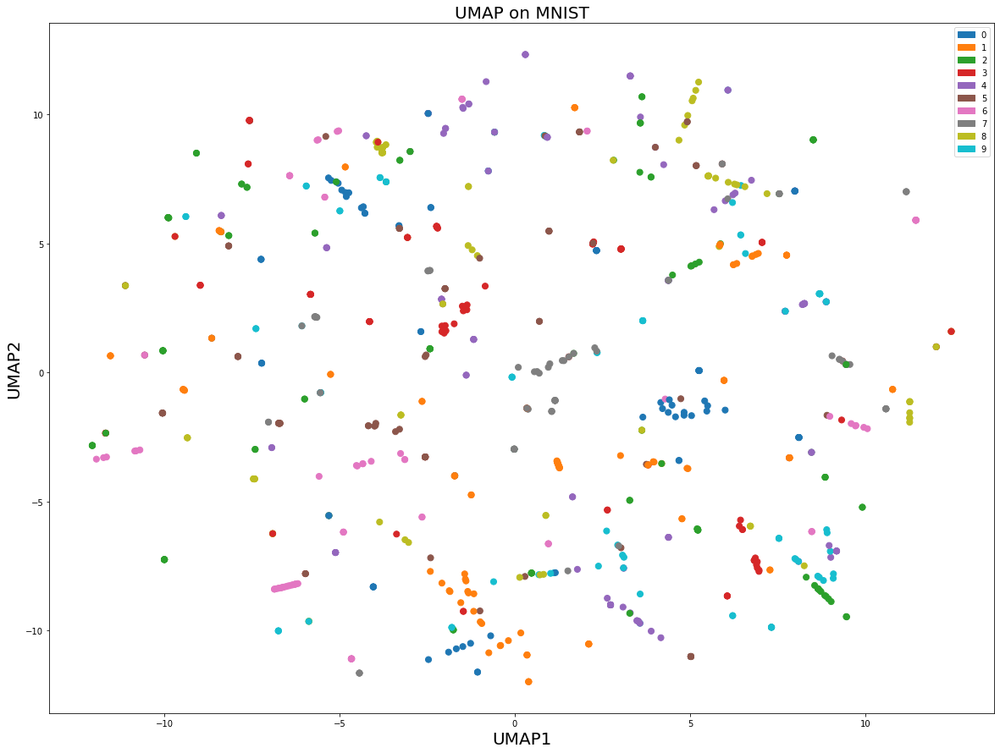


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 42.94540339811976 after 0 iterations
Cross-Entropy = 0.5465704765369613 after 10 iterations
Cross-Entropy = 0.3182773580575897 after 20 iterations
Cross-Entropy = 0.2384995891239994 after 30 iterations
Cross-Entropy = 0.19719233197097744 after 40 iterations
Cross-Entropy = 0.17118970331697264 after 50 iterations
Cross-Entropy = 0.1531658714971965 after 60 iterations
Cross-Entropy = 0.13962712150262954 after 70 iterations
Cross-Entropy = 0.12936075756121335 after 80 iterations
Cross-Entropy = 0.12053901167559455 after 90 iterations


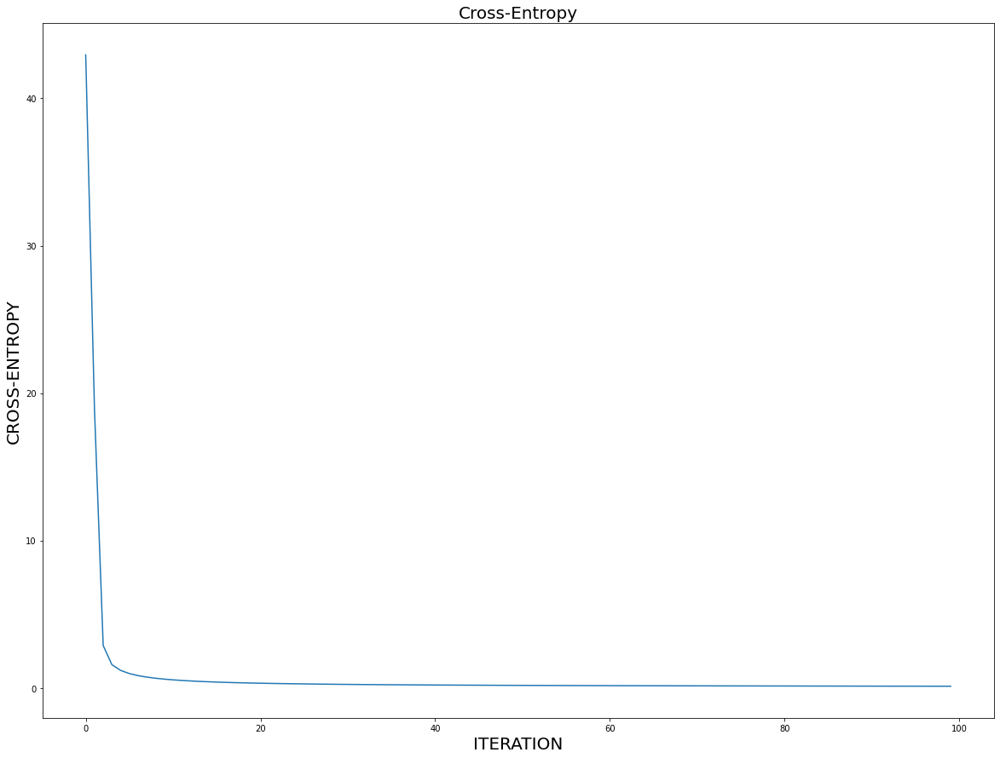

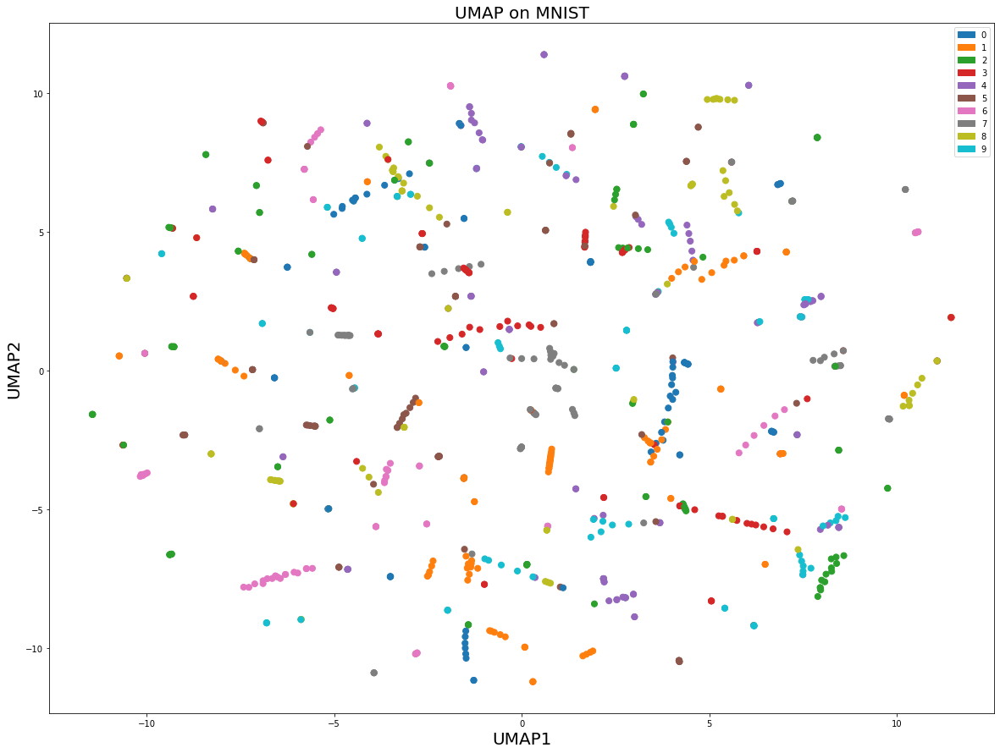


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 30.07293330445617 after 0 iterations
Cross-Entropy = 1.782946092621284 after 10 iterations
Cross-Entropy = 0.7366824190883865 after 20 iterations
Cross-Entropy = 0.4411773908529683 after 30 iterations
Cross-Entropy = 0.30891249924547465 after 40 iterations
Cross-Entropy = 0.2274527747213986 after 50 iterations
Cross-Entropy = 0.17828764922358856 after 60 iterations
Cross-Entropy = 0.14305103968716054 after 70 iterations
Cross-Entropy = 0.12030933557812468 after 80 iterations
Cross-Entropy = 0.09870627253020096 after 90 iterations


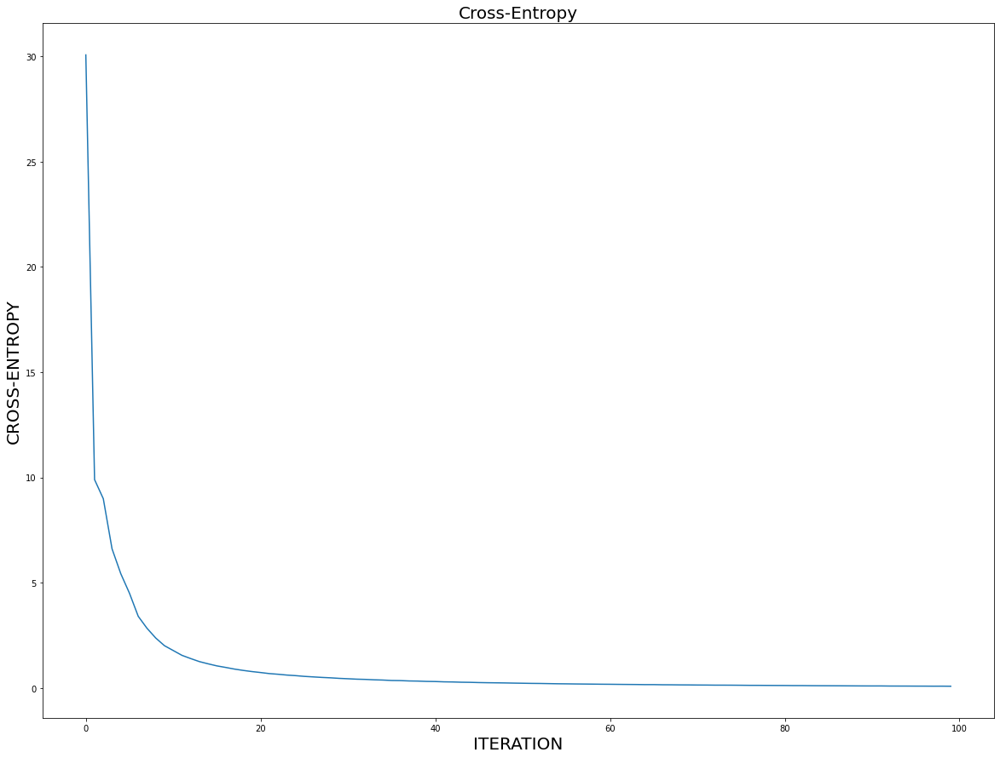

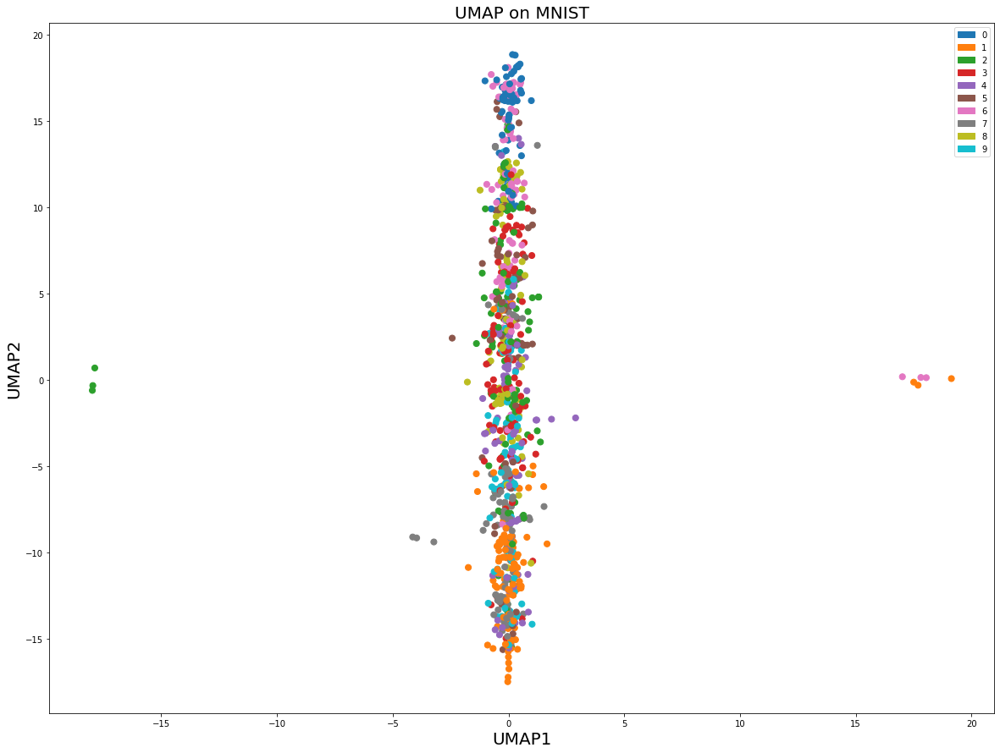


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 31.748043689327123 after 0 iterations
Cross-Entropy = 1.7147239842165387 after 10 iterations
Cross-Entropy = 0.7237976704646751 after 20 iterations
Cross-Entropy = 0.44743681457684725 after 30 iterations
Cross-Entropy = 0.3102830125019419 after 40 iterations
Cross-Entropy = 0.23622272699445138 after 50 iterations
Cross-Entropy = 0.185549823635004 after 60 iterations
Cross-Entropy = 0.1524233579616966 after 70 iterations
Cross-Entropy = 0.12345172352494337 after 80 iterations
Cross-Entropy = 0.10743126894304361 after 90 iterations


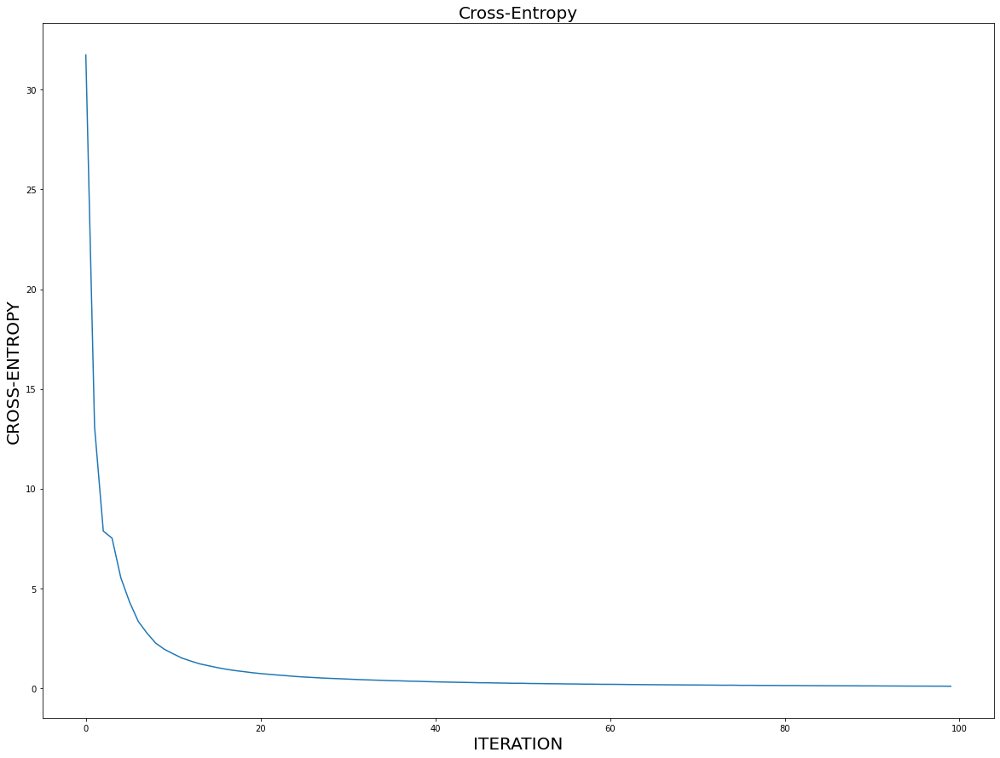

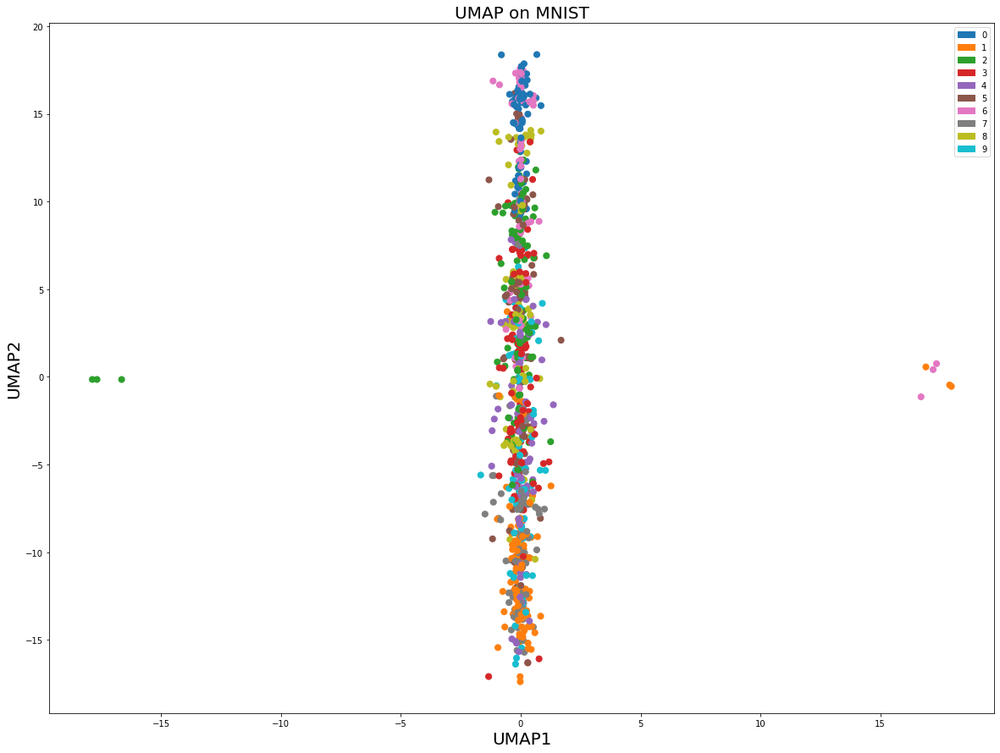


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 33.06234964362226 after 0 iterations
Cross-Entropy = 1.627939121838472 after 10 iterations
Cross-Entropy = 0.7254930333298021 after 20 iterations
Cross-Entropy = 0.44746675442676503 after 30 iterations
Cross-Entropy = 0.31559459313710225 after 40 iterations
Cross-Entropy = 0.23748524647516925 after 50 iterations
Cross-Entropy = 0.18942196832482944 after 60 iterations
Cross-Entropy = 0.15401979174496713 after 70 iterations
Cross-Entropy = 0.1299059552016664 after 80 iterations
Cross-Entropy = 0.10798965805758065 after 90 iterations


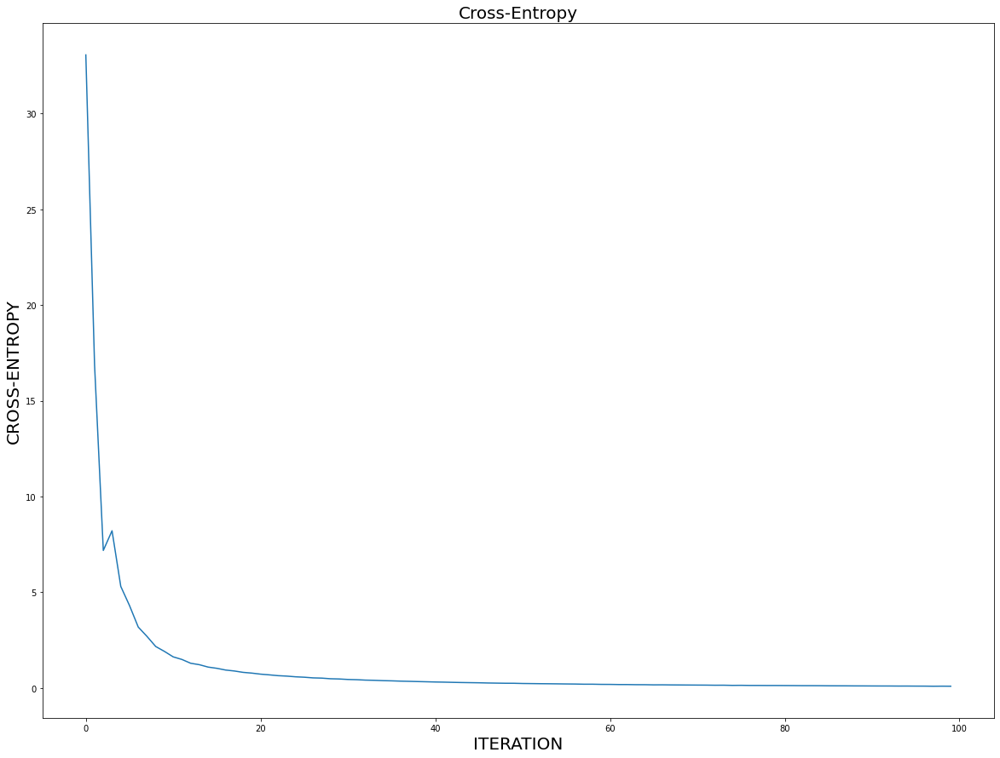

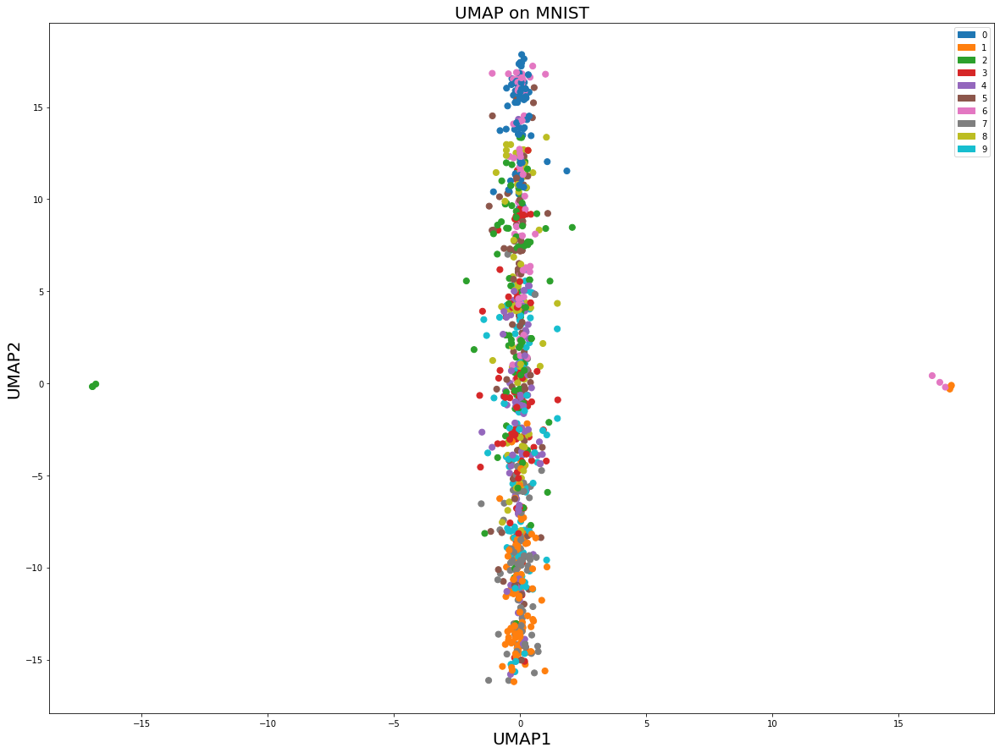


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 30.75551228169391 after 0 iterations
Cross-Entropy = 1.7405026804699437 after 10 iterations
Cross-Entropy = 0.720086535697441 after 20 iterations
Cross-Entropy = 0.4386400212691164 after 30 iterations
Cross-Entropy = 0.3035446570796392 after 40 iterations
Cross-Entropy = 0.2289615015069783 after 50 iterations
Cross-Entropy = 0.17970908808829236 after 60 iterations
Cross-Entropy = 0.14501666012033446 after 70 iterations
Cross-Entropy = 0.11897859203665993 after 80 iterations
Cross-Entropy = 0.10237287590069574 after 90 iterations


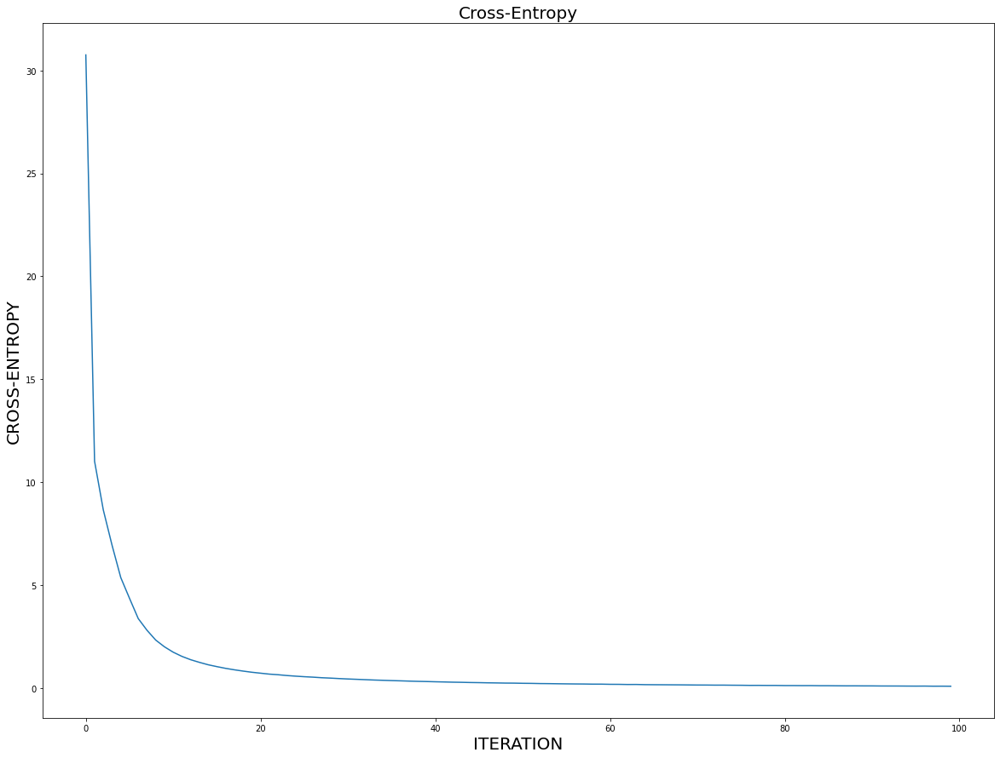

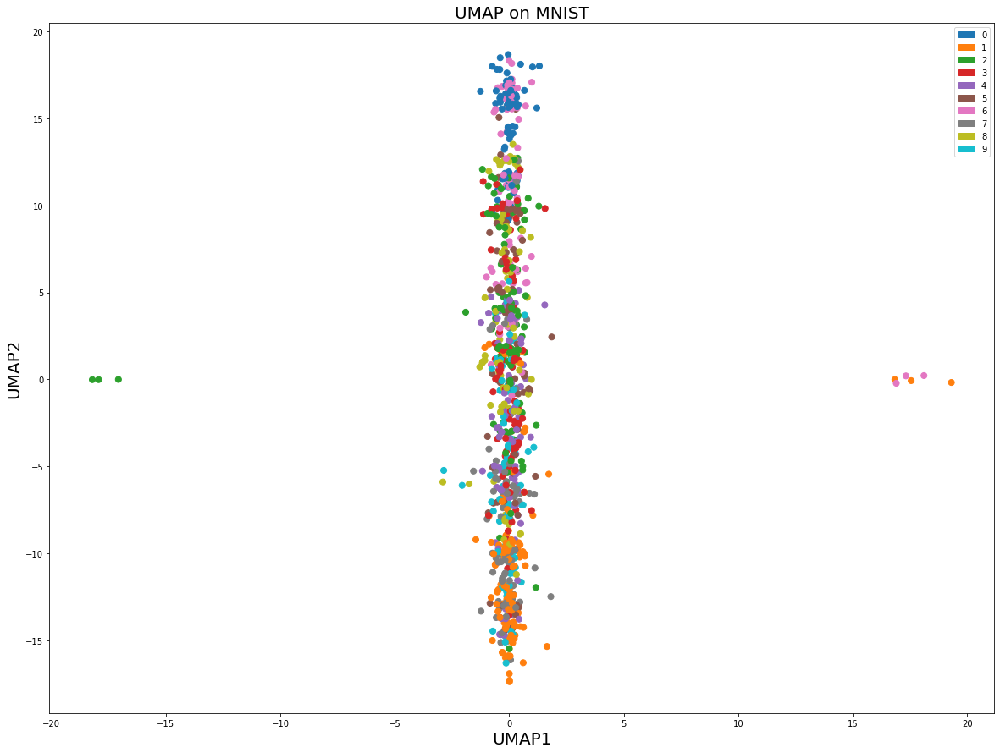


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 34.86632495547865 after 0 iterations
Cross-Entropy = 1.5341665307697643 after 10 iterations
Cross-Entropy = 0.7038758900252602 after 20 iterations
Cross-Entropy = 0.44835137637841266 after 30 iterations
Cross-Entropy = 0.3240594153543711 after 40 iterations
Cross-Entropy = 0.24092480908241246 after 50 iterations
Cross-Entropy = 0.18960445970717296 after 60 iterations
Cross-Entropy = 0.15995464808048407 after 70 iterations
Cross-Entropy = 0.13481676450578037 after 80 iterations
Cross-Entropy = 0.1146534879172872 after 90 iterations


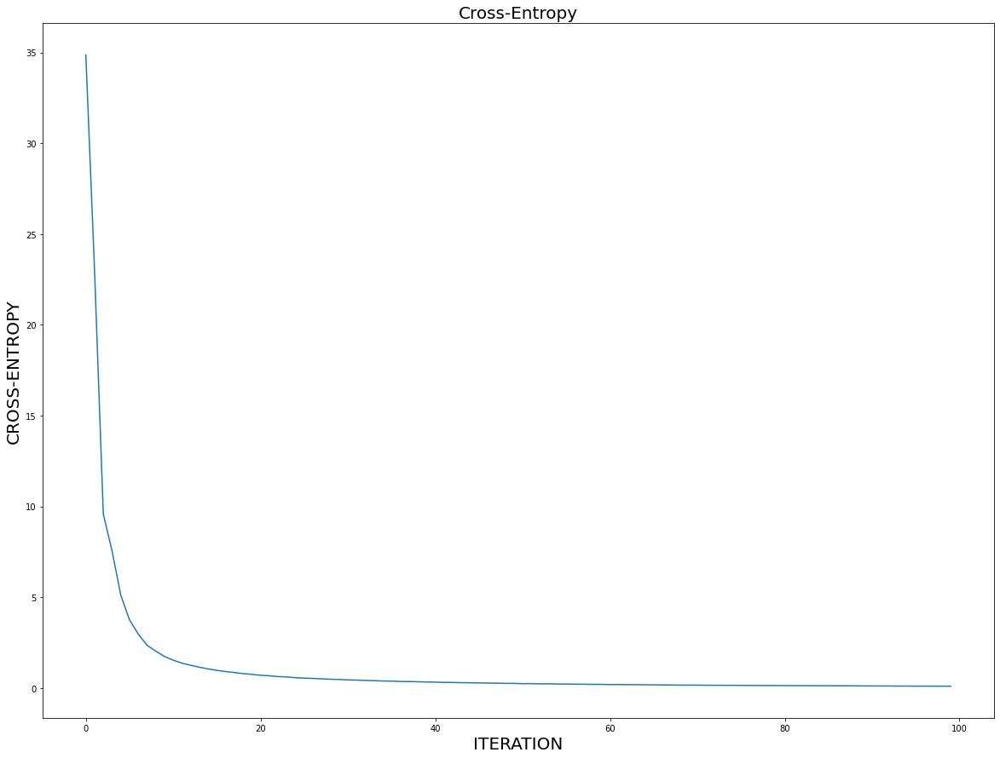

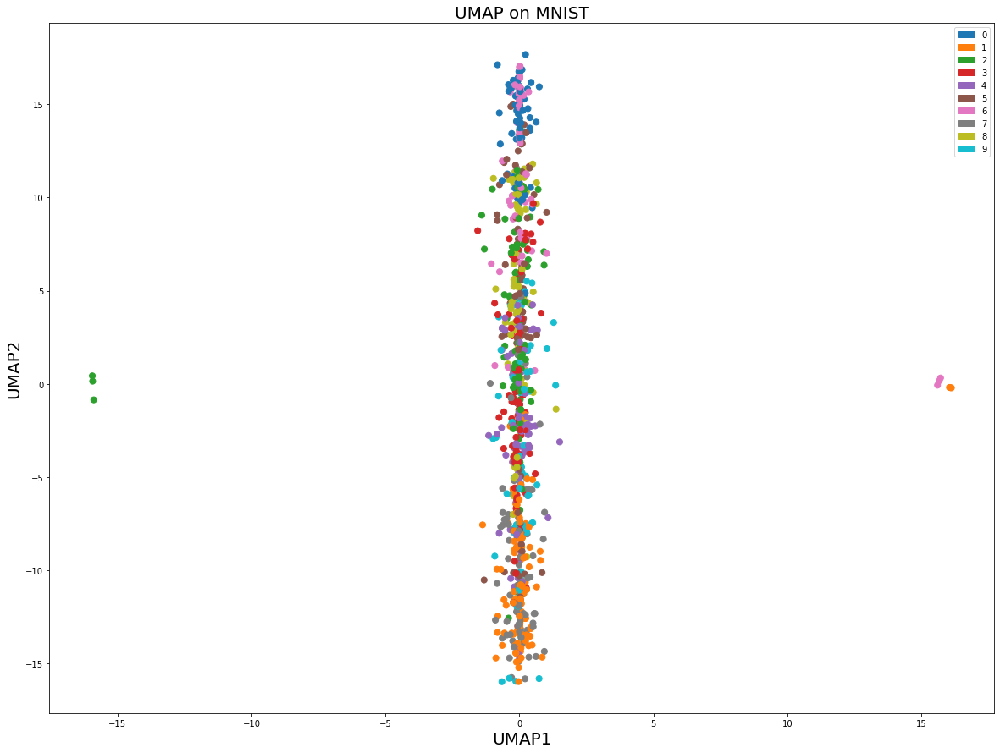


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 41.864167103845574 after 0 iterations
Cross-Entropy = 1.7280614225684718 after 10 iterations
Cross-Entropy = 0.8473910480487546 after 20 iterations
Cross-Entropy = 0.5641155507415354 after 30 iterations
Cross-Entropy = 0.42875423972503945 after 40 iterations
Cross-Entropy = 0.34789663733141796 after 50 iterations
Cross-Entropy = 0.2967346728679708 after 60 iterations
Cross-Entropy = 0.2619920440564428 after 70 iterations
Cross-Entropy = 0.23402557424434559 after 80 iterations
Cross-Entropy = 0.21204620266660323 after 90 iterations


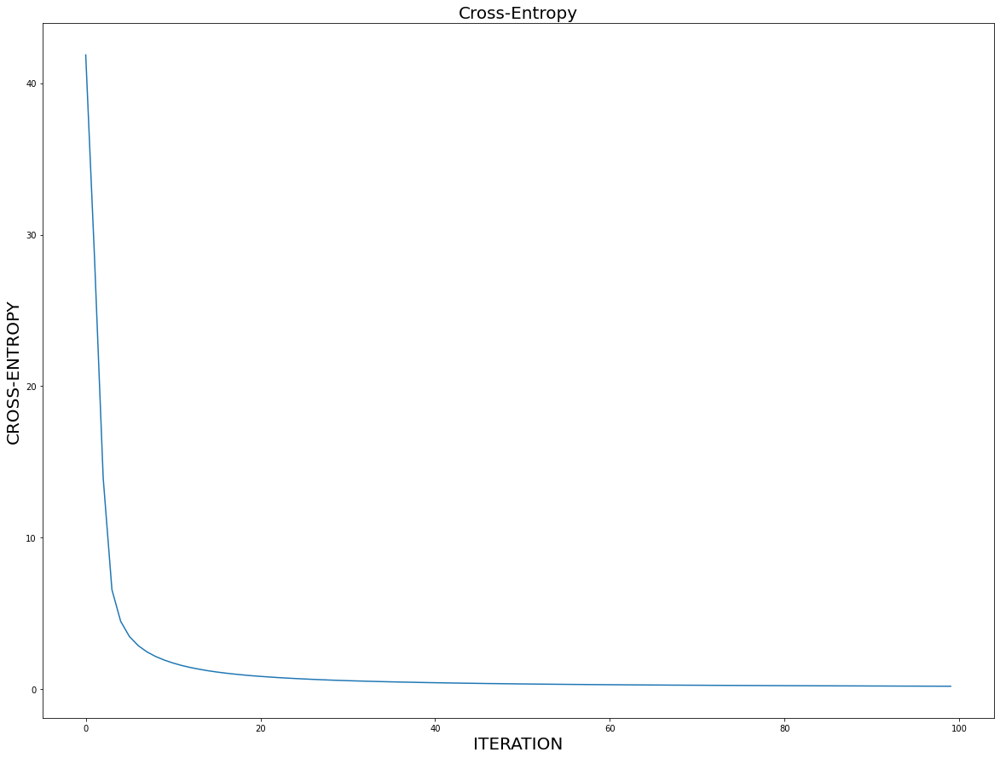

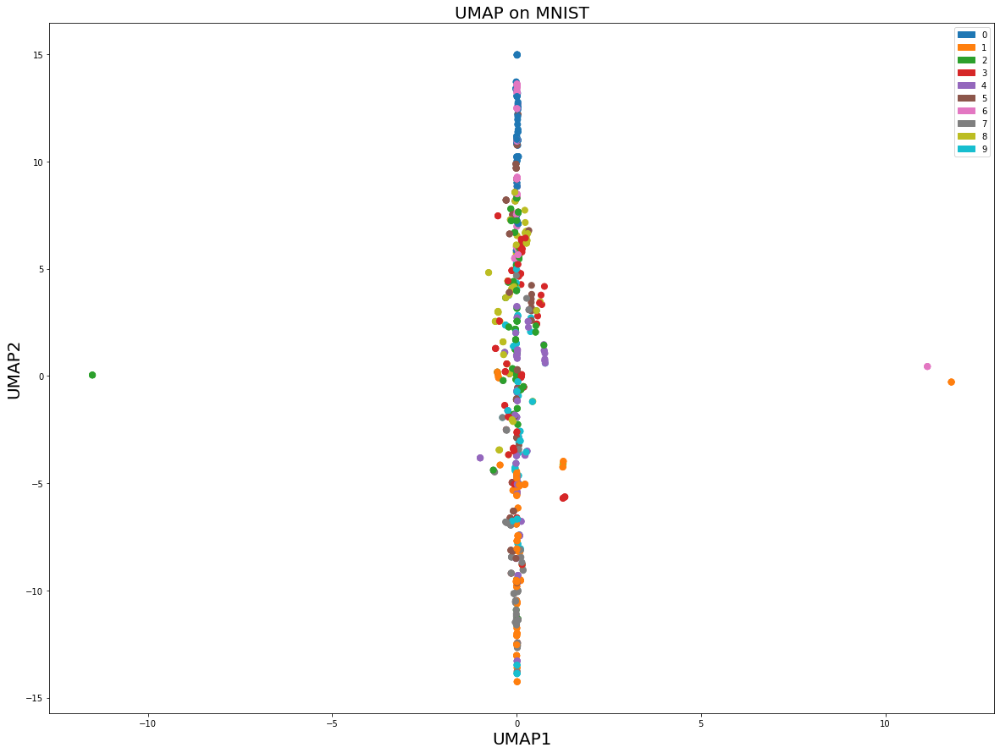


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 0.00095367431640625


/home/adrien/.local/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Running Gradient Descent: 

Cross-Entropy = 44.7649147449956 after 0 iterations
Cross-Entropy = 1.7481363484984396 after 10 iterations
Cross-Entropy = 0.9687478356435911 after 20 iterations
Cross-Entropy = 0.6800072078098779 after 30 iterations
Cross-Entropy = 0.5054971709851711 after 40 iterations
Cross-Entropy = 0.3733049005975487 after 50 iterations
Cross-Entropy = 0.27468740033178957 after 60 iterations
Cross-Entropy = 0.2037575655492502 after 70 iterations
Cross-Entropy = 0.1560373190668444 after 80 iterations
Cross-Entropy = 0.12360090696787782 after 90 iterations


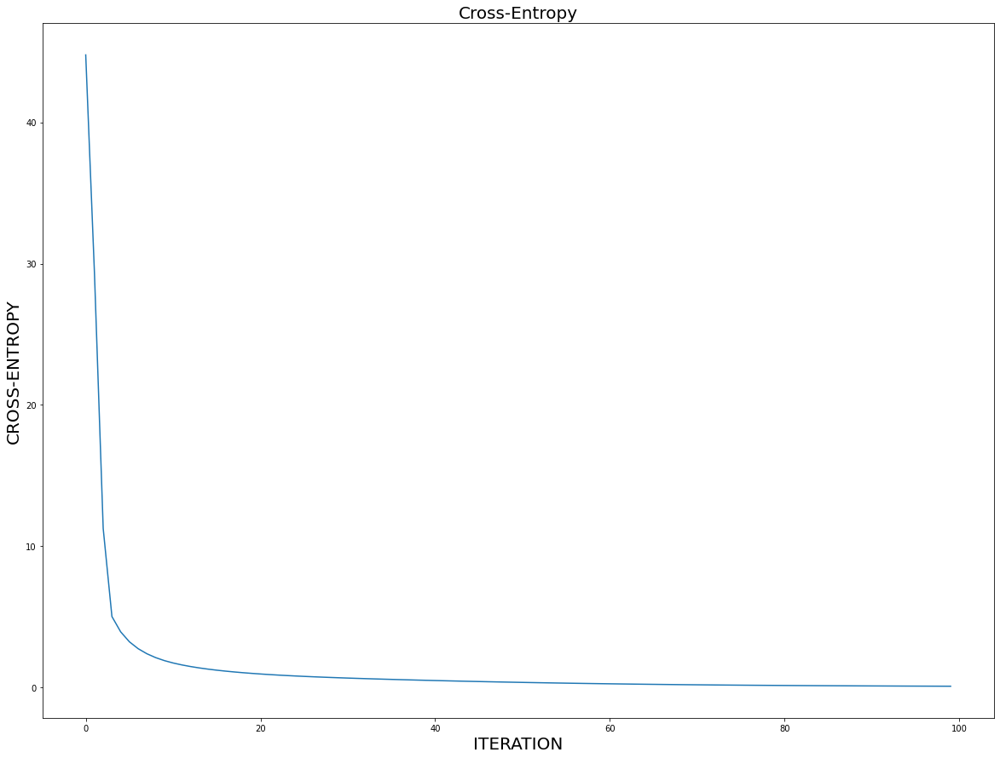

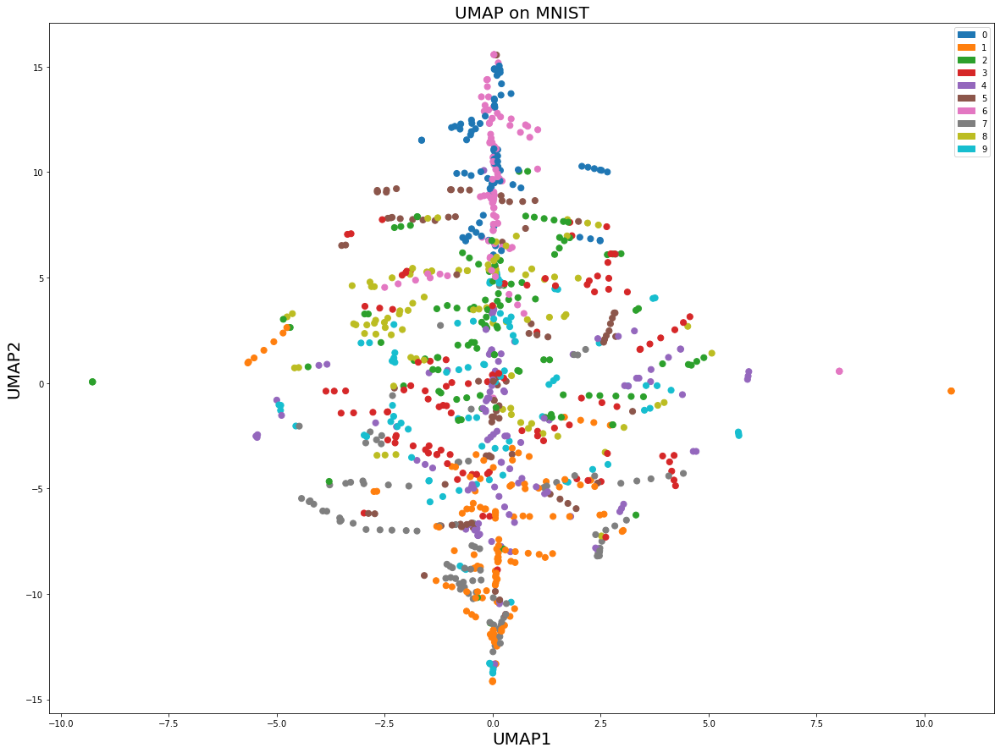


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 27.247266082765233 after 0 iterations
Cross-Entropy = 1.3520461452438546 after 10 iterations
Cross-Entropy = 0.5180355128941473 after 20 iterations
Cross-Entropy = 0.2970667305873249 after 30 iterations
Cross-Entropy = 0.19810040443366114 after 40 iterations
Cross-Entropy = 0.13888801546407206 after 50 iterations
Cross-Entropy = 0.10596531537971385 after 60 iterations
Cross-Entropy = 0.07891277881458027 after 70 iterations
Cross

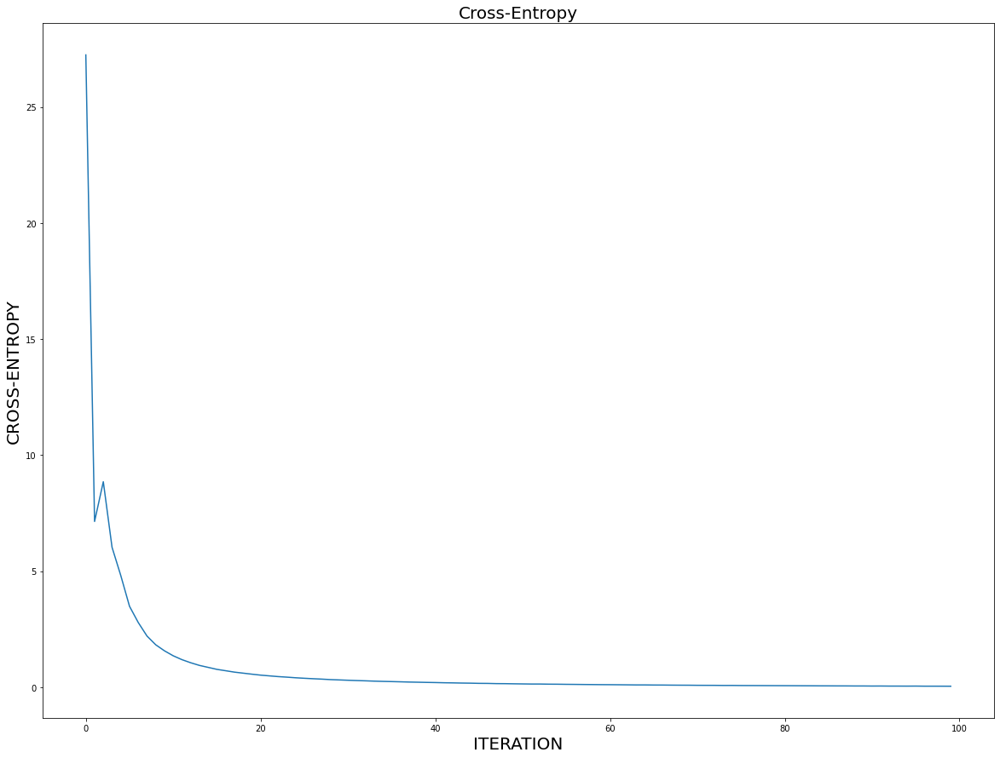

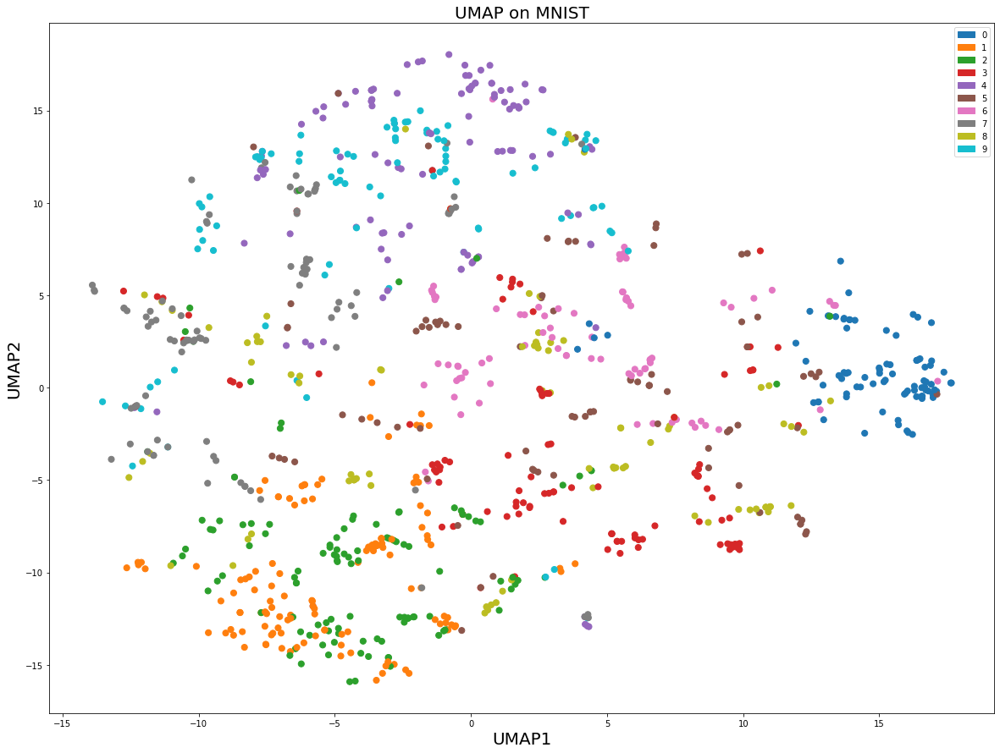


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 29.558725493744976 after 0 iterations
Cross-Entropy = 1.2800610000793309 after 10 iterations
Cross-Entropy = 0.5063780881724702 after 20 iterations
Cross-Entropy = 0.29339681358492886 after 30 iterations
Cross-Entropy = 0.19268421609363634 after 40 iterations
Cross-Entropy = 0.14019477377821712 after 50 iterations
Cross-Entropy = 0.10707921216987491 after 60 iterations
Cross-Entropy = 0.08427283284011736 after 70 iterations
Cros

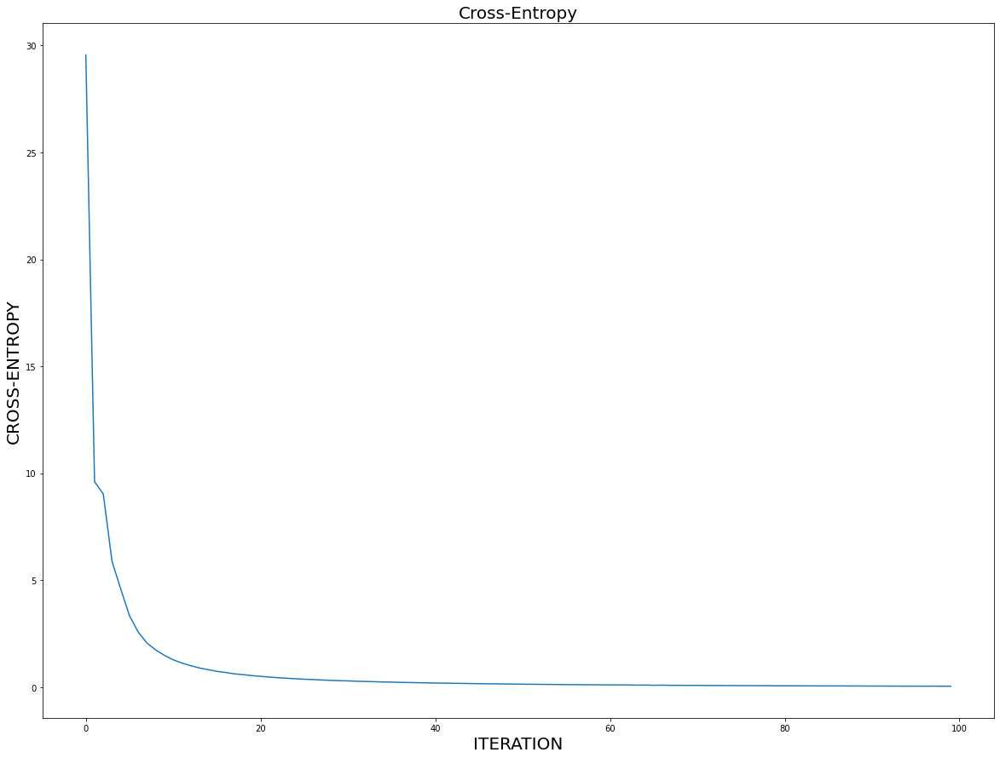

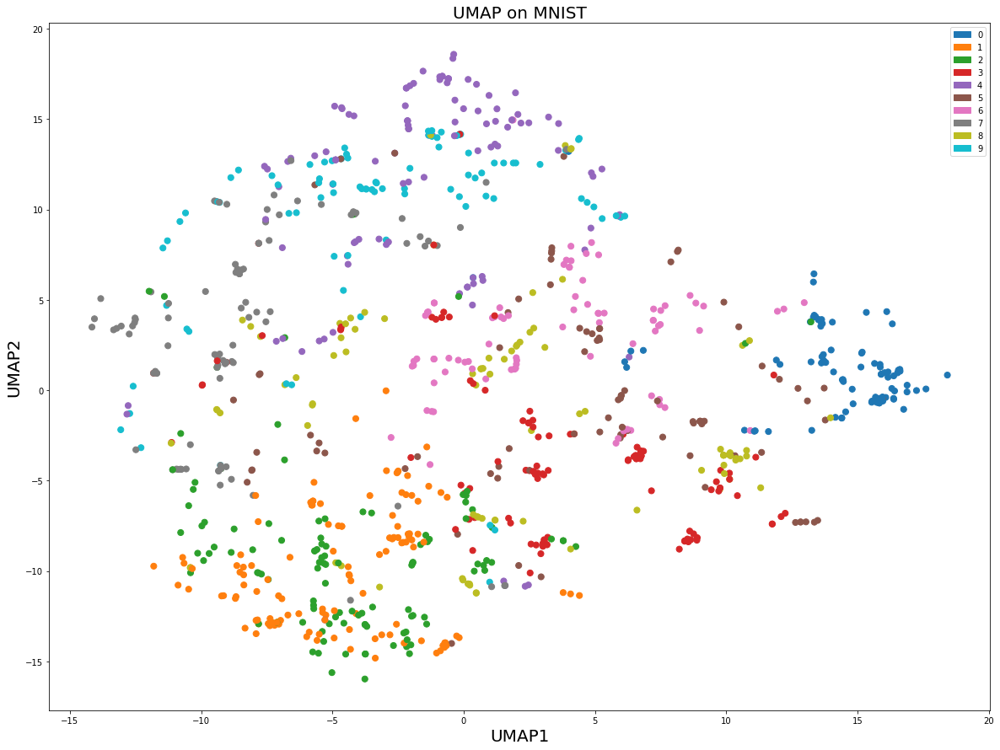


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 31.409674717802666 after 0 iterations
Cross-Entropy = 1.2144205747328483 after 10 iterations
Cross-Entropy = 0.500711704393652 after 20 iterations
Cross-Entropy = 0.2931086319923344 after 30 iterations
Cross-Entropy = 0.20289228011336863 after 40 iterations
Cross-Entropy = 0.14194257181635295 after 50 iterations
Cross-Entropy = 0.10917608112563916 after 60 iterations
Cross-Entropy = 0.08554514620028653 after 70 iterations
Cross-

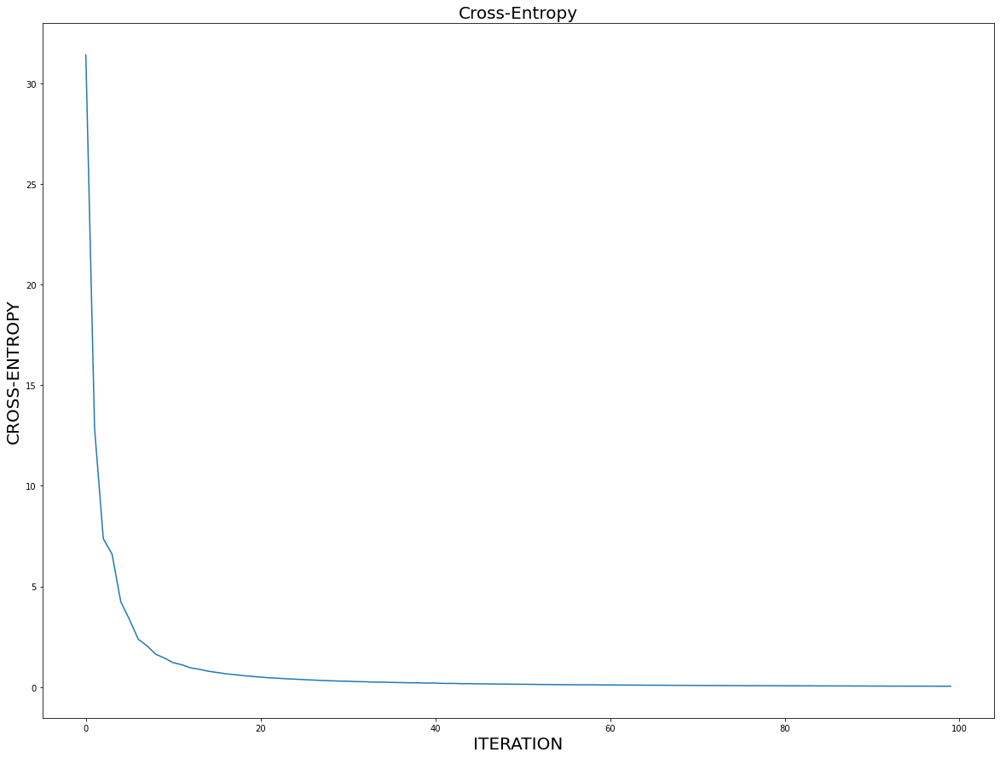

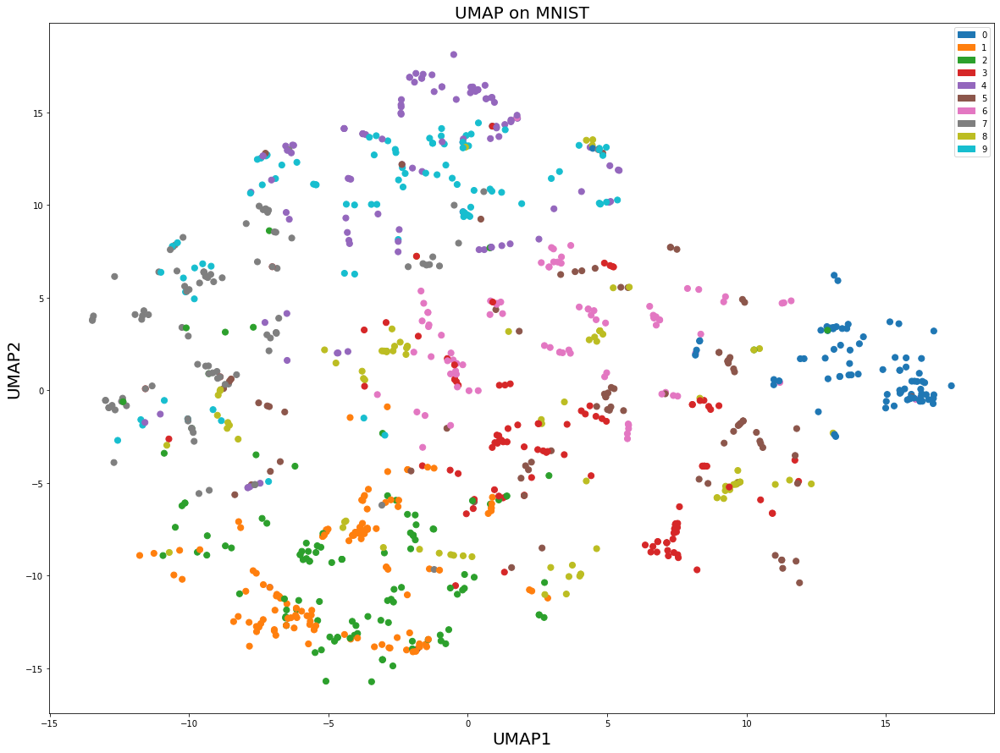


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 28.180363761281754 after 0 iterations
Cross-Entropy = 1.333919894205692 after 10 iterations
Cross-Entropy = 0.5146303408792442 after 20 iterations
Cross-Entropy = 0.2977073090429747 after 30 iterations
Cross-Entropy = 0.19734941723410732 after 40 iterations
Cross-Entropy = 0.1430965023002732 after 50 iterations
Cross-Entropy = 0.10623563211024997 after 60 iterations
Cross-Entropy = 0.0819626059046737 after 70 iterations
Cross-En

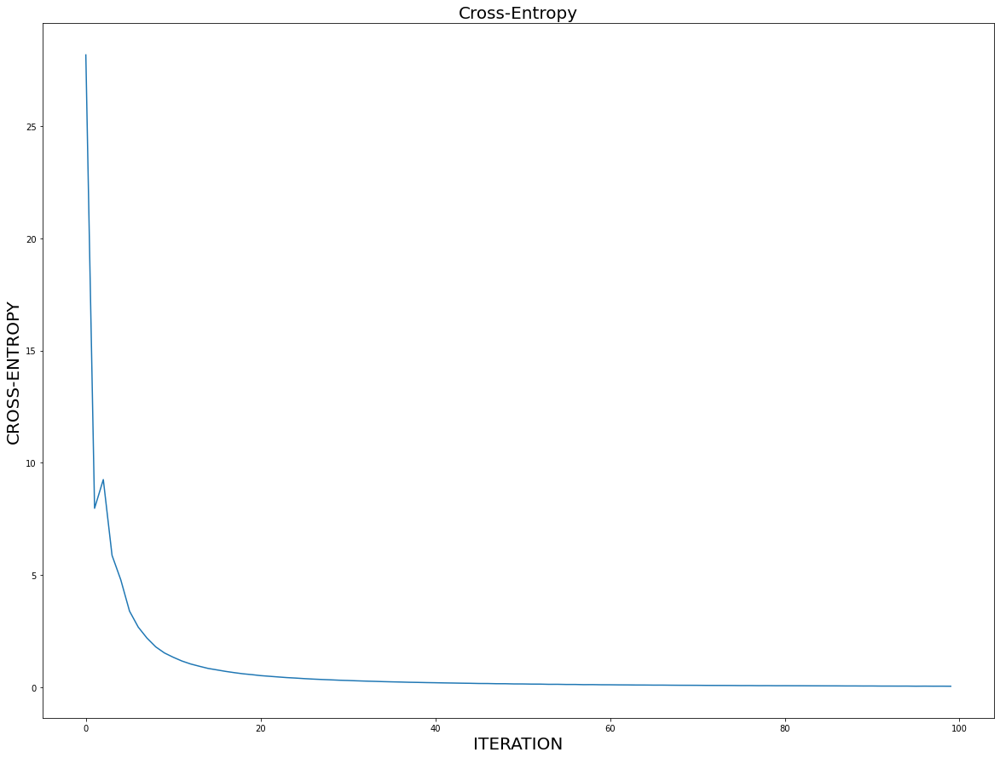

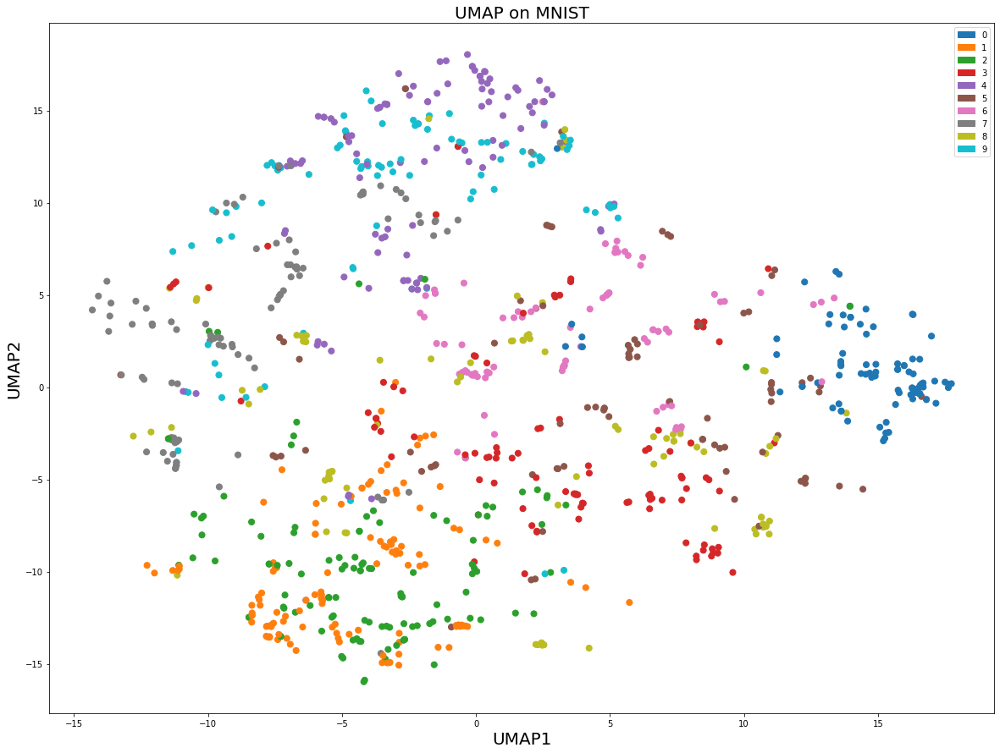


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 33.88904922163821 after 0 iterations
Cross-Entropy = 1.172485780928596 after 10 iterations
Cross-Entropy = 0.4786787756595641 after 20 iterations
Cross-Entropy = 0.2826126268013676 after 30 iterations
Cross-Entropy = 0.1919516688547824 after 40 iterations
Cross-Entropy = 0.14358937181656647 after 50 iterations
Cross-Entropy = 0.1093374552382306 after 60 iterations
Cross-Entropy = 0.08193776736555126 after 70 iterations
Cross-Ent

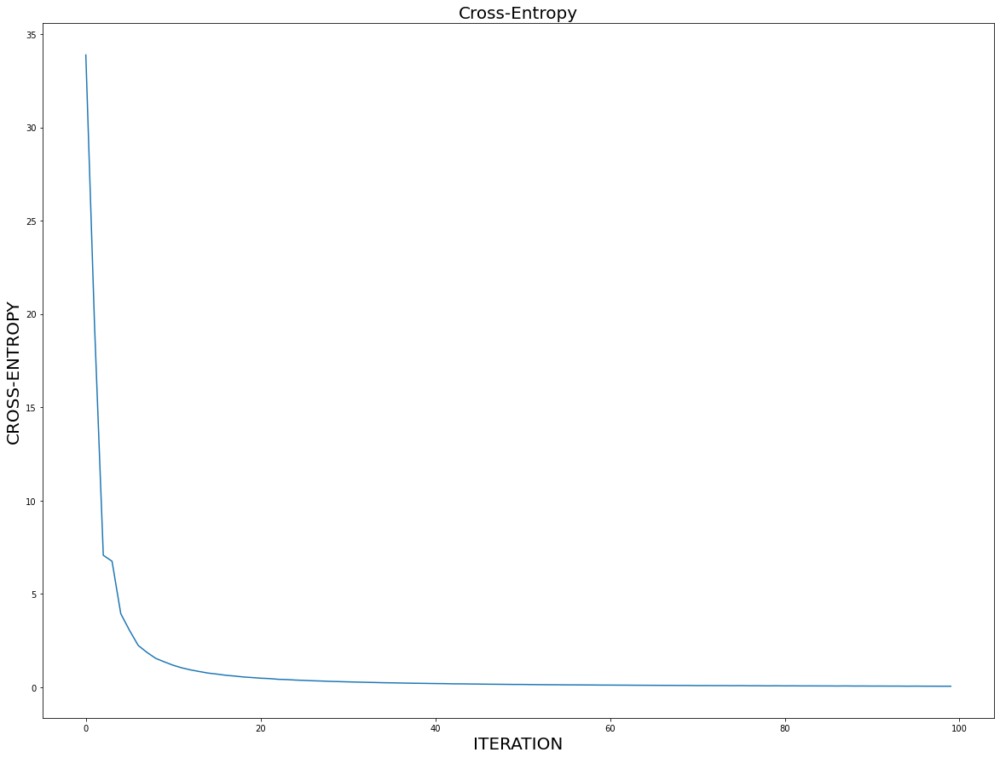

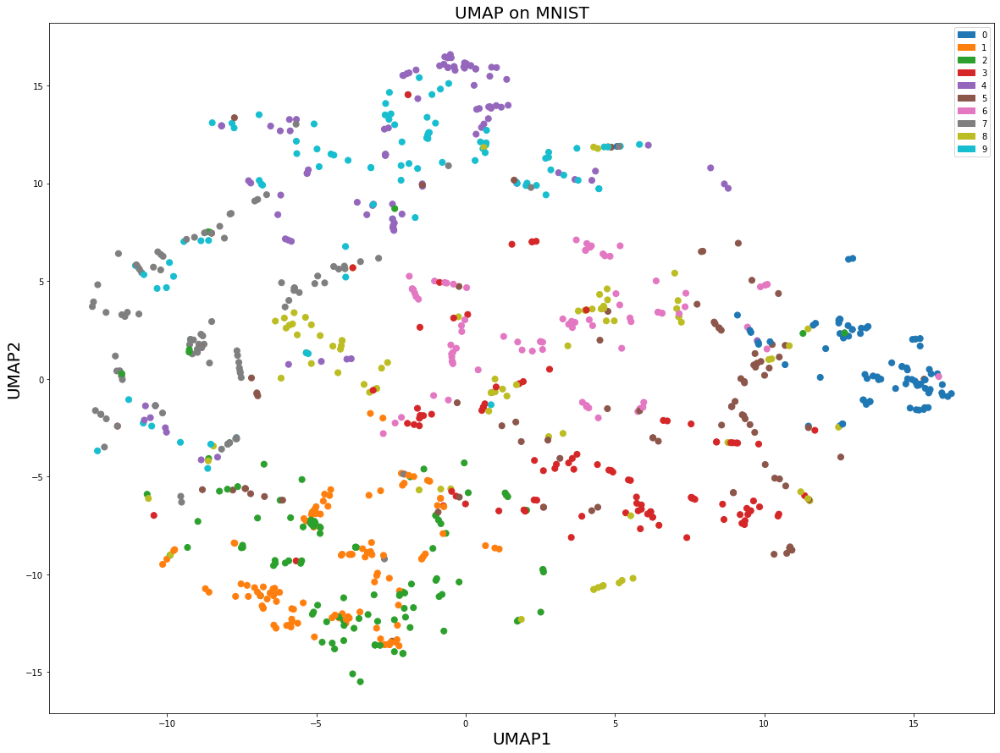


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 42.275484906497944 after 0 iterations
Cross-Entropy = 1.0419018588146467 after 10 iterations
Cross-Entropy = 0.4288744431182714 after 20 iterations
Cross-Entropy = 0.2627524062646096 after 30 iterations
Cross-Entropy = 0.19290796544782038 after 40 iterations
Cross-Entropy = 0.15431478413767552 after 50 iterations
Cross-Entropy = 0.13112546004475445 after 60 iterations
Cross-Entropy = 0.11658904299133879 after 70 iterations
Cross

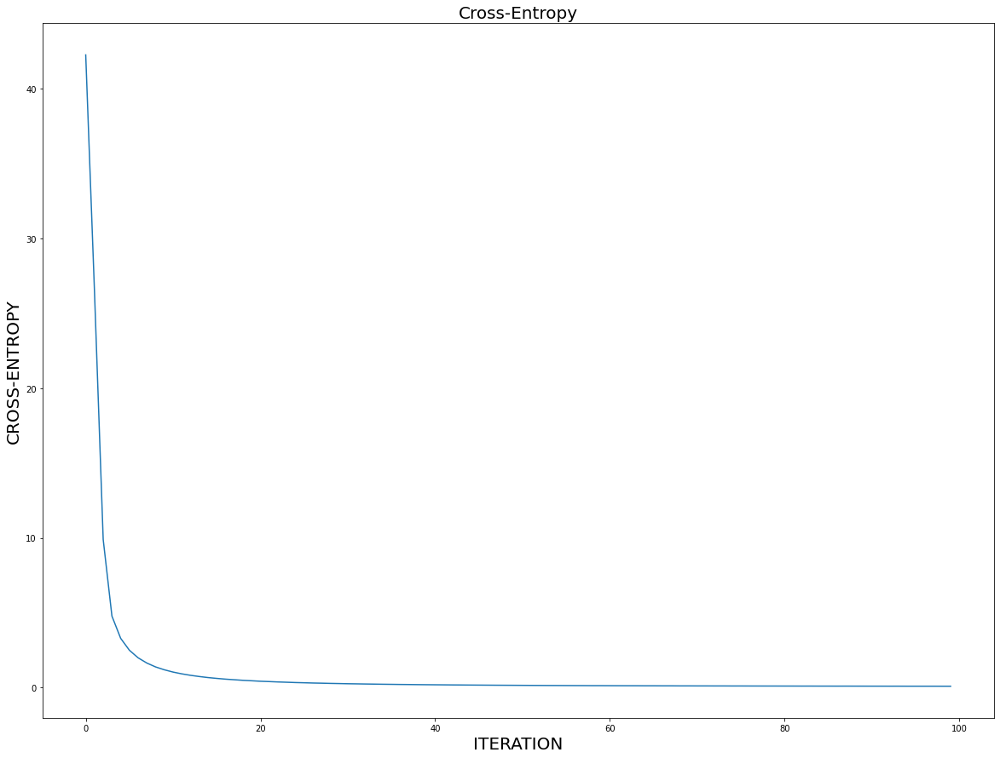

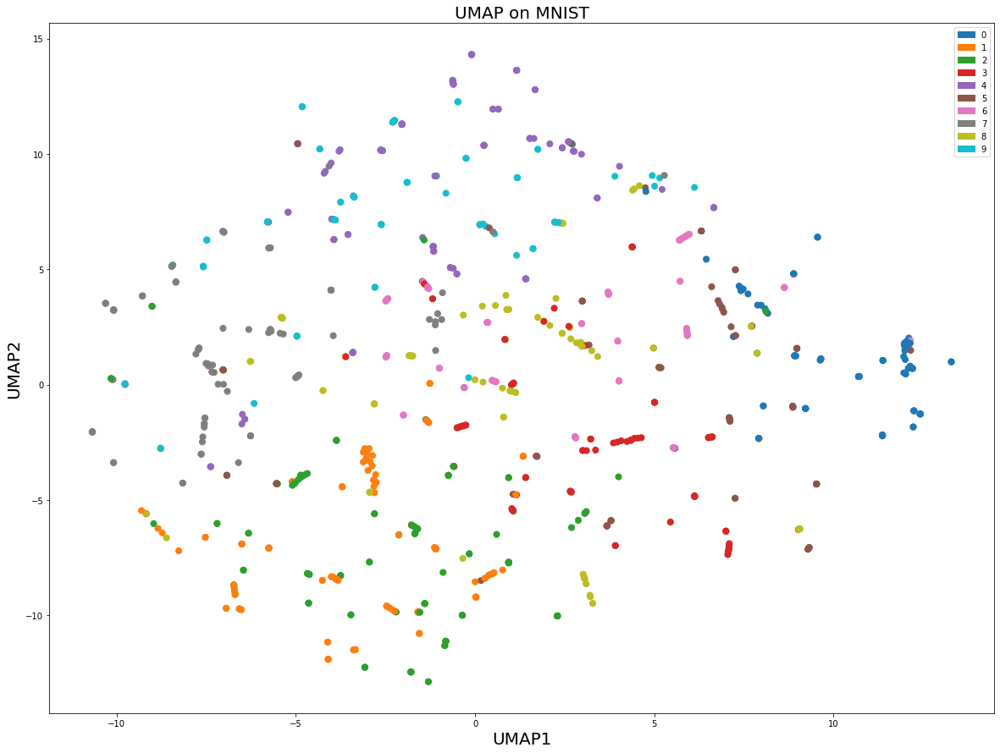


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 9.678547566120809
Running Gradient Descent: 

Cross-Entropy = 45.29296793468446 after 0 iterations
Cross-Entropy = 0.8756218491736575 after 10 iterations
Cross-Entropy = 0.3530259507024188 after 20 iterations
Cross-Entropy = 0.20355834472238699 after 30 iterations
Cross-Entropy = 0.1383228098438083 after 40 iterations
Cross-Entropy = 0.10349128158818377 after 50 iterations
Cross-Entropy = 0.08236595642253922 after 60 iterations
Cross-Entropy = 0.06822886236335782 after 70 iterations
Cross-

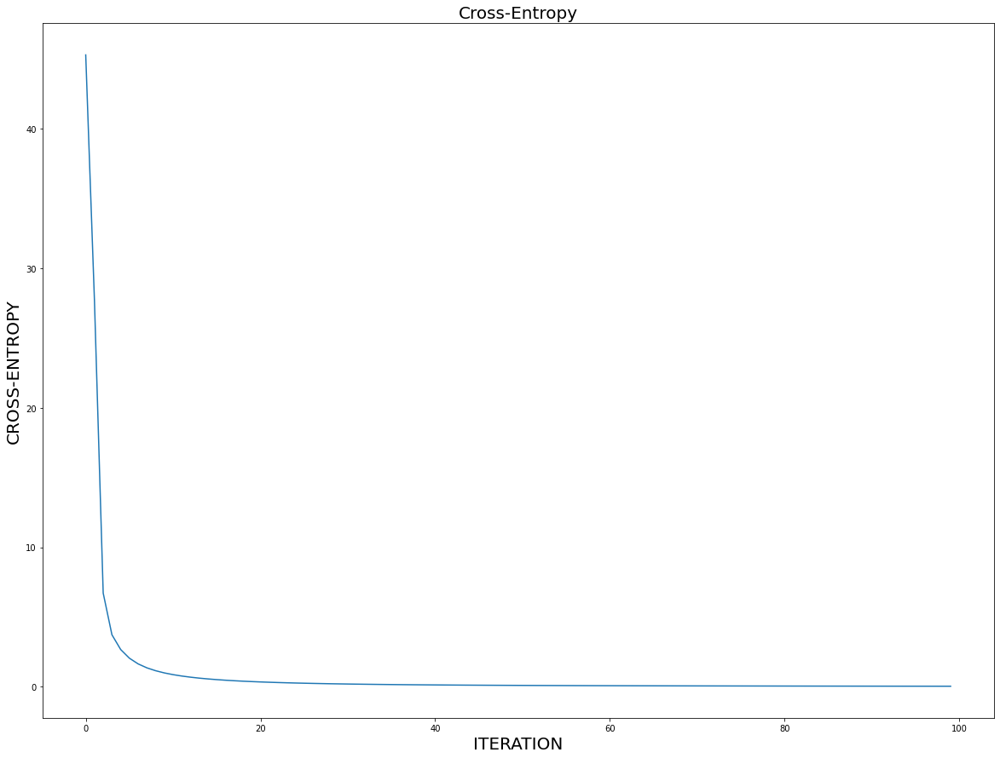

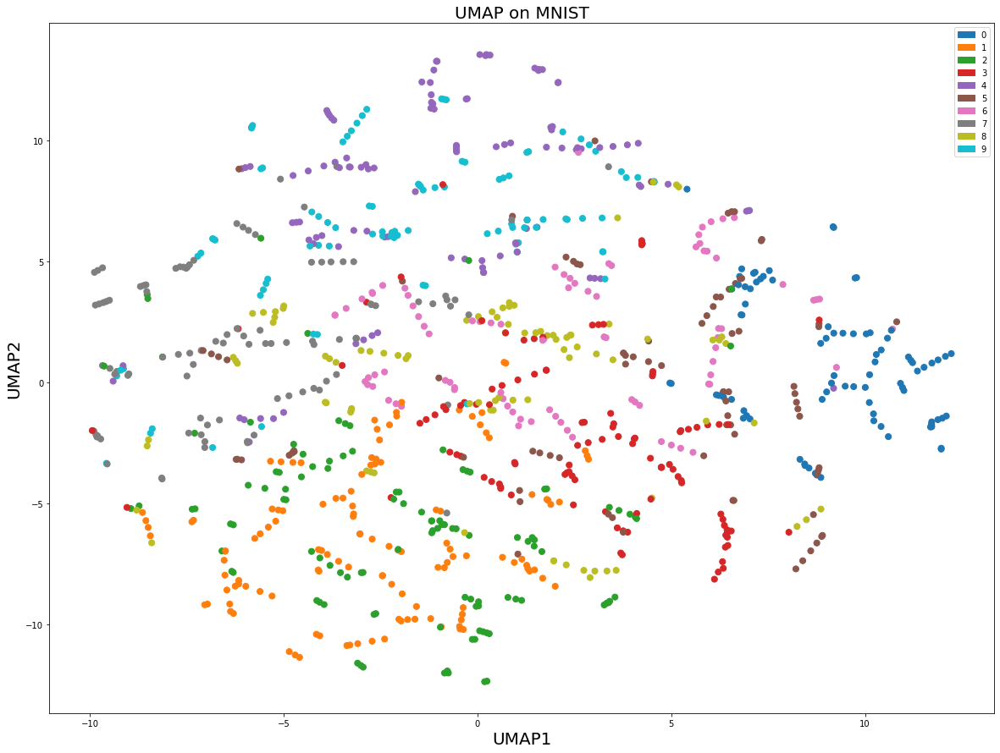


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 28.4206940622293 after 0 iterations
Cross-Entropy = 1.774823360024174 after 10 iterations
Cross-Entropy = 0.7806462718801777 after 20 iterations
Cross-Entropy = 0.4985081495186809 after 30 iterations
Cross-Entropy = 0.37378246969582646 after 40 iterations
Cross-Entropy = 0.30988799858855315 after 50 iterations
Cross-Entropy = 0.2627083758854261 after 60 iterations
Cross-Entropy = 0.2284441804792842 after 70 iterations
Cross-Entr

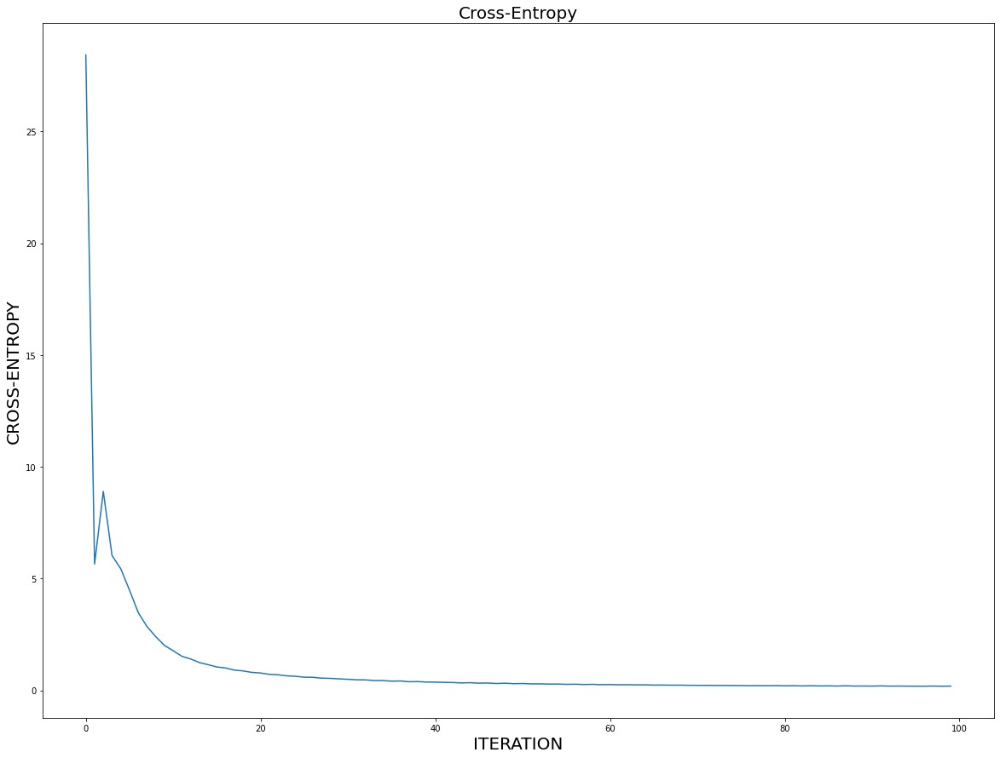

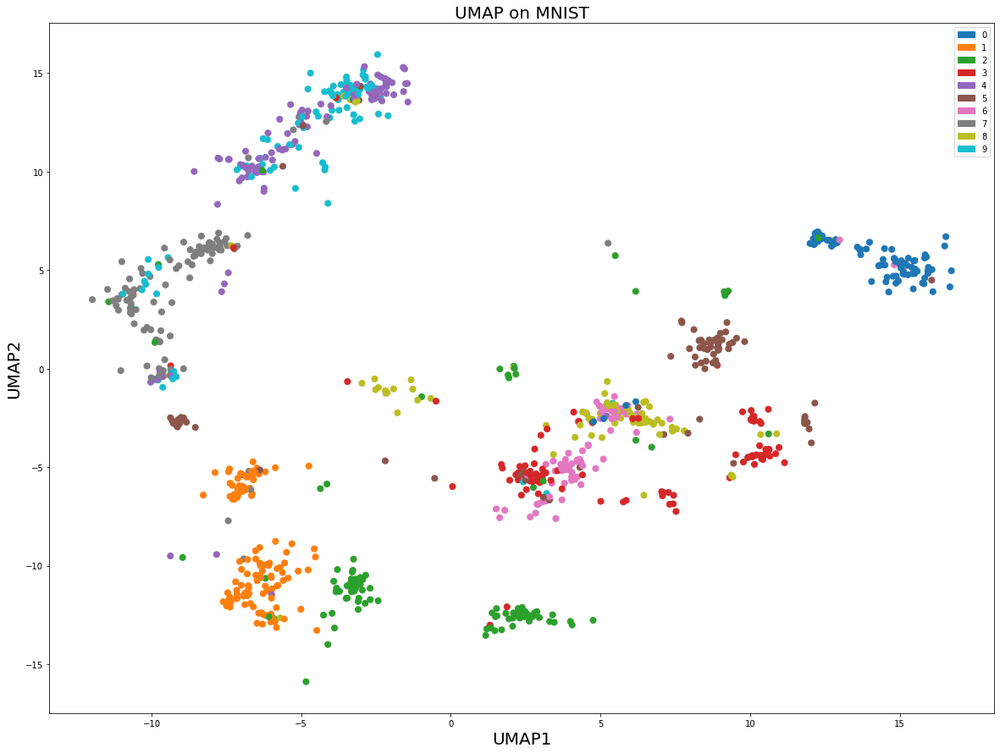


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 31.107525190220965 after 0 iterations
Cross-Entropy = 1.6612111007032246 after 10 iterations
Cross-Entropy = 0.7160249876094973 after 20 iterations
Cross-Entropy = 0.4602258473601322 after 30 iterations
Cross-Entropy = 0.34751042900917206 after 40 iterations
Cross-Entropy = 0.2936013393217259 after 50 iterations
Cross-Entropy = 0.25864979421629597 after 60 iterations
Cross-Entropy = 0.23172836169780134 after 70 iterations
Cross-

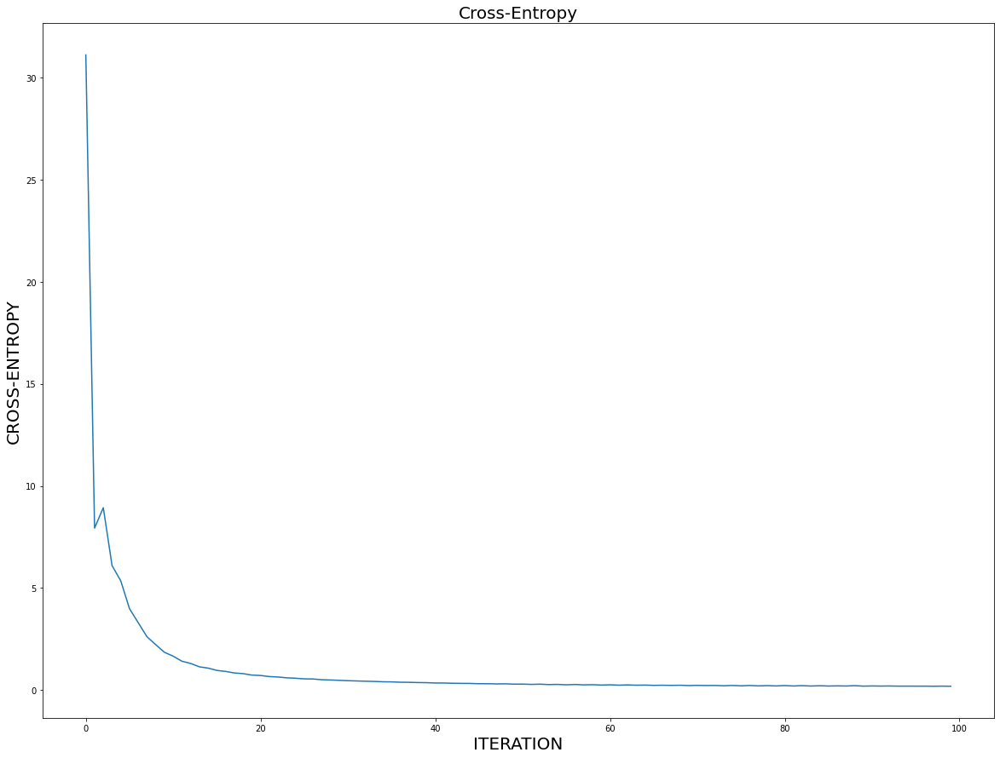

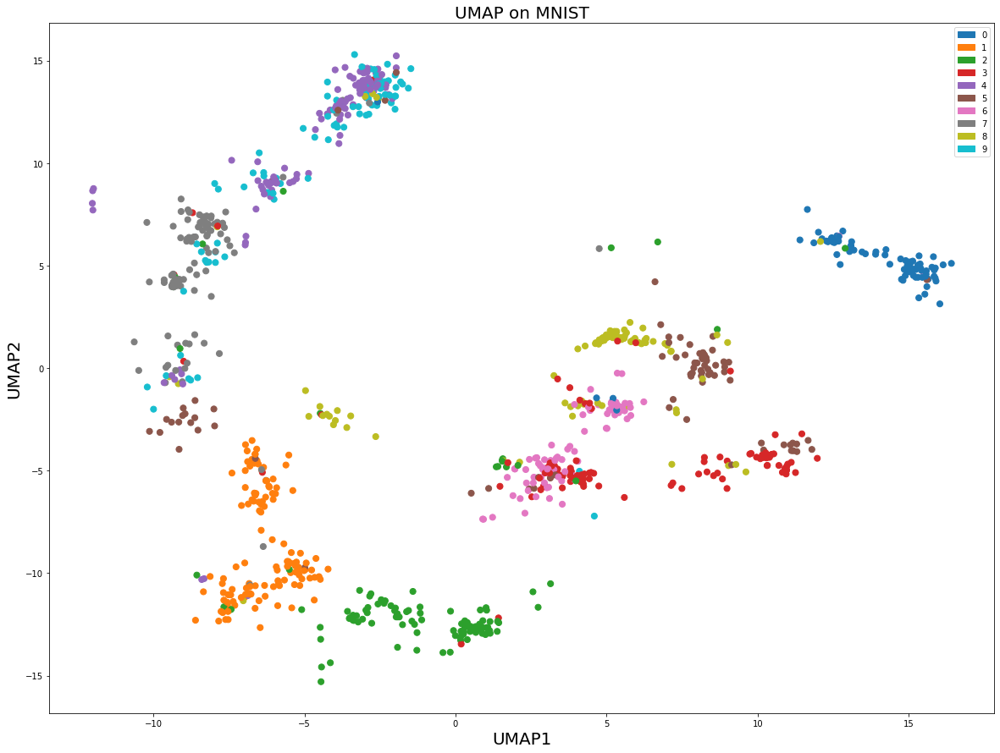


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 33.188710676348705 after 0 iterations
Cross-Entropy = 1.4912079395971916 after 10 iterations
Cross-Entropy = 0.6802728976334923 after 20 iterations
Cross-Entropy = 0.4469383330945668 after 30 iterations
Cross-Entropy = 0.3403273529093867 after 40 iterations
Cross-Entropy = 0.29107054182809855 after 50 iterations
Cross-Entropy = 0.2524662715836915 after 60 iterations
Cross-Entropy = 0.2318011743087363 after 70 iterations
Cross-En

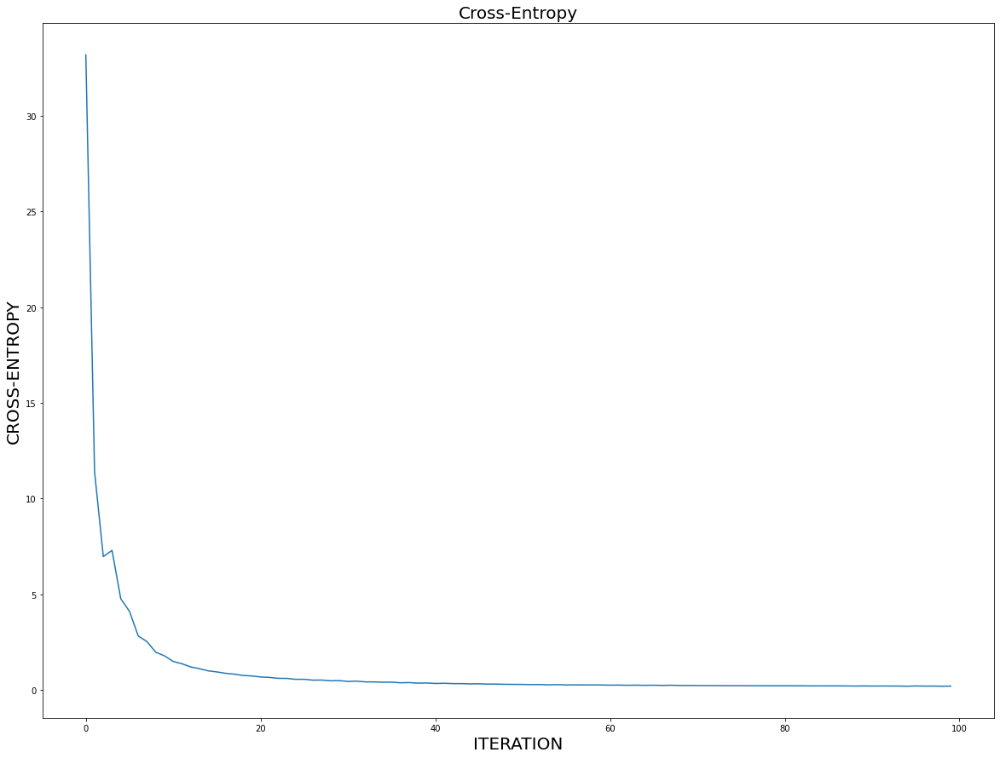

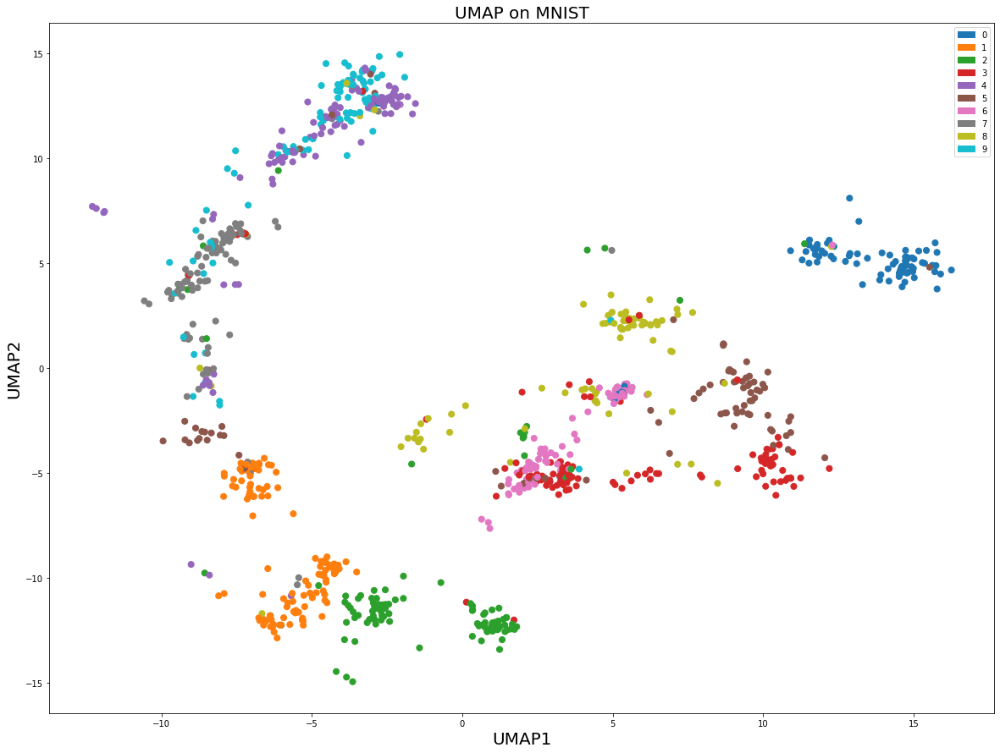


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 29.509444998795274 after 0 iterations
Cross-Entropy = 1.71095645911897 after 10 iterations
Cross-Entropy = 0.7399340513016491 after 20 iterations
Cross-Entropy = 0.47910419812698585 after 30 iterations
Cross-Entropy = 0.3576660515729516 after 40 iterations
Cross-Entropy = 0.28999044998142387 after 50 iterations
Cross-Entropy = 0.2502263133141784 after 60 iterations
Cross-Entropy = 0.21696807172239146 after 70 iterations
Cross-En

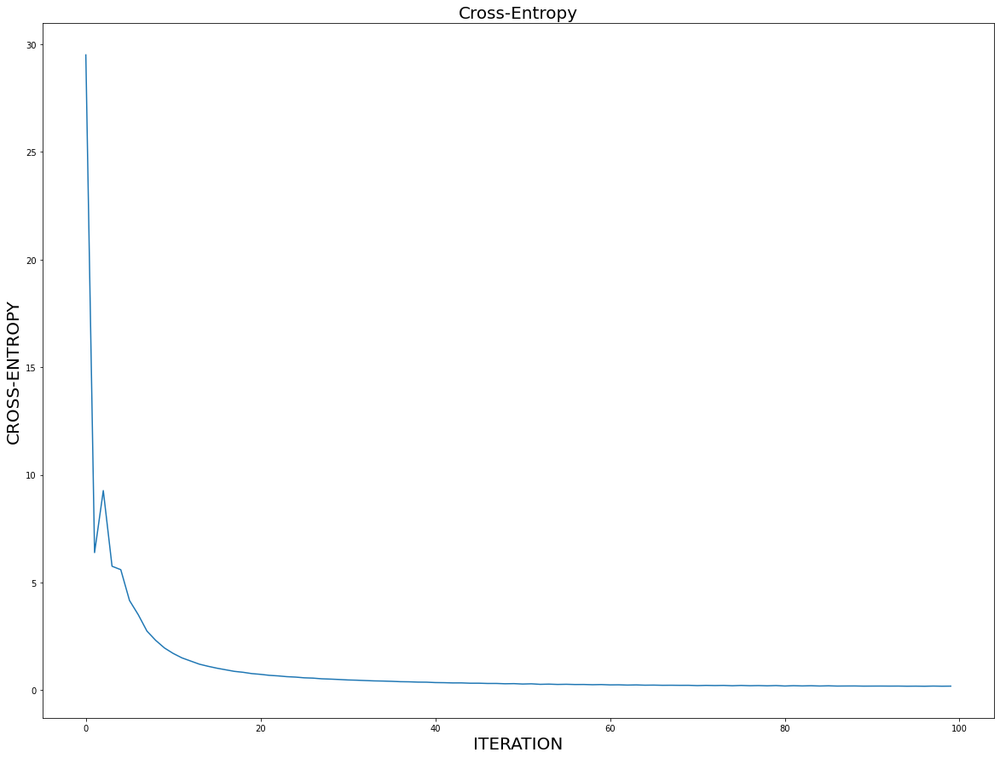

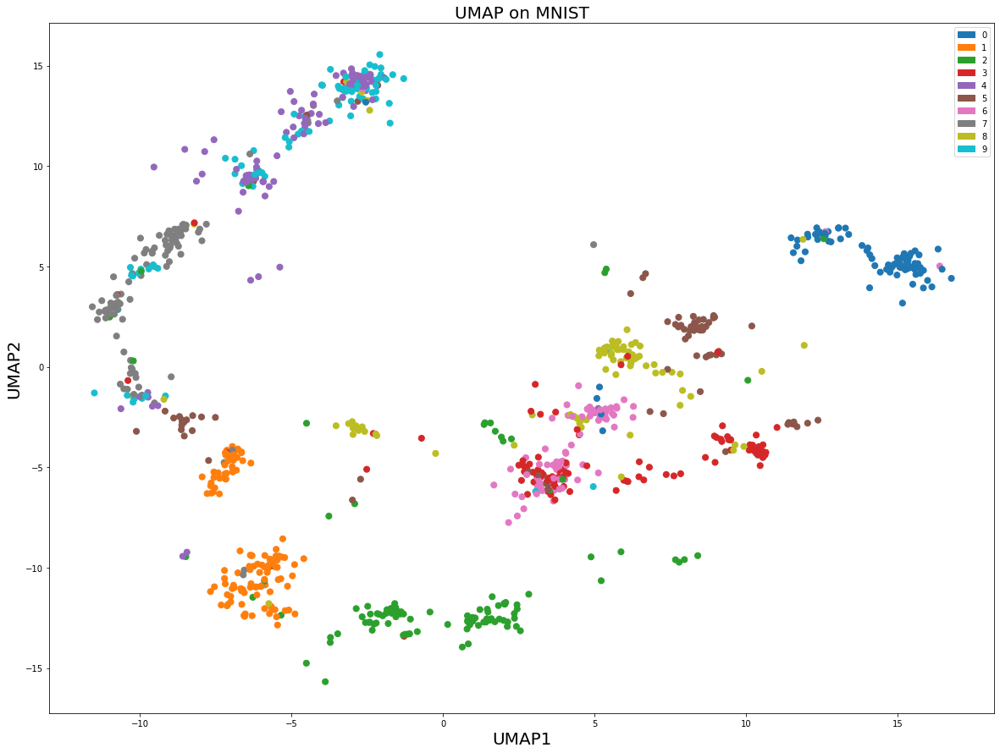


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 35.74328588123512 after 0 iterations
Cross-Entropy = 1.3665607263912336 after 10 iterations
Cross-Entropy = 0.6604061839246939 after 20 iterations
Cross-Entropy = 0.4360570881914361 after 30 iterations
Cross-Entropy = 0.35004947631967837 after 40 iterations
Cross-Entropy = 0.28910837725842364 after 50 iterations
Cross-Entropy = 0.25406503525692836 after 60 iterations
Cross-Entropy = 0.233157425715406 after 70 iterations
Cross-En

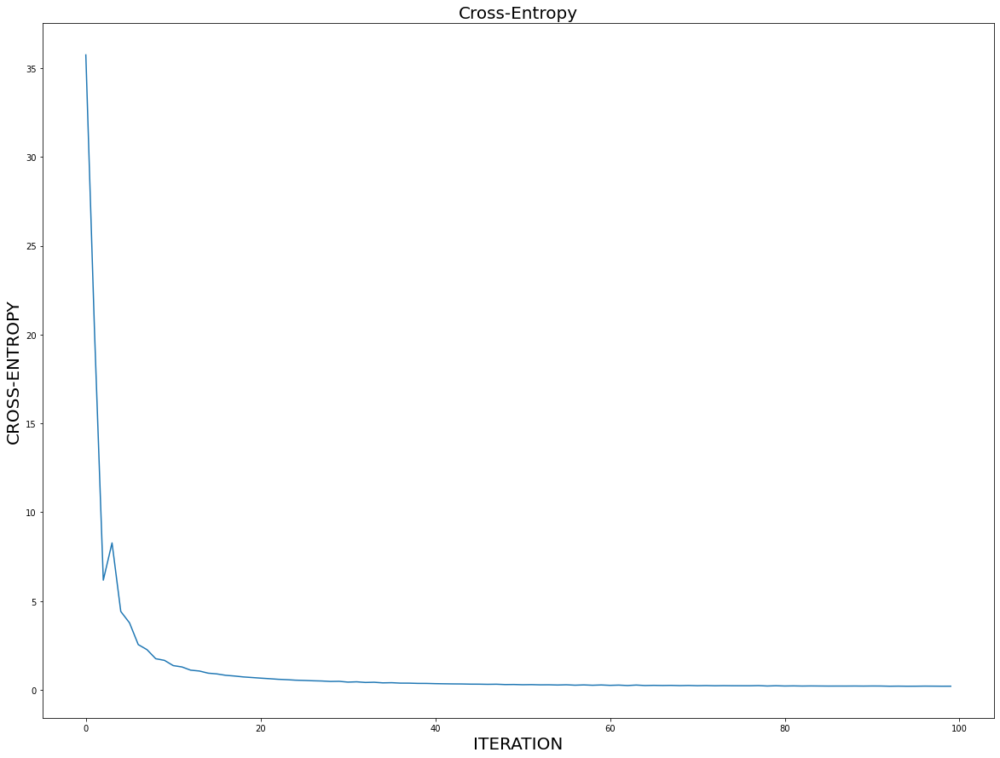

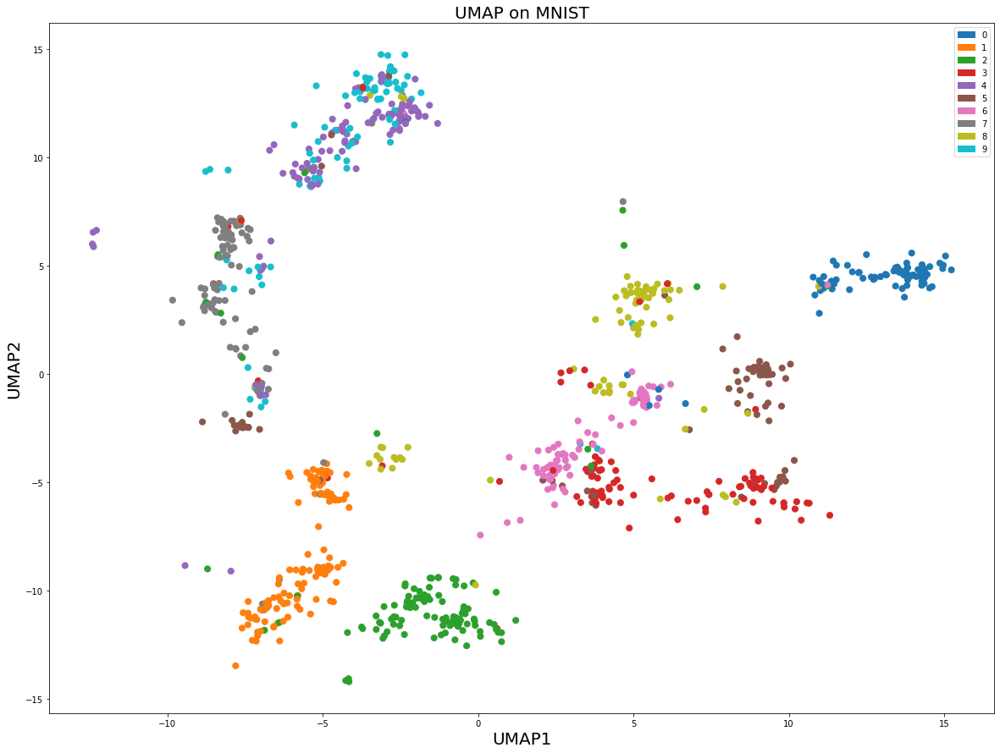


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 43.14925392843445 after 0 iterations
Cross-Entropy = 1.1571943935310125 after 10 iterations
Cross-Entropy = 0.5588750782612488 after 20 iterations
Cross-Entropy = 0.39496064606774917 after 30 iterations
Cross-Entropy = 0.3228570432440494 after 40 iterations
Cross-Entropy = 0.2832567746458072 after 50 iterations
Cross-Entropy = 0.26185410020470035 after 60 iterations
Cross-Entropy = 0.24620214881901473 after 70 iterations
Cross-E

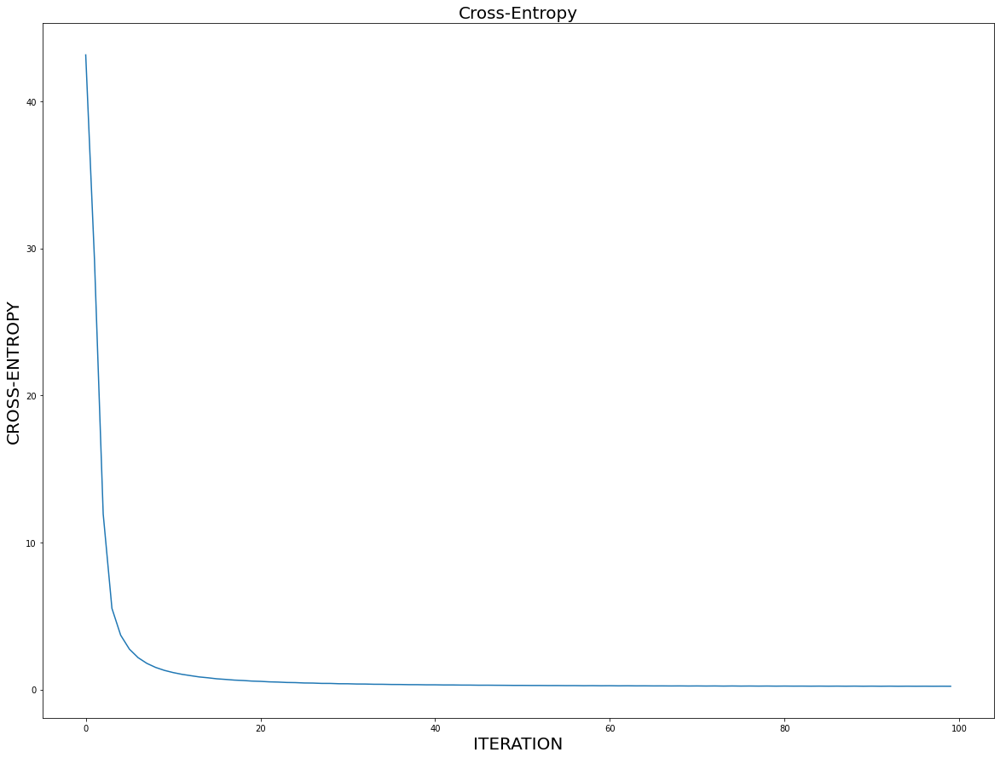

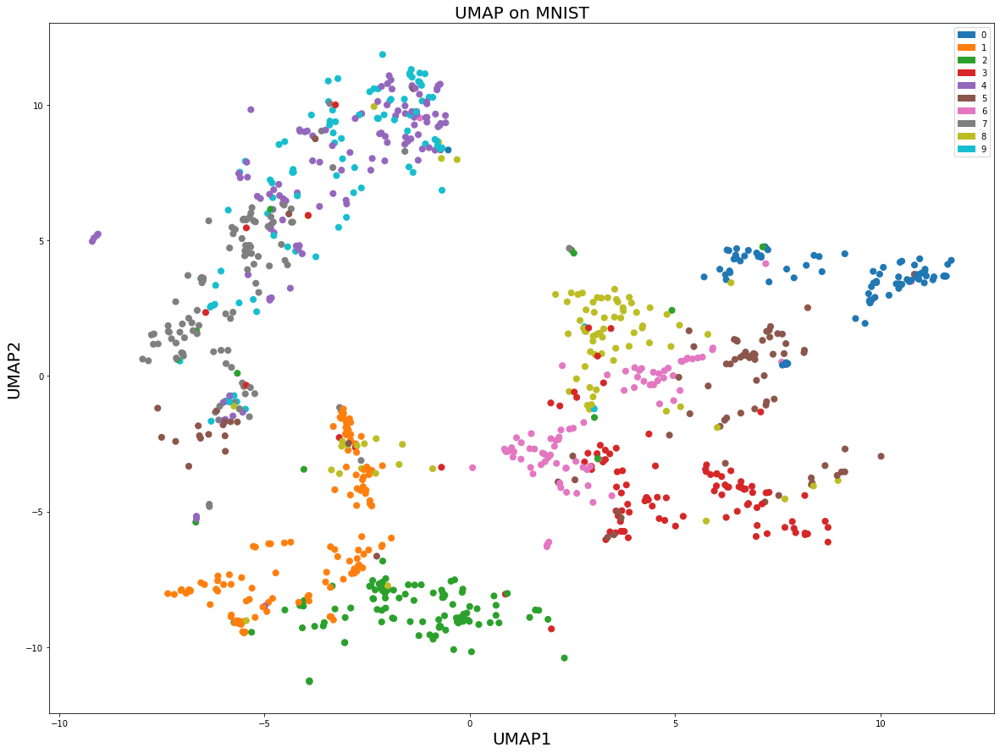


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 83.16169009433017
Running Gradient Descent: 

Cross-Entropy = 45.49874656654518 after 0 iterations
Cross-Entropy = 0.9092427352766321 after 10 iterations
Cross-Entropy = 0.4616637412313443 after 20 iterations
Cross-Entropy = 0.3399484439198443 after 30 iterations
Cross-Entropy = 0.28312974512835615 after 40 iterations
Cross-Entropy = 0.25080335794156283 after 50 iterations
Cross-Entropy = 0.2301320643635473 after 60 iterations
Cross-Entropy = 0.21613170911116086 after 70 iterations
Cross-E

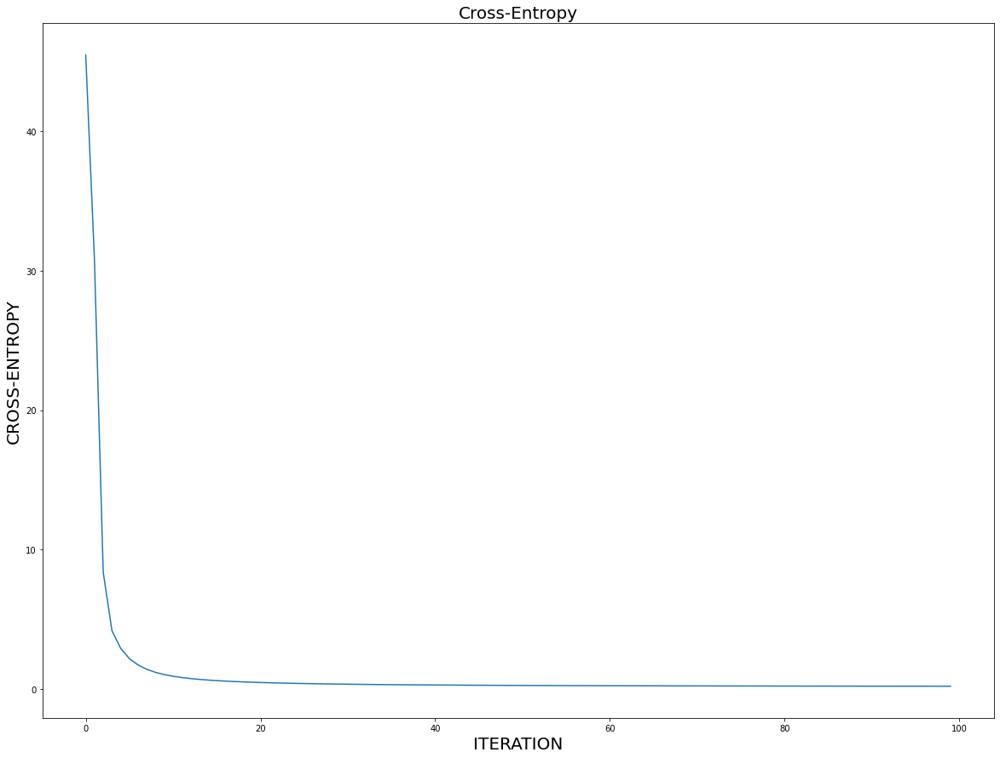

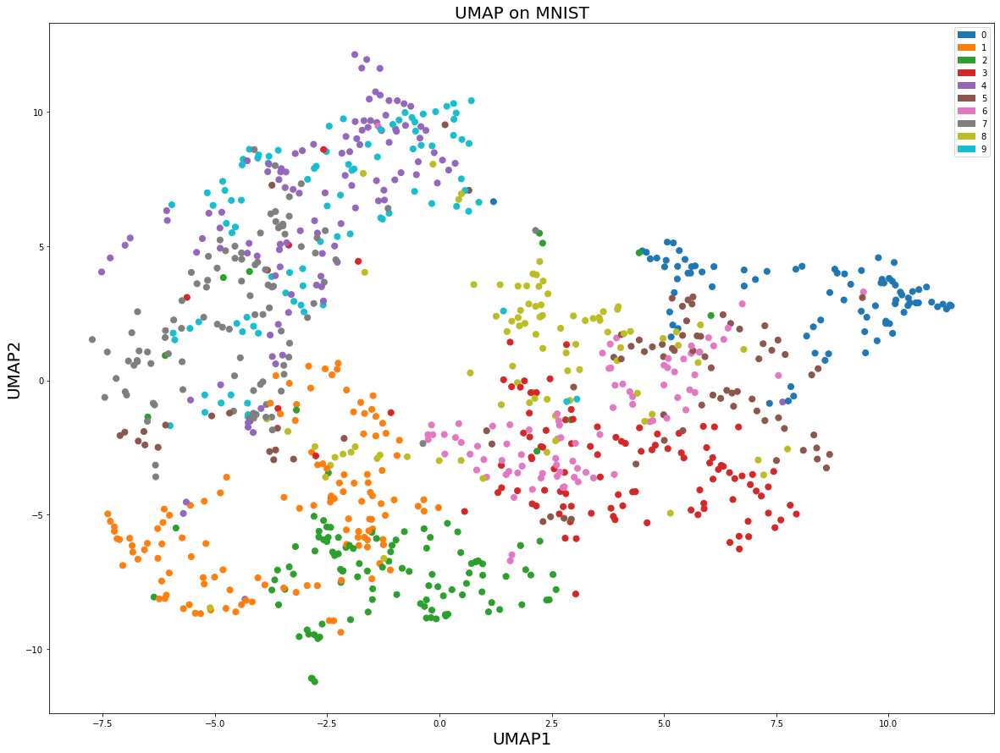


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 28.893550015755277 after 0 iterations
Cross-Entropy = 2.093424073841825 after 10 iterations
Cross-Entropy = 0.9328728071592077 after 20 iterations
Cross-Entropy = 0.6180618711842062 after 30 iterations
Cross-Entropy = 0.48996052576001303 after 40 iterations
Cross-Entropy = 0.41633969648841396 after 50 iterations
Cross-Entropy = 0.3704873061723757 after 60 iterations
Cross-Entropy = 0.3510108773575978 after 70 iterations
Cross-E

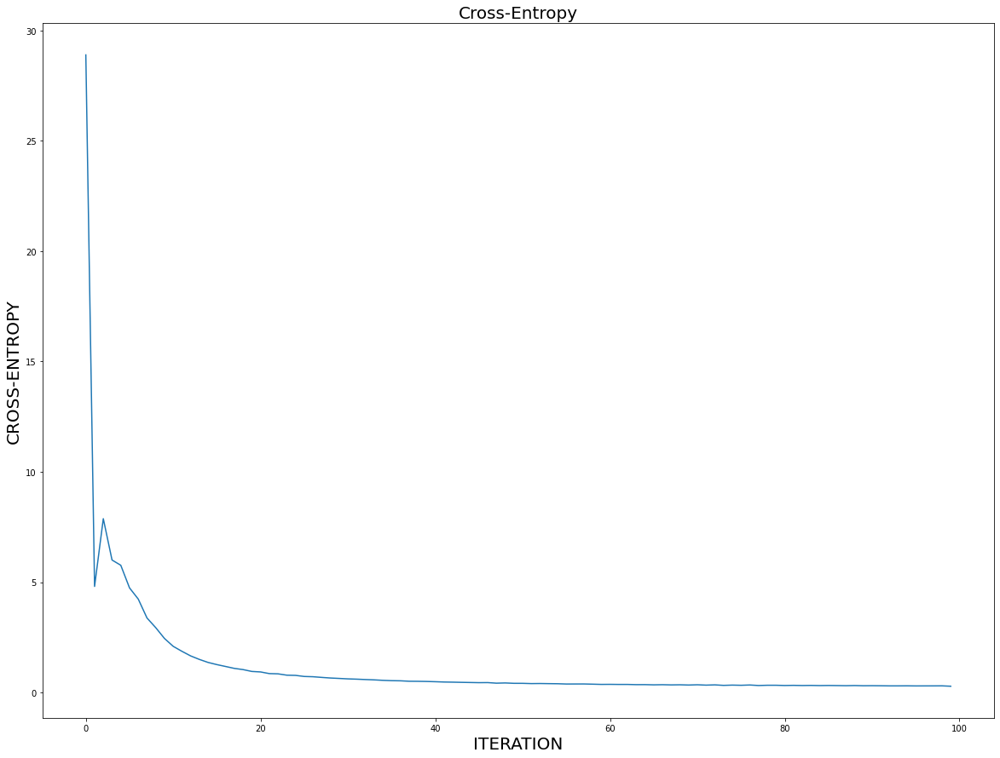

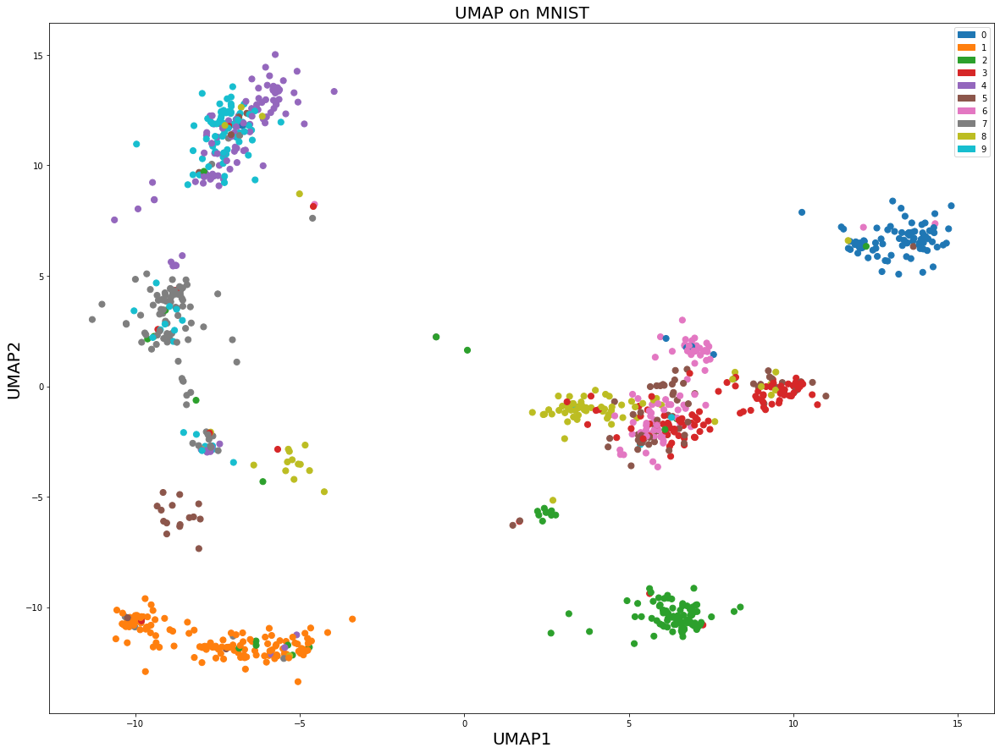


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 31.919389966970865 after 0 iterations
Cross-Entropy = 1.9475905307214751 after 10 iterations
Cross-Entropy = 0.8747564650203158 after 20 iterations
Cross-Entropy = 0.5896354445784489 after 30 iterations
Cross-Entropy = 0.4877690308360469 after 40 iterations
Cross-Entropy = 0.41678354315574684 after 50 iterations
Cross-Entropy = 0.37109874415967614 after 60 iterations
Cross-Entropy = 0.3523306490978522 after 70 iterations
Cross-

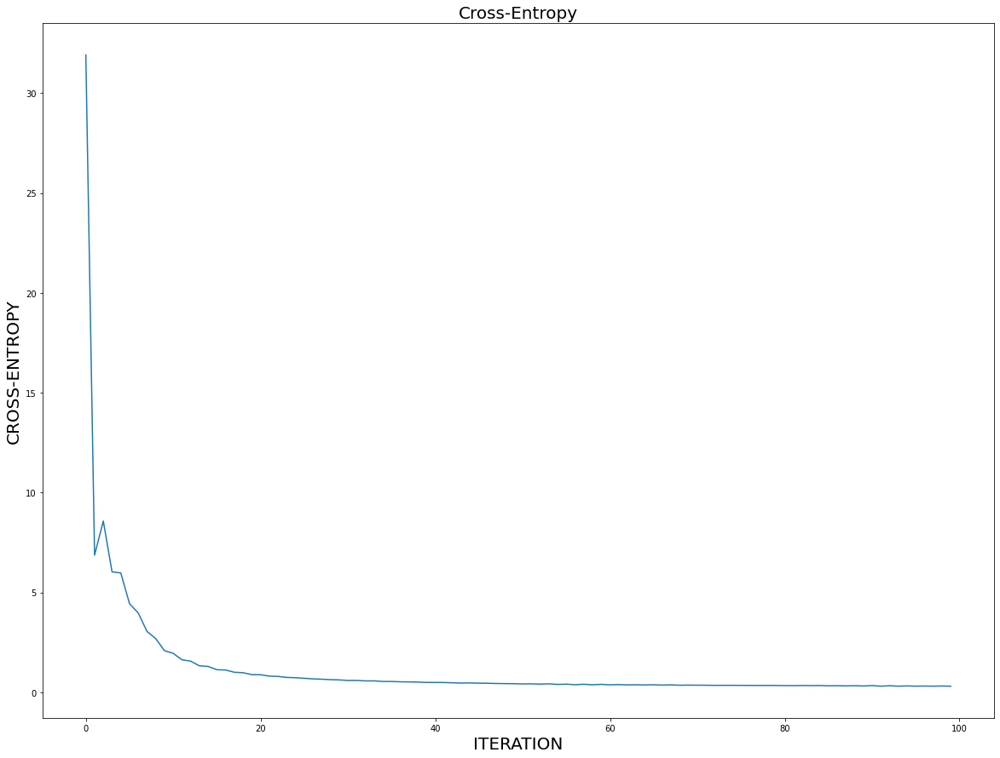

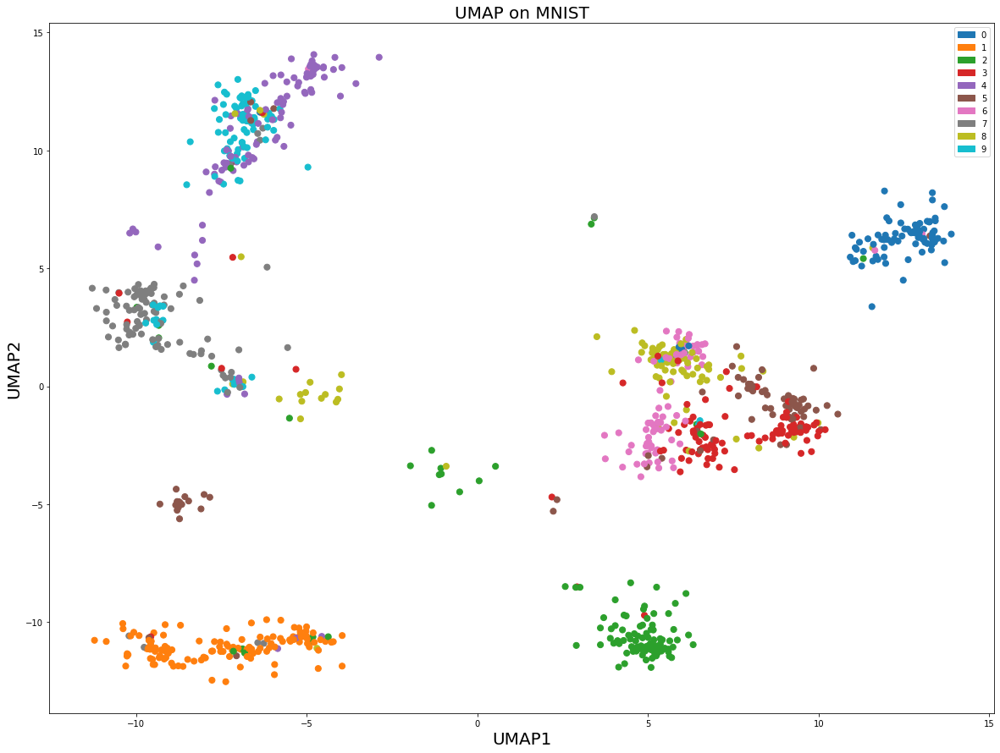


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 34.248196895455656 after 0 iterations
Cross-Entropy = 1.721437137887275 after 10 iterations
Cross-Entropy = 0.8018861253296875 after 20 iterations
Cross-Entropy = 0.550993530910098 after 30 iterations
Cross-Entropy = 0.4357193750340328 after 40 iterations
Cross-Entropy = 0.37718822148401626 after 50 iterations
Cross-Entropy = 0.3322248186689562 after 60 iterations
Cross-Entropy = 0.32587128780169144 after 70 iterations
Cross-En

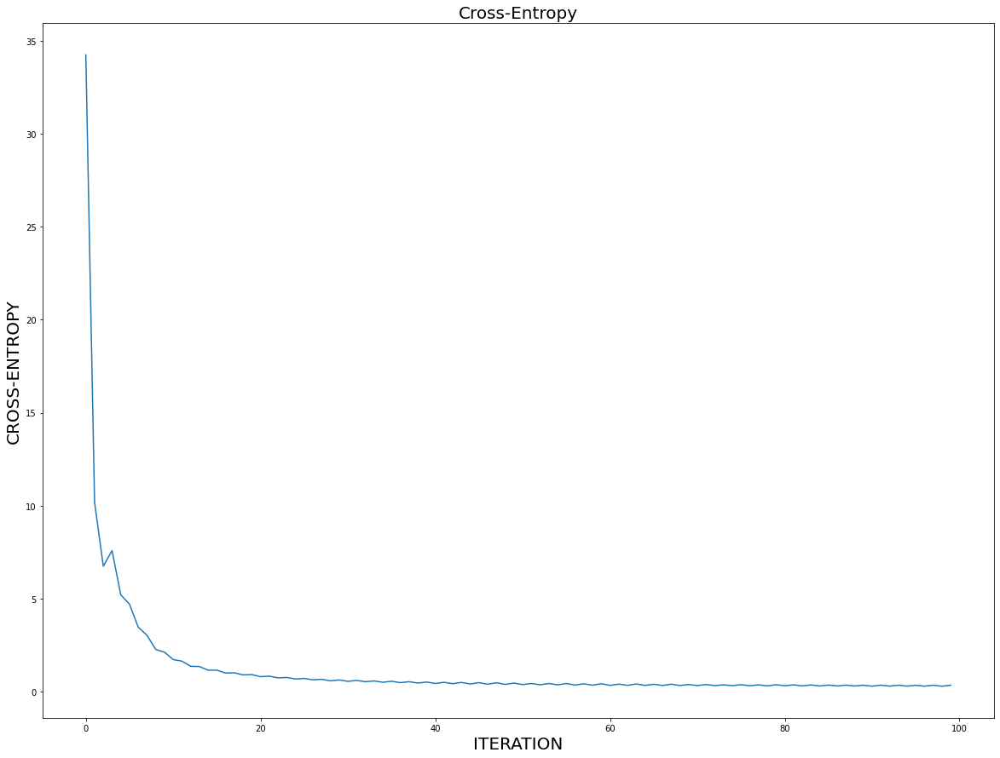

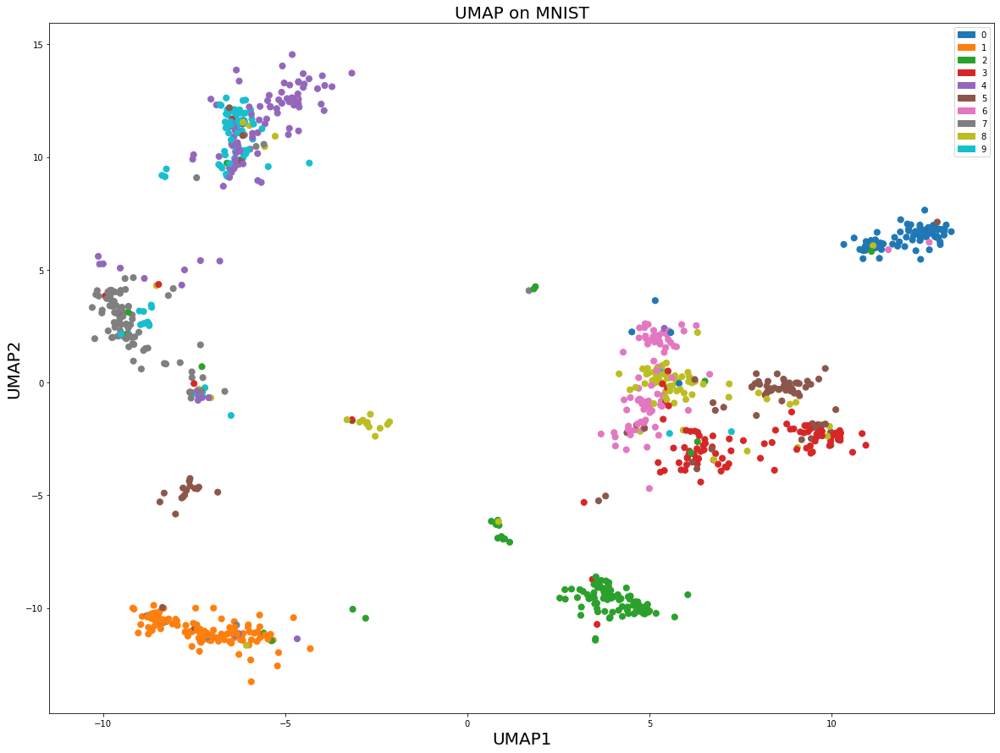


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 30.117160943488035 after 0 iterations
Cross-Entropy = 2.104381927160656 after 10 iterations
Cross-Entropy = 0.9276850252954206 after 20 iterations
Cross-Entropy = 0.6348696975022943 after 30 iterations
Cross-Entropy = 0.5005198727270752 after 40 iterations
Cross-Entropy = 0.42895442014567464 after 50 iterations
Cross-Entropy = 0.38566013169127605 after 60 iterations
Cross-Entropy = 0.34976855473370766 after 70 iterations
Cross-

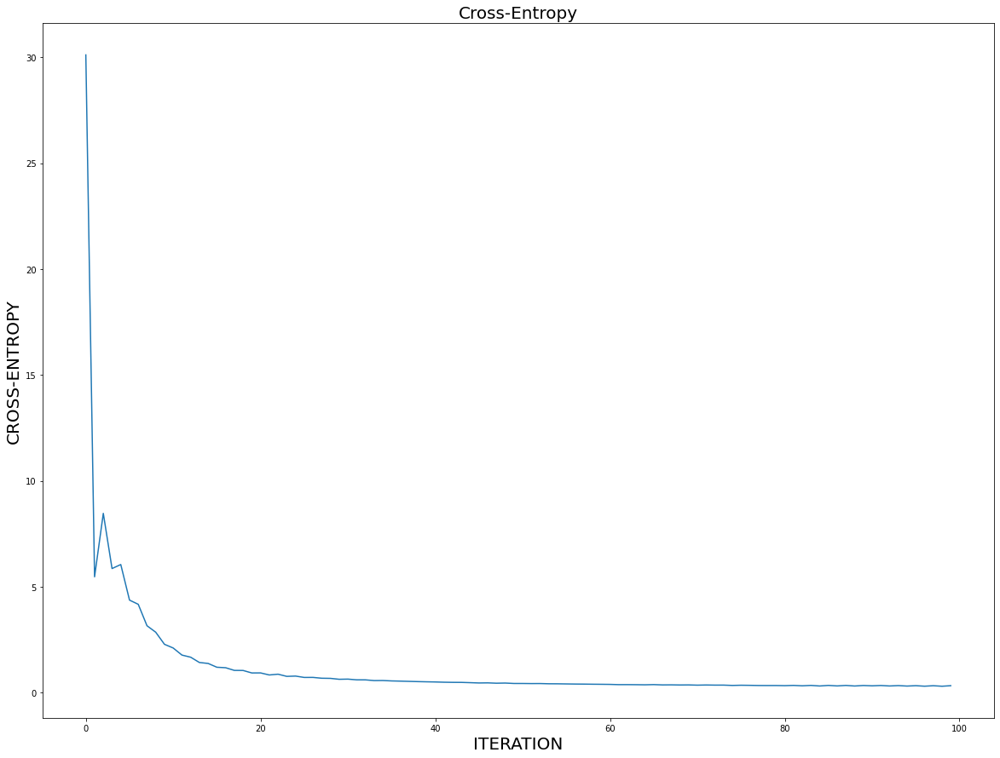

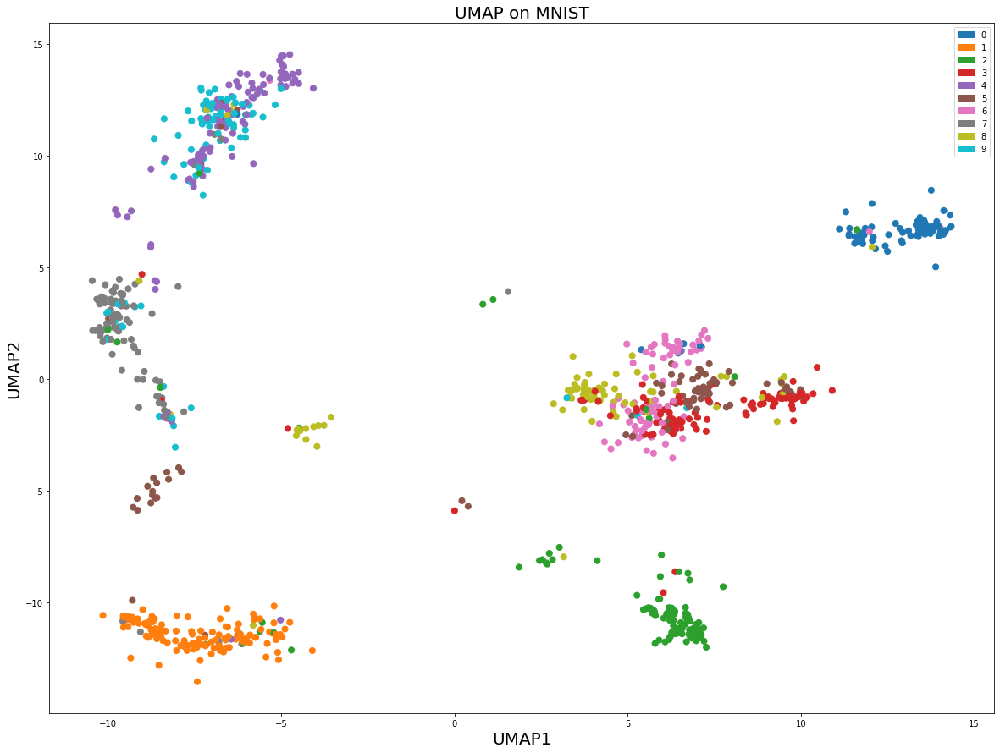


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 36.97525050505365 after 0 iterations
Cross-Entropy = 1.4831716250583369 after 10 iterations
Cross-Entropy = 0.7041363971227174 after 20 iterations
Cross-Entropy = 0.5081898951152614 after 30 iterations
Cross-Entropy = 0.42263601322959926 after 40 iterations
Cross-Entropy = 0.3802239409964221 after 50 iterations
Cross-Entropy = 0.356698978883036 after 60 iterations
Cross-Entropy = 0.35007497541014726 after 70 iterations
Cross-En

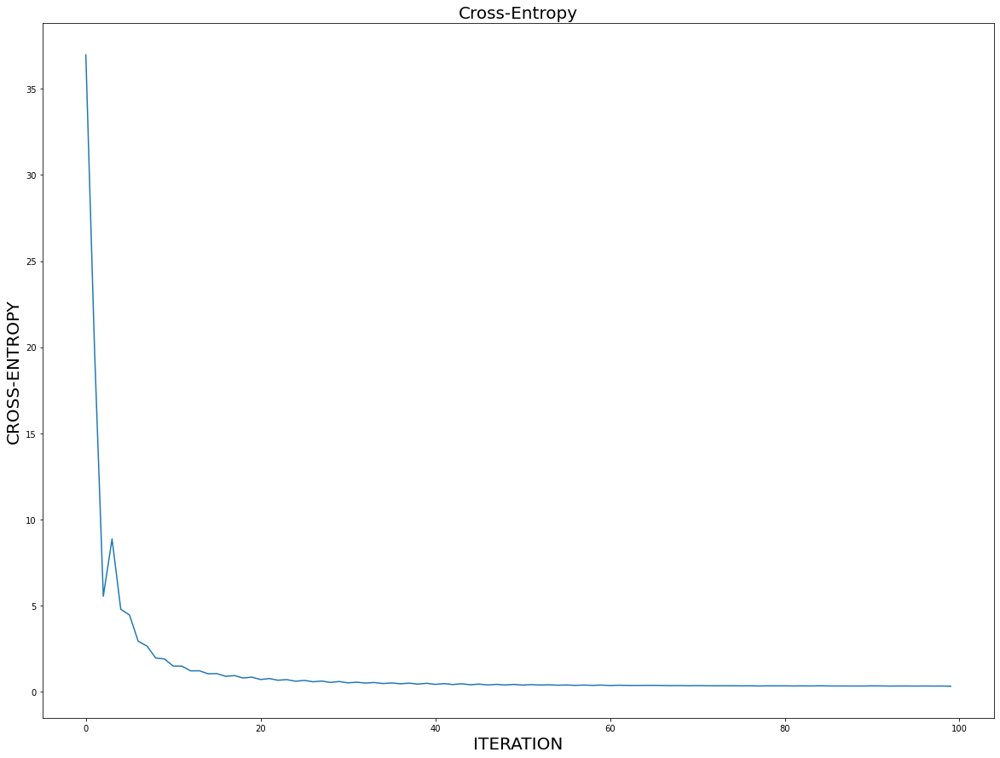

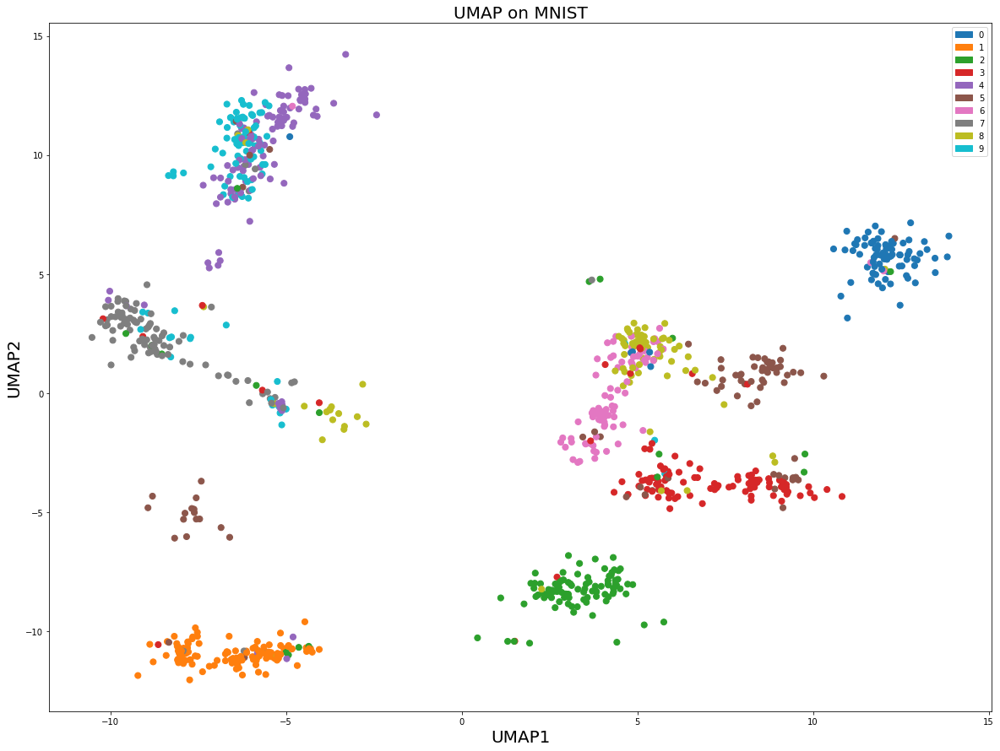


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 43.693876366829556 after 0 iterations
Cross-Entropy = 1.2930017079718494 after 10 iterations
Cross-Entropy = 0.6352104105781536 after 20 iterations
Cross-Entropy = 0.46440640765955665 after 30 iterations
Cross-Entropy = 0.39146967511273256 after 40 iterations
Cross-Entropy = 0.3600855165229786 after 50 iterations
Cross-Entropy = 0.34232801993694667 after 60 iterations
Cross-Entropy = 0.33659905909672083 after 70 iterations
Cros

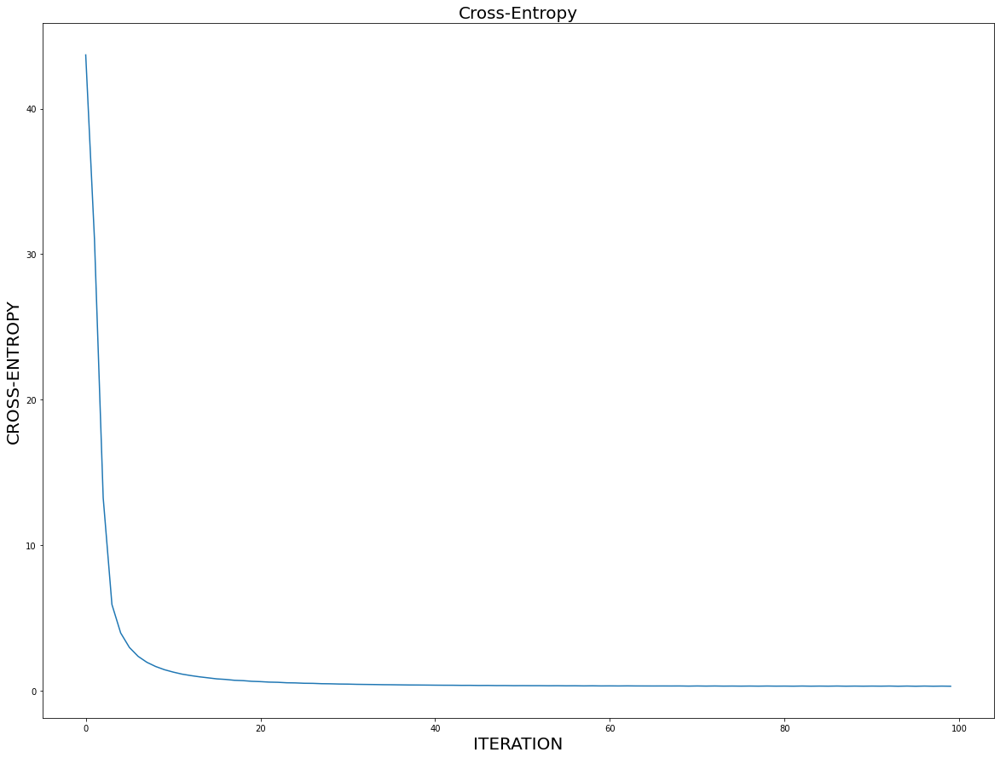

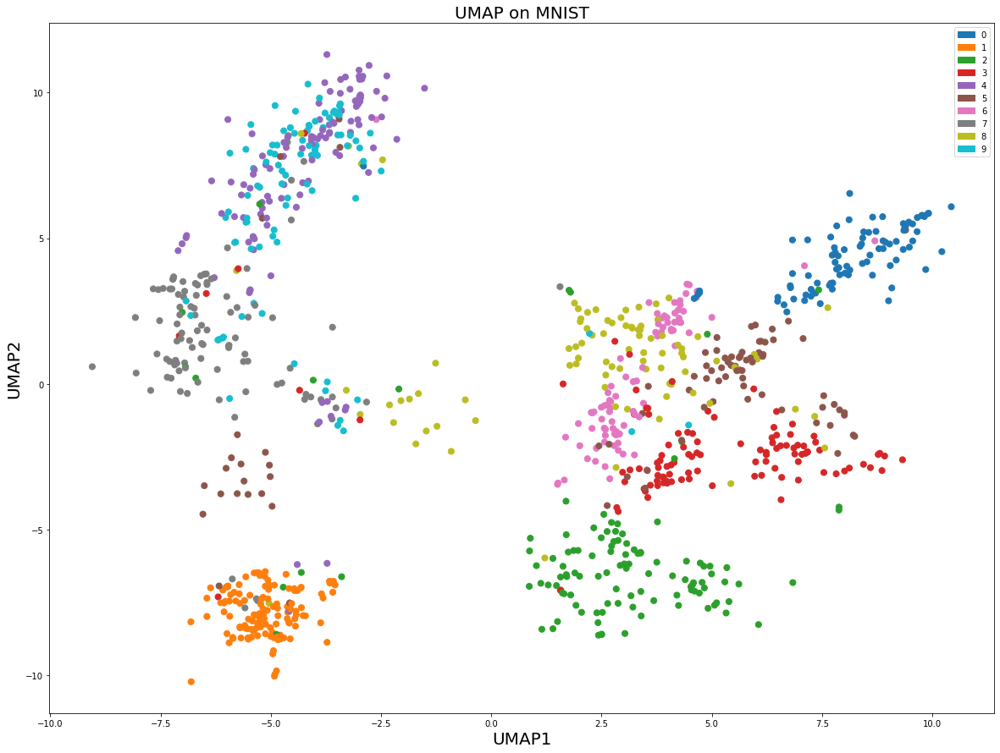


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 106.09798412303905
Running Gradient Descent: 

Cross-Entropy = 45.59706784505951 after 0 iterations
Cross-Entropy = 0.993842150080585 after 10 iterations
Cross-Entropy = 0.5703493113686164 after 20 iterations
Cross-Entropy = 0.4579875147402165 after 30 iterations
Cross-Entropy = 0.405294104773787 after 40 iterations
Cross-Entropy = 0.3780870289405571 after 50 iterations
Cross-Entropy = 0.3610909699028697 after 60 iterations
Cross-Entropy = 0.348865253829283 after 70 iterations
Cross-Entrop

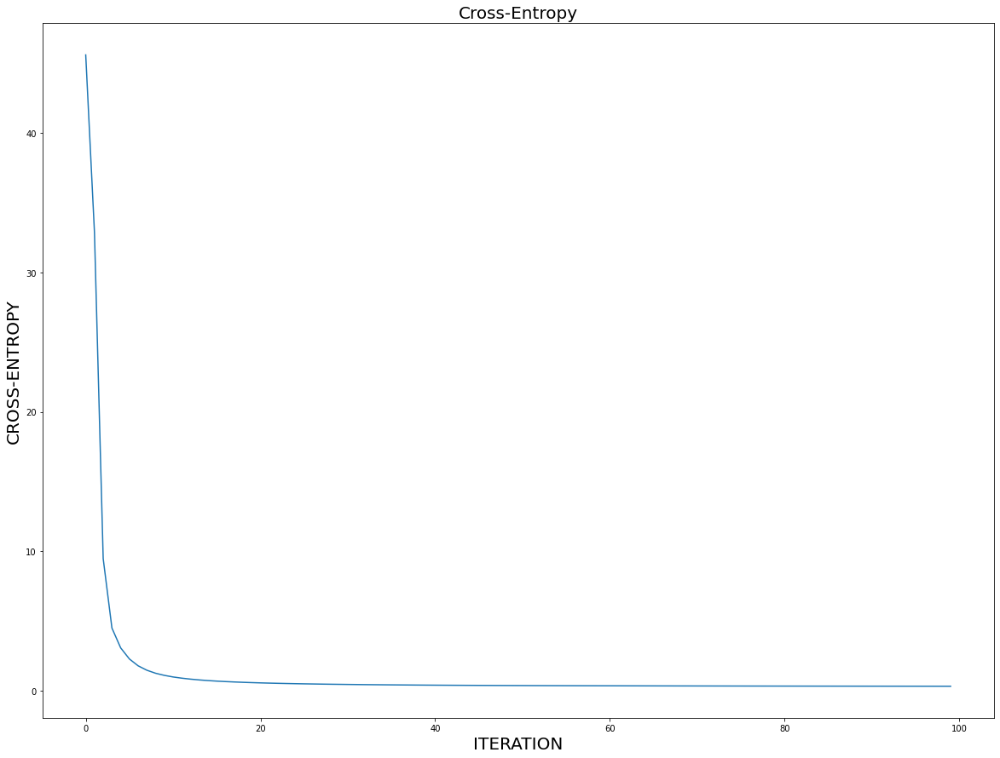

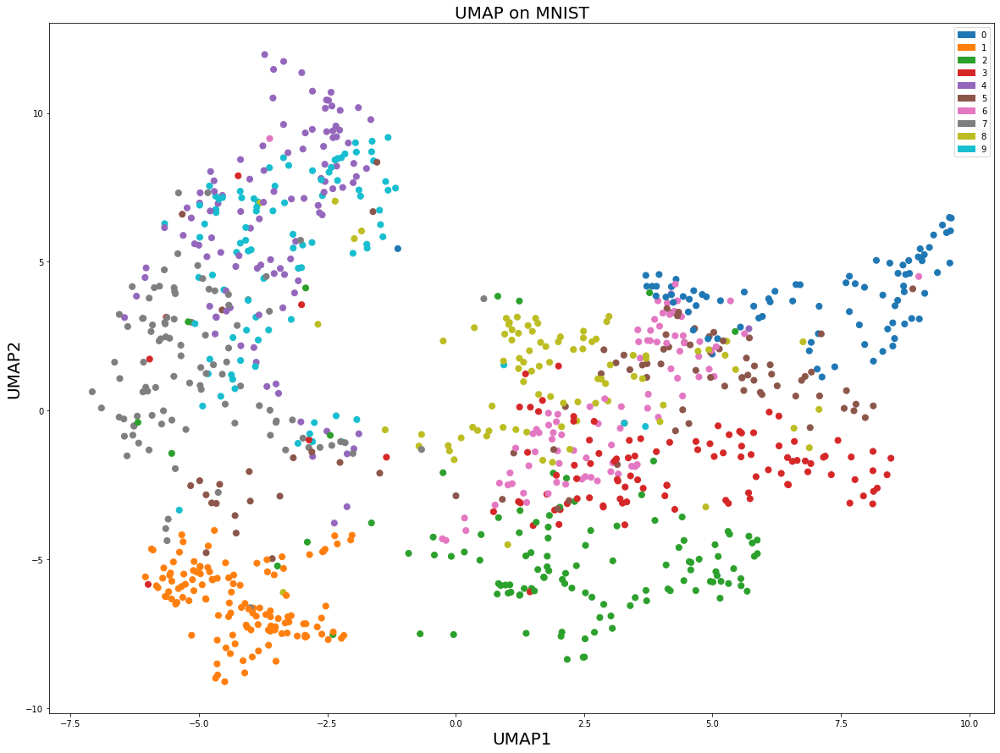


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 28.96432986635752 after 0 iterations
Cross-Entropy = 2.49136809221728 after 10 iterations
Cross-Entropy = 1.0529020462029242 after 20 iterations
Cross-Entropy = 0.7324034271045258 after 30 iterations
Cross-Entropy = 0.5660191831020737 after 40 iterations
Cross-Entropy = 0.49935843238224886 after 50 iterations
Cross-Entropy = 0.45052368566857637 after 60 iterations
Cross-Entropy = 0.4349755515103555 after 70 iterations
Cross-Ent

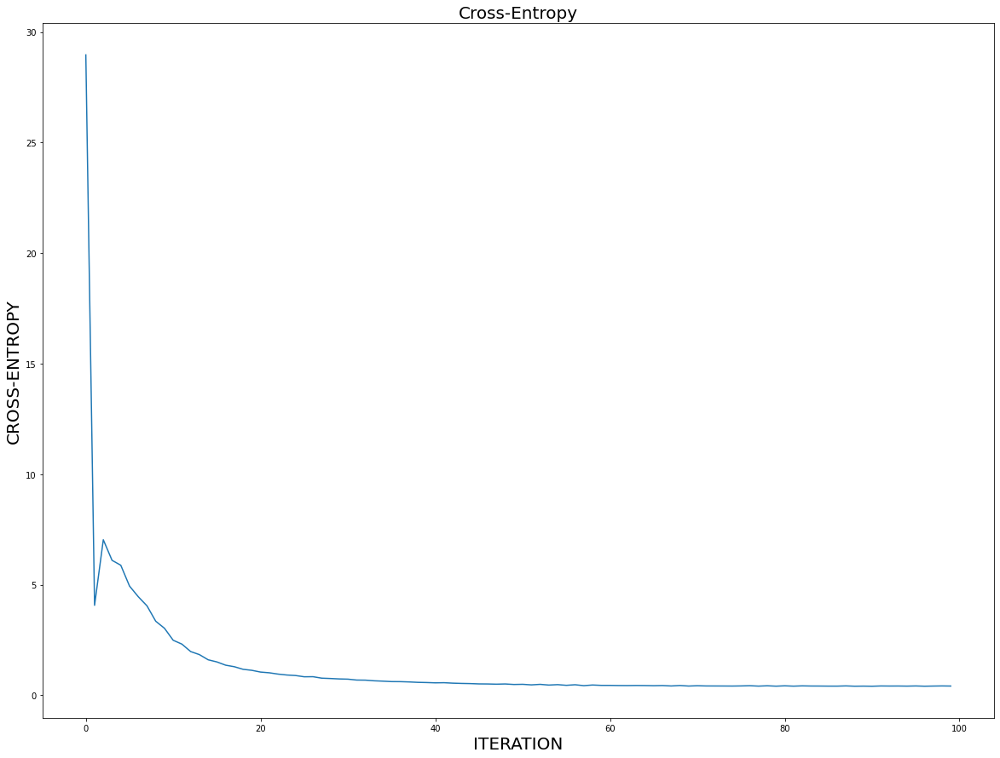

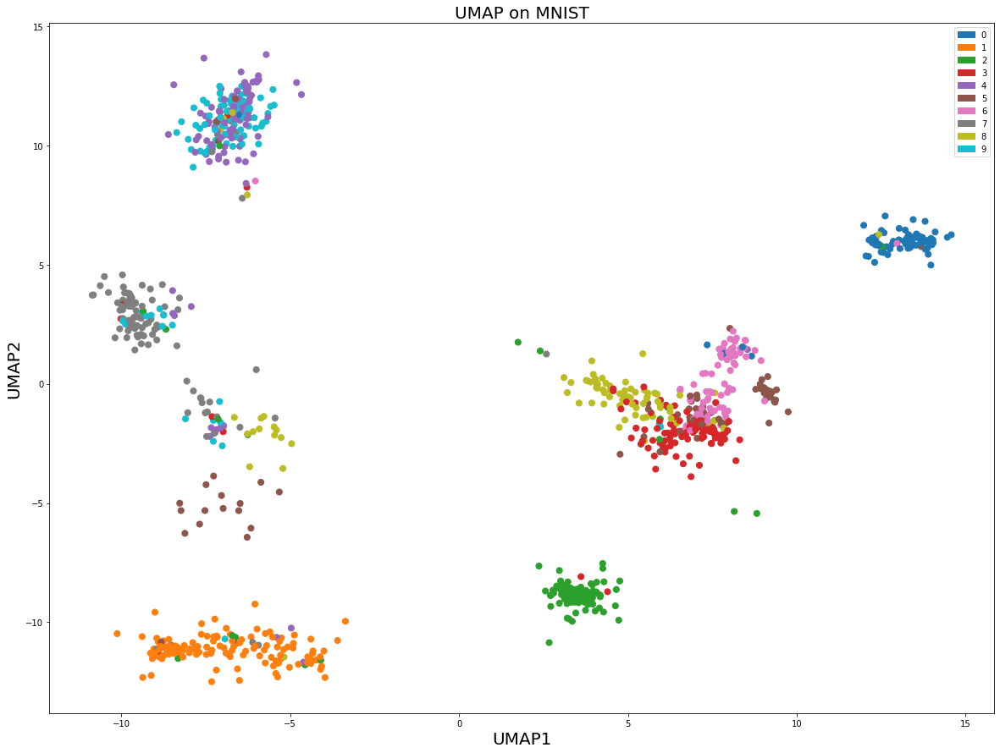


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 32.38714588053597 after 0 iterations
Cross-Entropy = 2.3037568767493077 after 10 iterations
Cross-Entropy = 0.9936681096917775 after 20 iterations
Cross-Entropy = 0.6888760621708875 after 30 iterations
Cross-Entropy = 0.5525002153633294 after 40 iterations
Cross-Entropy = 0.489410109054017 after 50 iterations
Cross-Entropy = 0.4461889314735062 after 60 iterations
Cross-Entropy = 0.42321722538344014 after 70 iterations
Cross-Ent

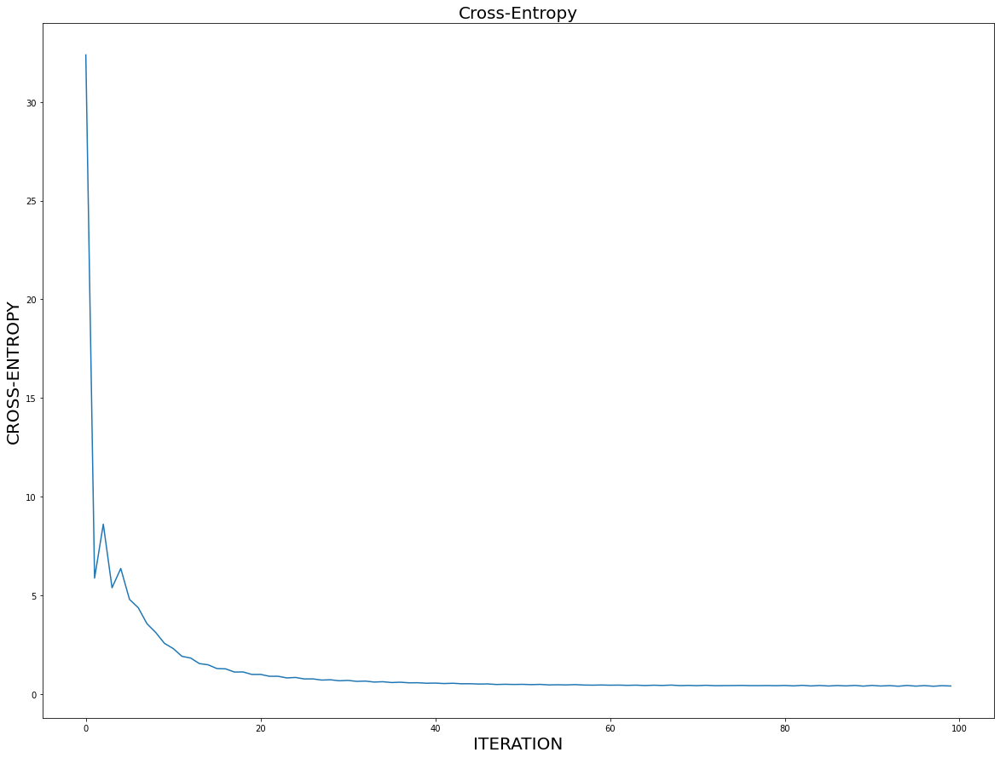

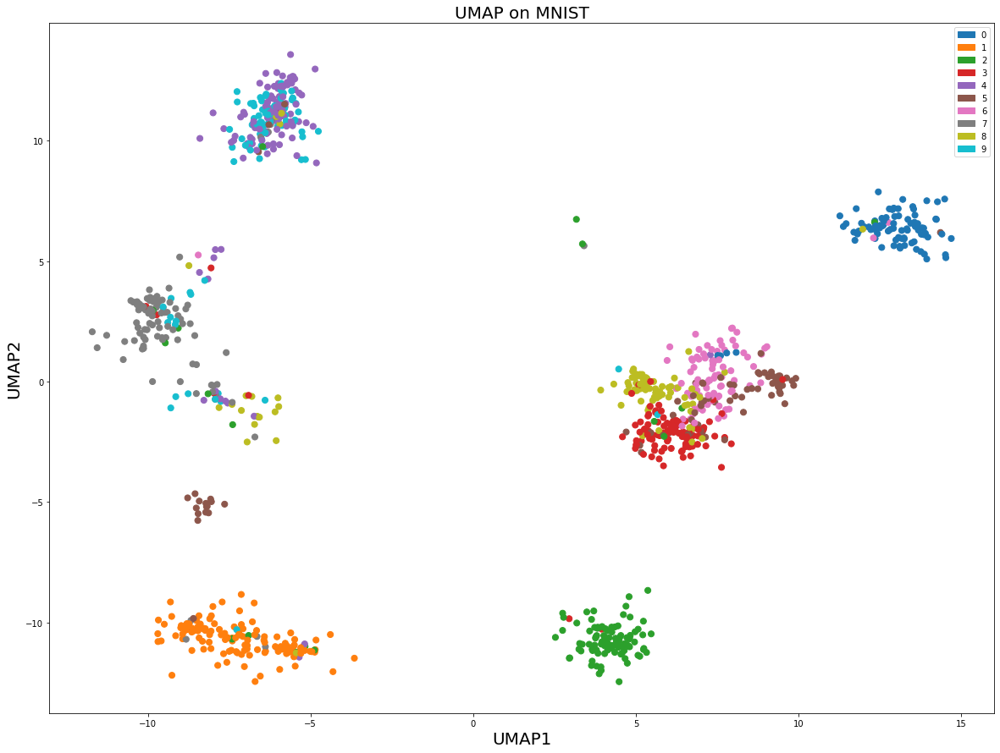


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 35.03182333841747 after 0 iterations
Cross-Entropy = 1.9438783573277312 after 10 iterations
Cross-Entropy = 0.8669405333084408 after 20 iterations
Cross-Entropy = 0.6269851072419977 after 30 iterations
Cross-Entropy = 0.5353509362334933 after 40 iterations
Cross-Entropy = 0.46852979708990156 after 50 iterations
Cross-Entropy = 0.44387085170975815 after 60 iterations
Cross-Entropy = 0.4412542213361189 after 70 iterations
Cross-E

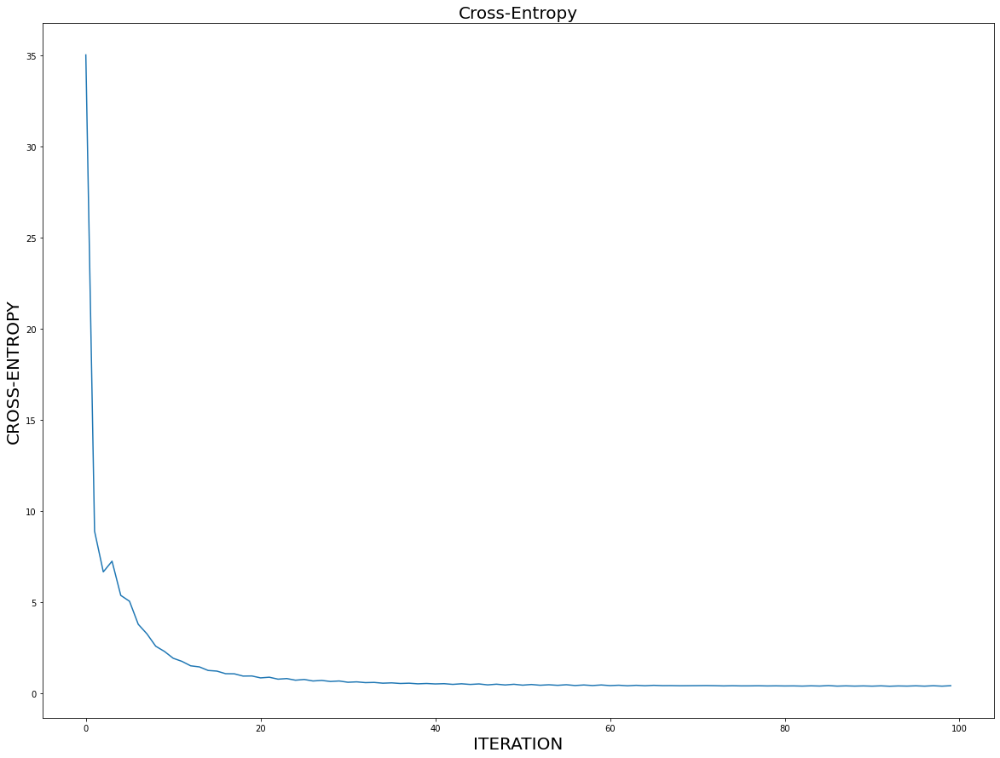

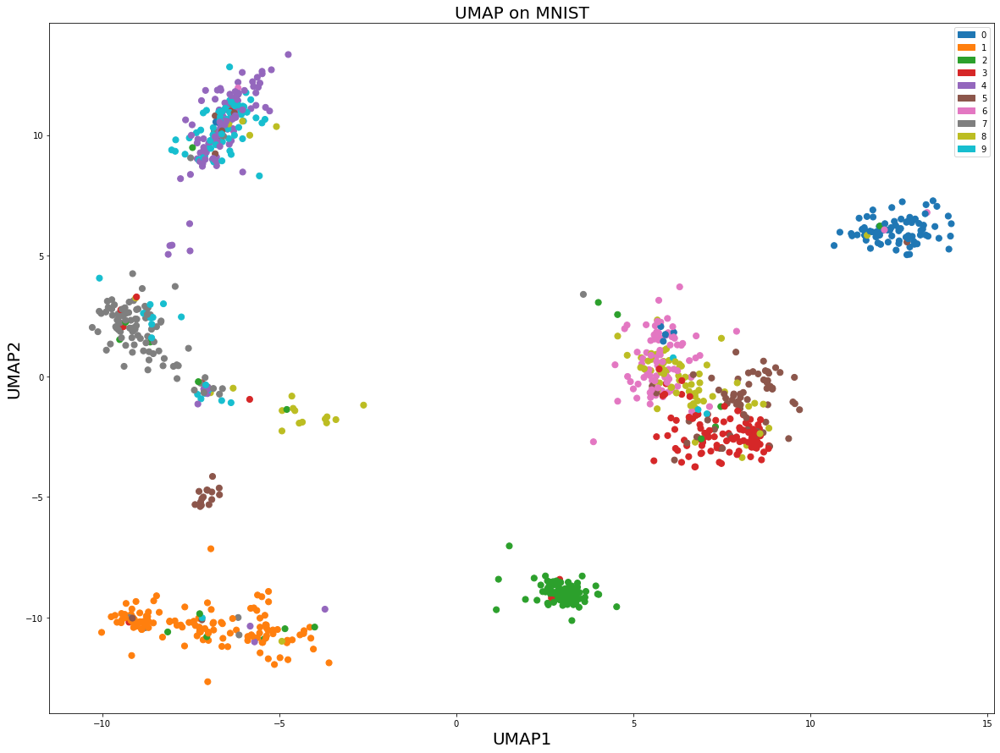


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 30.34064895898404 after 0 iterations
Cross-Entropy = 2.4905519677412737 after 10 iterations
Cross-Entropy = 1.0590986628621553 after 20 iterations
Cross-Entropy = 0.7363375262232217 after 30 iterations
Cross-Entropy = 0.6042631573837678 after 40 iterations
Cross-Entropy = 0.5284571533363007 after 50 iterations
Cross-Entropy = 0.48101164466031315 after 60 iterations
Cross-Entropy = 0.4632236558133103 after 70 iterations
Cross-En

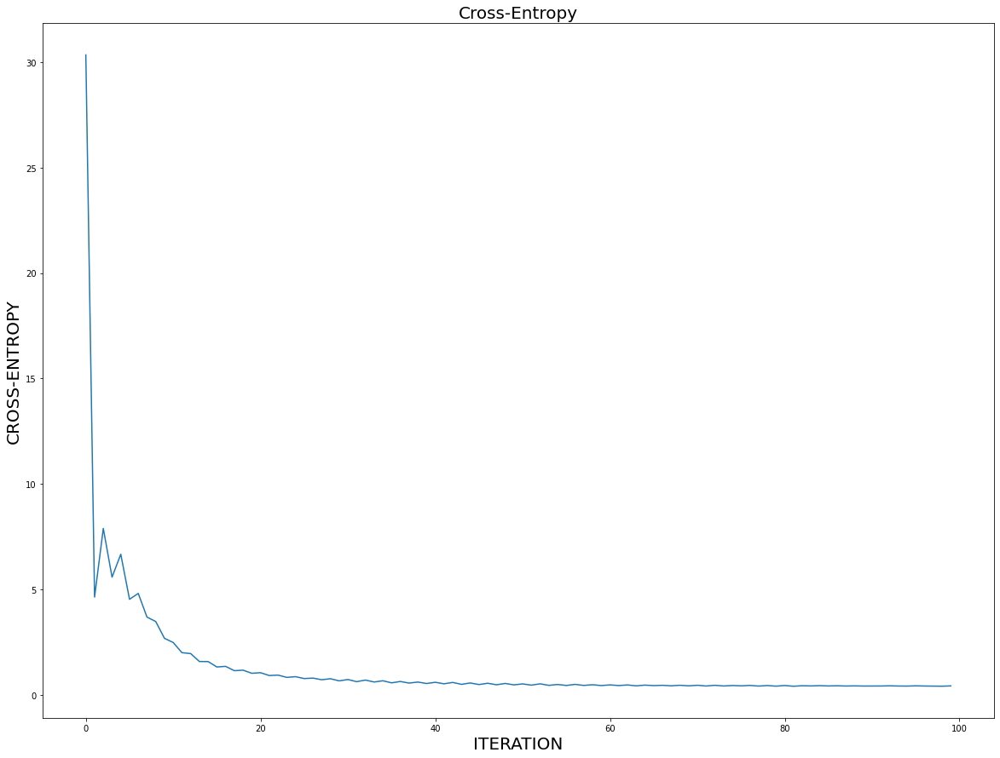

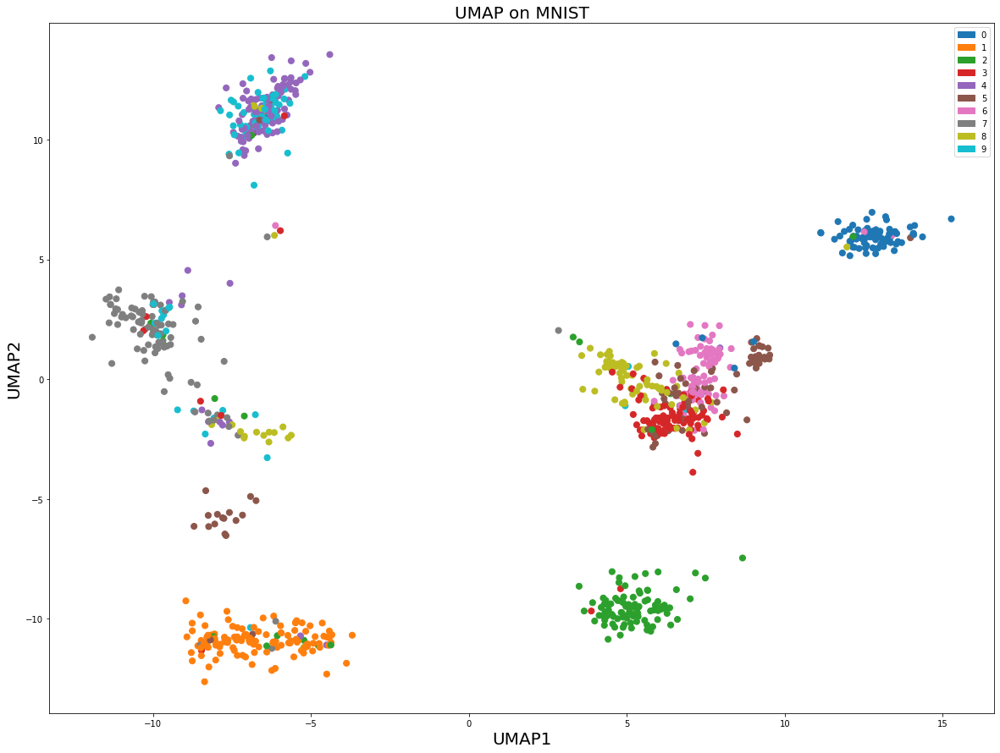


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 37.94302932492462 after 0 iterations
Cross-Entropy = 1.6234689730748144 after 10 iterations
Cross-Entropy = 0.7995231518733623 after 20 iterations
Cross-Entropy = 0.5847471533057244 after 30 iterations
Cross-Entropy = 0.5049040658416059 after 40 iterations
Cross-Entropy = 0.47274488087135697 after 50 iterations
Cross-Entropy = 0.43179442781366556 after 60 iterations
Cross-Entropy = 0.4128394080690889 after 70 iterations
Cross-E

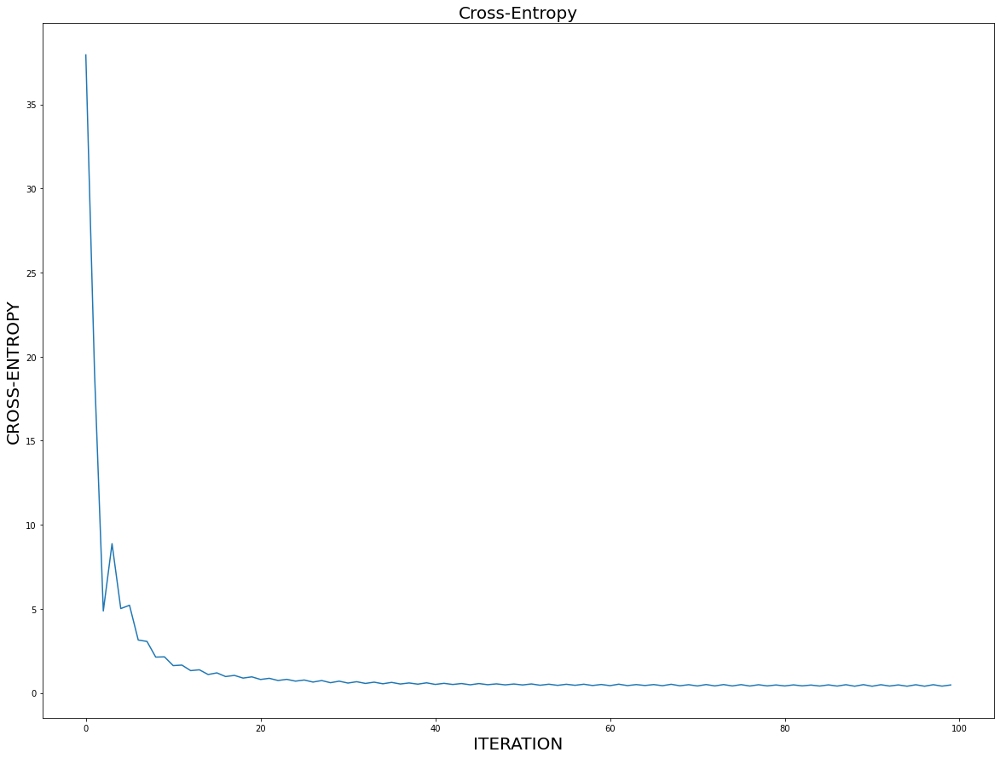

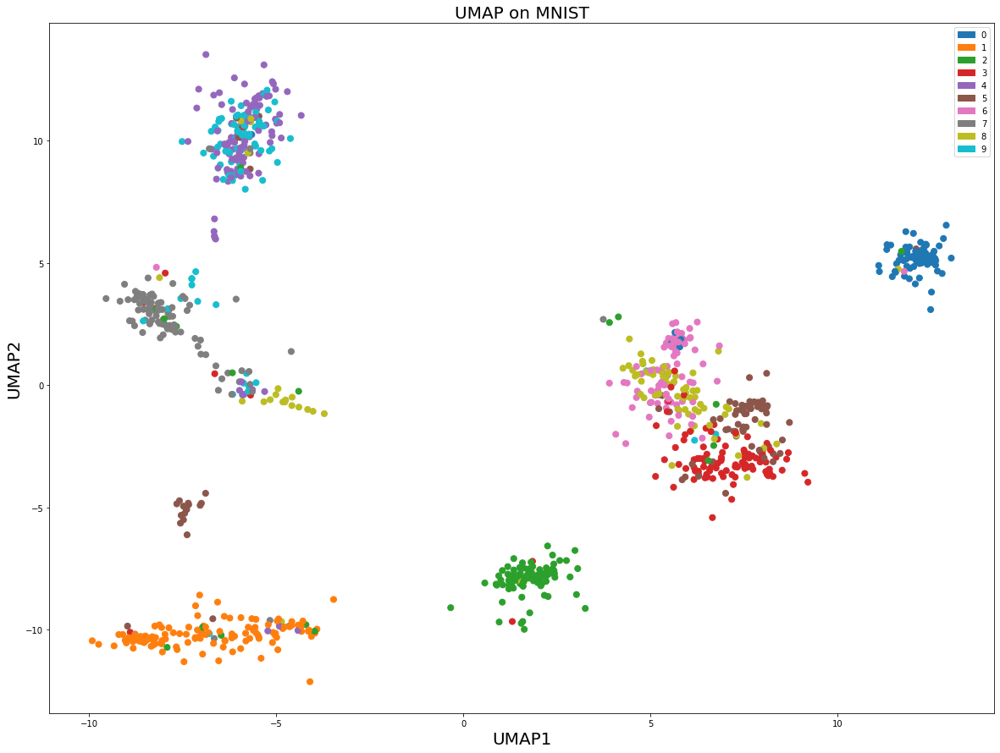


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 44.0689444293751 after 0 iterations
Cross-Entropy = 1.3913886828853737 after 10 iterations
Cross-Entropy = 0.7018525831550083 after 20 iterations
Cross-Entropy = 0.5529065114254934 after 30 iterations
Cross-Entropy = 0.4923971063674887 after 40 iterations
Cross-Entropy = 0.4621959255133272 after 50 iterations
Cross-Entropy = 0.44411635407145084 after 60 iterations
Cross-Entropy = 0.4415591026683266 after 70 iterations
Cross-Ent

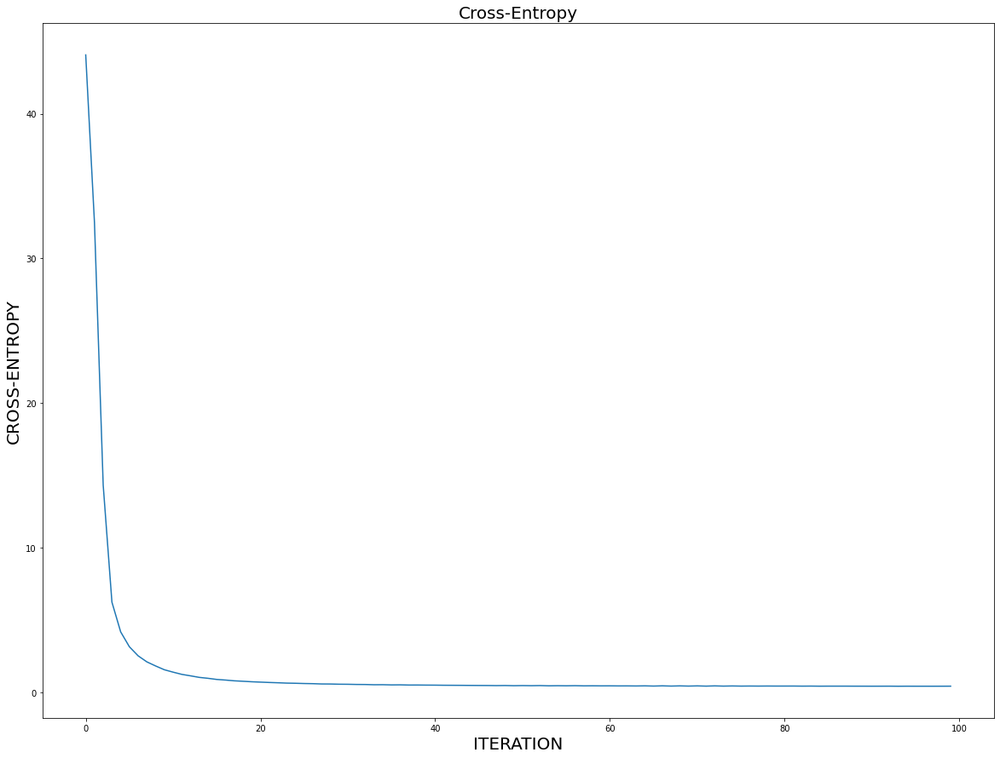

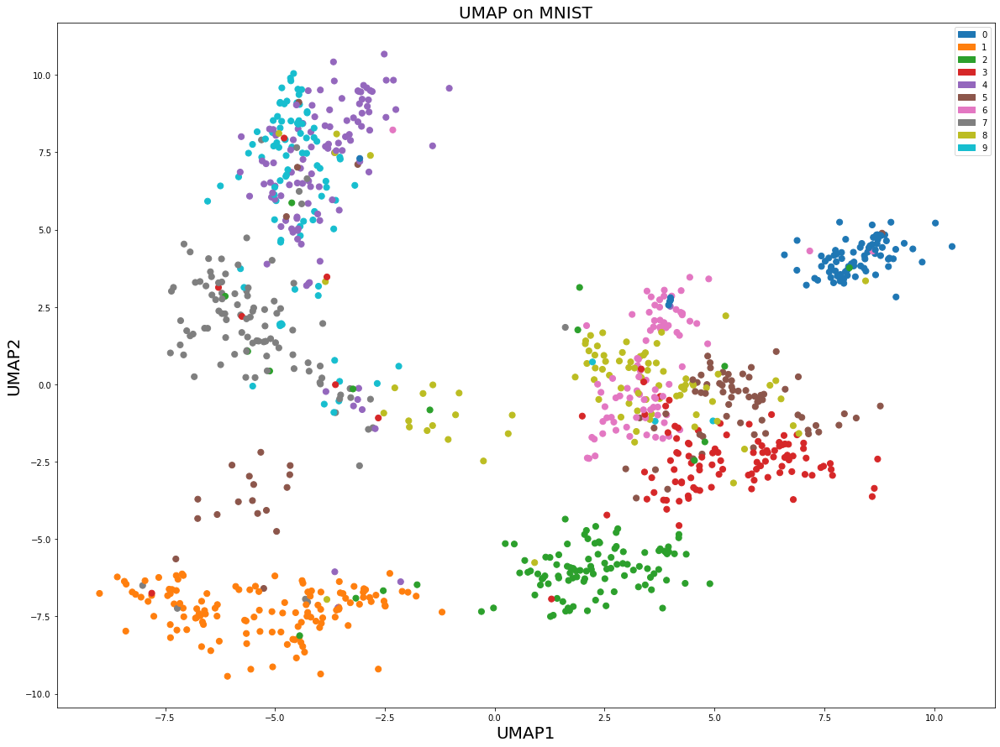


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 122.91688031262464
Running Gradient Descent: 

Cross-Entropy = 45.65189169388662 after 0 iterations
Cross-Entropy = 1.0709720503829698 after 10 iterations
Cross-Entropy = 0.6736910770393992 after 20 iterations
Cross-Entropy = 0.574994033694131 after 30 iterations
Cross-Entropy = 0.5259322482412733 after 40 iterations
Cross-Entropy = 0.4968874679350929 after 50 iterations
Cross-Entropy = 0.4808401148531049 after 60 iterations
Cross-Entropy = 0.46975167259993417 after 70 iterations
Cross-Ent

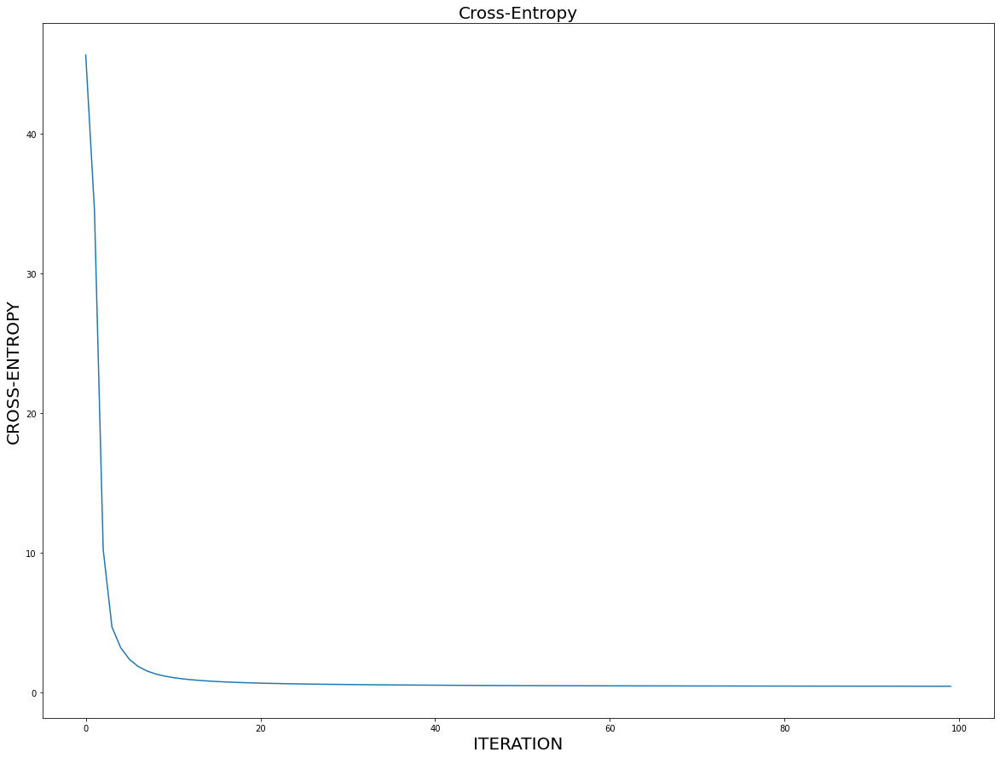

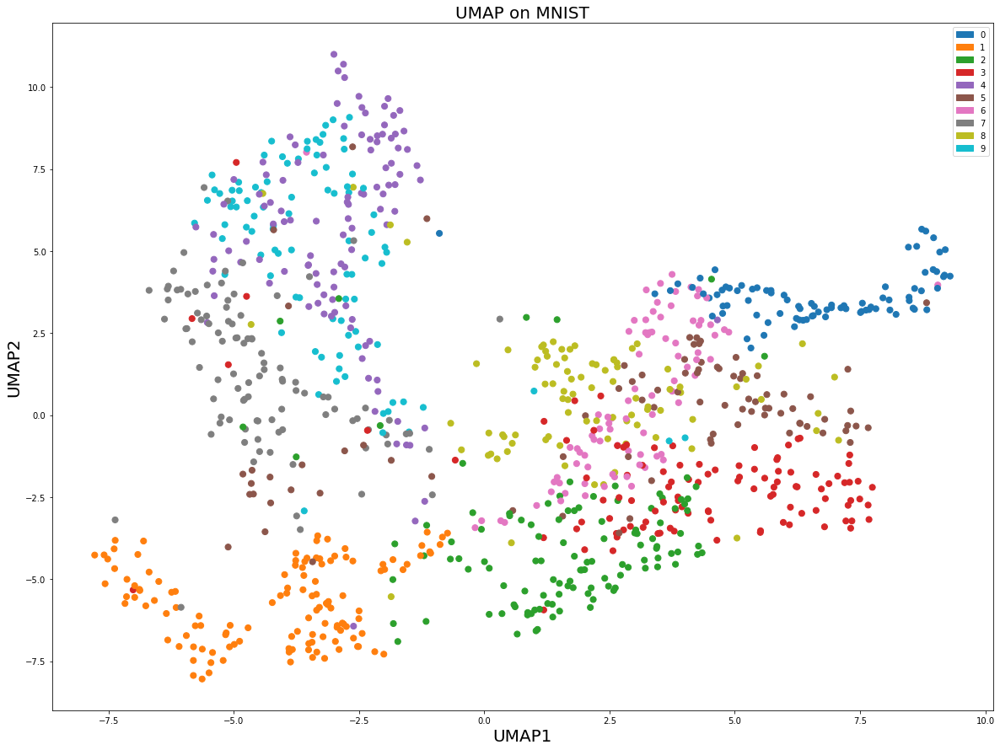


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 28.993008909200835 after 0 iterations
Cross-Entropy = 3.114113549171811 after 10 iterations
Cross-Entropy = 1.299014952747074 after 20 iterations
Cross-Entropy = 0.8711322502196879 after 30 iterations
Cross-Entropy = 0.679649699229724 after 40 iterations
Cross-Entropy = 0.5809924688391594 after 50 iterations
Cross-Entropy = 0.5261534657336913 after 60 iterations
Cross-Entropy = 0.4940610590948507 after 70 iterations
Cross-Entro

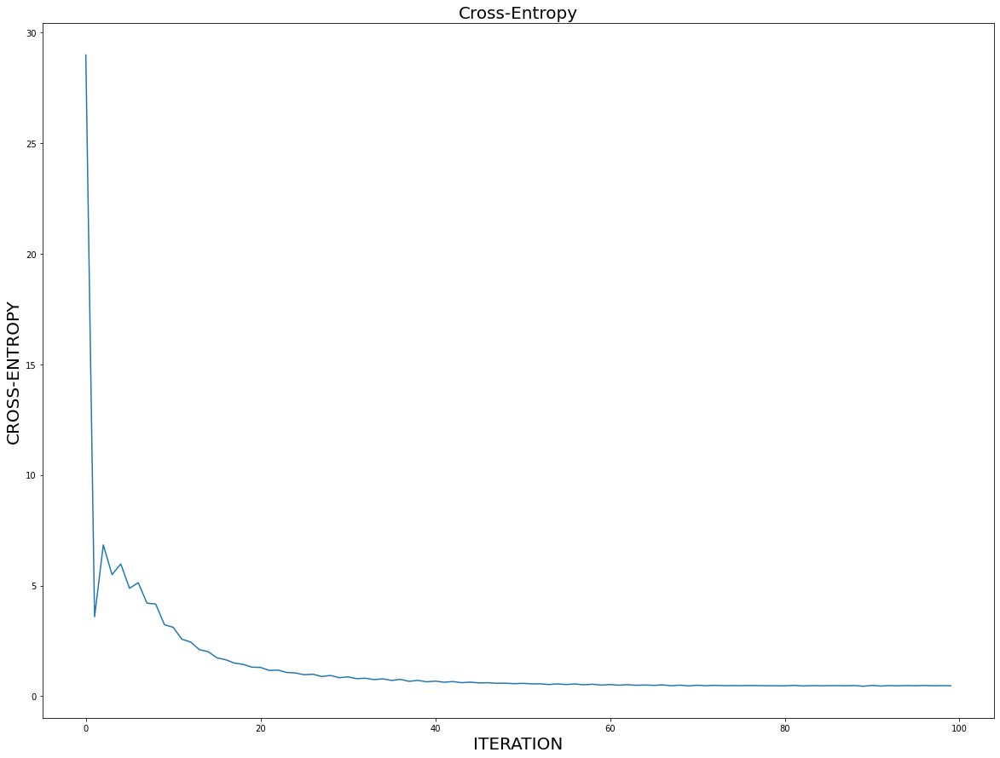

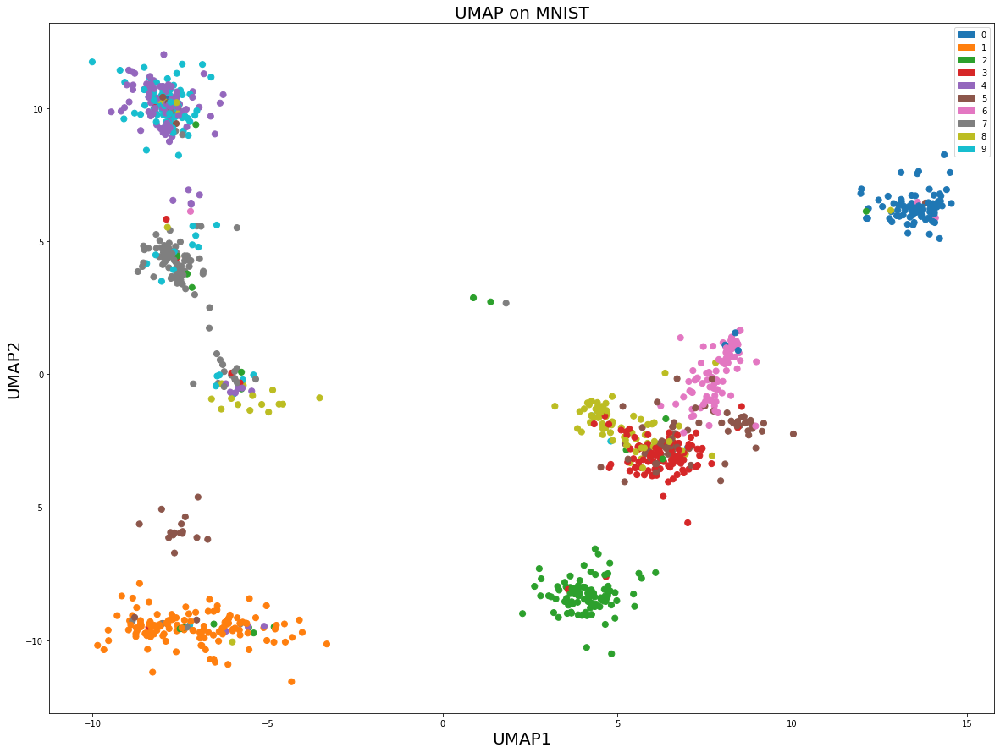


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 32.72850800797401 after 0 iterations
Cross-Entropy = 2.737753030400673 after 10 iterations
Cross-Entropy = 1.1325284454056812 after 20 iterations
Cross-Entropy = 0.7846536698633177 after 30 iterations
Cross-Entropy = 0.6319166509047651 after 40 iterations
Cross-Entropy = 0.579719924171413 after 50 iterations
Cross-Entropy = 0.5442153401182223 after 60 iterations
Cross-Entropy = 0.5100089525445285 after 70 iterations
Cross-Entro

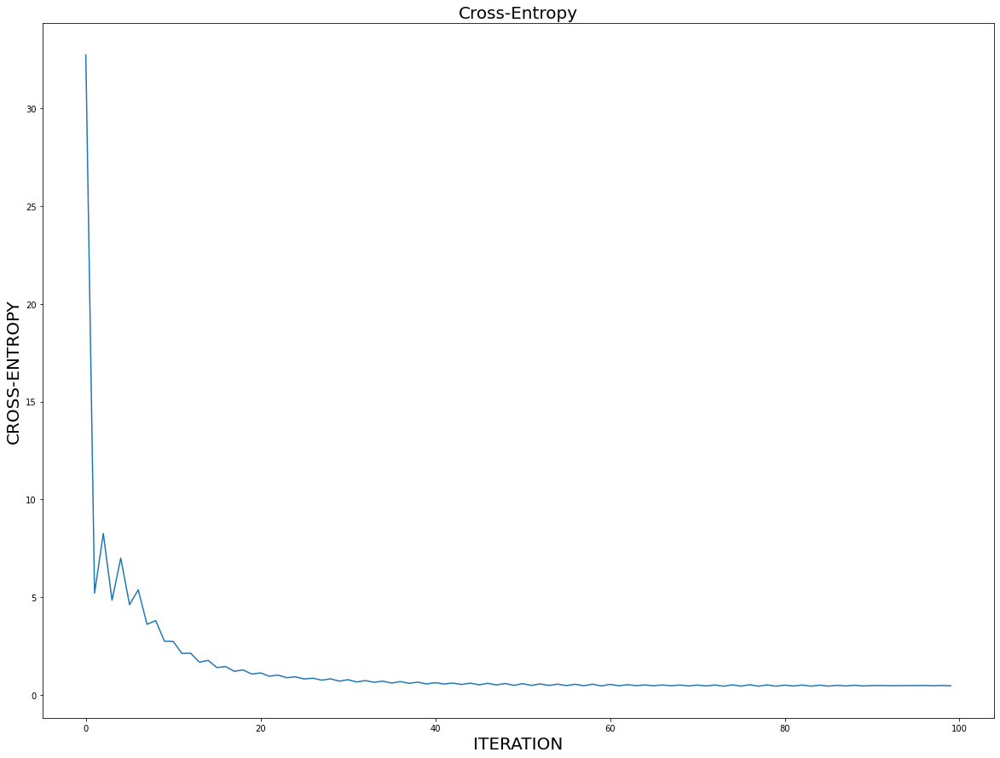

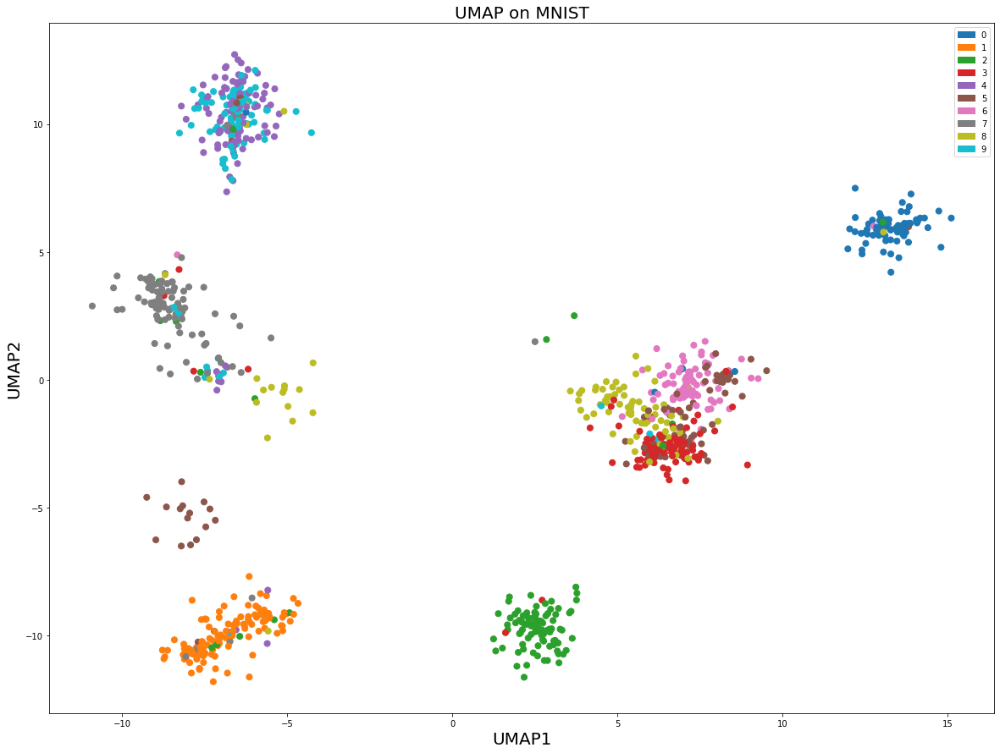


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 35.618588843478555 after 0 iterations
Cross-Entropy = 2.2492762287589714 after 10 iterations
Cross-Entropy = 0.9763468188393971 after 20 iterations
Cross-Entropy = 0.6823376318860321 after 30 iterations
Cross-Entropy = 0.573702100147222 after 40 iterations
Cross-Entropy = 0.5033584260001684 after 50 iterations
Cross-Entropy = 0.47360378879365567 after 60 iterations
Cross-Entropy = 0.4829227635888269 after 70 iterations
Cross-En

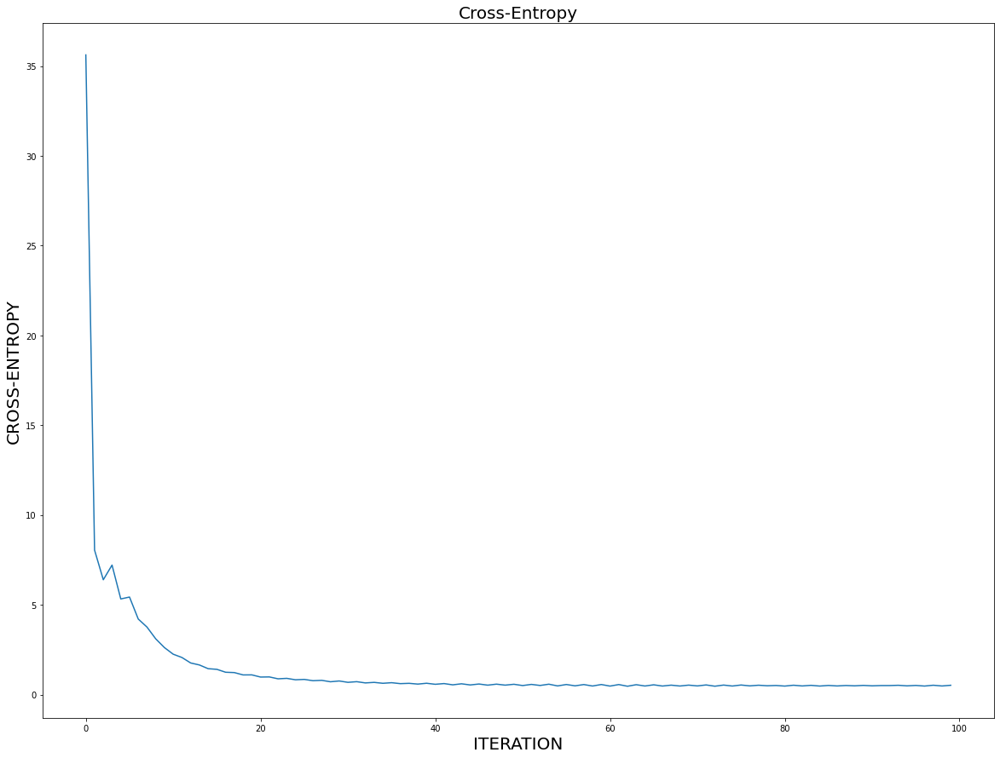

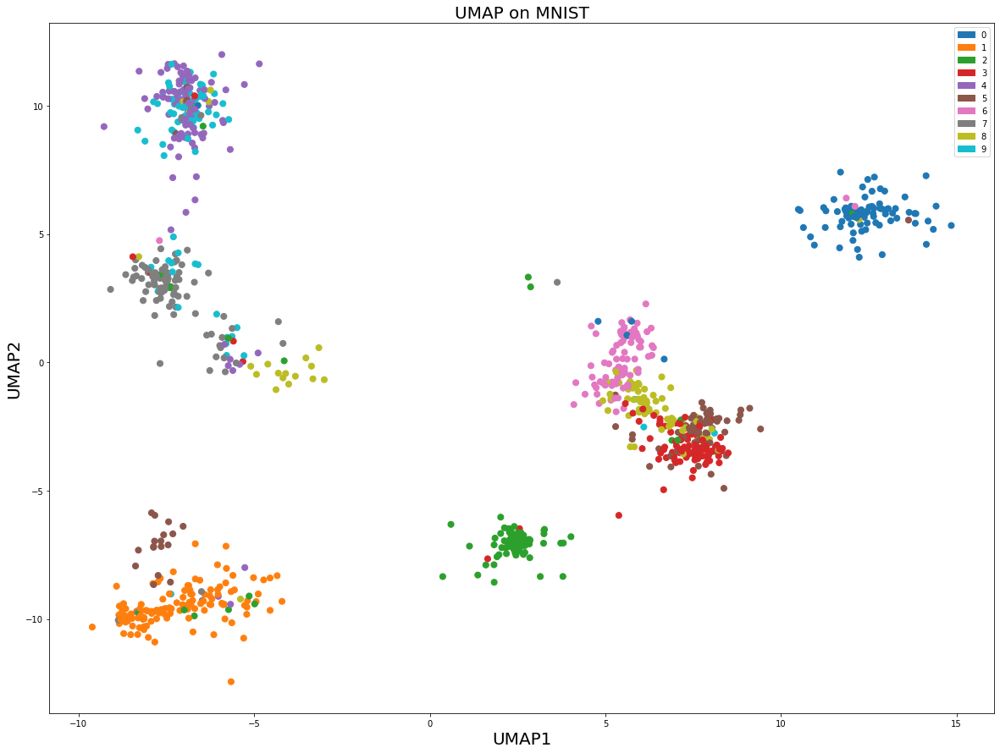


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 30.486325255728698 after 0 iterations
Cross-Entropy = 2.9486993879990147 after 10 iterations
Cross-Entropy = 1.208565841595351 after 20 iterations
Cross-Entropy = 0.7758831003736906 after 30 iterations
Cross-Entropy = 0.6228625801277524 after 40 iterations
Cross-Entropy = 0.5426884994570965 after 50 iterations
Cross-Entropy = 0.5106205158916259 after 60 iterations
Cross-Entropy = 0.5187415260355586 after 70 iterations
Cross-Ent

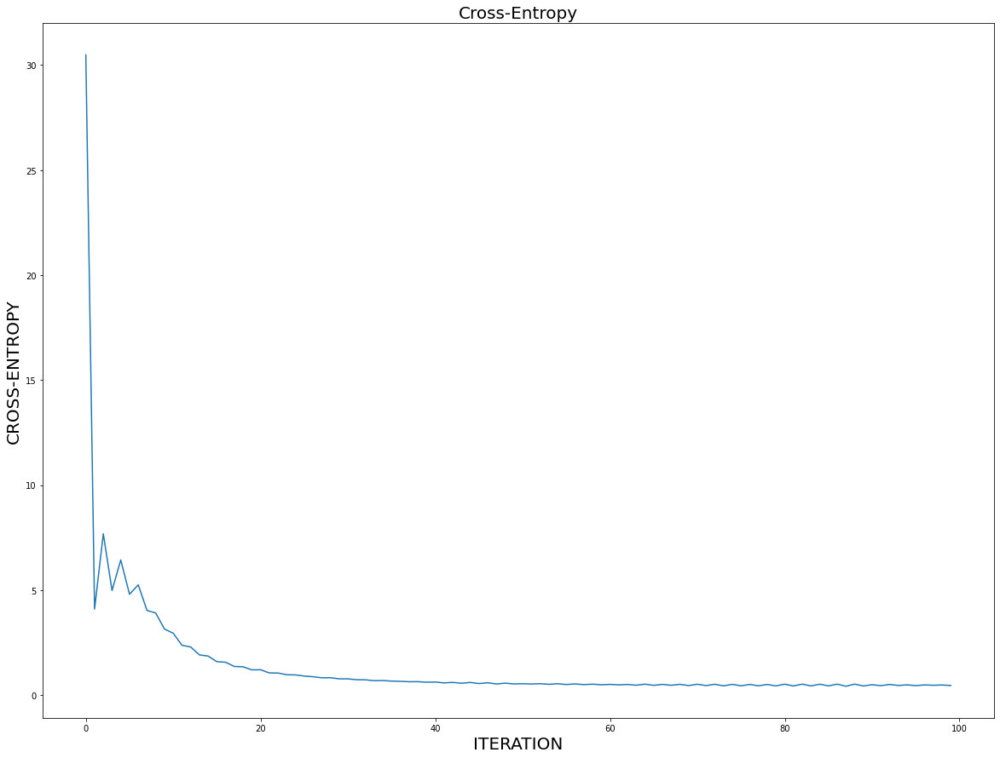

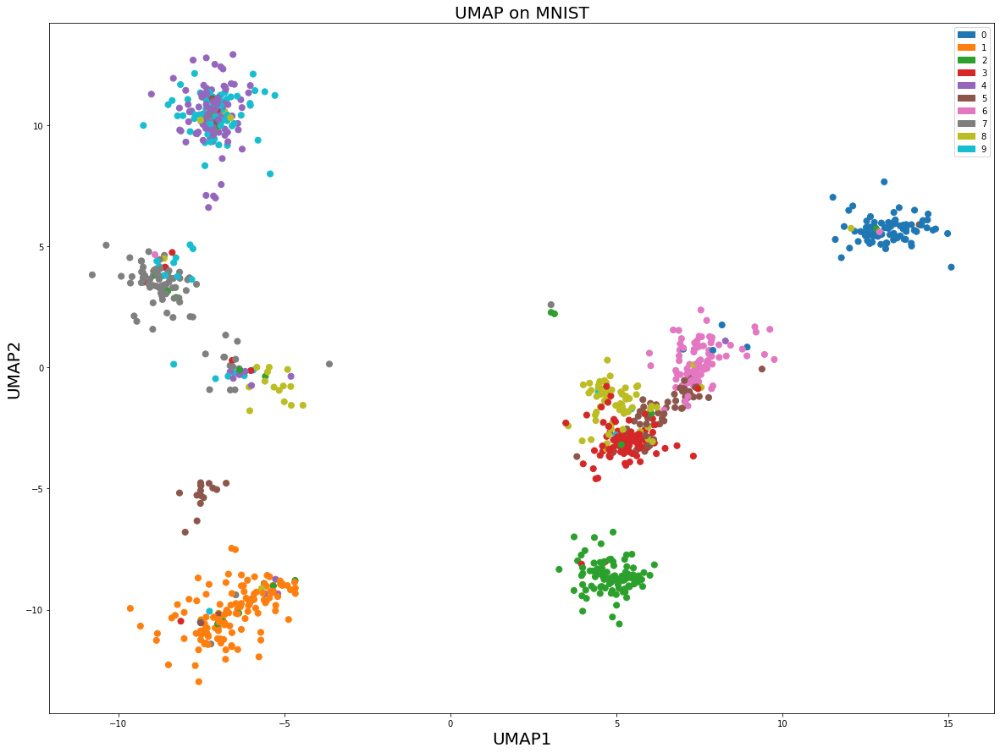


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 38.67052347607495 after 0 iterations
Cross-Entropy = 1.7068258807539571 after 10 iterations
Cross-Entropy = 0.8642551062984436 after 20 iterations
Cross-Entropy = 0.6317065463162909 after 30 iterations
Cross-Entropy = 0.543493108634313 after 40 iterations
Cross-Entropy = 0.5265929389242837 after 50 iterations
Cross-Entropy = 0.5059830342139826 after 60 iterations
Cross-Entropy = 0.48676145047425756 after 70 iterations
Cross-Ent

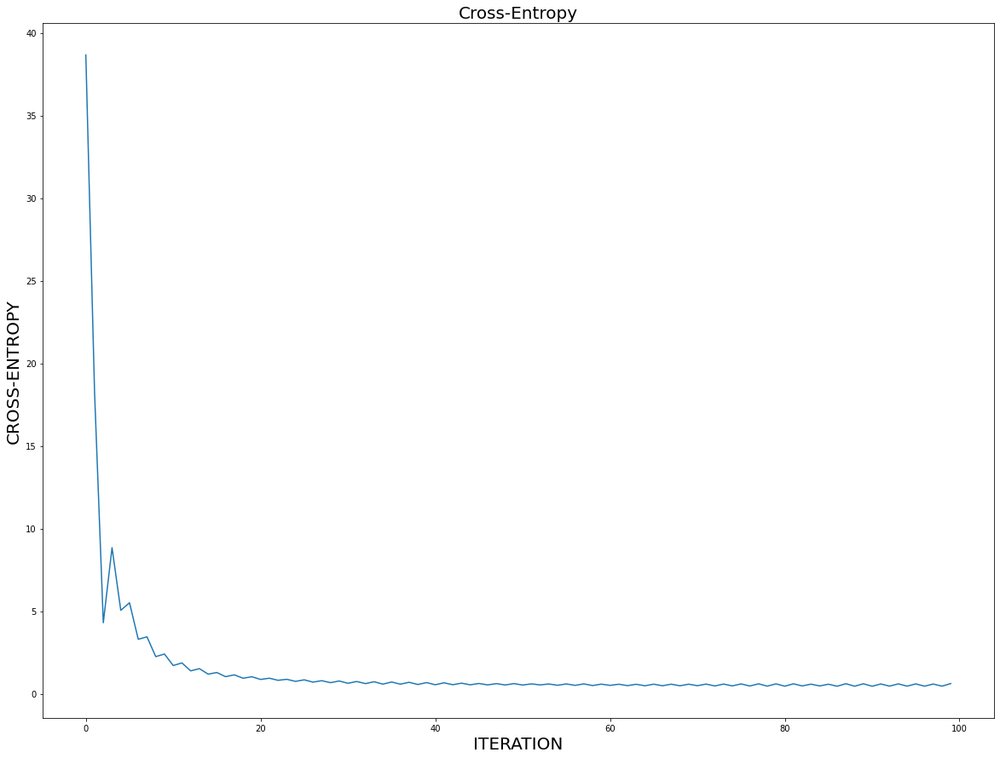

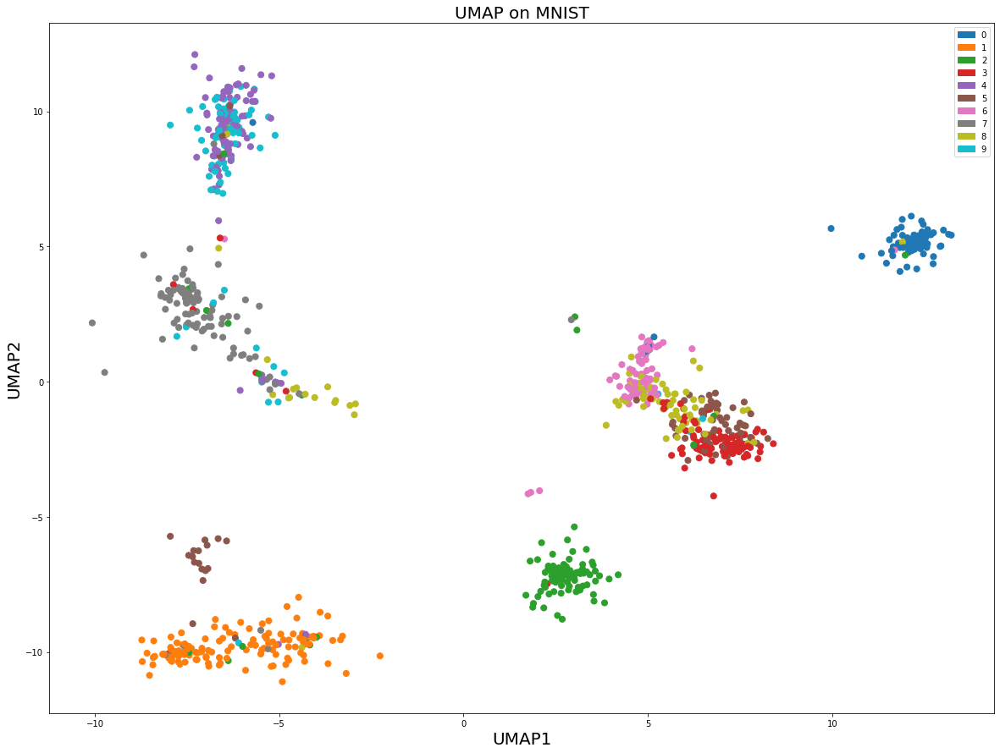


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 44.32846901412851 after 0 iterations
Cross-Entropy = 1.4223775819397713 after 10 iterations
Cross-Entropy = 0.7483650536450751 after 20 iterations
Cross-Entropy = 0.6054017807386338 after 30 iterations
Cross-Entropy = 0.5475290548830297 after 40 iterations
Cross-Entropy = 0.5381566439482063 after 50 iterations
Cross-Entropy = 0.5234291301580782 after 60 iterations
Cross-Entropy = 0.5170025315985356 after 70 iterations
Cross-Ent

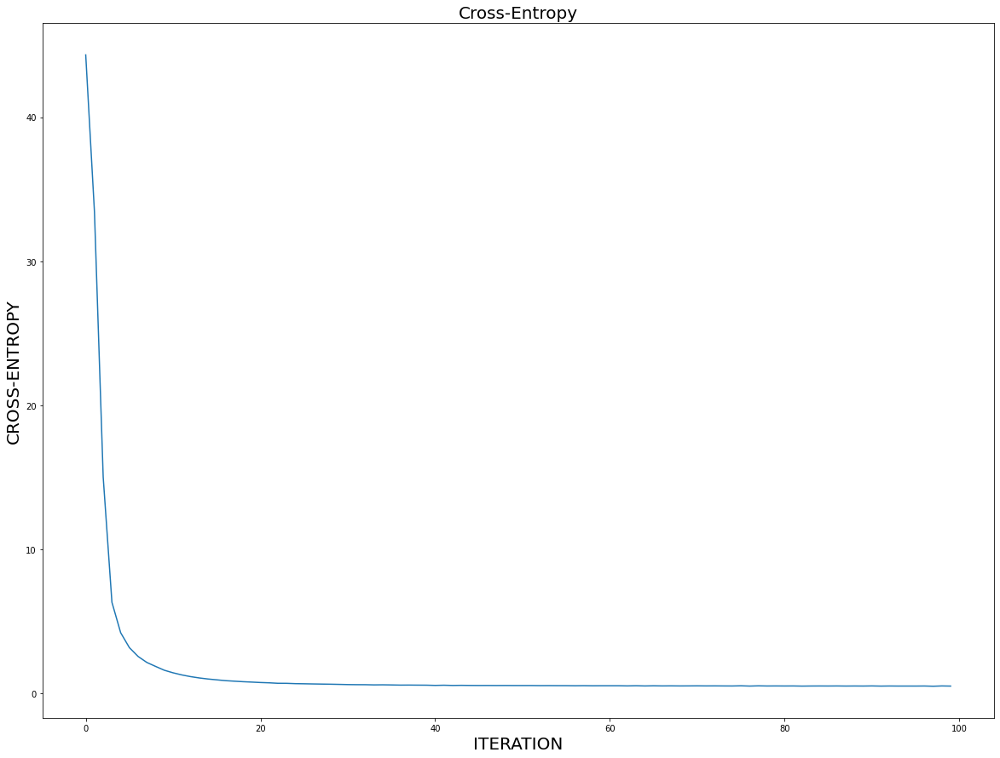

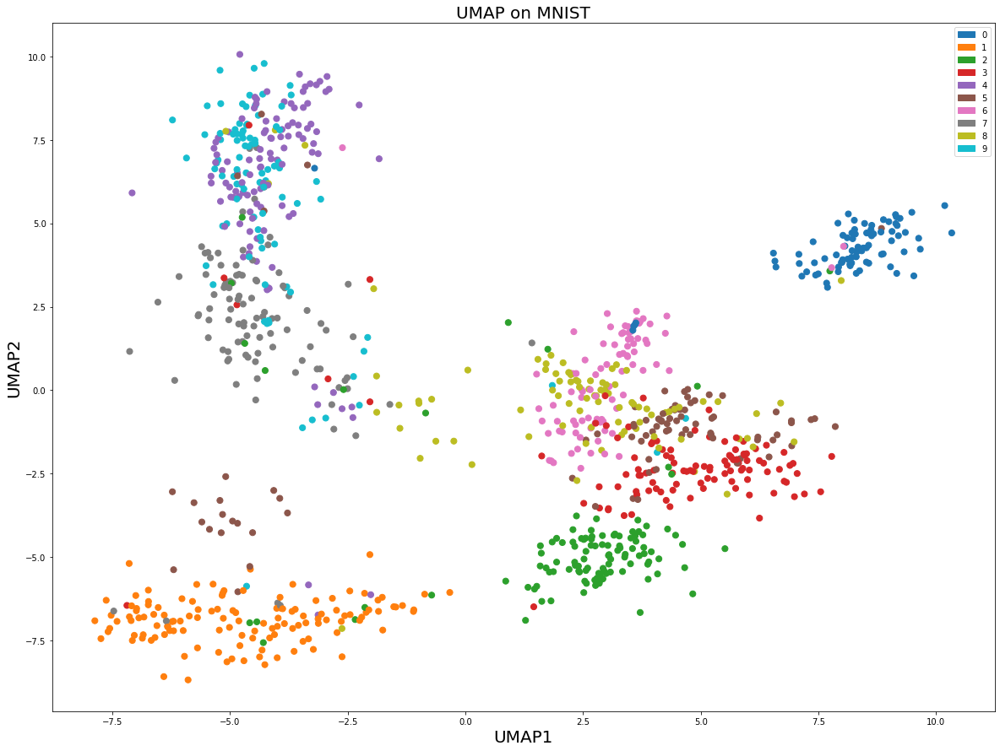


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 136.40763738133884
Running Gradient Descent: 

Cross-Entropy = 45.6914783096198 after 0 iterations
Cross-Entropy = 1.1222109886979934 after 10 iterations
Cross-Entropy = 0.7490555063459416 after 20 iterations
Cross-Entropy = 0.6616838647671905 after 30 iterations
Cross-Entropy = 0.6288531807414419 after 40 iterations
Cross-Entropy = 0.6091218591084825 after 50 iterations
Cross-Entropy = 0.5958500110687517 after 60 iterations
Cross-Entropy = 0.5875355416959784 after 70 iterations
Cross-Entr

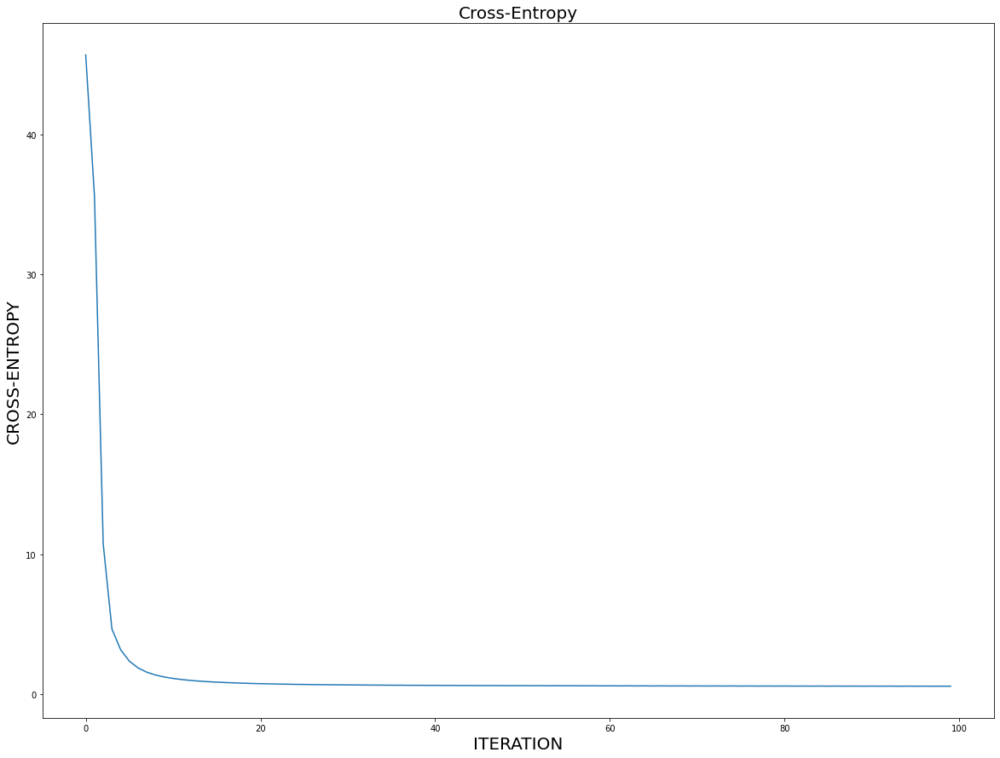

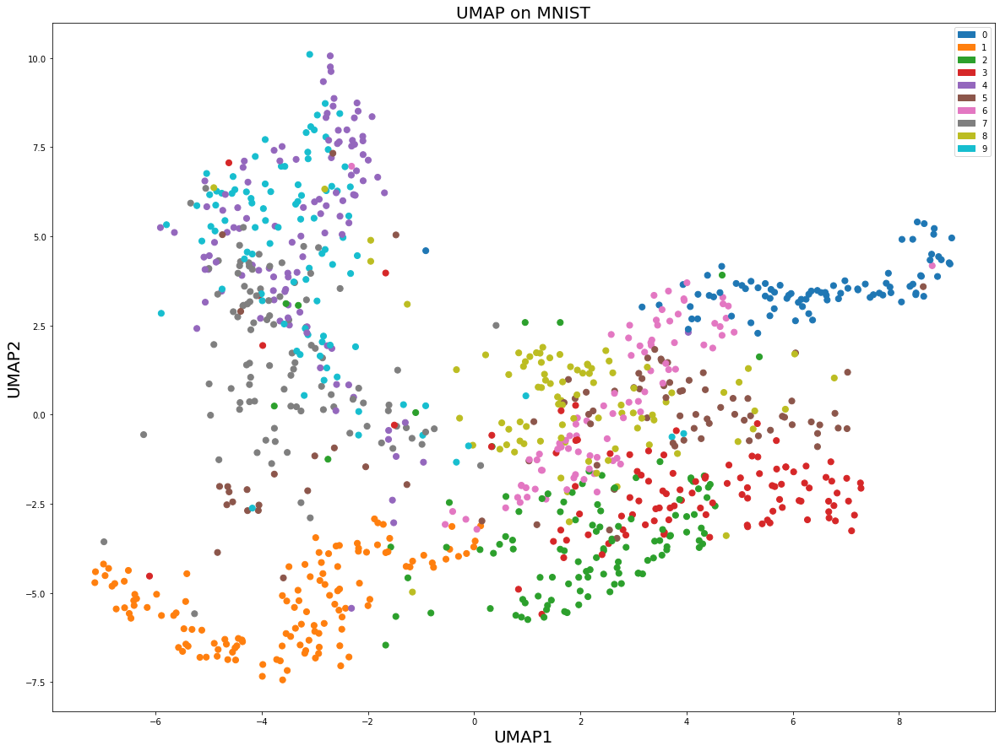


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 29.16952997957087 after 0 iterations
Cross-Entropy = 3.6396103691370225 after 10 iterations
Cross-Entropy = 1.353221951102219 after 20 iterations
Cross-Entropy = 0.8971707568759247 after 30 iterations
Cross-Entropy = 0.7155788512213076 after 40 iterations
Cross-Entropy = 0.642137486961869 after 50 iterations
Cross-Entropy = 0.582386982775683 after 60 iterations
Cross-Entropy = 0.5837742941412988 after 70 iterations
Cross-Entrop

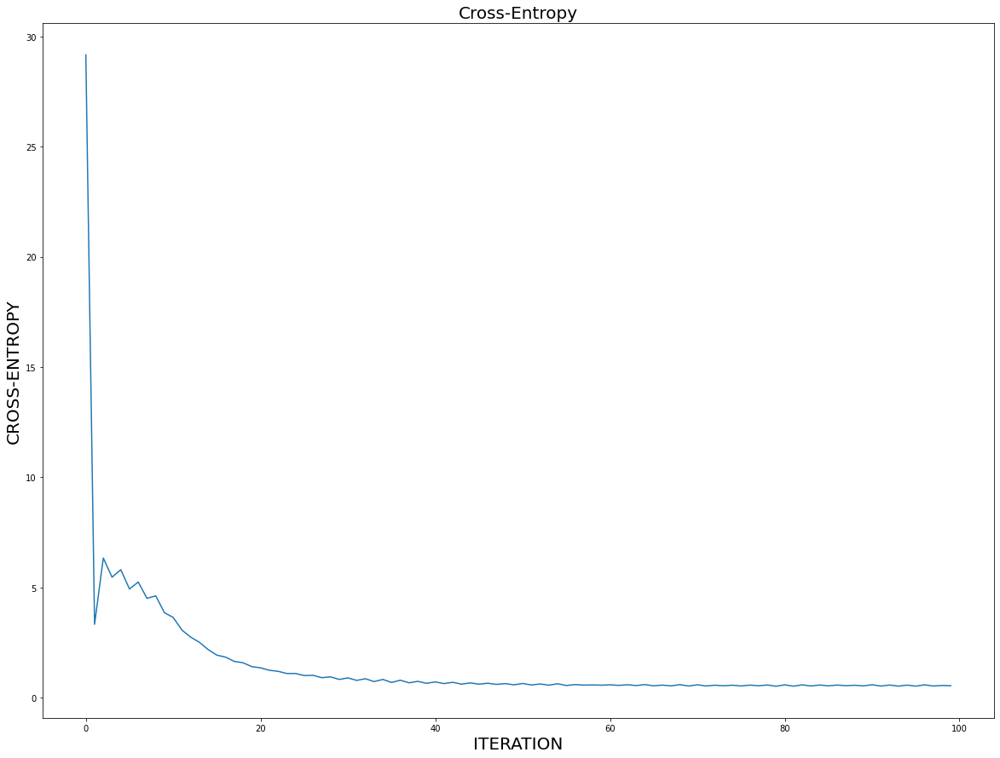

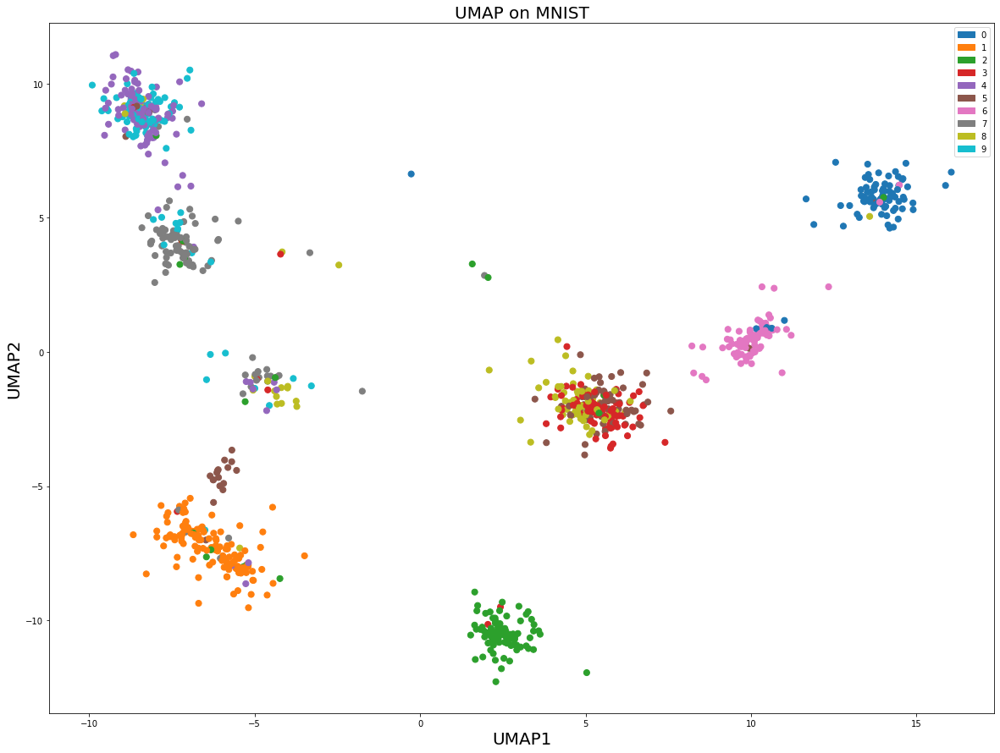


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 33.1217405280533 after 0 iterations
Cross-Entropy = 3.248033720184925 after 10 iterations
Cross-Entropy = 1.2719573737583523 after 20 iterations
Cross-Entropy = 0.8494335636205882 after 30 iterations
Cross-Entropy = 0.6974089590027851 after 40 iterations
Cross-Entropy = 0.6278964567101222 after 50 iterations
Cross-Entropy = 0.6079475364288434 after 60 iterations
Cross-Entropy = 0.5763489035537137 after 70 iterations
Cross-Entro

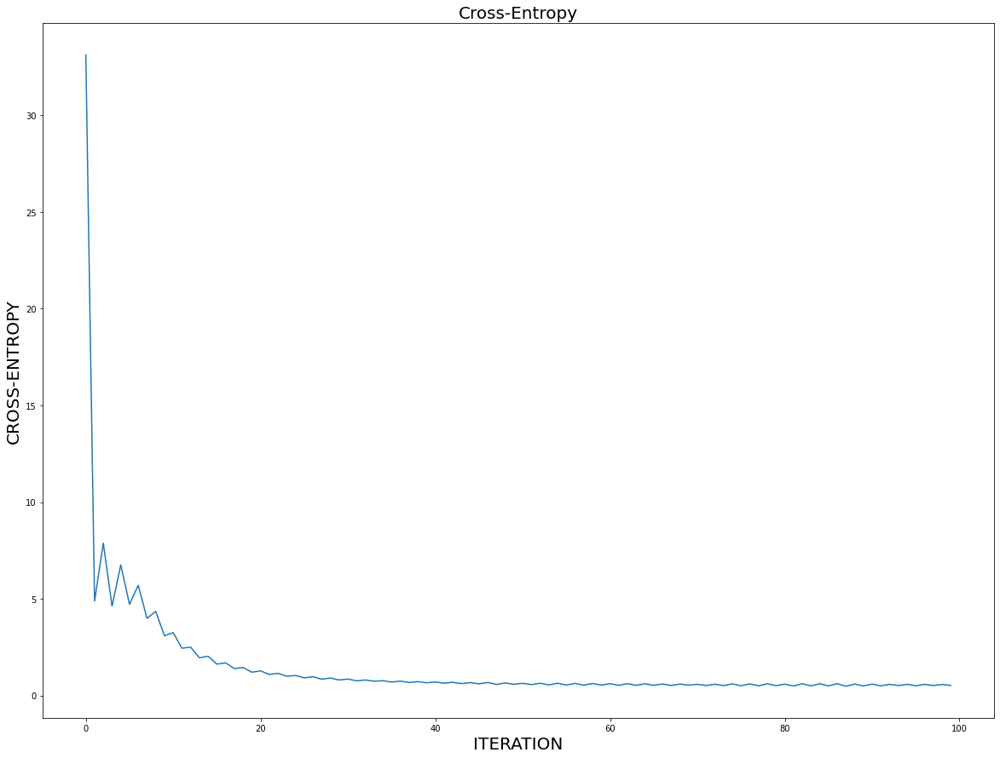

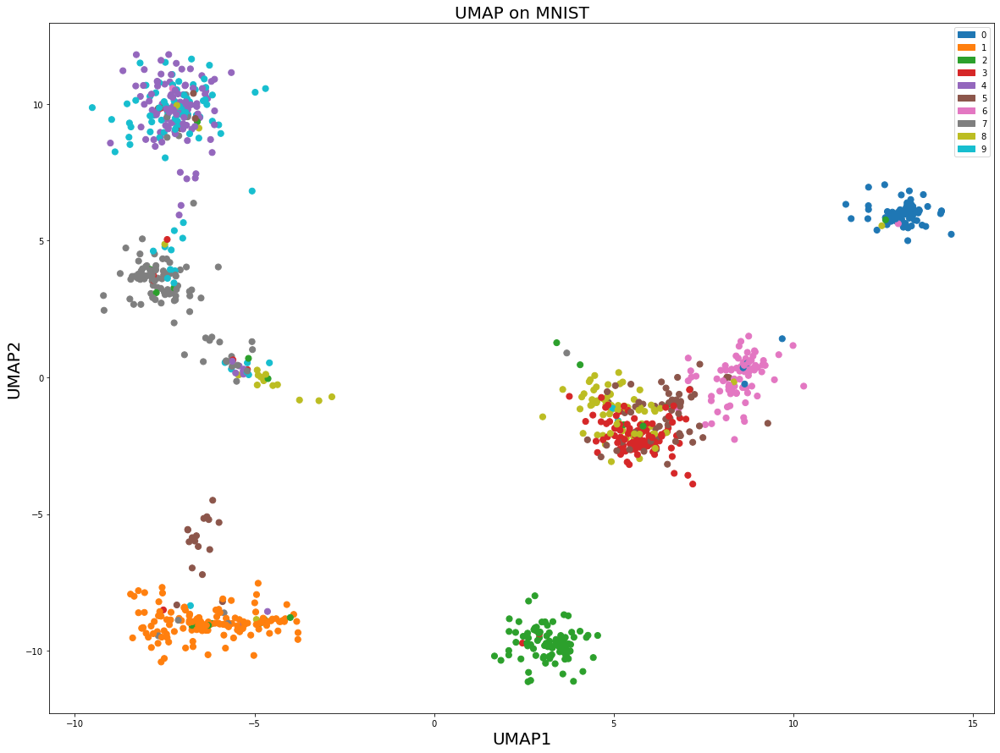


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 36.20766922013783 after 0 iterations
Cross-Entropy = 2.4656857632356455 after 10 iterations
Cross-Entropy = 1.0273231185922758 after 20 iterations
Cross-Entropy = 0.7613578822269416 after 30 iterations
Cross-Entropy = 0.630356797300849 after 40 iterations
Cross-Entropy = 0.6059693852533936 after 50 iterations
Cross-Entropy = 0.6106605694999829 after 60 iterations
Cross-Entropy = 0.5708186854740027 after 70 iterations
Cross-Entr

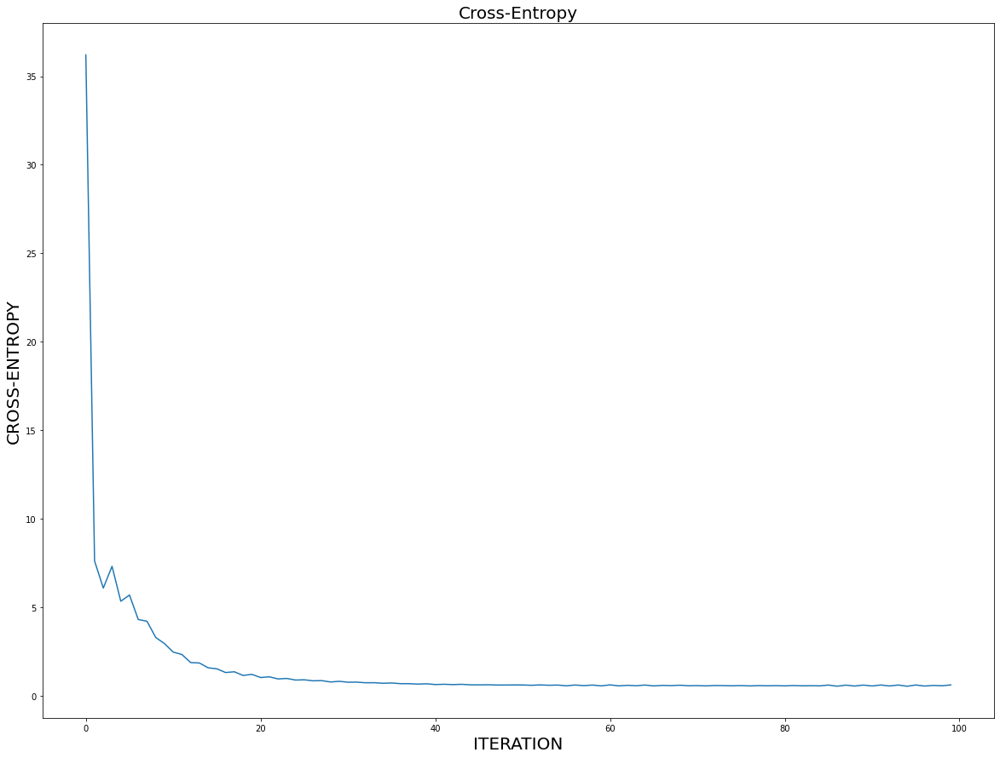

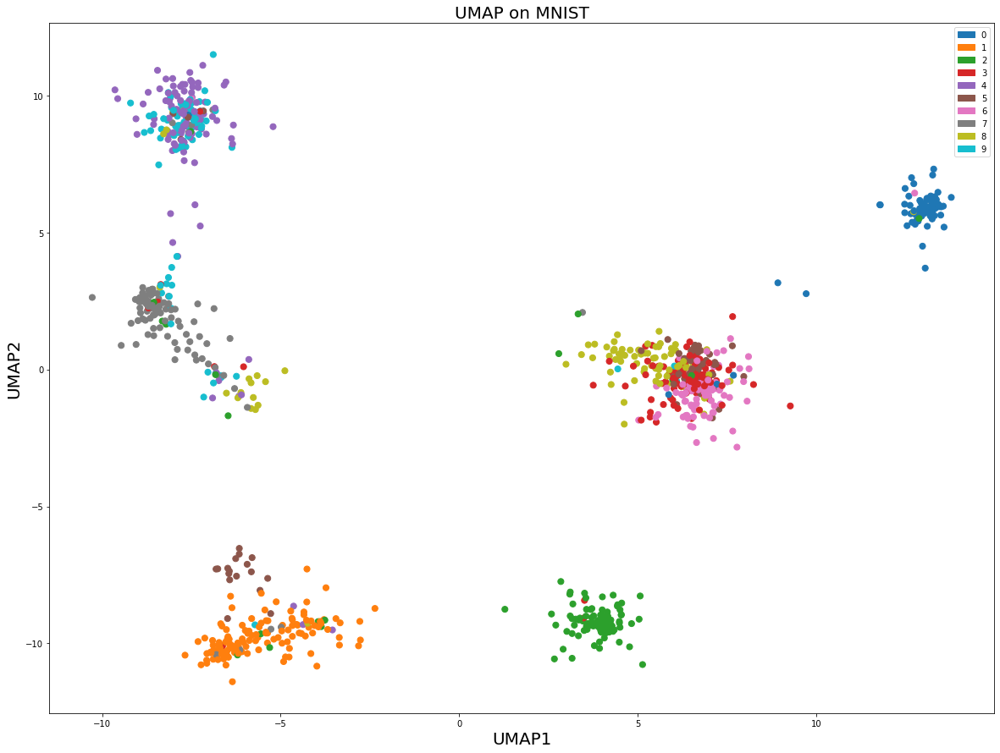


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 30.740580976209248 after 0 iterations
Cross-Entropy = 3.4814645335937984 after 10 iterations
Cross-Entropy = 1.3312909767777583 after 20 iterations
Cross-Entropy = 0.8907419521573375 after 30 iterations
Cross-Entropy = 0.720940217029309 after 40 iterations
Cross-Entropy = 0.6598544559150766 after 50 iterations
Cross-Entropy = 0.5969491725955072 after 60 iterations
Cross-Entropy = 0.5825698981112514 after 70 iterations
Cross-Ent

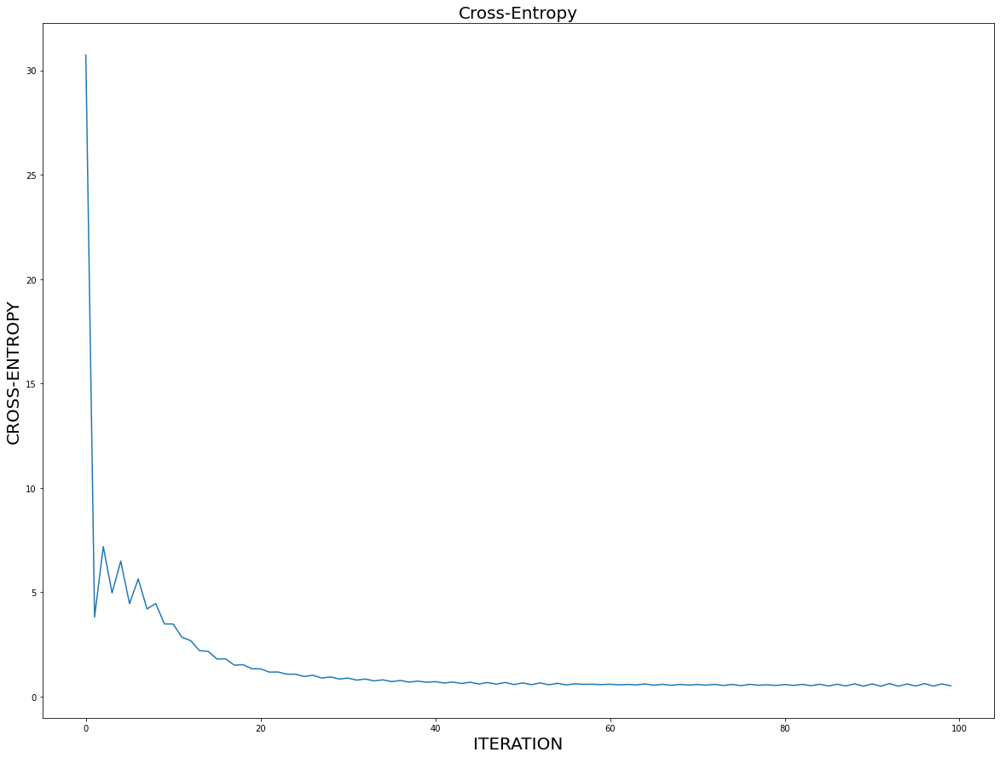

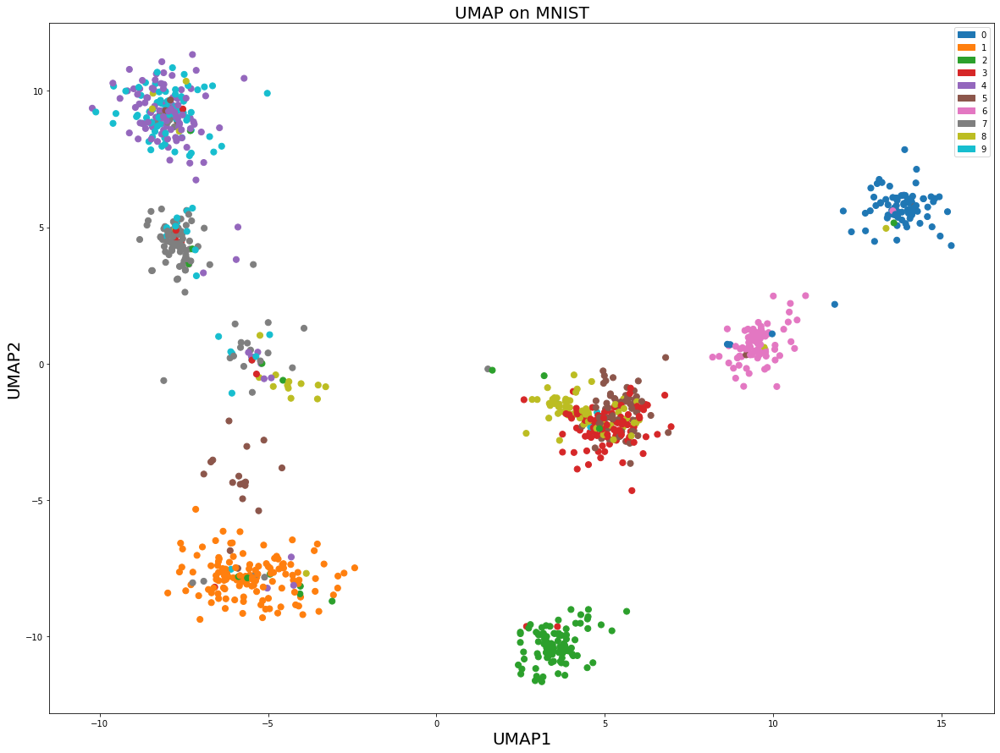


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 39.34722543535702 after 0 iterations
Cross-Entropy = 1.9144633755374236 after 10 iterations
Cross-Entropy = 0.9223402596656367 after 20 iterations
Cross-Entropy = 0.701300907390576 after 30 iterations
Cross-Entropy = 0.5995672272837416 after 40 iterations
Cross-Entropy = 0.5584192027936834 after 50 iterations
Cross-Entropy = 0.5275630122935595 after 60 iterations
Cross-Entropy = 0.5388577236795797 after 70 iterations
Cross-Entr

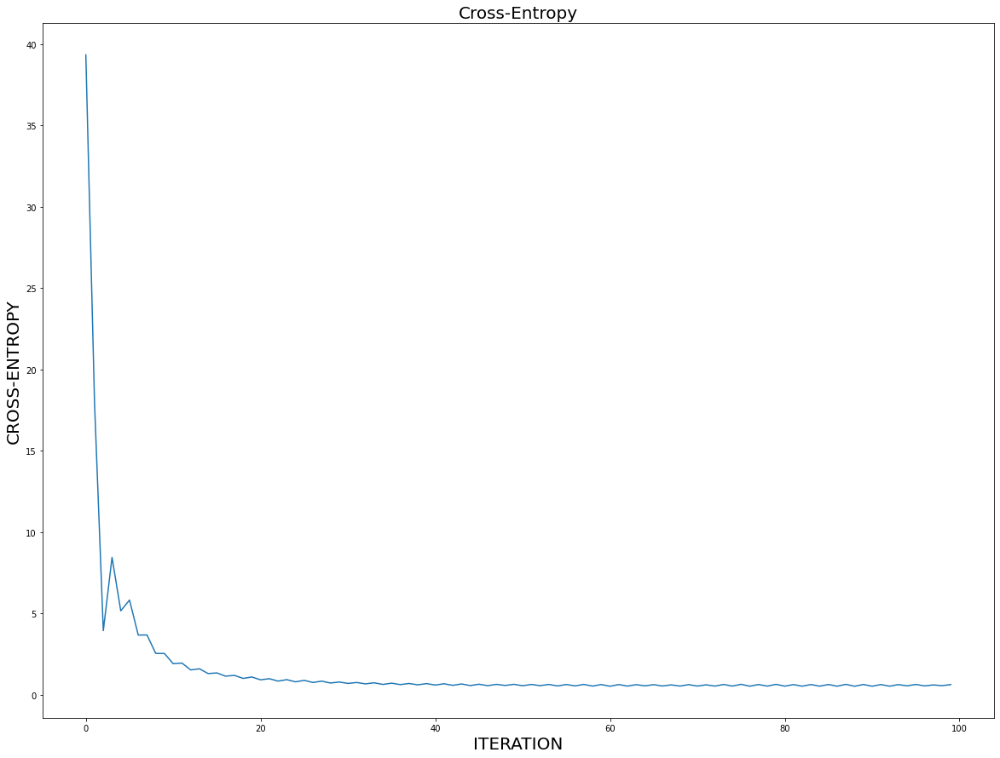

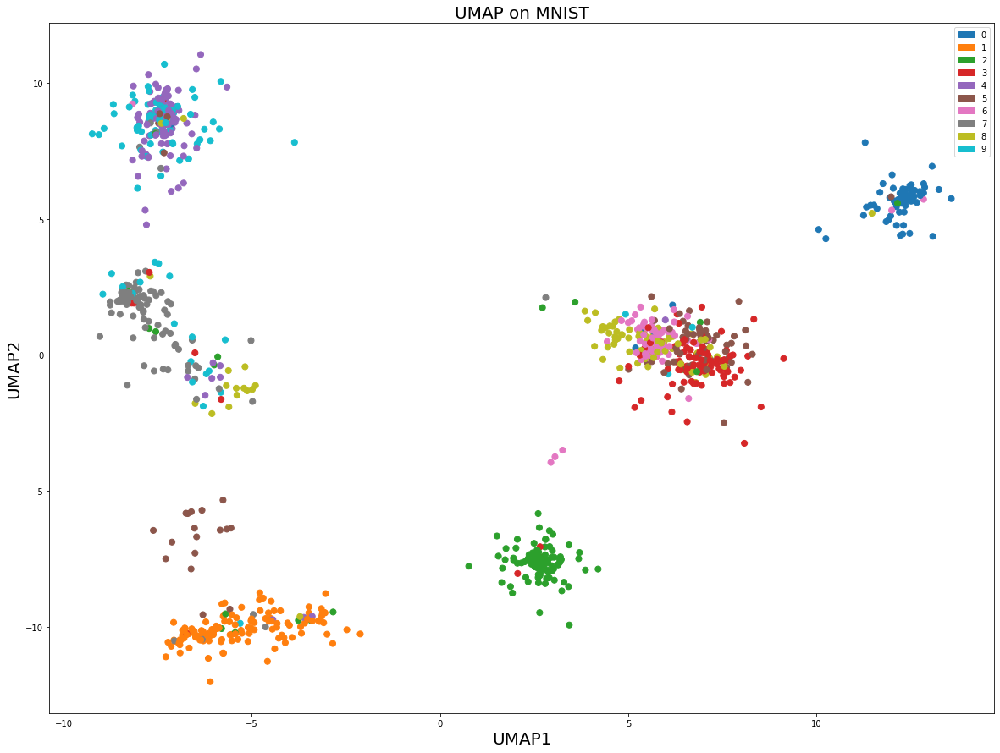


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 44.528441118393836 after 0 iterations
Cross-Entropy = 1.536152298916052 after 10 iterations
Cross-Entropy = 0.8252720863747399 after 20 iterations
Cross-Entropy = 0.6756590030334039 after 30 iterations
Cross-Entropy = 0.619144612922918 after 40 iterations
Cross-Entropy = 0.5935721444689366 after 50 iterations
Cross-Entropy = 0.5773272229113093 after 60 iterations
Cross-Entropy = 0.5825792734845242 after 70 iterations
Cross-Entr

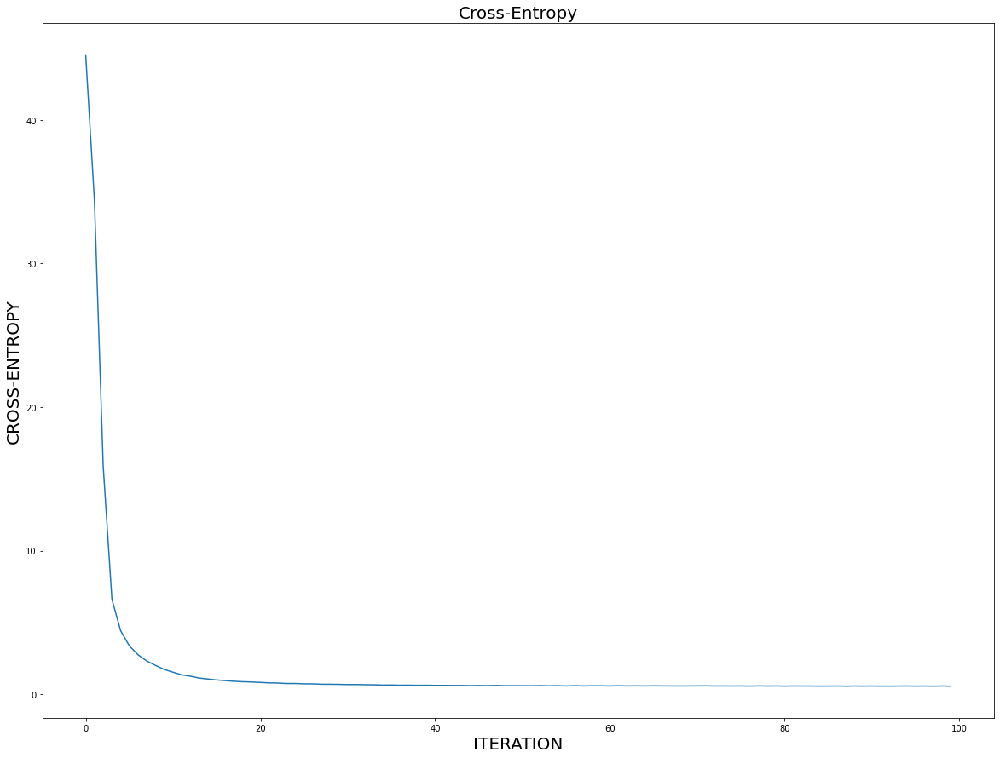

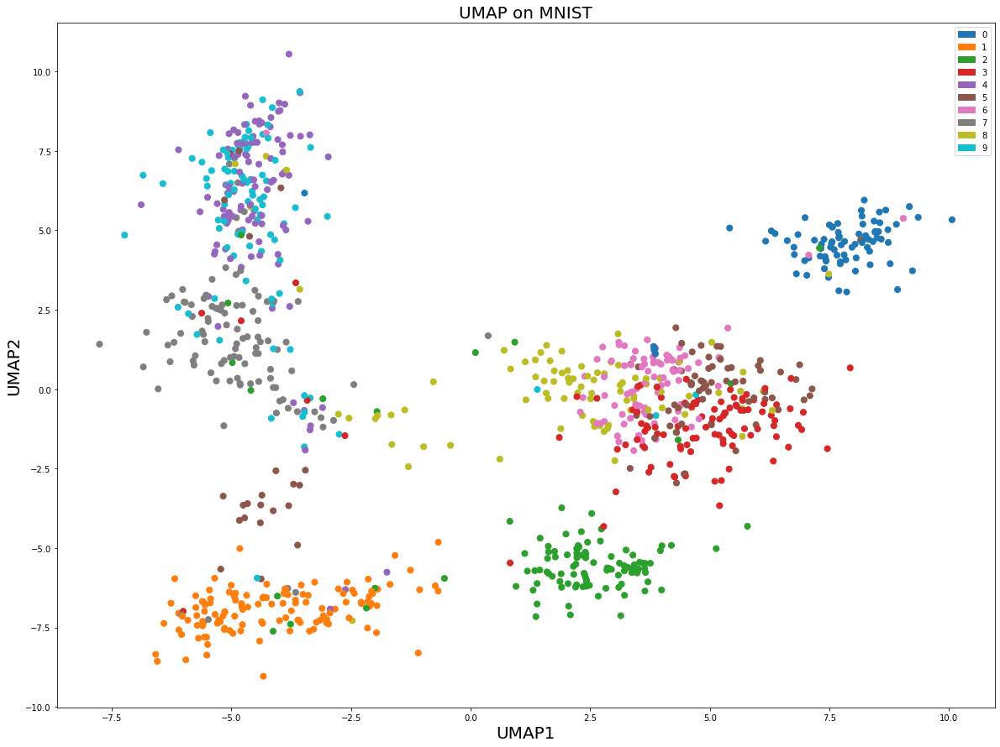


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 147.00383729524202
Running Gradient Descent: 

Cross-Entropy = 45.711630293749174 after 0 iterations
Cross-Entropy = 1.2344429571897162 after 10 iterations
Cross-Entropy = 0.8618556370958198 after 20 iterations
Cross-Entropy = 0.7739344639871287 after 30 iterations
Cross-Entropy = 0.733068190675029 after 40 iterations
Cross-Entropy = 0.710316361301861 after 50 iterations
Cross-Entropy = 0.6944744573987551 after 60 iterations
Cross-Entropy = 0.6832250632074929 after 70 iterations
Cross-Entr

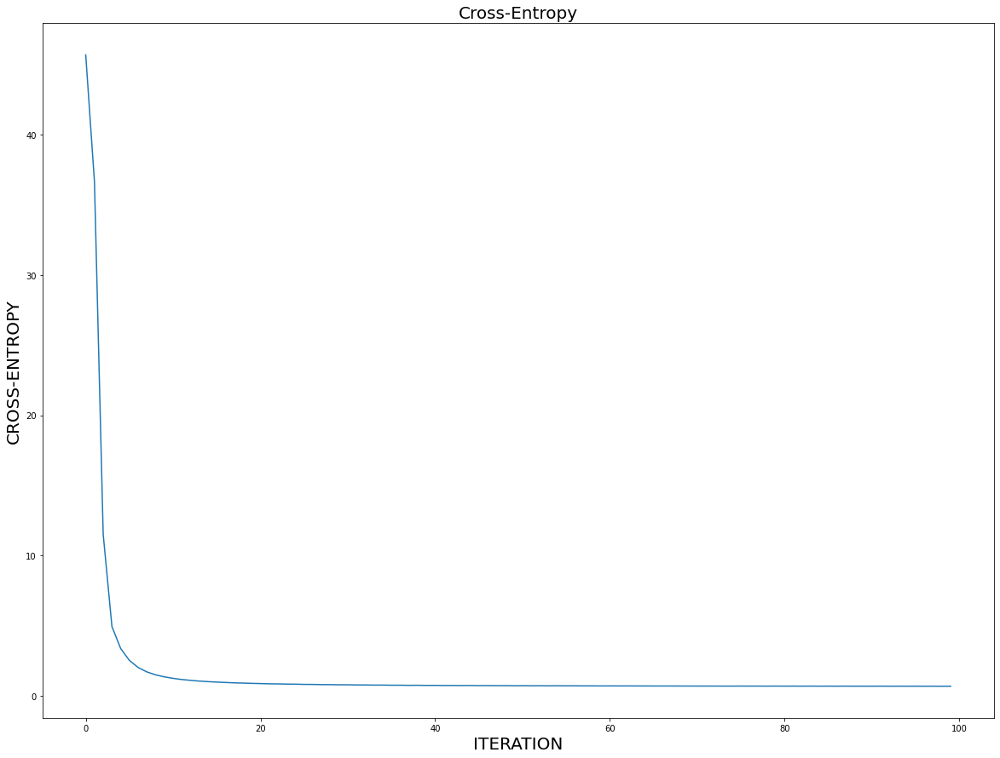

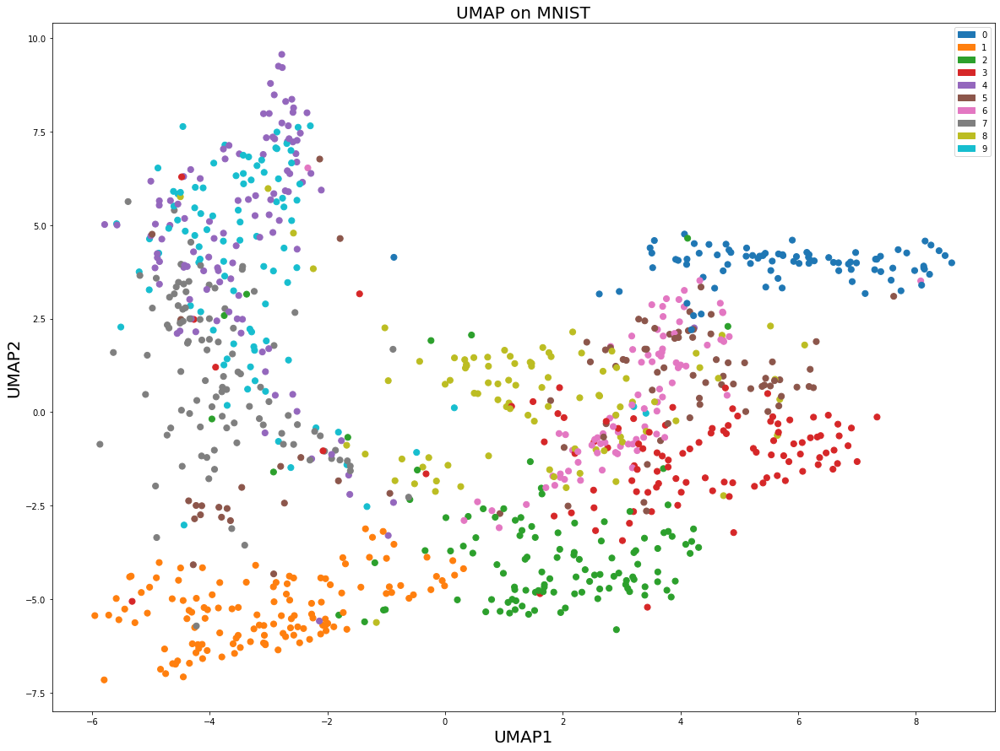


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 28.986854208529202 after 0 iterations
Cross-Entropy = 4.364493194008969 after 10 iterations
Cross-Entropy = 1.645495139064557 after 20 iterations
Cross-Entropy = 1.0463586471832085 after 30 iterations
Cross-Entropy = 0.7950805962703803 after 40 iterations
Cross-Entropy = 0.6742643508980763 after 50 iterations
Cross-Entropy = 0.5974085600078682 after 60 iterations
Cross-Entropy = 0.5625692138238977 after 70 iterations
Cross-Entr

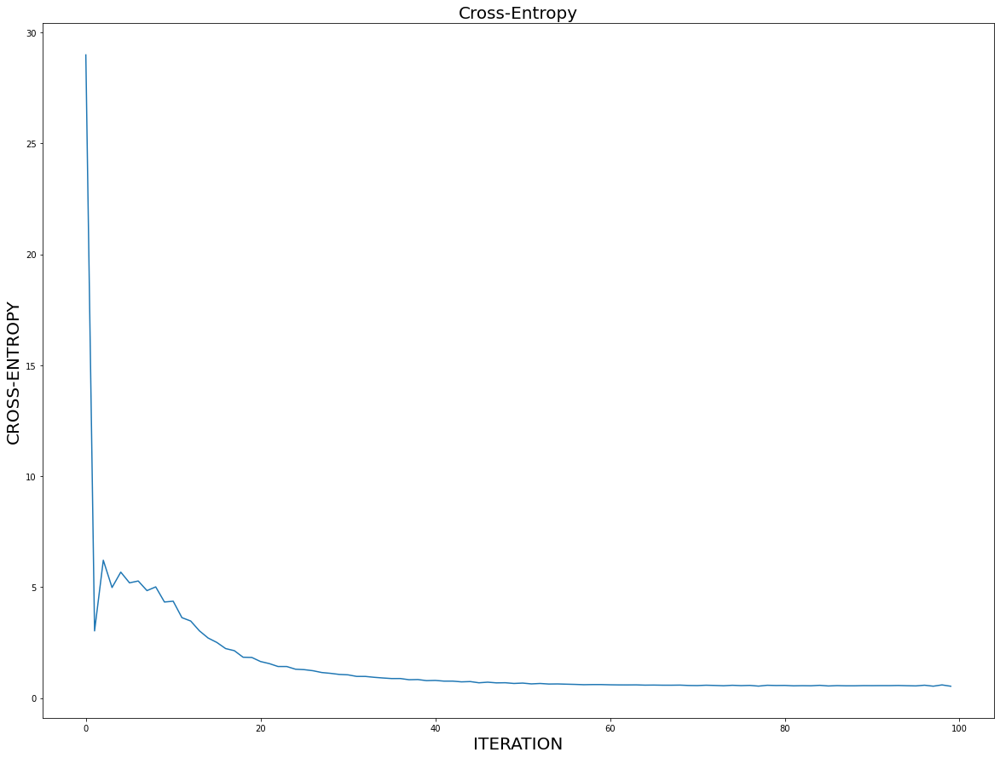

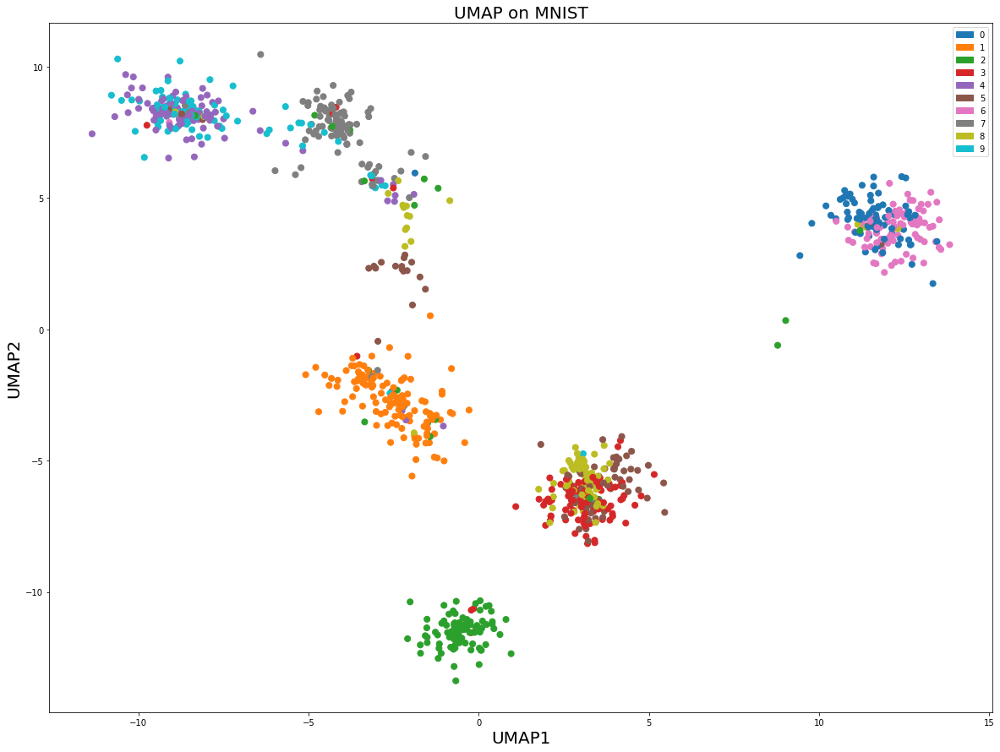


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 33.13933960010603 after 0 iterations
Cross-Entropy = 3.8184632005481656 after 10 iterations
Cross-Entropy = 1.4155576824909122 after 20 iterations
Cross-Entropy = 0.9674661007204971 after 30 iterations
Cross-Entropy = 0.773236021504851 after 40 iterations
Cross-Entropy = 0.679034860667926 after 50 iterations
Cross-Entropy = 0.6599357404899664 after 60 iterations
Cross-Entropy = 0.6549056087171353 after 70 iterations
Cross-Entro

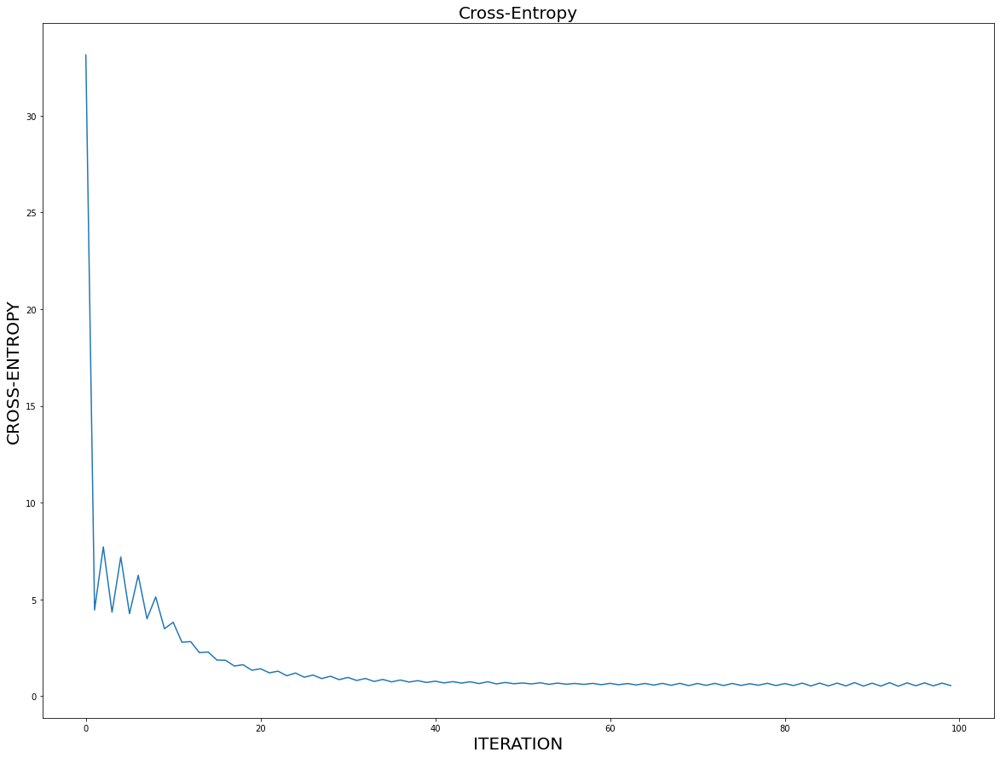

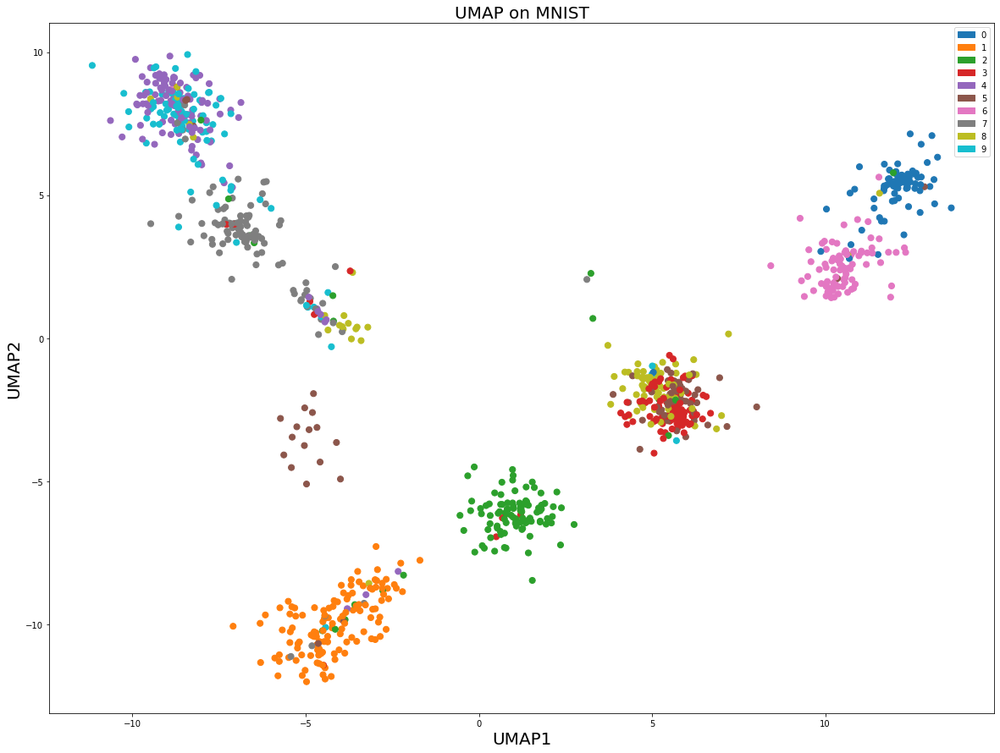


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 36.46330452393873 after 0 iterations
Cross-Entropy = 2.8170401366883238 after 10 iterations
Cross-Entropy = 1.1926756154918958 after 20 iterations
Cross-Entropy = 0.8214929697083087 after 30 iterations
Cross-Entropy = 0.7200292786183637 after 40 iterations
Cross-Entropy = 0.6746442307640793 after 50 iterations
Cross-Entropy = 0.6560919021653564 after 60 iterations
Cross-Entropy = 0.6381637585403703 after 70 iterations
Cross-Ent

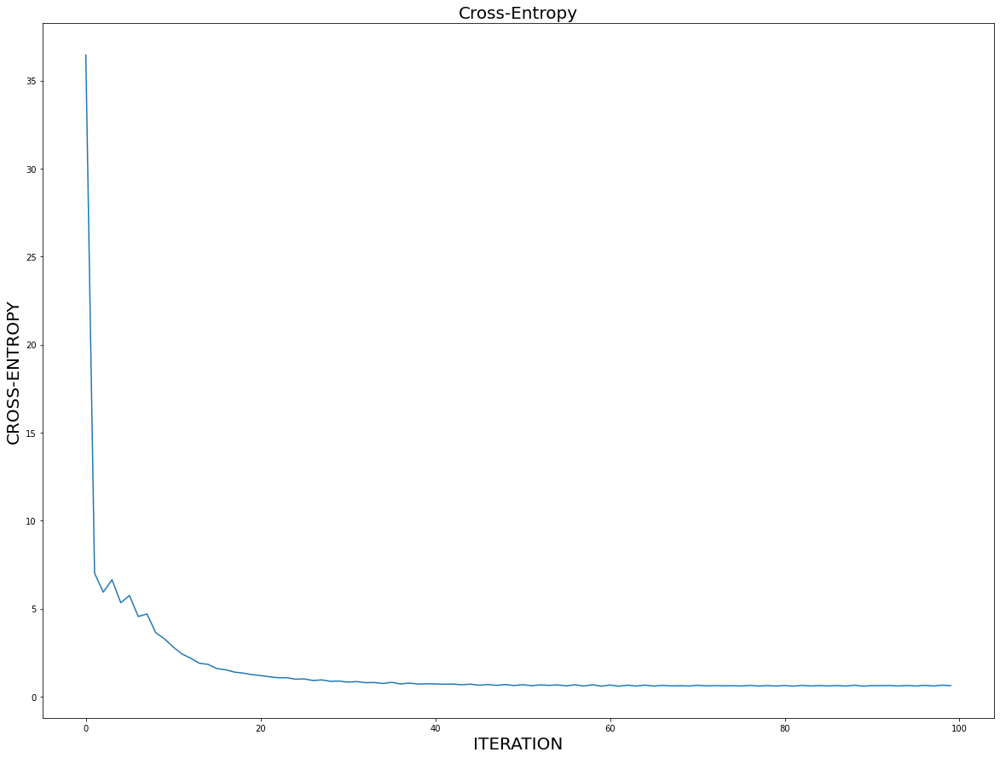

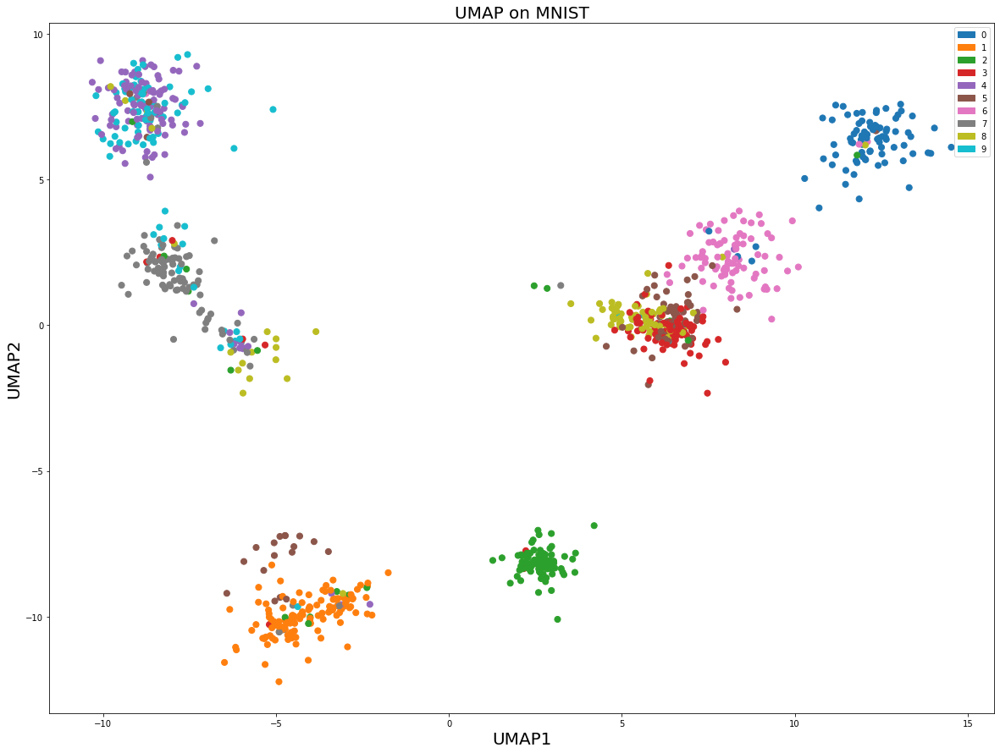


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 30.626907463038233 after 0 iterations
Cross-Entropy = 4.1635608448101715 after 10 iterations
Cross-Entropy = 1.5728564852196159 after 20 iterations
Cross-Entropy = 0.95275167355495 after 30 iterations
Cross-Entropy = 0.7357602218324291 after 40 iterations
Cross-Entropy = 0.6699047996429489 after 50 iterations
Cross-Entropy = 0.6509348779733685 after 60 iterations
Cross-Entropy = 0.631993581330113 after 70 iterations
Cross-Entro

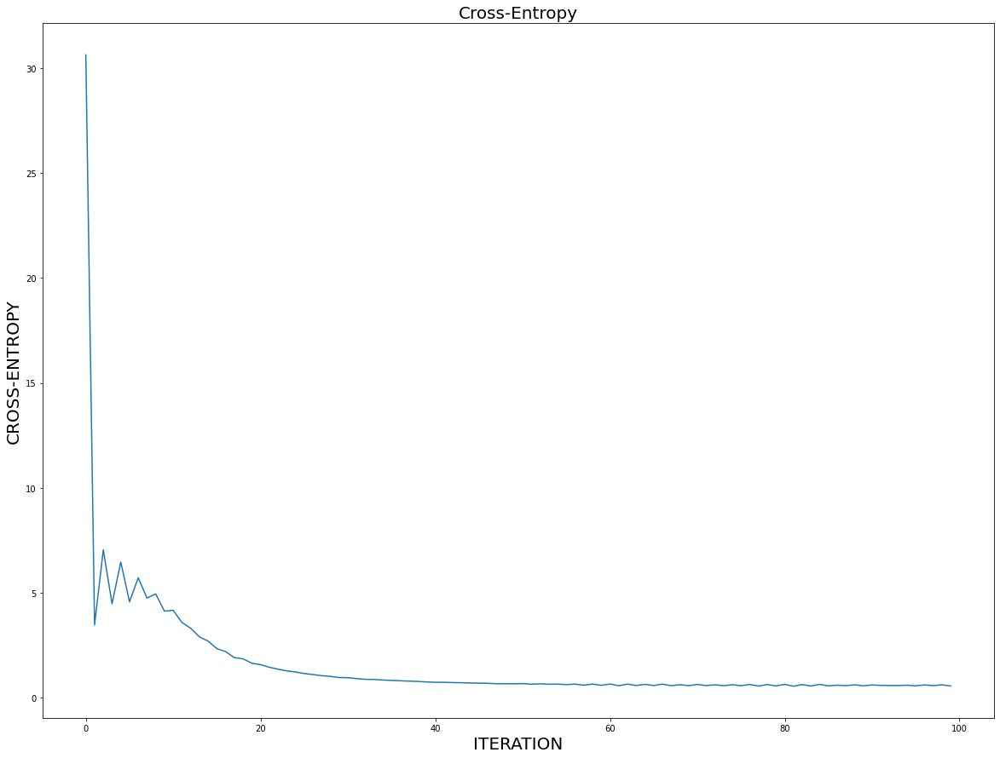

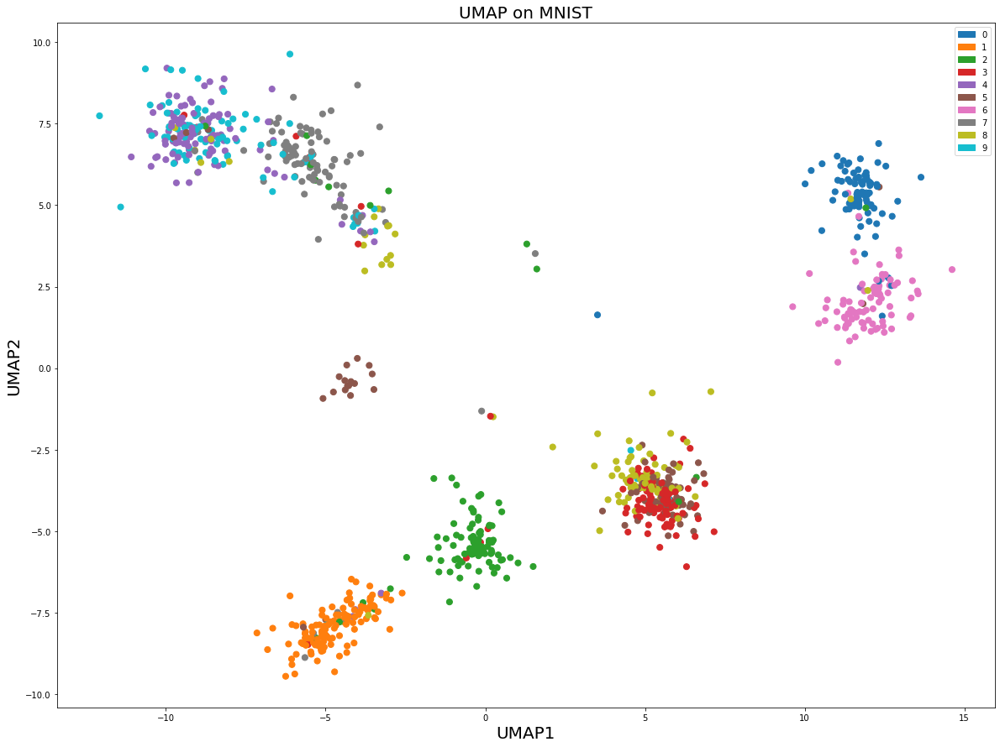


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 39.83187296320923 after 0 iterations
Cross-Entropy = 2.0849484095230695 after 10 iterations
Cross-Entropy = 0.9672894943043989 after 20 iterations
Cross-Entropy = 0.7048208089704375 after 30 iterations
Cross-Entropy = 0.6092203464299887 after 40 iterations
Cross-Entropy = 0.5893616442975759 after 50 iterations
Cross-Entropy = 0.5880008548304989 after 60 iterations
Cross-Entropy = 0.5903933848541328 after 70 iterations
Cross-Ent

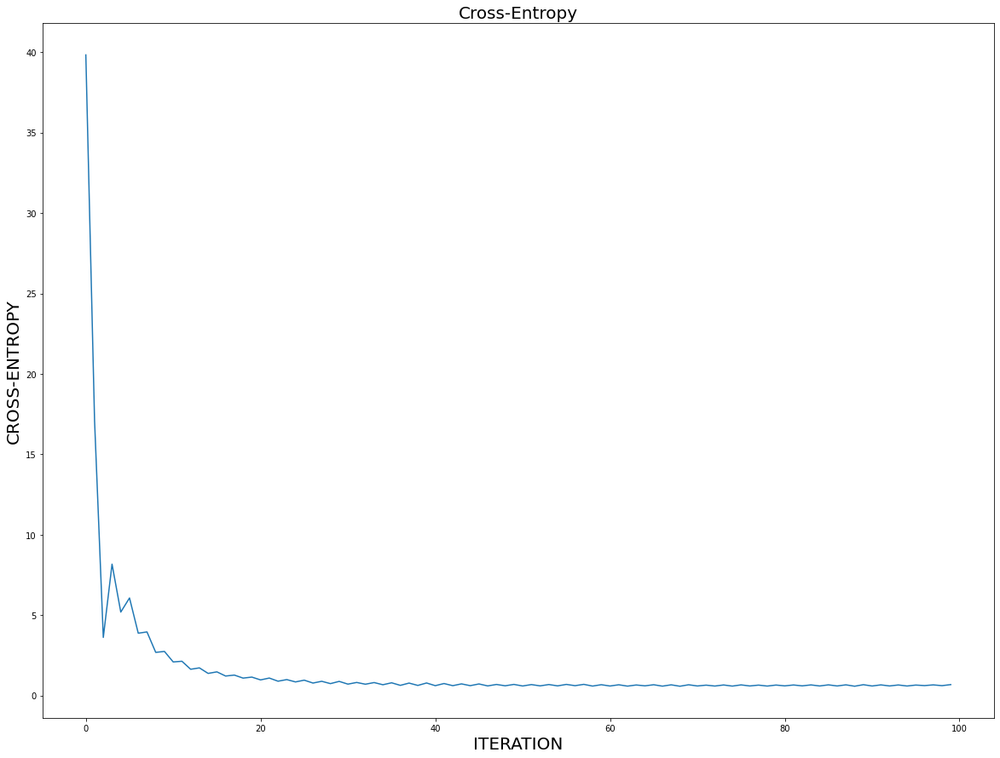

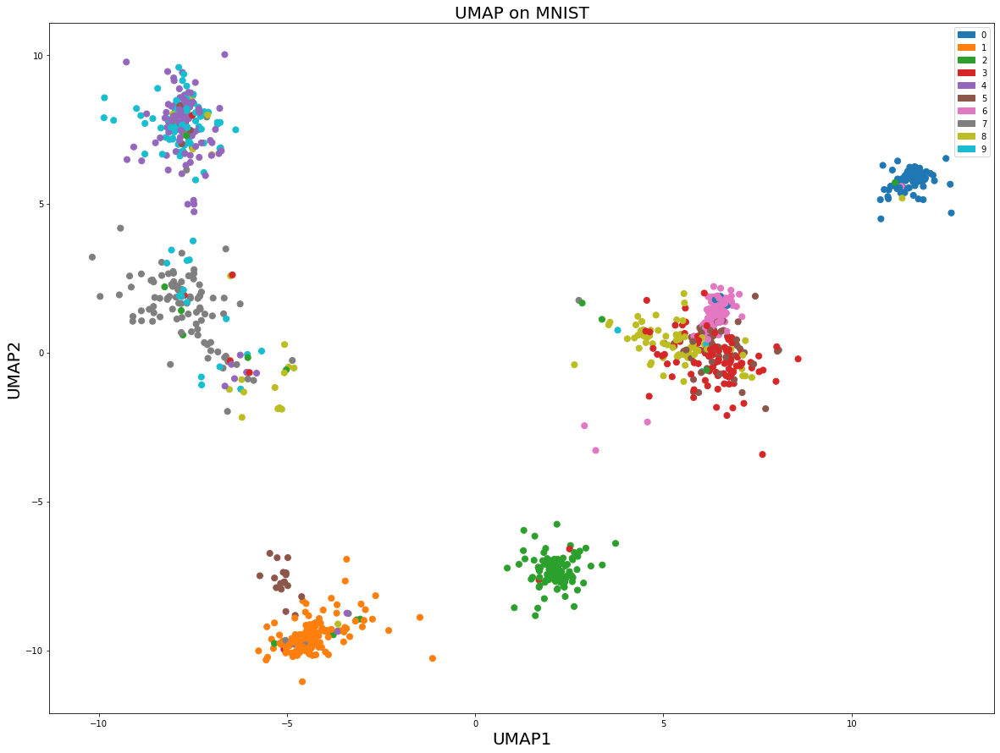


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 44.68712644649351 after 0 iterations
Cross-Entropy = 1.575168470087827 after 10 iterations
Cross-Entropy = 0.8726434337364047 after 20 iterations
Cross-Entropy = 0.736146060955017 after 30 iterations
Cross-Entropy = 0.6628850122059697 after 40 iterations
Cross-Entropy = 0.655728773384339 after 50 iterations
Cross-Entropy = 0.6331283171517268 after 60 iterations
Cross-Entropy = 0.6439642081143908 after 70 iterations
Cross-Entrop

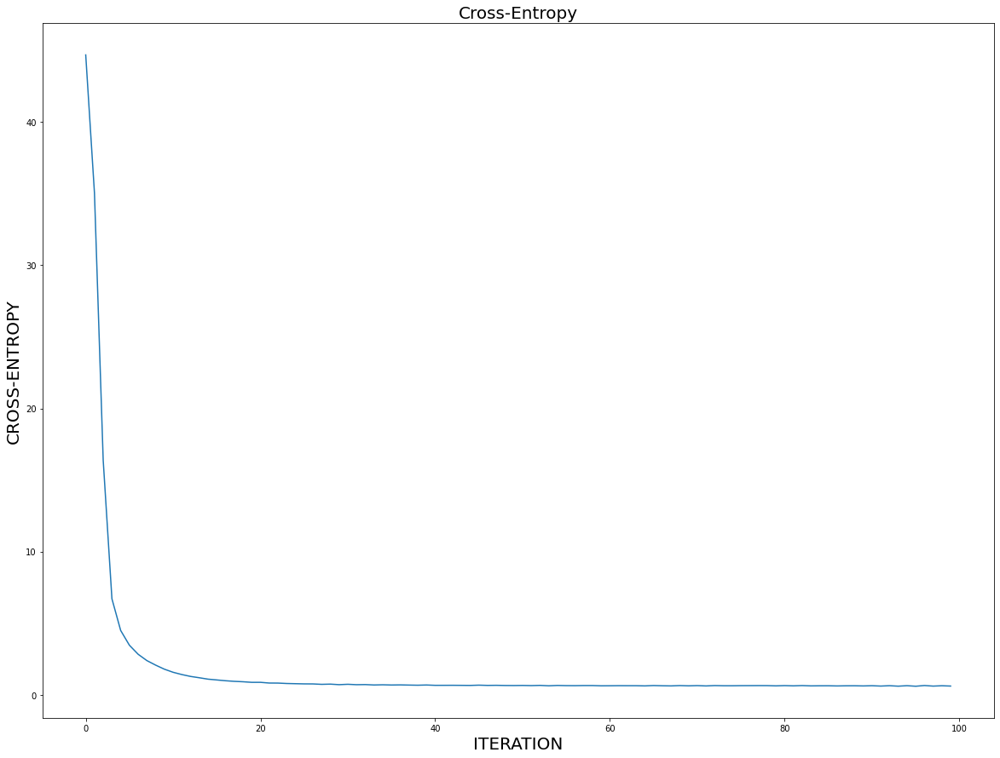

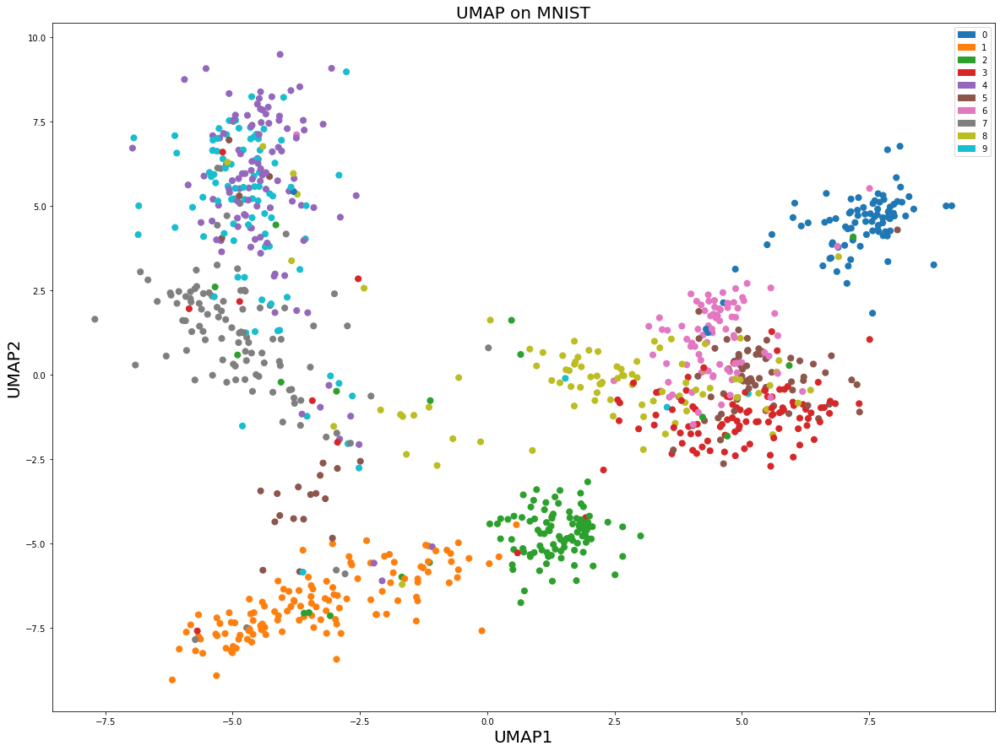


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 155.67709471251035
Running Gradient Descent: 

Cross-Entropy = 45.72609839206286 after 0 iterations
Cross-Entropy = 1.296402377241079 after 10 iterations
Cross-Entropy = 0.9420307006779939 after 20 iterations
Cross-Entropy = 0.8530137576888758 after 30 iterations
Cross-Entropy = 0.8147140150286535 after 40 iterations
Cross-Entropy = 0.7965325730054271 after 50 iterations
Cross-Entropy = 0.7877056671755341 after 60 iterations
Cross-Entropy = 0.7763097102689307 after 70 iterations
Cross-Entr

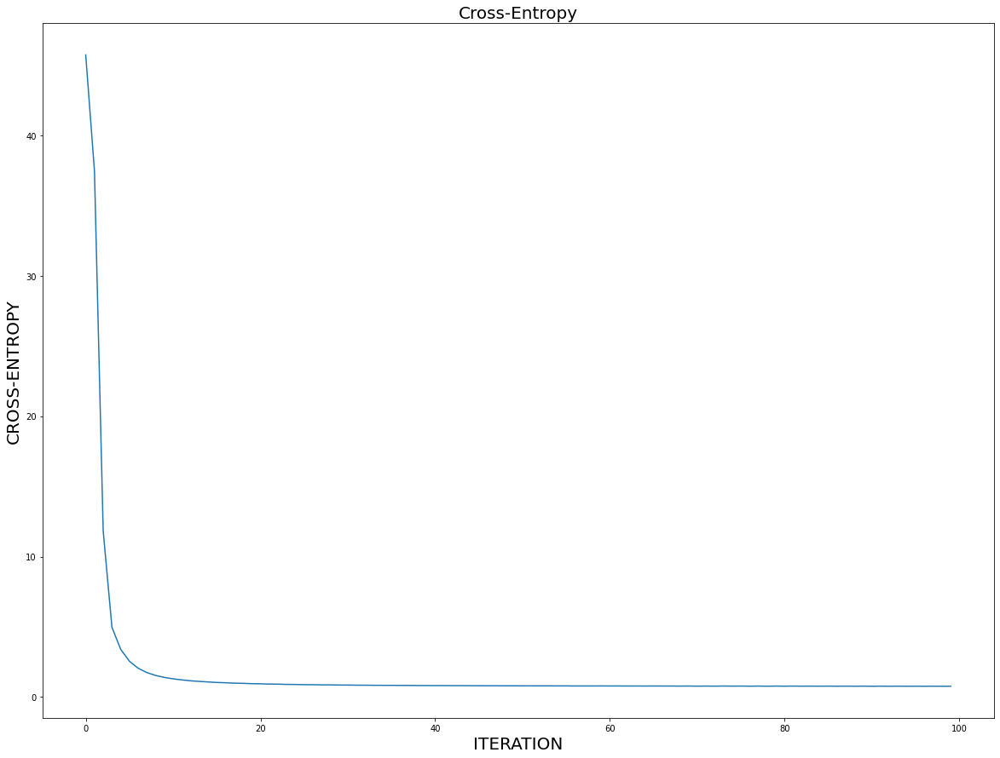

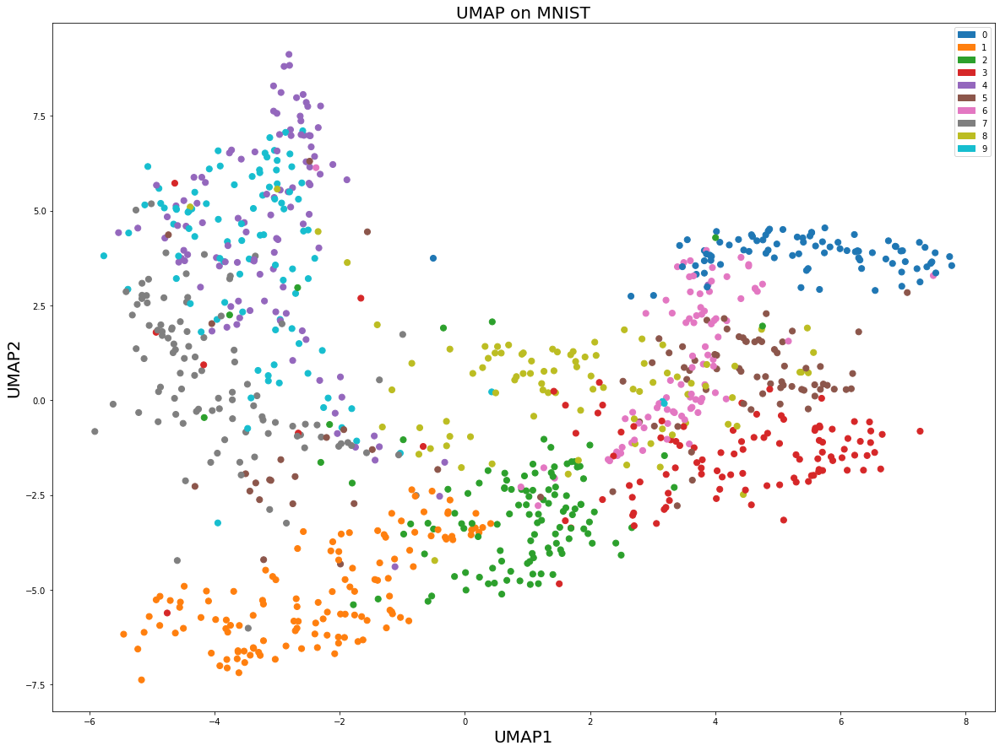


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 28.39571110680814 after 0 iterations
Cross-Entropy = 4.273974075385408 after 10 iterations
Cross-Entropy = 1.6364176063965346 after 20 iterations
Cross-Entropy = 0.9392544374030231 after 30 iterations
Cross-Entropy = 0.727195267994875 after 40 iterations
Cross-Entropy = 0.6305657920195968 after 50 iterations
Cross-Entropy = 0.6275569974657096 after 60 iterations
Cross-Entropy = 0.5912499773267736 after 70 iterations
Cross-Entro

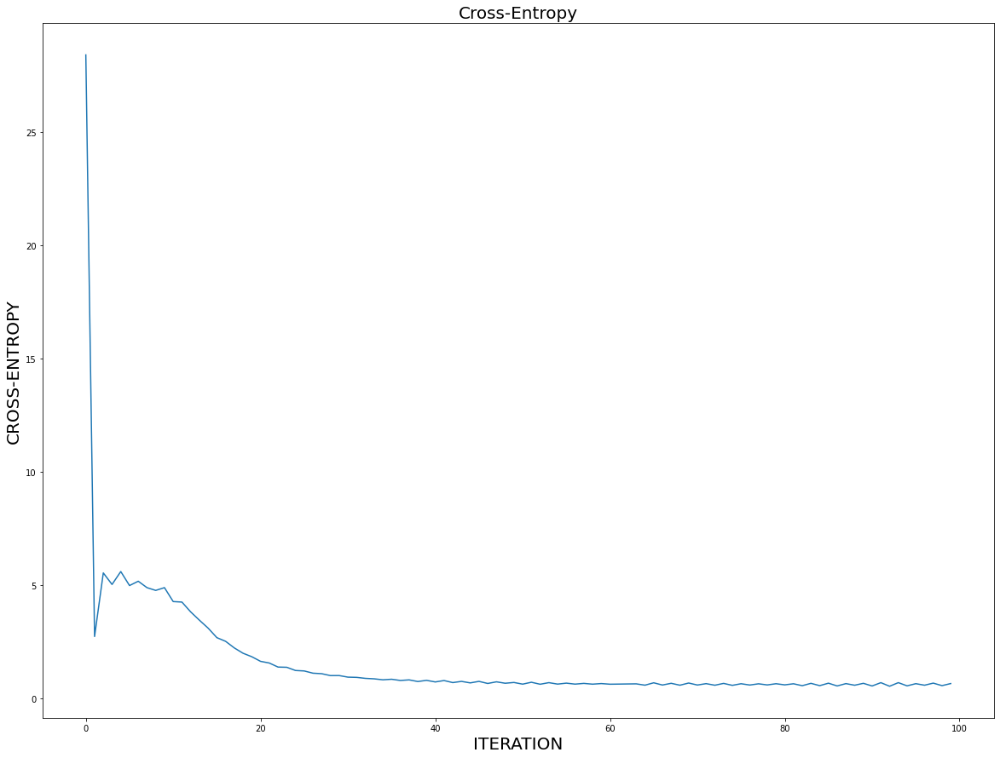

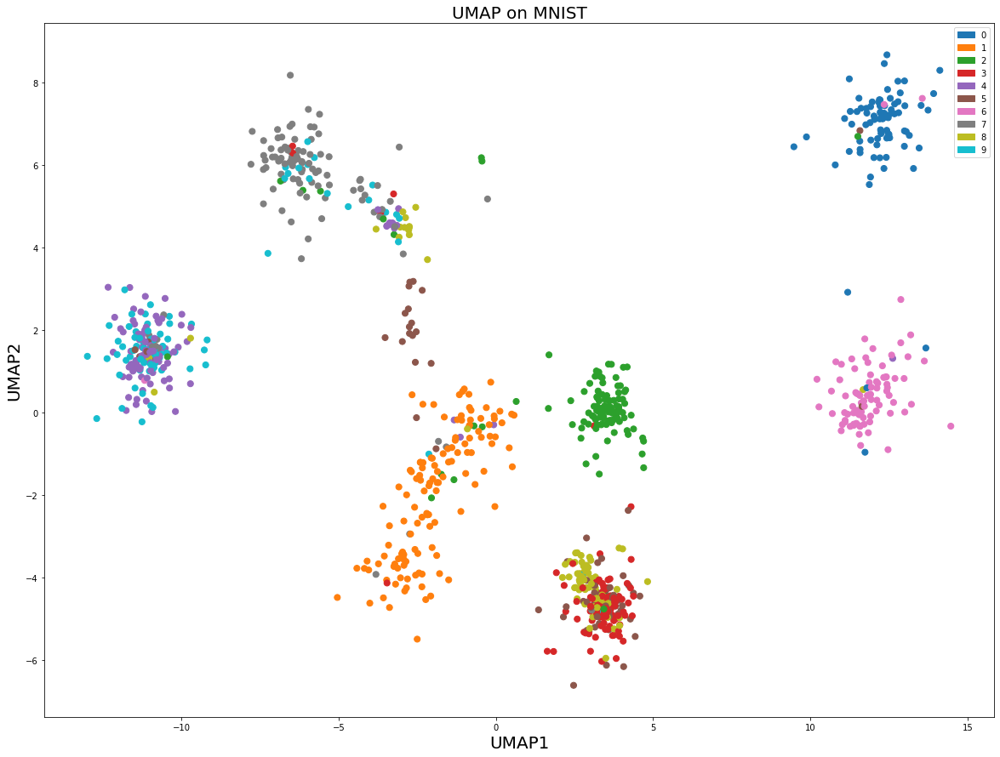


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 32.76696653874845 after 0 iterations
Cross-Entropy = 4.139404402747134 after 10 iterations
Cross-Entropy = 1.572776306438524 after 20 iterations
Cross-Entropy = 1.063286610972663 after 30 iterations
Cross-Entropy = 0.8605767419146377 after 40 iterations
Cross-Entropy = 0.8234251100248414 after 50 iterations
Cross-Entropy = 0.8075036199520569 after 60 iterations
Cross-Entropy = 0.7725959423007833 after 70 iterations
Cross-Entrop

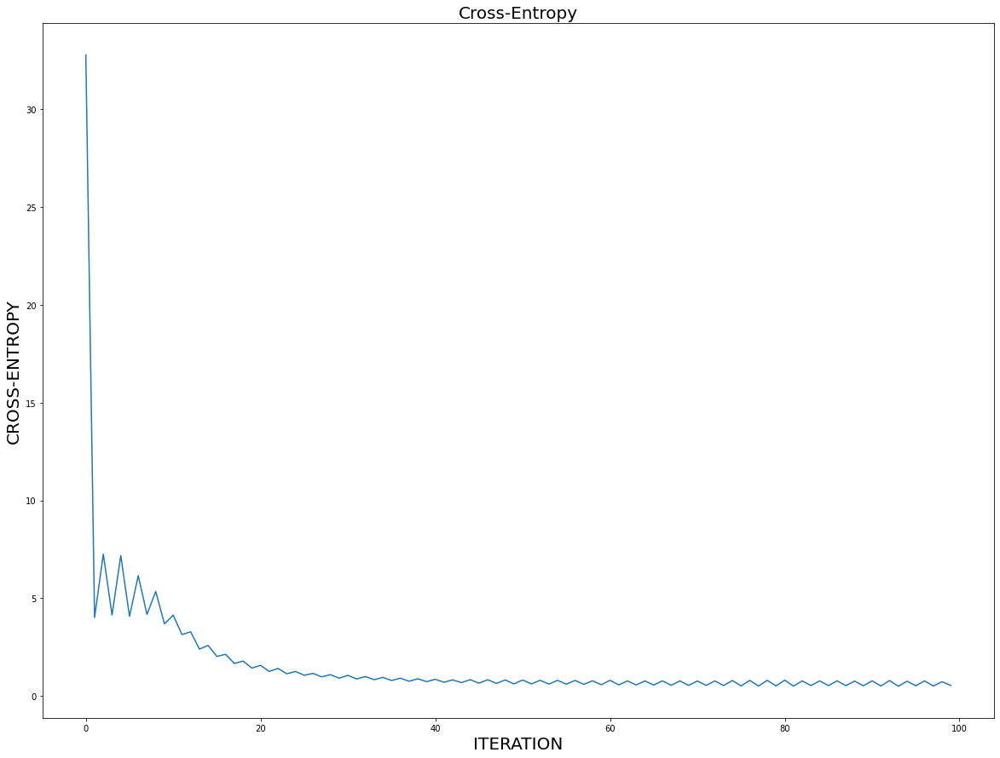

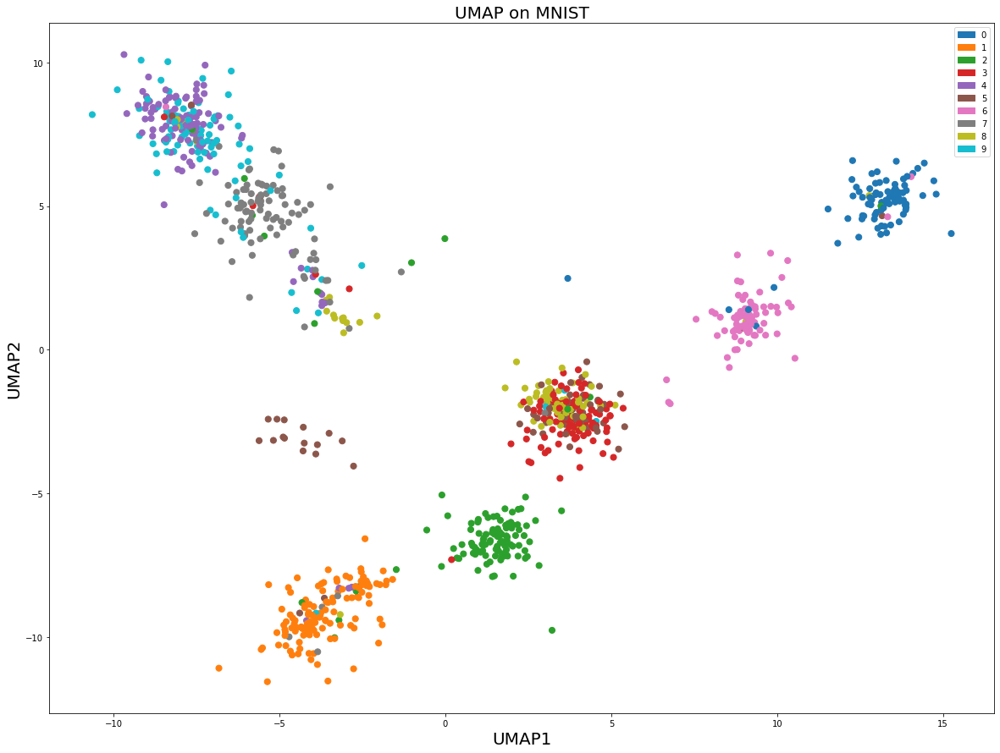


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 36.407460325421 after 0 iterations
Cross-Entropy = 3.0829759016437723 after 10 iterations
Cross-Entropy = 1.199671424390289 after 20 iterations
Cross-Entropy = 0.8457442336090797 after 30 iterations
Cross-Entropy = 0.7211551071462032 after 40 iterations
Cross-Entropy = 0.6511115599072682 after 50 iterations
Cross-Entropy = 0.6018371001001778 after 60 iterations
Cross-Entropy = 0.5966091551168923 after 70 iterations
Cross-Entrop

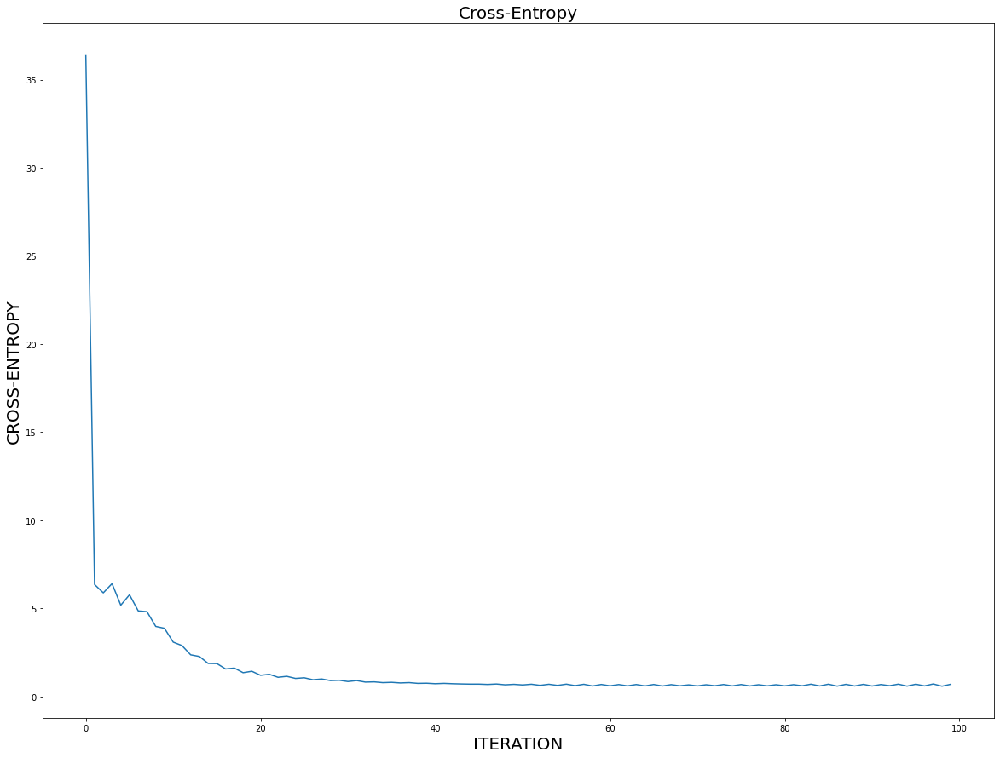

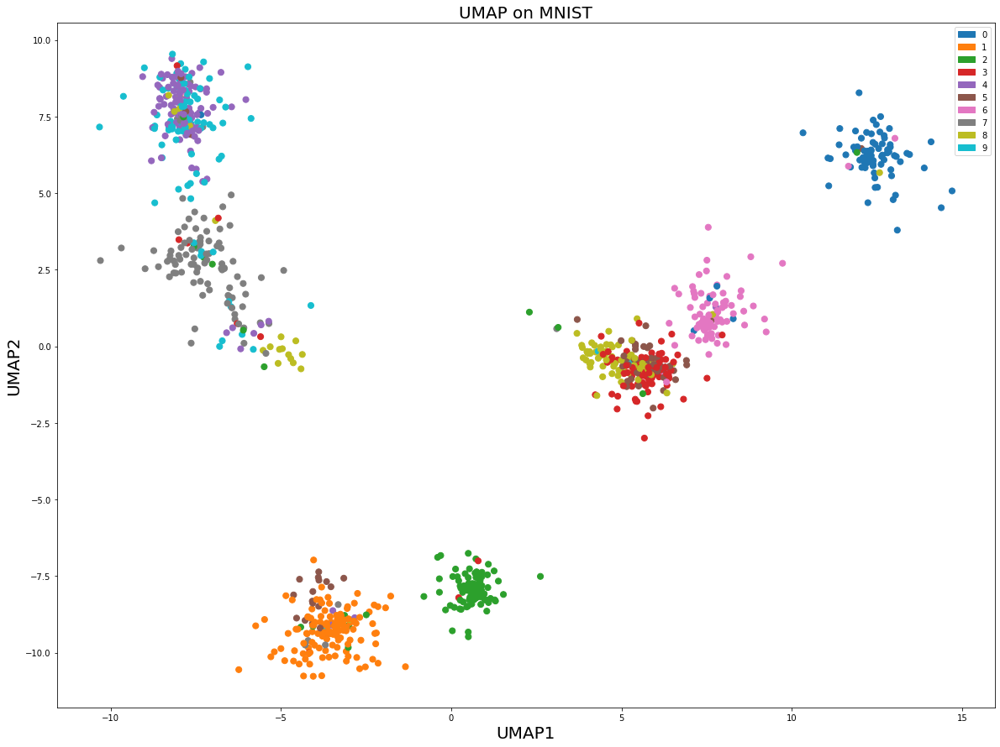


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 30.10228933441283 after 0 iterations
Cross-Entropy = 4.145636090596952 after 10 iterations
Cross-Entropy = 1.489048405157754 after 20 iterations
Cross-Entropy = 0.916059704622304 after 30 iterations
Cross-Entropy = 0.7272600141853399 after 40 iterations
Cross-Entropy = 0.6341696261300578 after 50 iterations
Cross-Entropy = 0.6433907393693762 after 60 iterations
Cross-Entropy = 0.5890761041211235 after 70 iterations
Cross-Entrop

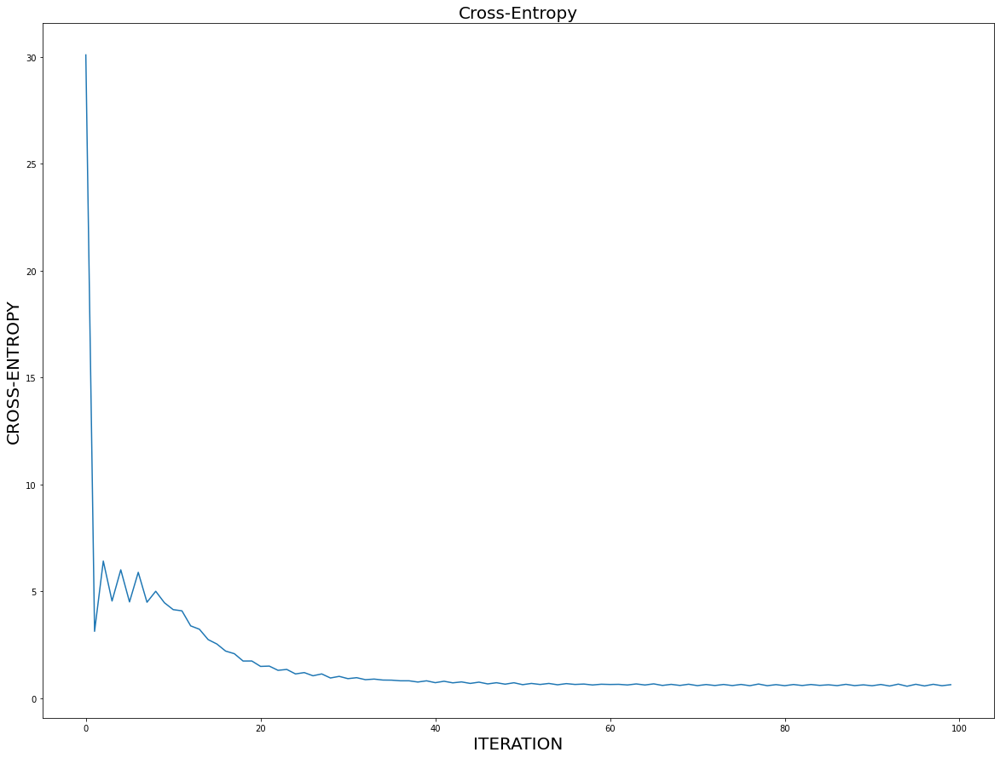

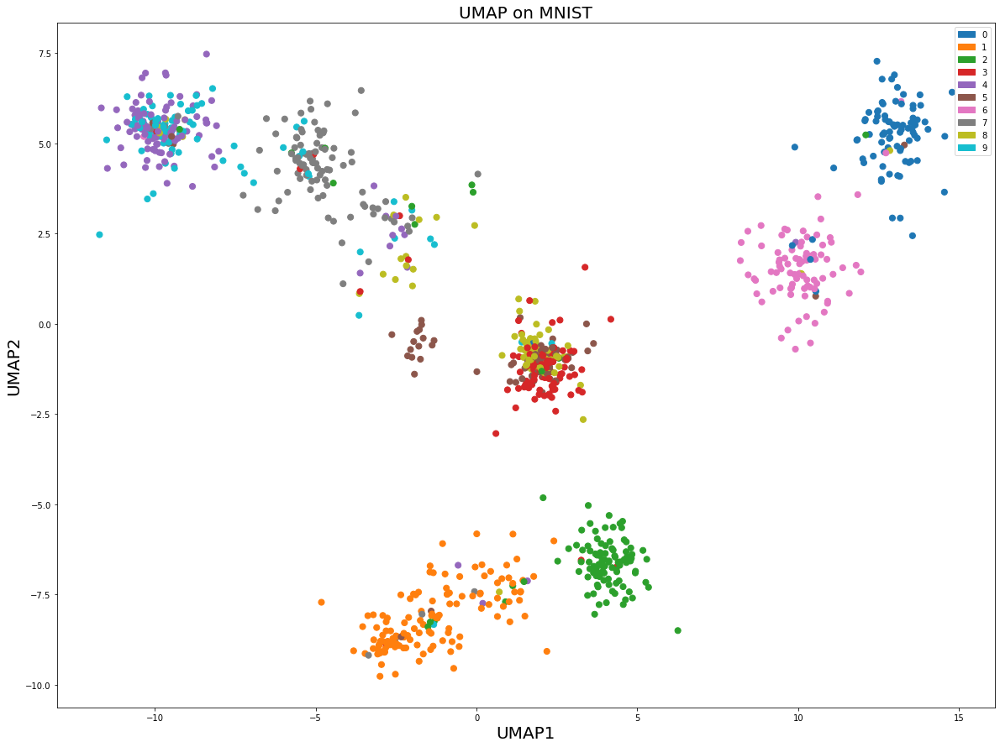


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 40.1932010177974 after 0 iterations
Cross-Entropy = 2.3348021672395456 after 10 iterations
Cross-Entropy = 1.0548203939469118 after 20 iterations
Cross-Entropy = 0.776571887044313 after 30 iterations
Cross-Entropy = 0.6685004217537145 after 40 iterations
Cross-Entropy = 0.6510847042079417 after 50 iterations
Cross-Entropy = 0.5967106540331267 after 60 iterations
Cross-Entropy = 0.6016380250918792 after 70 iterations
Cross-Entro

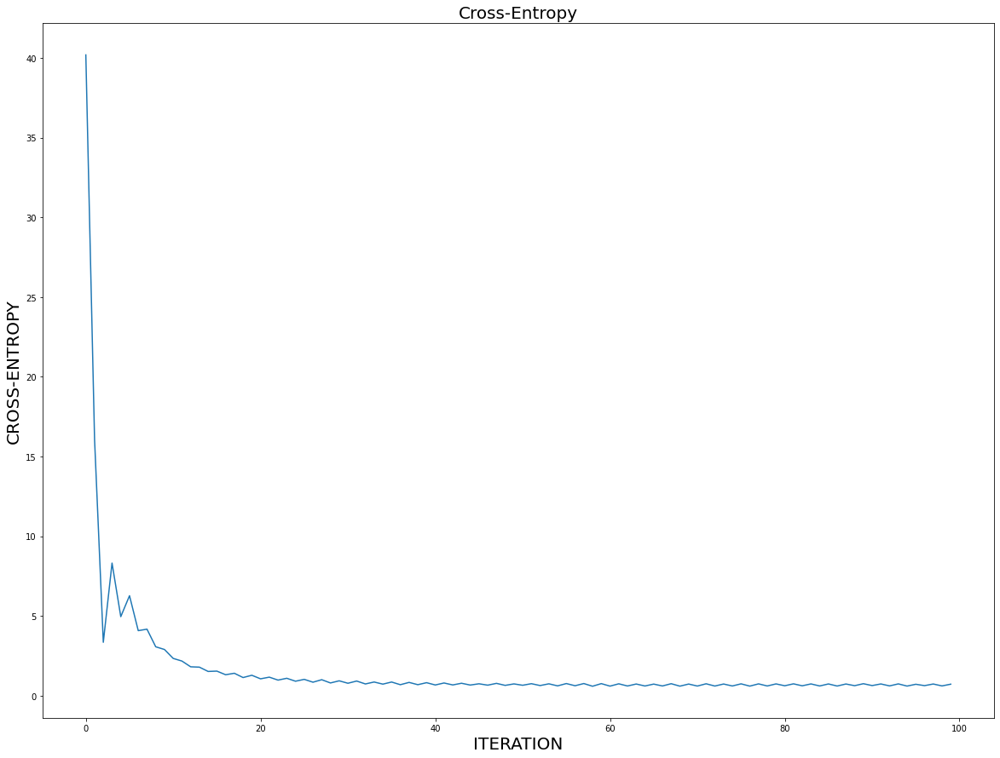

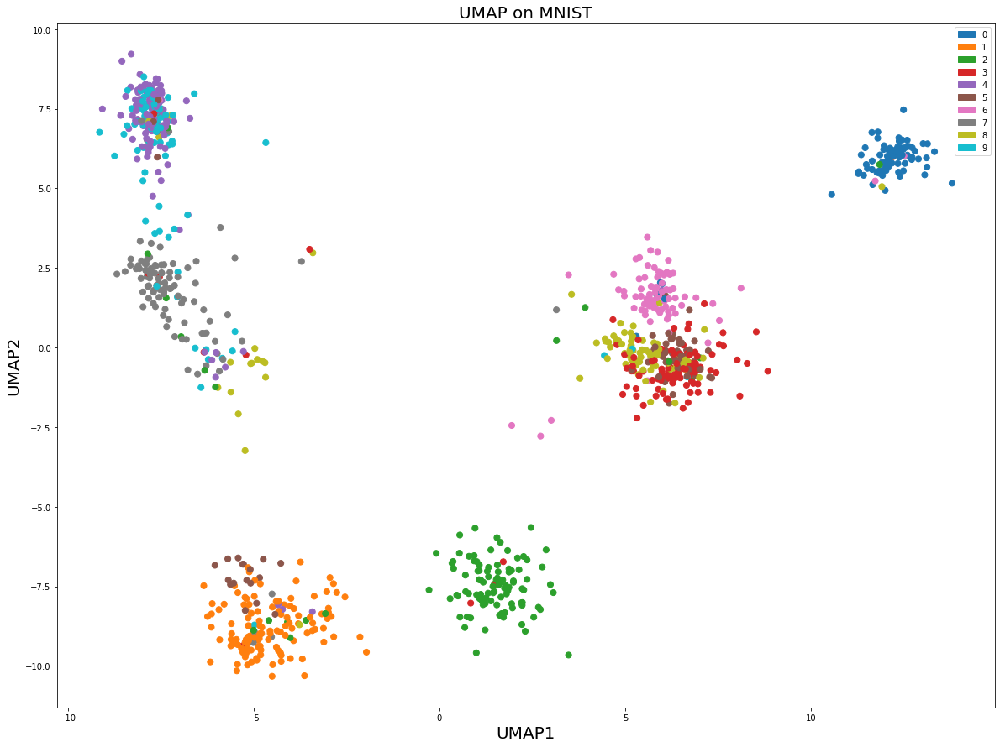


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 44.81368219566253 after 0 iterations
Cross-Entropy = 1.5755952856679247 after 10 iterations
Cross-Entropy = 0.8751787304088179 after 20 iterations
Cross-Entropy = 0.7665435681174483 after 30 iterations
Cross-Entropy = 0.6989883844459251 after 40 iterations
Cross-Entropy = 0.6768429040479219 after 50 iterations
Cross-Entropy = 0.671238912041888 after 60 iterations
Cross-Entropy = 0.6500275679814088 after 70 iterations
Cross-Entr

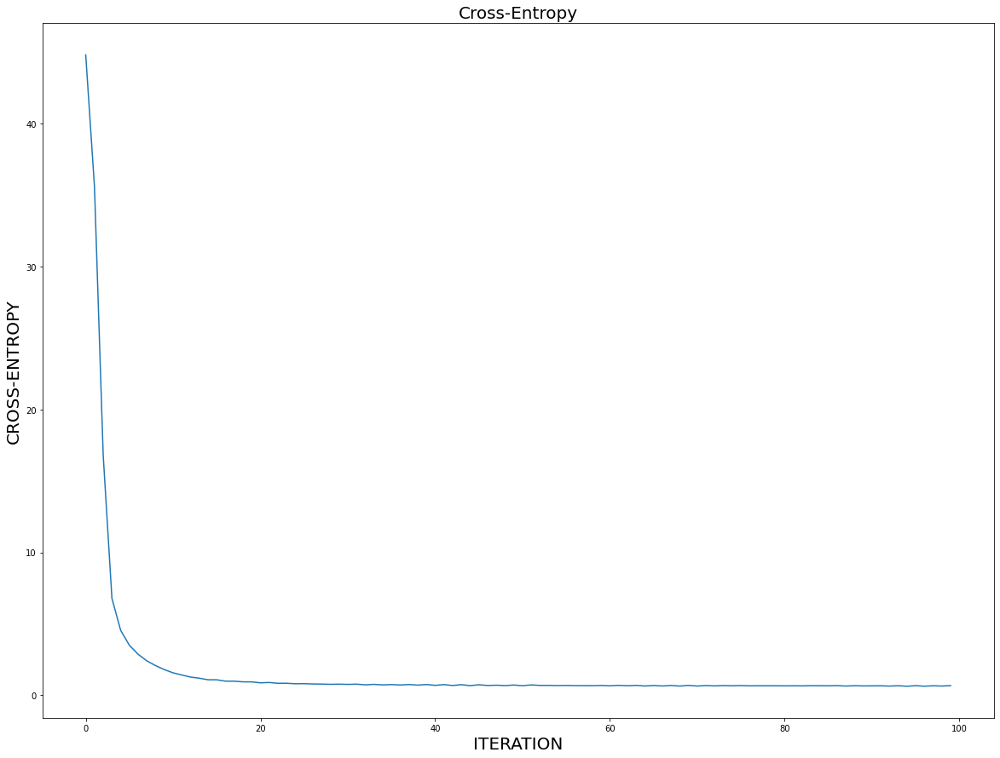

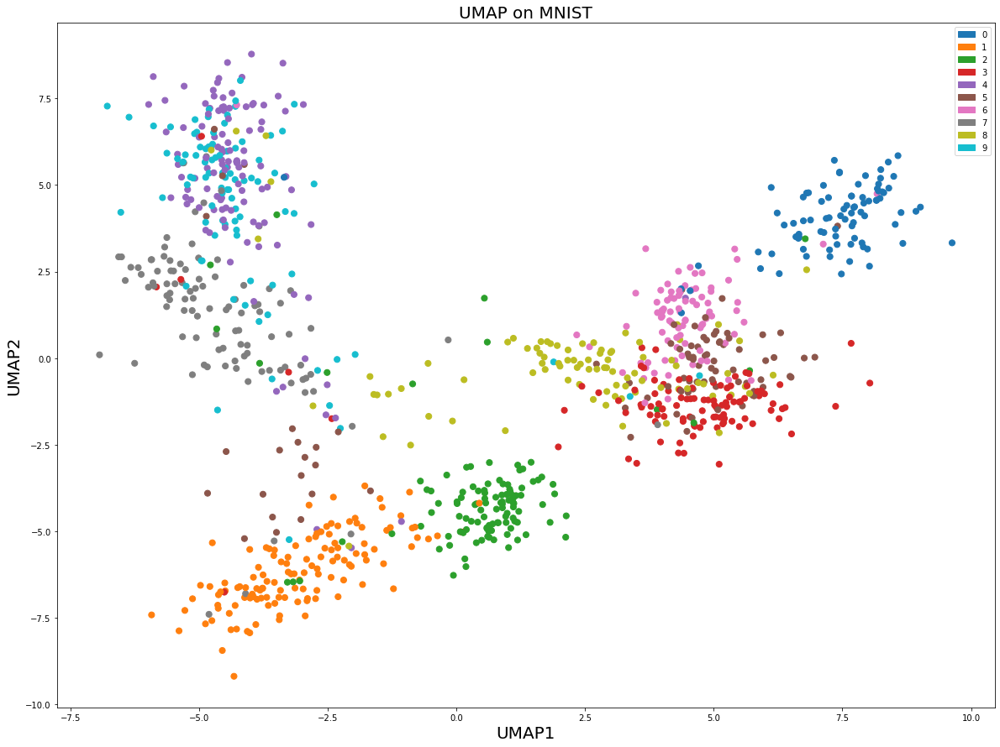


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 163.01490451480532
Running Gradient Descent: 

Cross-Entropy = 45.736647360953114 after 0 iterations
Cross-Entropy = 1.347848232068472 after 10 iterations
Cross-Entropy = 1.0195759325329188 after 20 iterations
Cross-Entropy = 0.9439390853316854 after 30 iterations
Cross-Entropy = 0.917986767015456 after 40 iterations
Cross-Entropy = 0.9007690468358382 after 50 iterations
Cross-Entropy = 0.8905347173741082 after 60 iterations
Cross-Entropy = 0.877291548739805 after 70 iterations
Cross-Entro

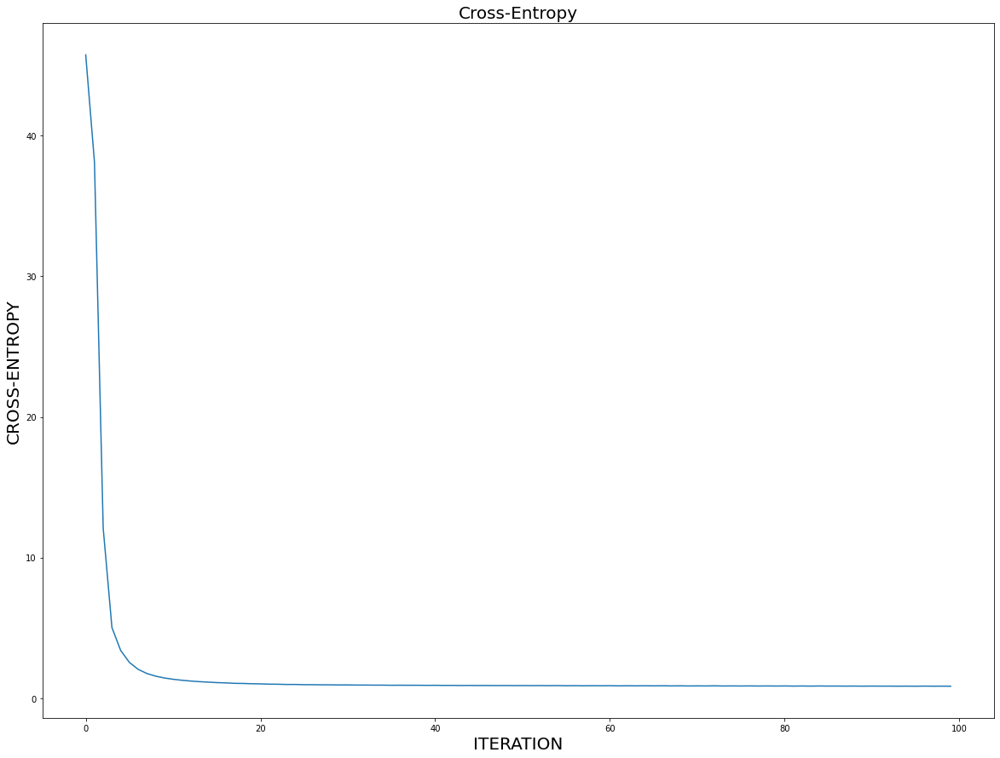

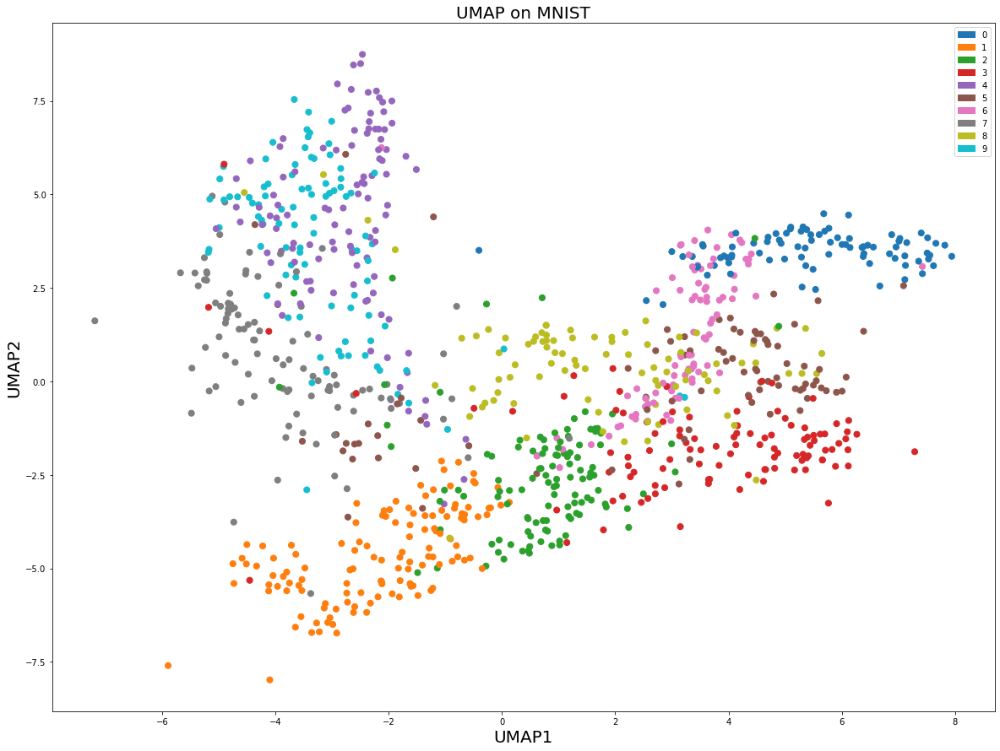


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 28.288848523060228 after 0 iterations
Cross-Entropy = 4.76212147031601 after 10 iterations
Cross-Entropy = 1.7892071810697456 after 20 iterations
Cross-Entropy = 0.9777646437102336 after 30 iterations
Cross-Entropy = 0.7933594906431252 after 40 iterations
Cross-Entropy = 0.6930864950711755 after 50 iterations
Cross-Entropy = 0.6504775477977649 after 60 iterations
Cross-Entropy = 0.6056059428190538 after 70 iterations
Cross-Entro

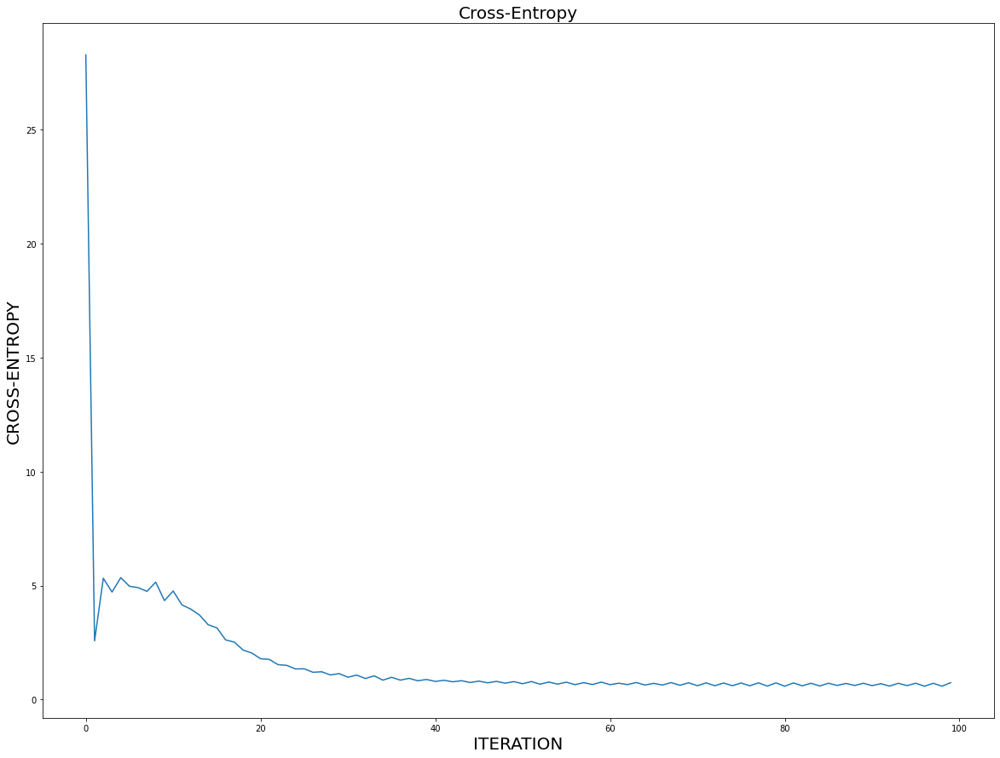

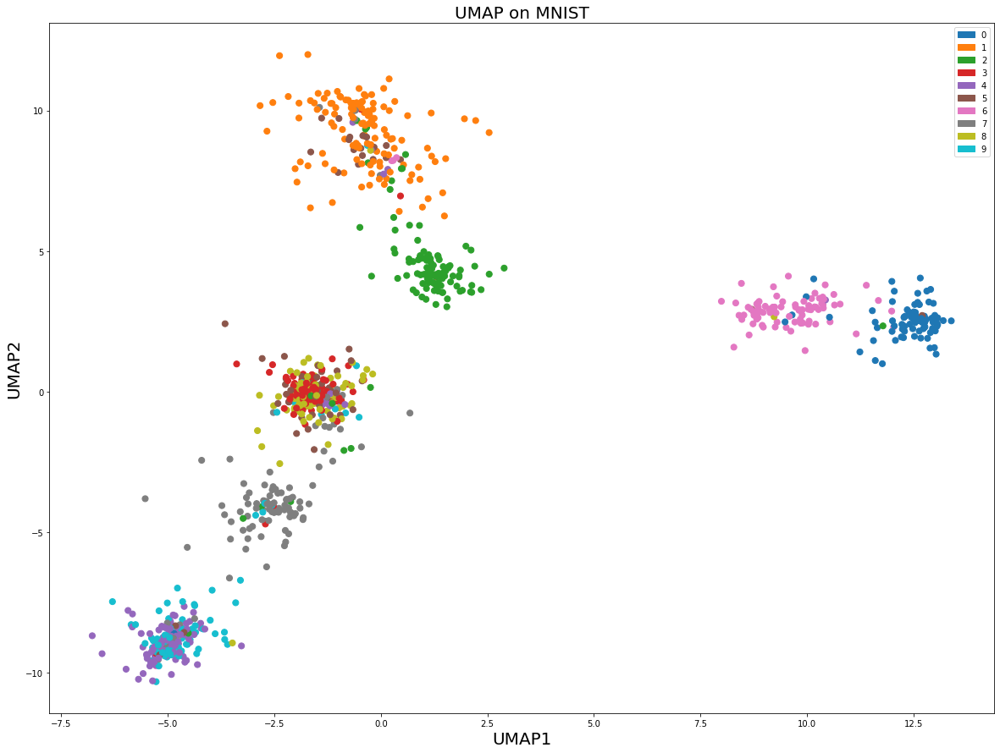


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 32.746538250827264 after 0 iterations
Cross-Entropy = 5.0689205353417455 after 10 iterations
Cross-Entropy = 1.7453972840733483 after 20 iterations
Cross-Entropy = 1.0710211199827522 after 30 iterations
Cross-Entropy = 0.8666767088022684 after 40 iterations
Cross-Entropy = 0.7880662842120598 after 50 iterations
Cross-Entropy = 0.7842772369544806 after 60 iterations
Cross-Entropy = 0.7659623881135884 after 70 iterations
Cross-Ent

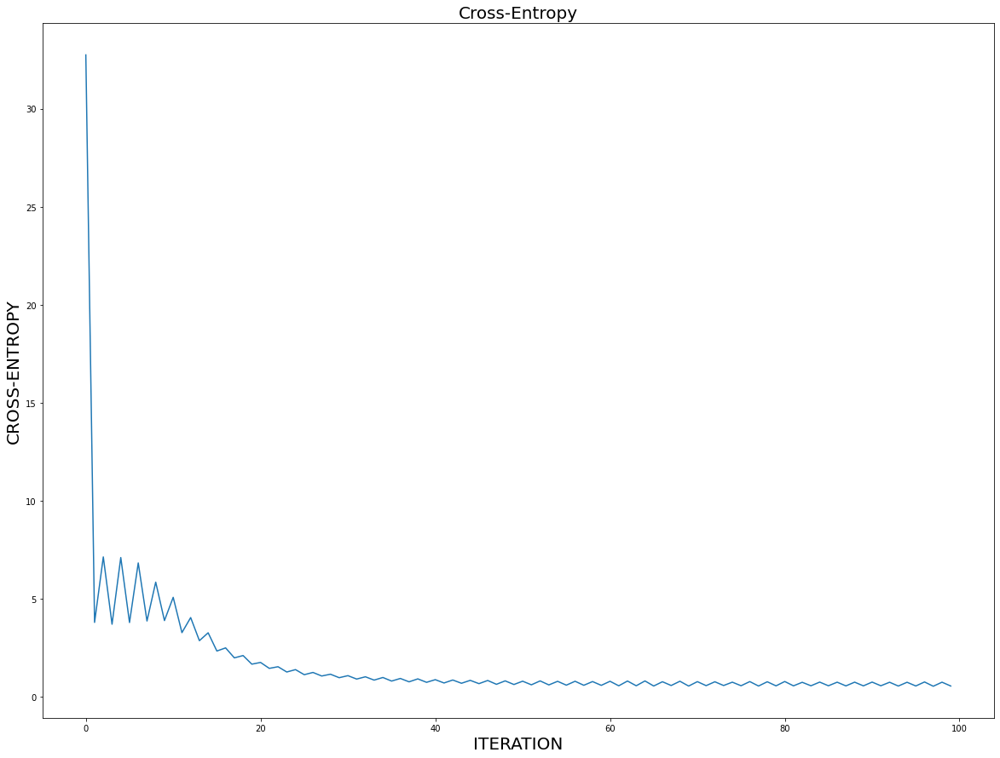

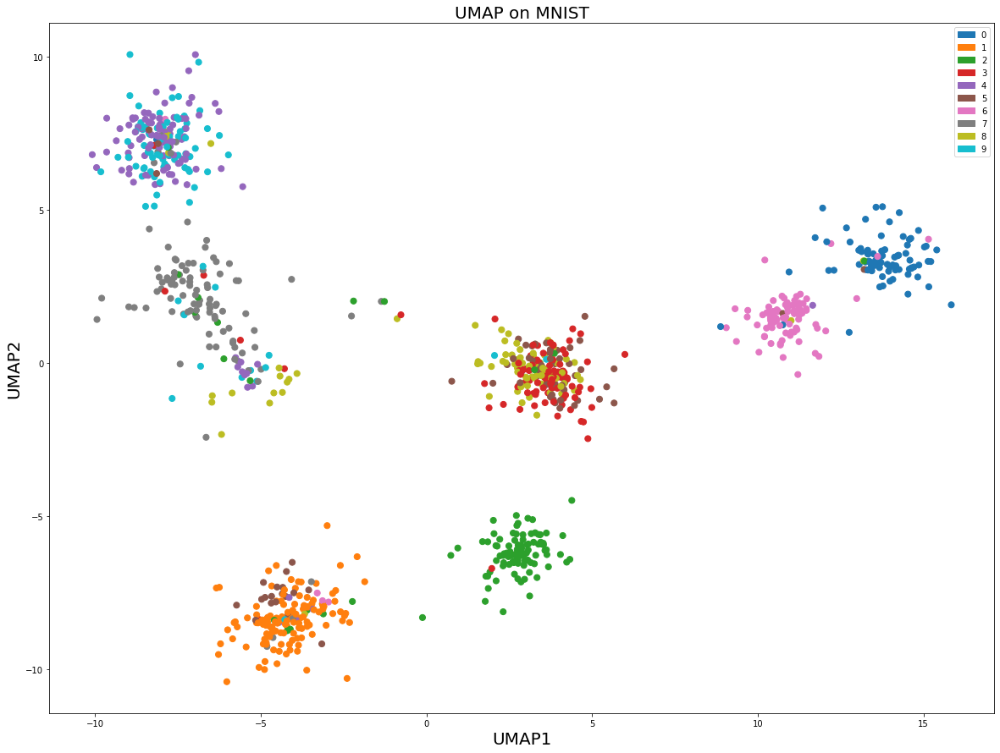


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 36.5451640757954 after 0 iterations
Cross-Entropy = 3.713576951572541 after 10 iterations
Cross-Entropy = 1.474193583044479 after 20 iterations
Cross-Entropy = 0.9395029566155066 after 30 iterations
Cross-Entropy = 0.7521447504537122 after 40 iterations
Cross-Entropy = 0.6696715328839 after 50 iterations
Cross-Entropy = 0.613772790165212 after 60 iterations
Cross-Entropy = 0.6300245322950184 after 70 iterations
Cross-Entropy = 0

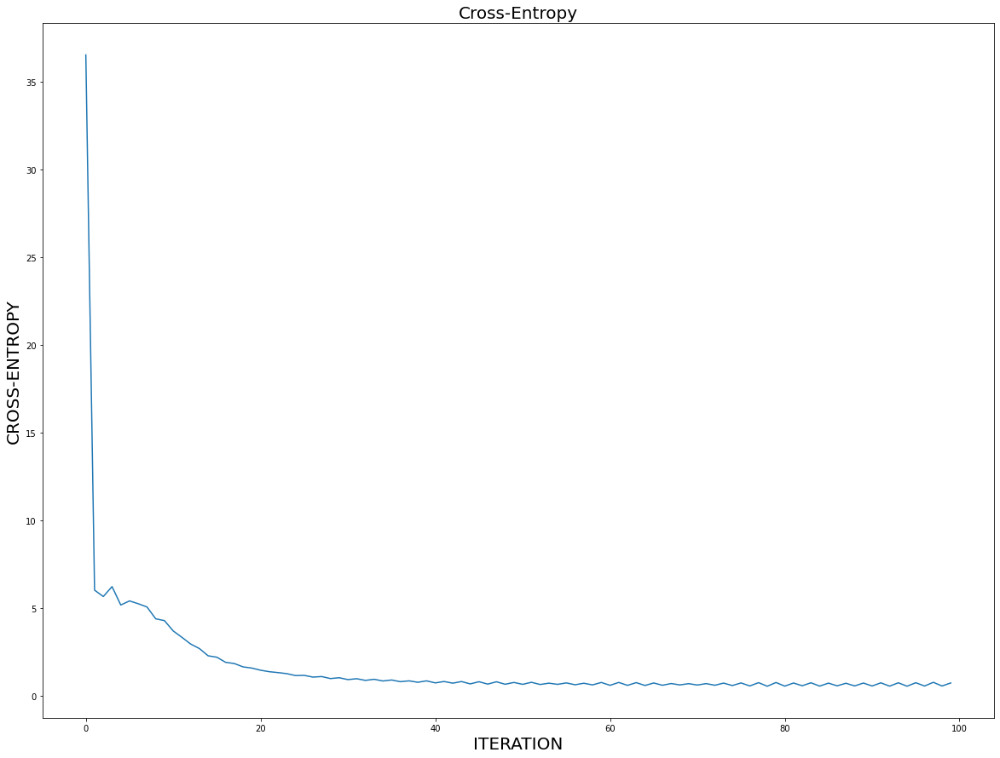

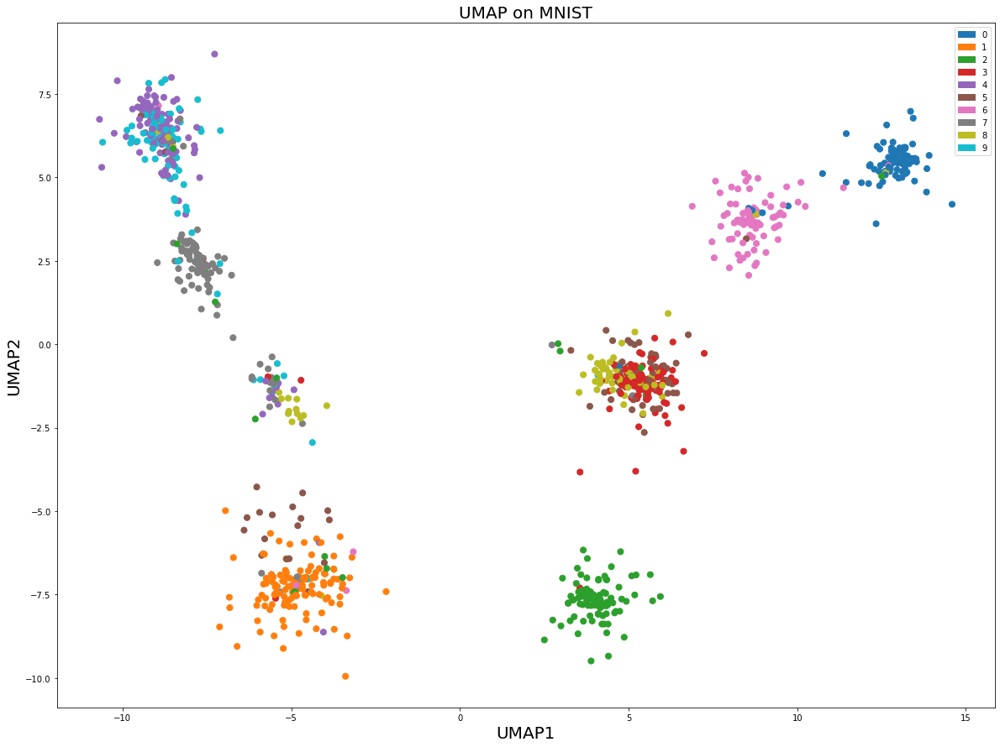


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 30.0207078774946 after 0 iterations
Cross-Entropy = 4.533171178551857 after 10 iterations
Cross-Entropy = 1.770567362263054 after 20 iterations
Cross-Entropy = 1.0424230348150976 after 30 iterations
Cross-Entropy = 0.7965024076992704 after 40 iterations
Cross-Entropy = 0.7325873341456849 after 50 iterations
Cross-Entropy = 0.6682846493583653 after 60 iterations
Cross-Entropy = 0.6228824735714146 after 70 iterations
Cross-Entropy

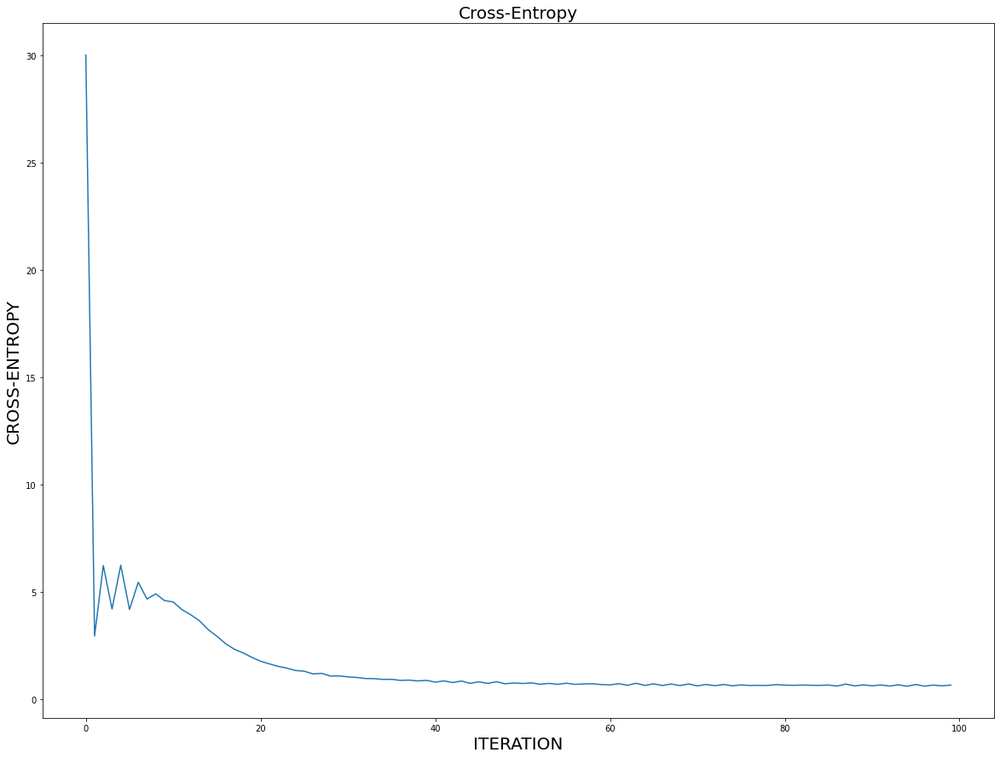

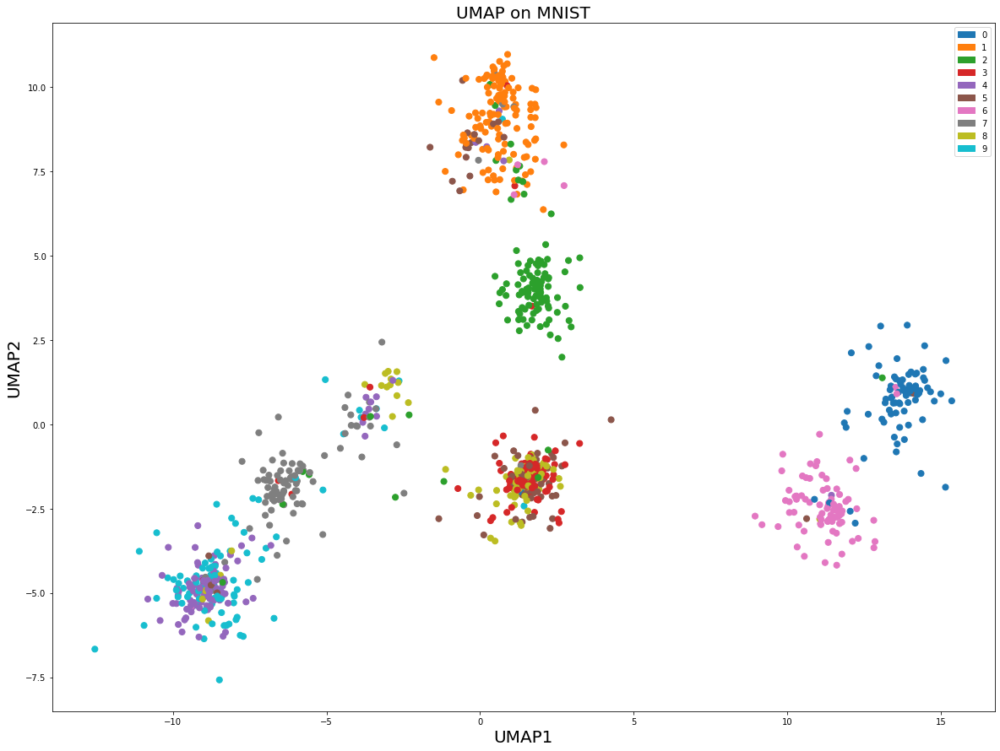


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 40.58197911619046 after 0 iterations
Cross-Entropy = 2.6280319073886425 after 10 iterations
Cross-Entropy = 1.1640900266035767 after 20 iterations
Cross-Entropy = 0.8652577529451755 after 30 iterations
Cross-Entropy = 0.7135183373281866 after 40 iterations
Cross-Entropy = 0.6577267023519635 after 50 iterations
Cross-Entropy = 0.6592243657698482 after 60 iterations
Cross-Entropy = 0.7051753806428142 after 70 iterations
Cross-Entr

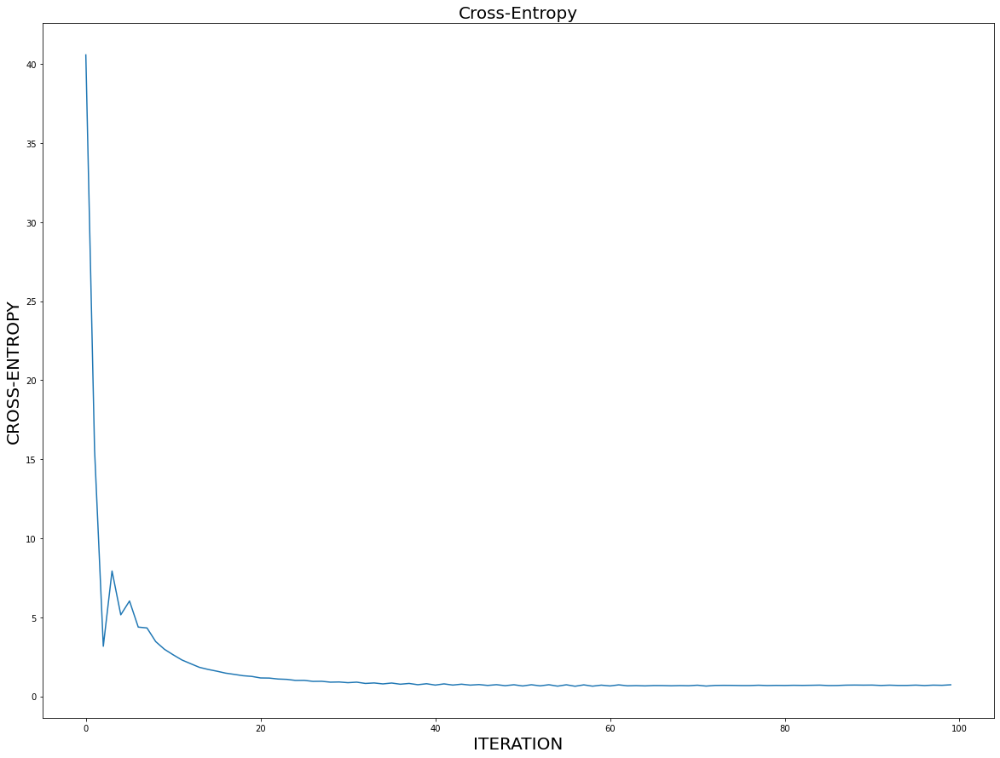

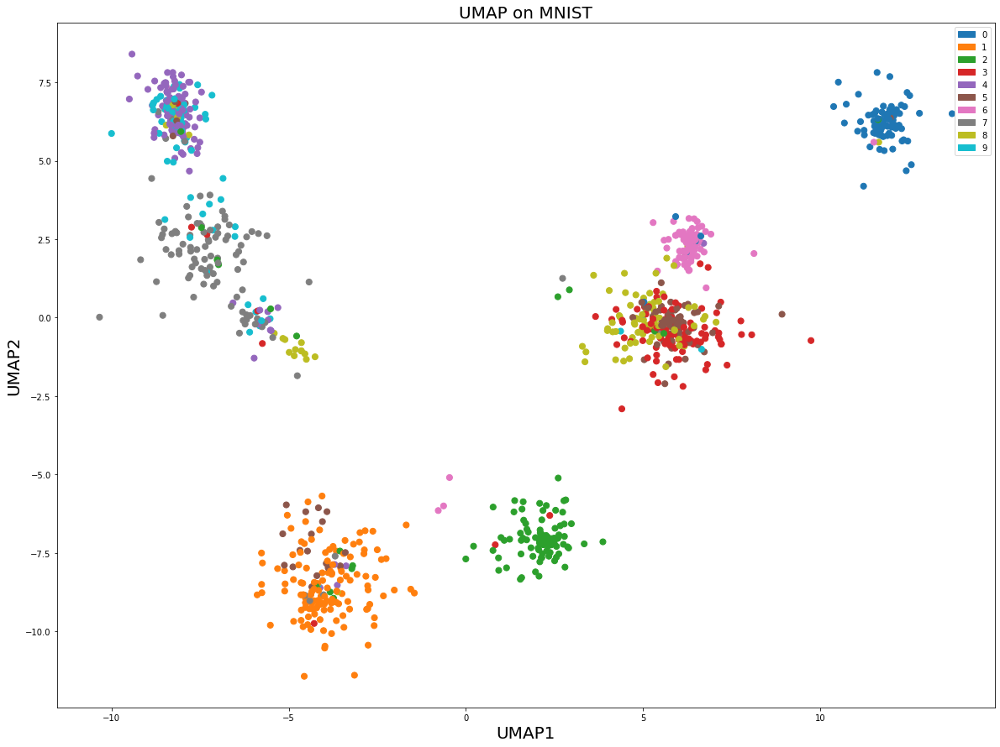


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 44.9144227109958 after 0 iterations
Cross-Entropy = 1.6050275231341682 after 10 iterations
Cross-Entropy = 0.9266491154708545 after 20 iterations
Cross-Entropy = 0.8050720177238738 after 30 iterations
Cross-Entropy = 0.7397796554088824 after 40 iterations
Cross-Entropy = 0.6978666569196532 after 50 iterations
Cross-Entropy = 0.720053789028196 after 60 iterations
Cross-Entropy = 0.7120030334800722 after 70 iterations
Cross-Entrop

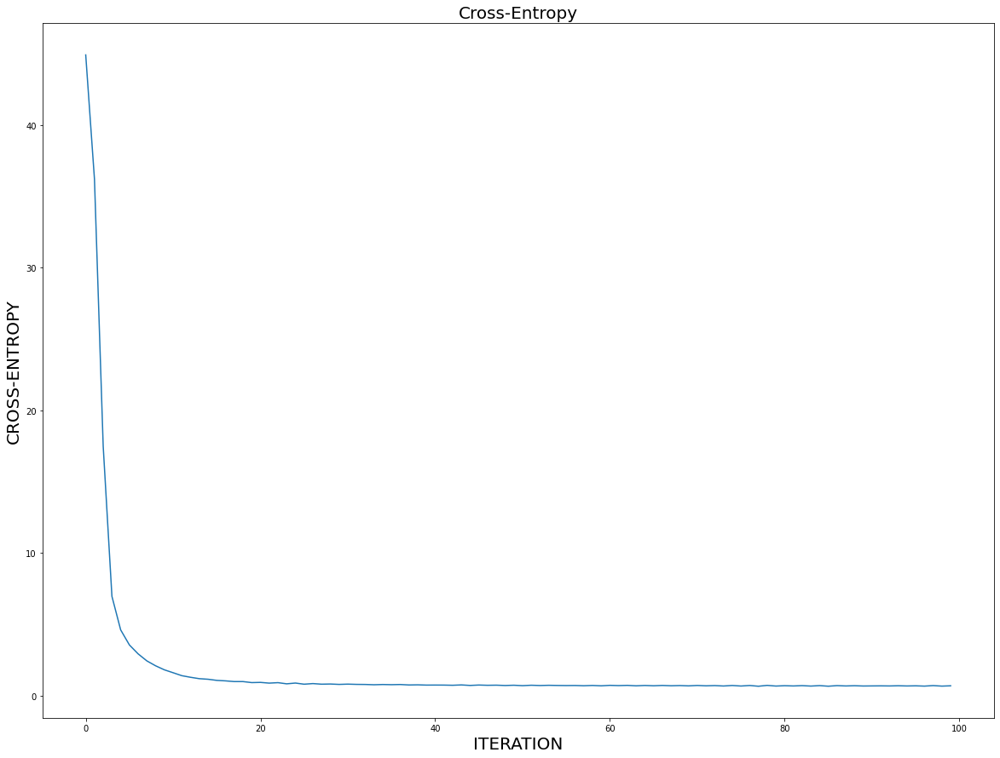

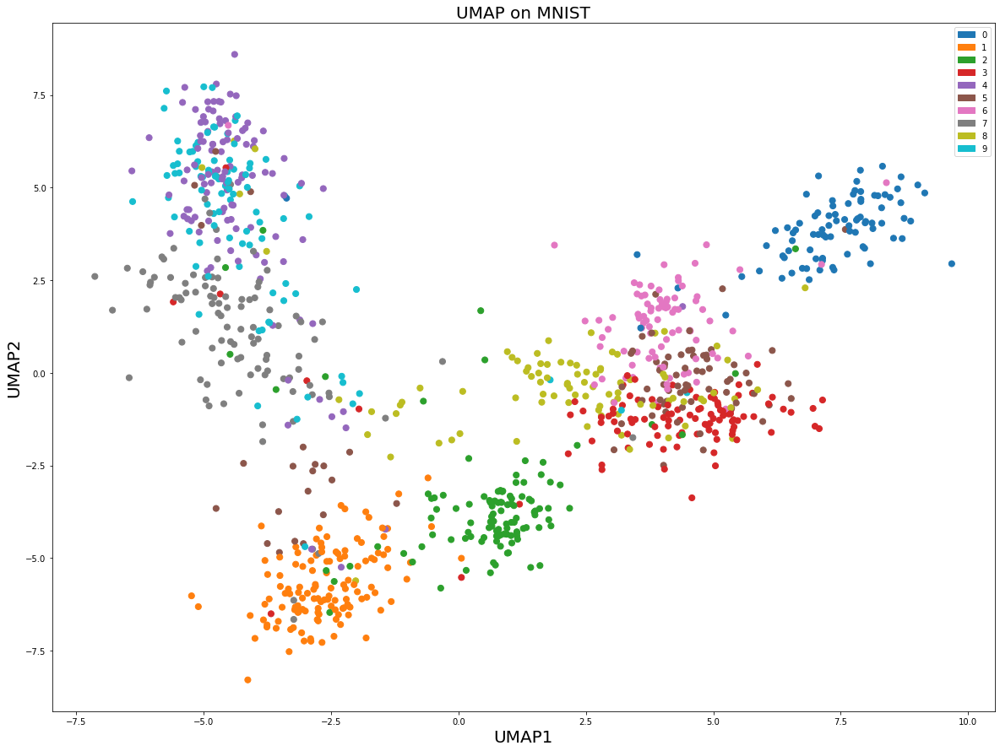


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 169.3518335993464
Running Gradient Descent: 

Cross-Entropy = 45.741619098326844 after 0 iterations
Cross-Entropy = 1.4167880849740113 after 10 iterations
Cross-Entropy = 1.083046965969141 after 20 iterations
Cross-Entropy = 1.002101188130575 after 30 iterations
Cross-Entropy = 0.9752408019942612 after 40 iterations
Cross-Entropy = 0.9535202645033007 after 50 iterations
Cross-Entropy = 0.9447338932878196 after 60 iterations
Cross-Entropy = 0.9392641391136524 after 70 iterations
Cross-Entro

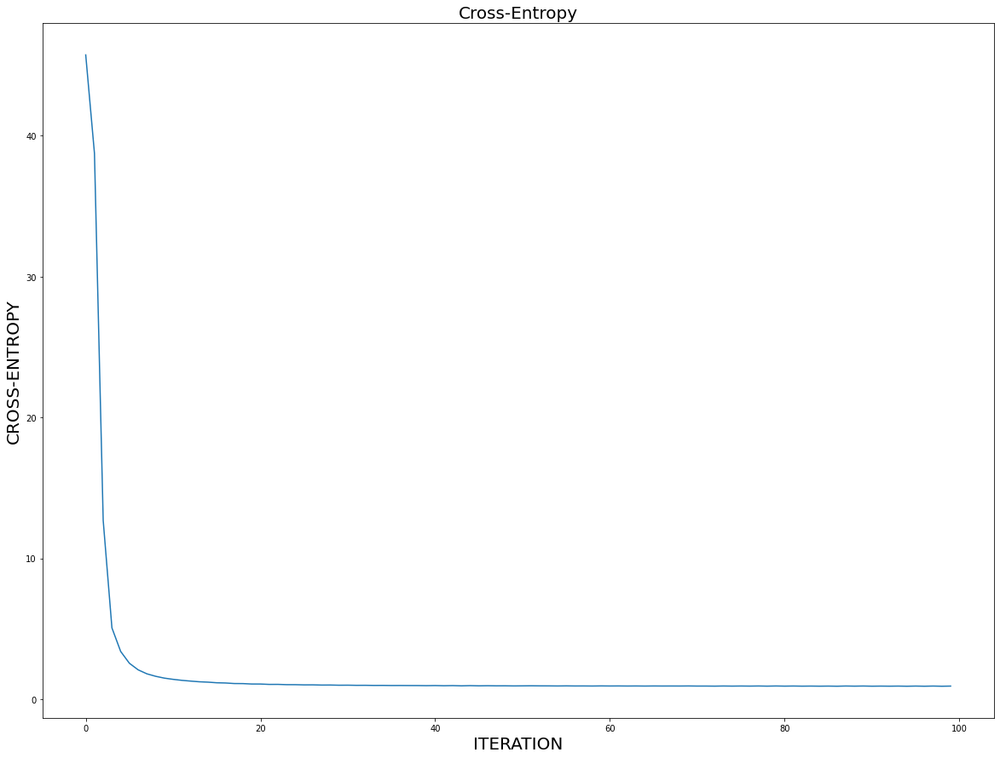

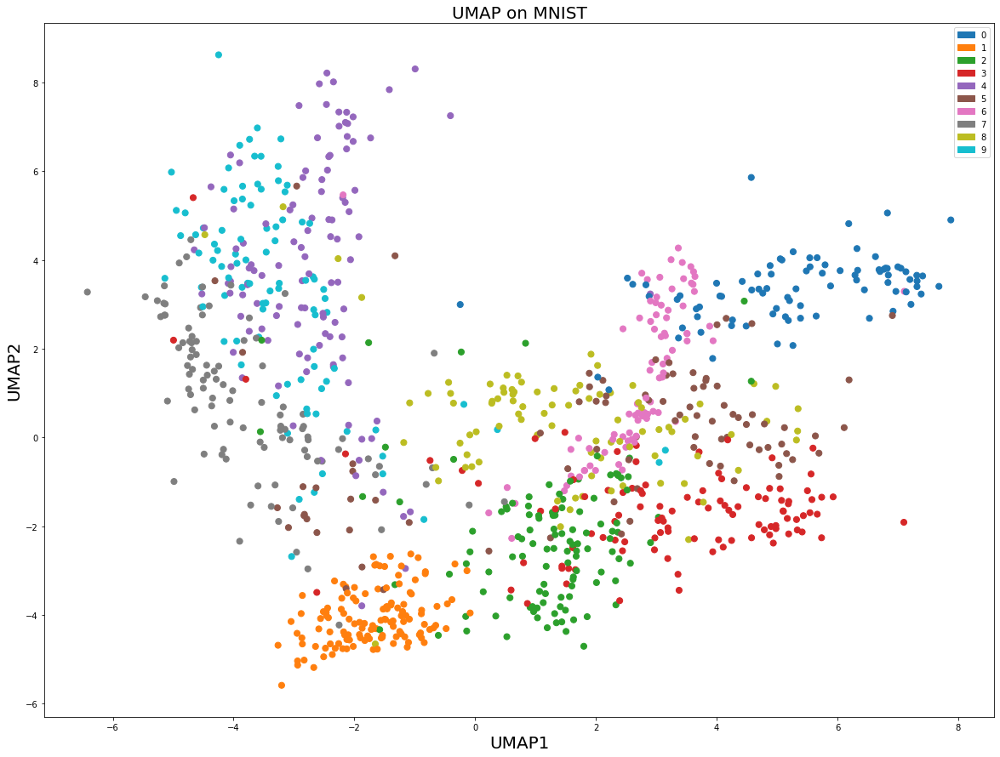


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 27.90882919982824 after 0 iterations
Cross-Entropy = 4.612816216443128 after 10 iterations
Cross-Entropy = 1.9975572631868979 after 20 iterations
Cross-Entropy = 1.0013146607173755 after 30 iterations
Cross-Entropy = 0.7694488417143656 after 40 iterations
Cross-Entropy = 0.6447390900154281 after 50 iterations
Cross-Entropy = 0.6148370371465142 after 60 iterations
Cross-Entropy = 0.5877040732003777 after 70 iterations
Cross-Entr

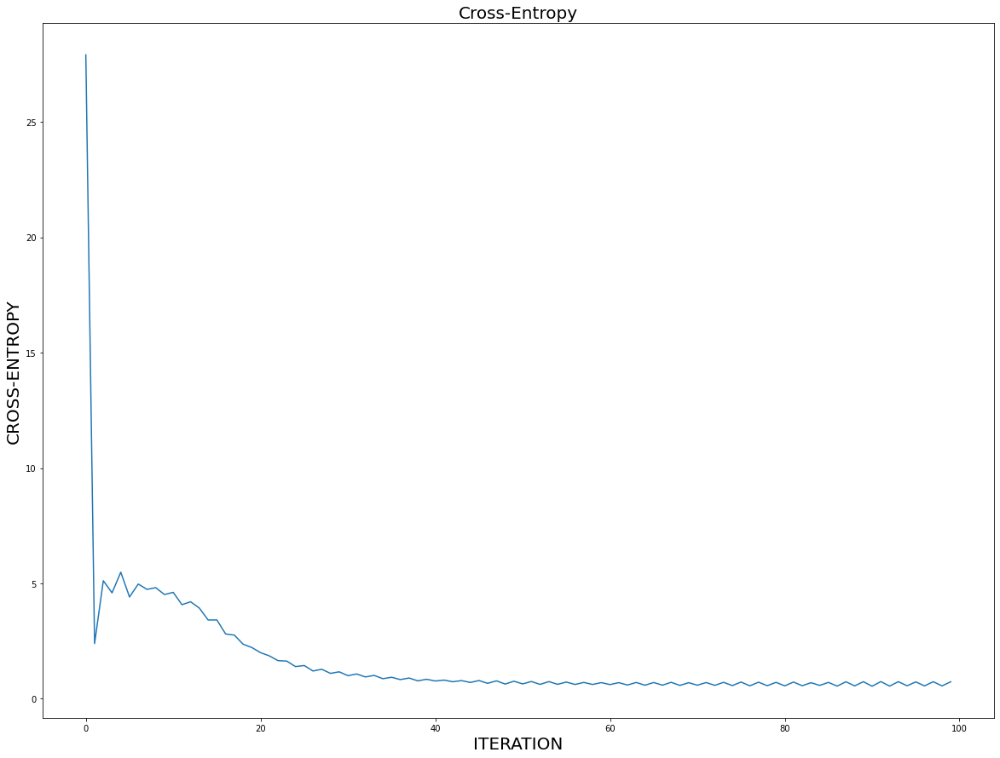

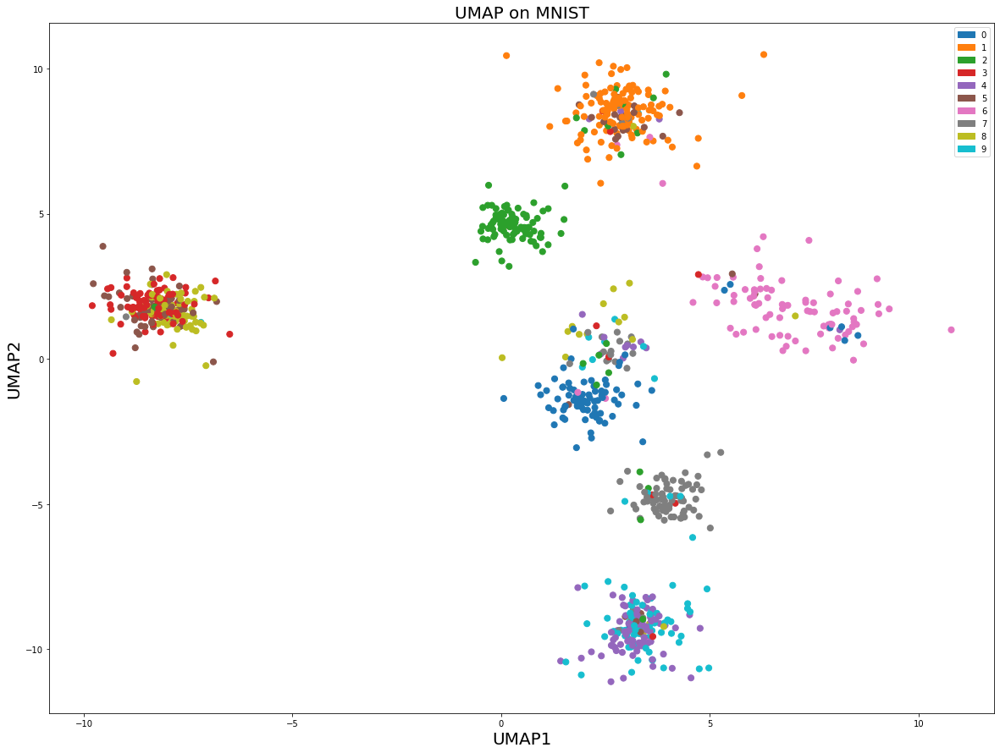


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 32.51108652103703 after 0 iterations
Cross-Entropy = 5.641265503430364 after 10 iterations
Cross-Entropy = 2.2465090107333427 after 20 iterations
Cross-Entropy = 1.2202035169704164 after 30 iterations
Cross-Entropy = 0.938250801413644 after 40 iterations
Cross-Entropy = 0.7999607339809242 after 50 iterations
Cross-Entropy = 0.7169720879019204 after 60 iterations
Cross-Entropy = 0.6980127360538904 after 70 iterations
Cross-Entro

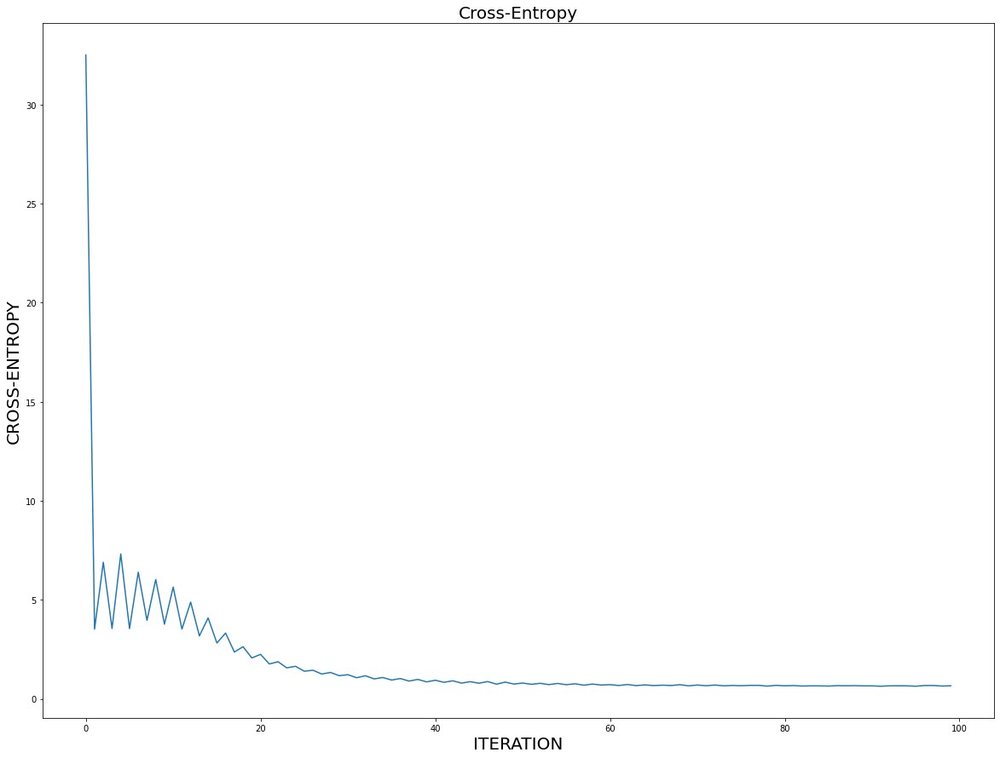

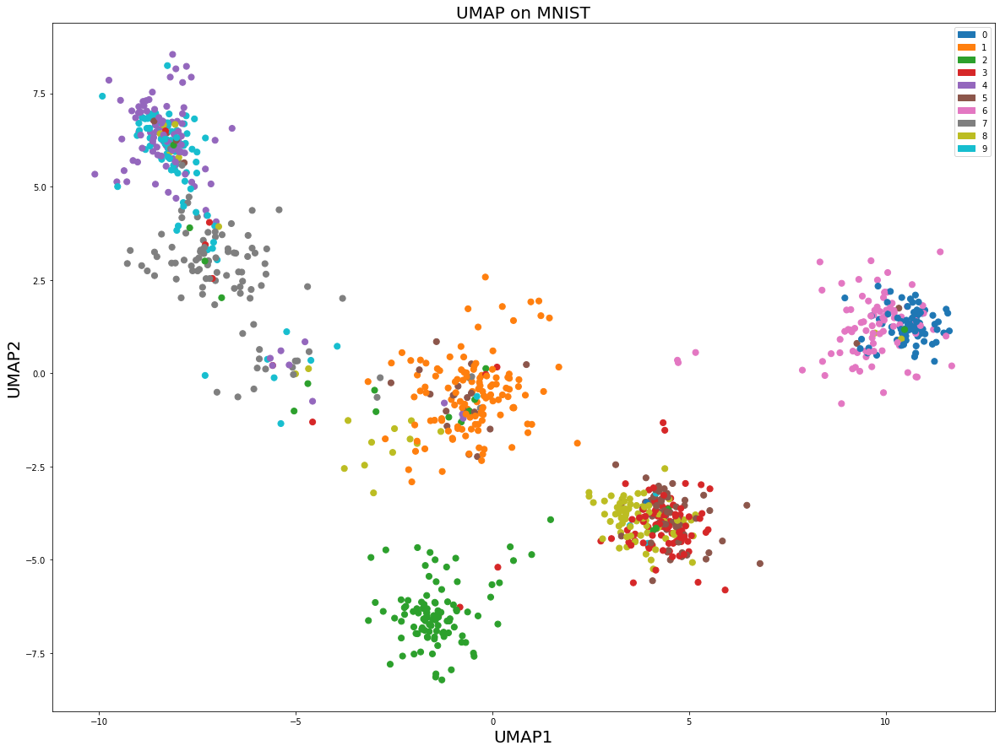


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 36.50971861413097 after 0 iterations
Cross-Entropy = 3.721563854929436 after 10 iterations
Cross-Entropy = 1.423782974496523 after 20 iterations
Cross-Entropy = 0.9444880486607605 after 30 iterations
Cross-Entropy = 0.7613305155963715 after 40 iterations
Cross-Entropy = 0.6433268251637875 after 50 iterations
Cross-Entropy = 0.6063994108989789 after 60 iterations
Cross-Entropy = 0.5841706268859325 after 70 iterations
Cross-Entro

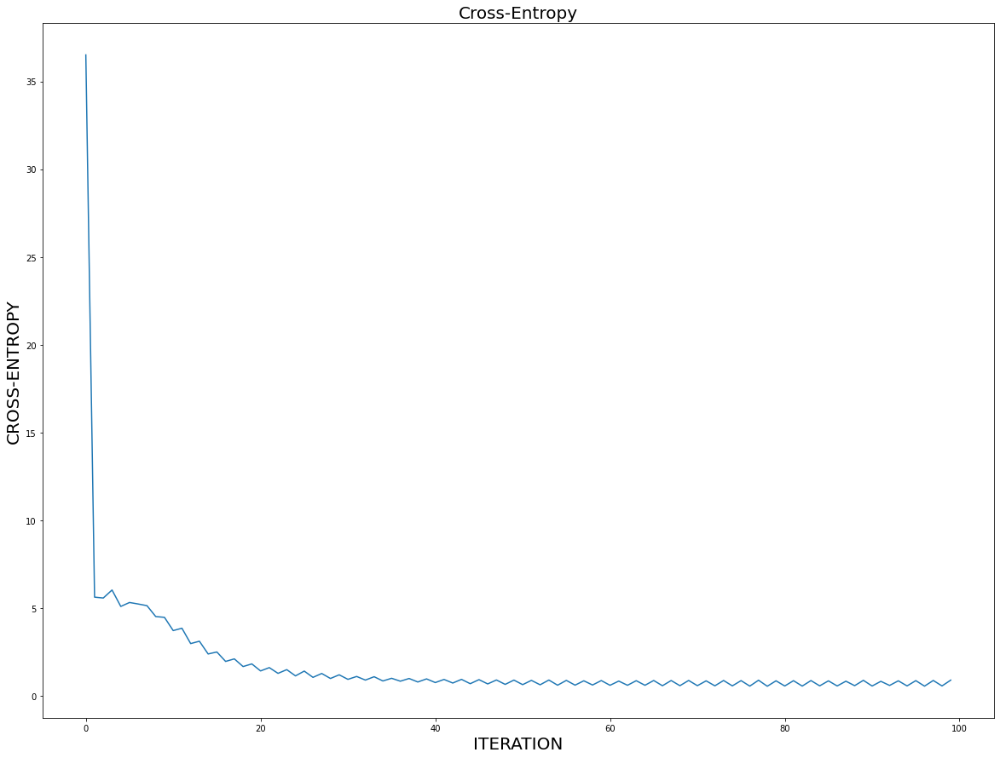

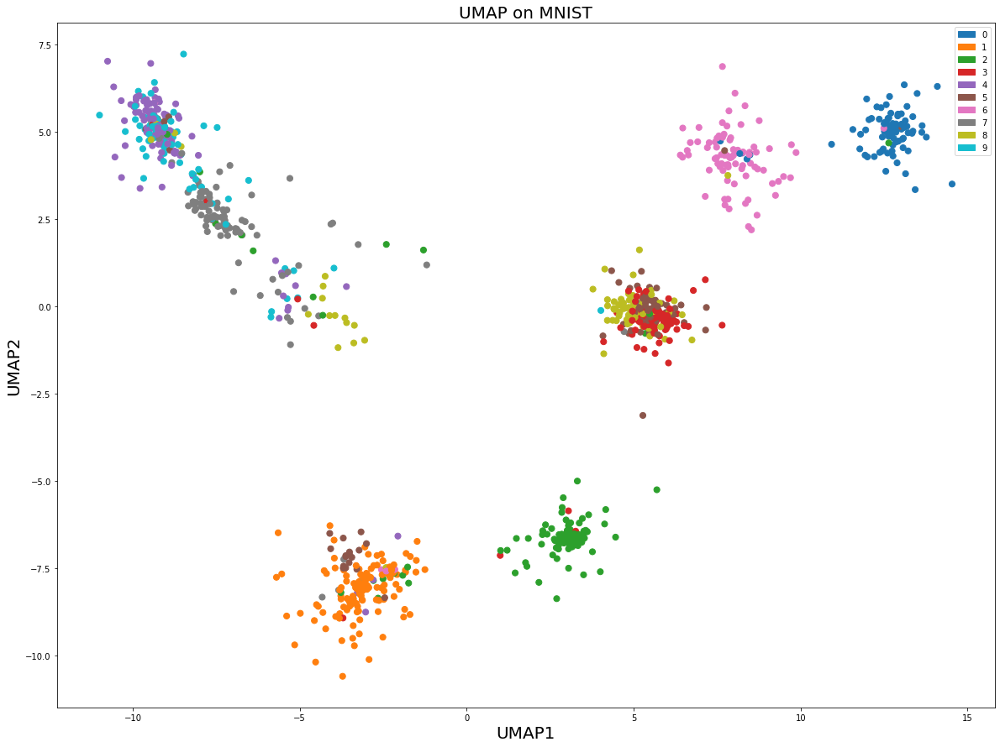


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 29.686107711989596 after 0 iterations
Cross-Entropy = 4.7368332910299635 after 10 iterations
Cross-Entropy = 2.2817255083665984 after 20 iterations
Cross-Entropy = 1.217668405612452 after 30 iterations
Cross-Entropy = 0.8568715105863437 after 40 iterations
Cross-Entropy = 0.7338353641729256 after 50 iterations
Cross-Entropy = 0.6808125745411372 after 60 iterations
Cross-Entropy = 0.642051892148165 after 70 iterations
Cross-Entr

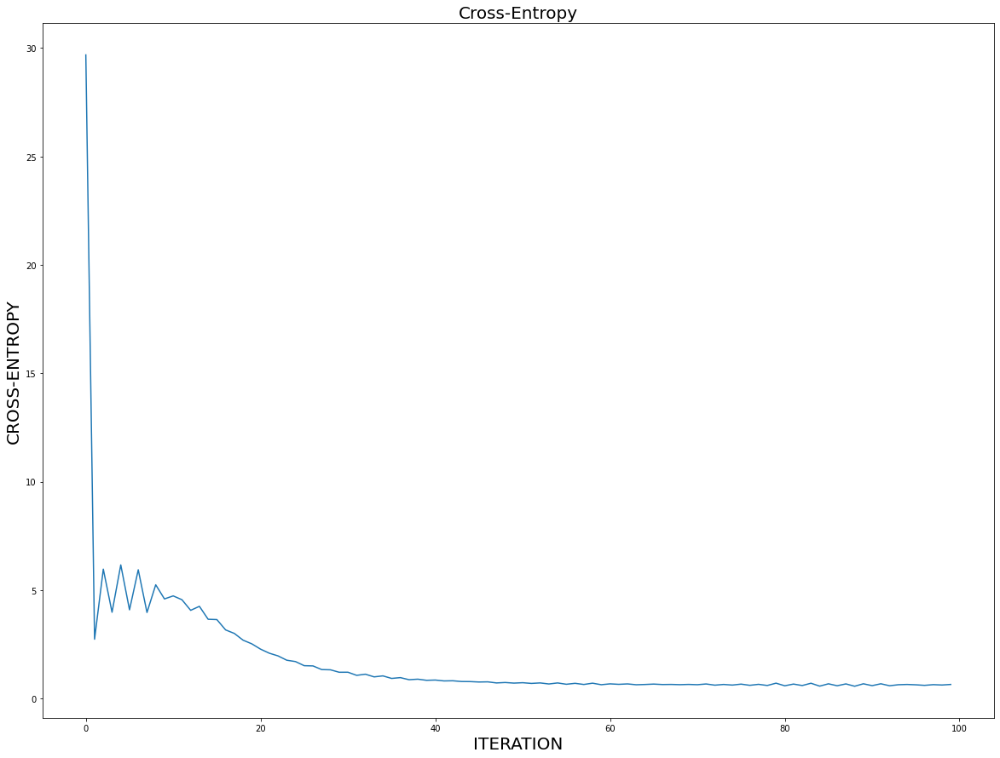

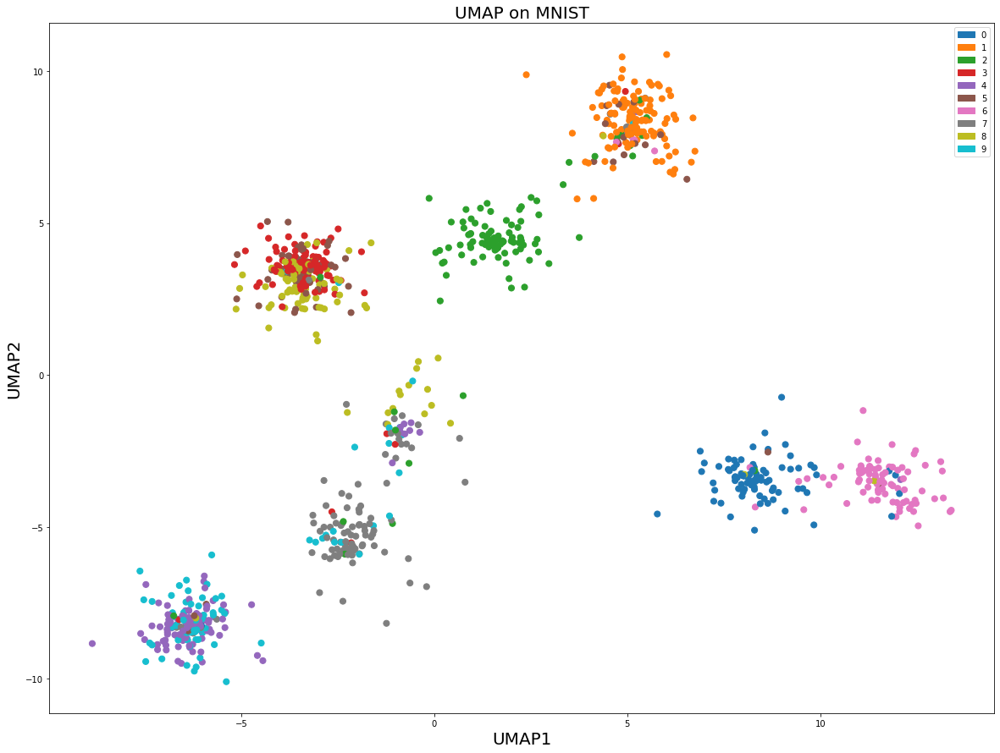


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 40.833858470830776 after 0 iterations
Cross-Entropy = 2.7285434363078305 after 10 iterations
Cross-Entropy = 1.301470173526154 after 20 iterations
Cross-Entropy = 0.9449780584290576 after 30 iterations
Cross-Entropy = 0.8455723719846219 after 40 iterations
Cross-Entropy = 0.8241076318693953 after 50 iterations
Cross-Entropy = 0.796863200053091 after 60 iterations
Cross-Entropy = 0.783334453364173 after 70 iterations
Cross-Entro

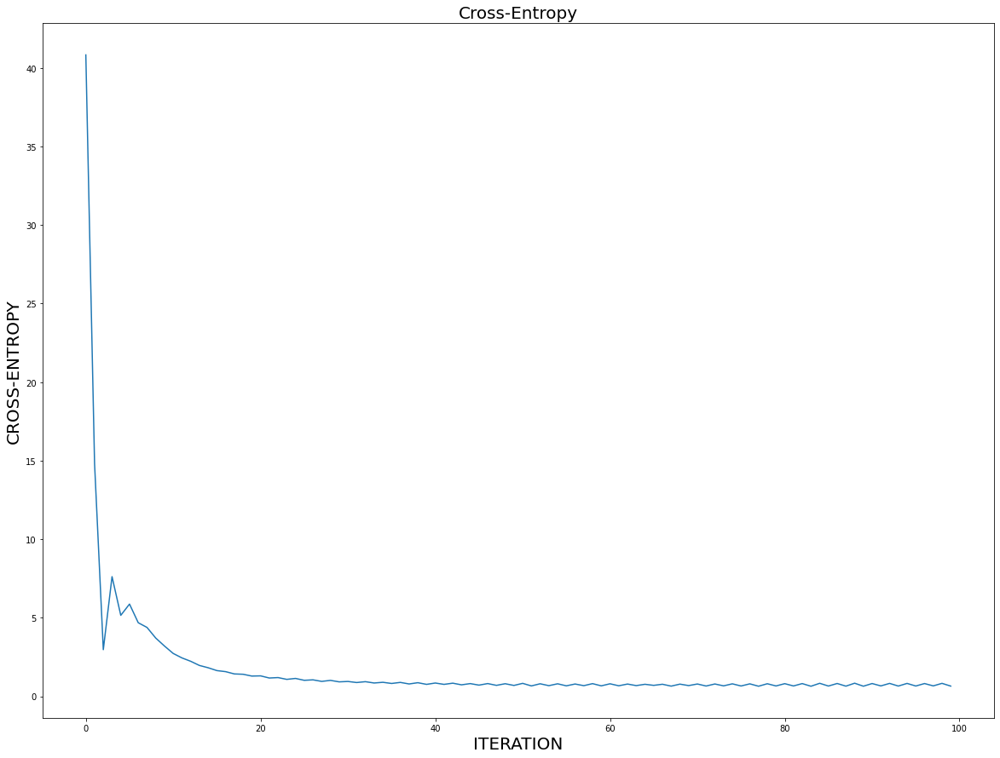

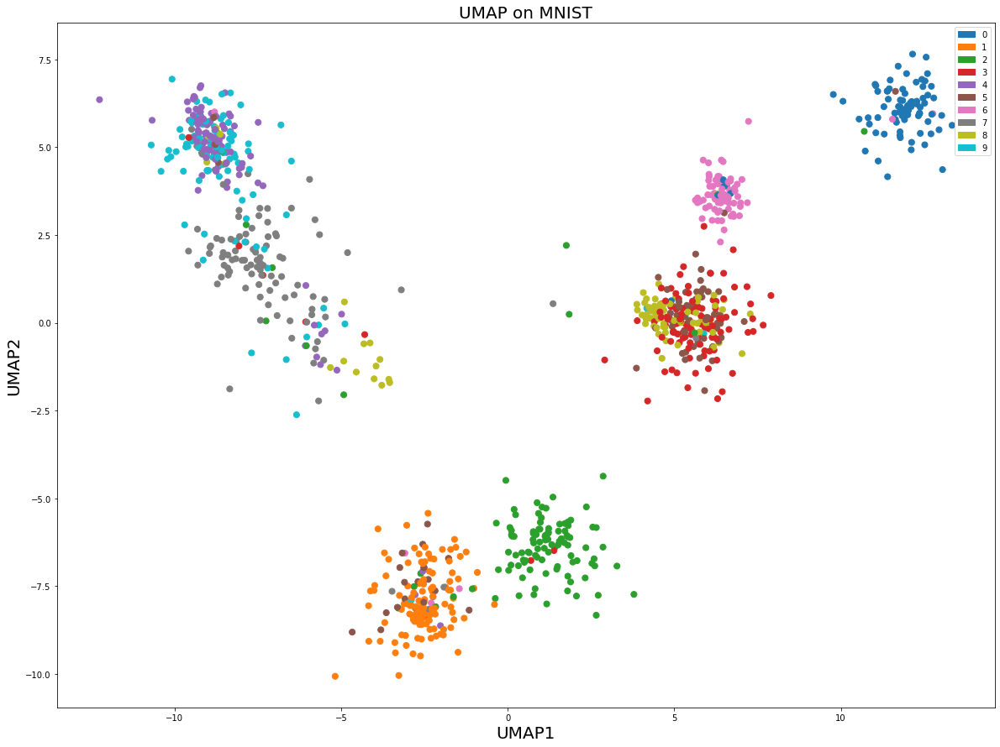


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 45.0032304066957 after 0 iterations
Cross-Entropy = 1.6035953625320716 after 10 iterations
Cross-Entropy = 0.9043864342945013 after 20 iterations
Cross-Entropy = 0.7850911781080038 after 30 iterations
Cross-Entropy = 0.7744674062282275 after 40 iterations
Cross-Entropy = 0.7278077750528053 after 50 iterations
Cross-Entropy = 0.7601400173545028 after 60 iterations
Cross-Entropy = 0.7453150873366448 after 70 iterations
Cross-Entr

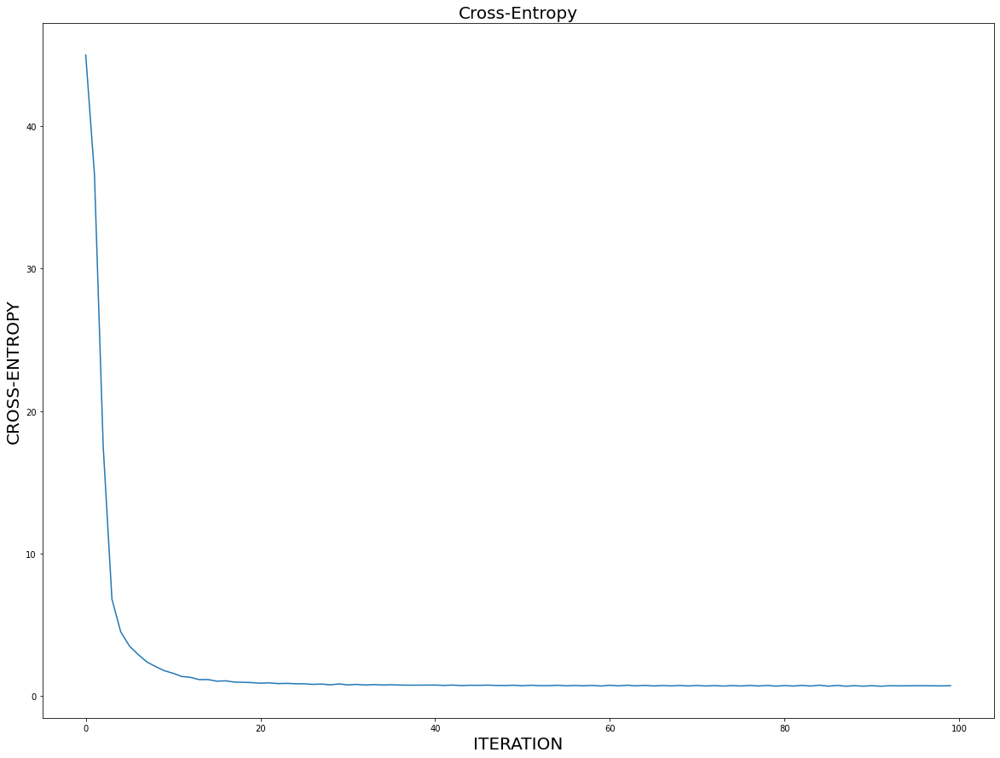

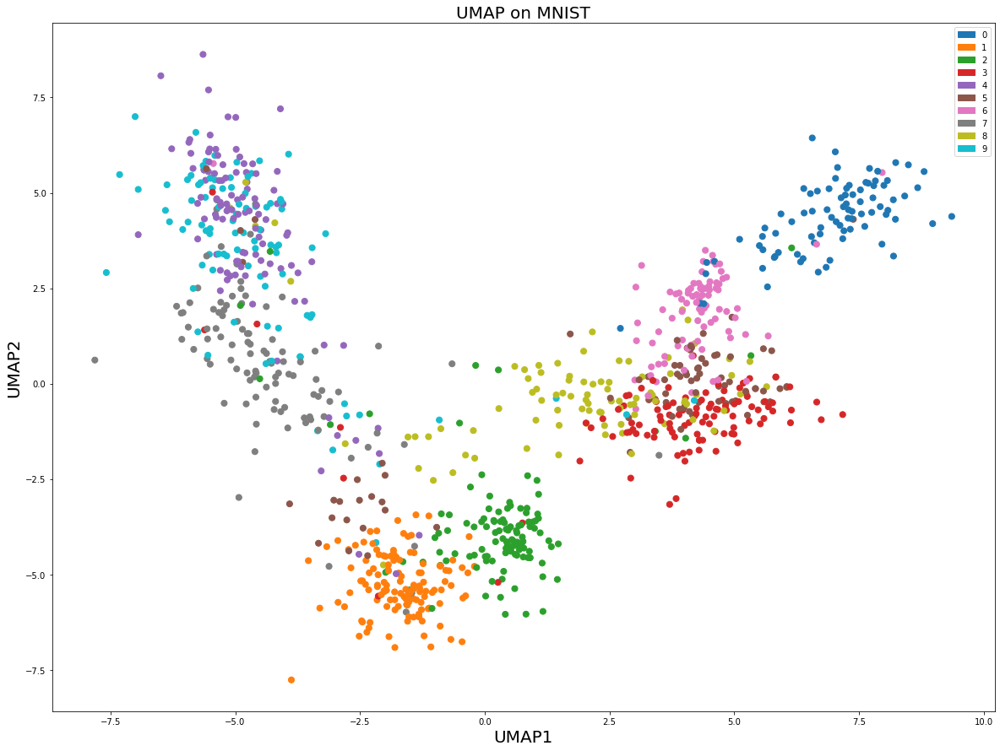


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 174.91031910206104
Running Gradient Descent: 

Cross-Entropy = 45.7461686552703 after 0 iterations
Cross-Entropy = 1.4334230595990949 after 10 iterations
Cross-Entropy = 1.1341758343841282 after 20 iterations
Cross-Entropy = 1.058030435166534 after 30 iterations
Cross-Entropy = 1.0388110997139035 after 40 iterations
Cross-Entropy = 1.0284372930953358 after 50 iterations
Cross-Entropy = 1.016437263508499 after 60 iterations
Cross-Entropy = 1.0131123830917386 after 70 iterations
Cross-Entrop

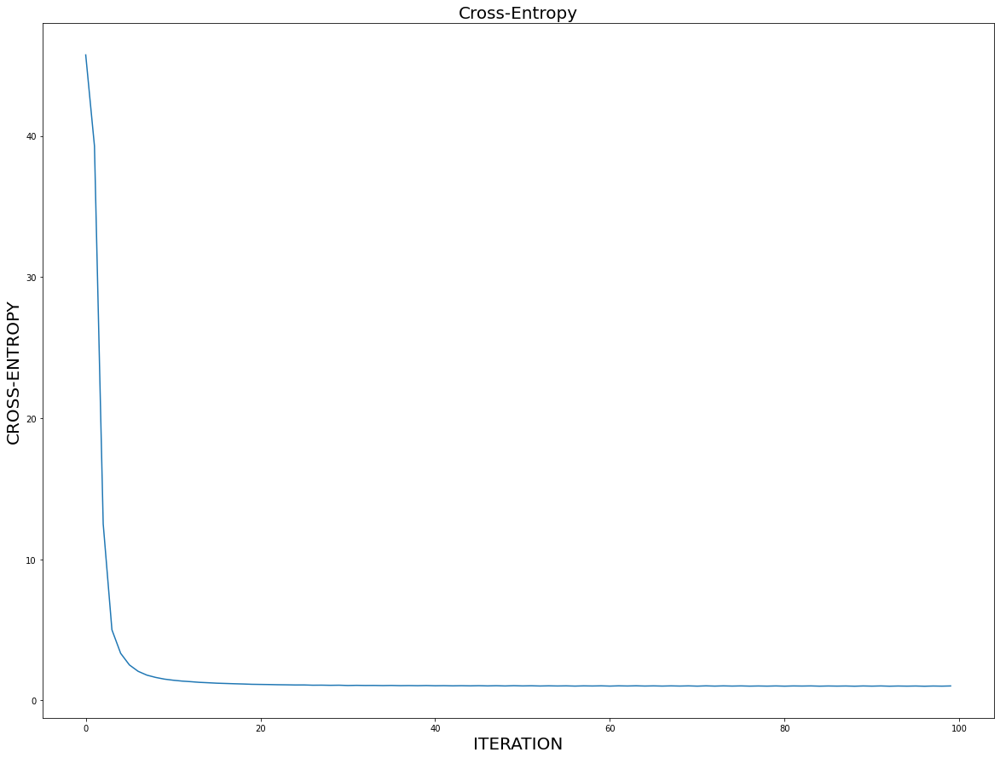

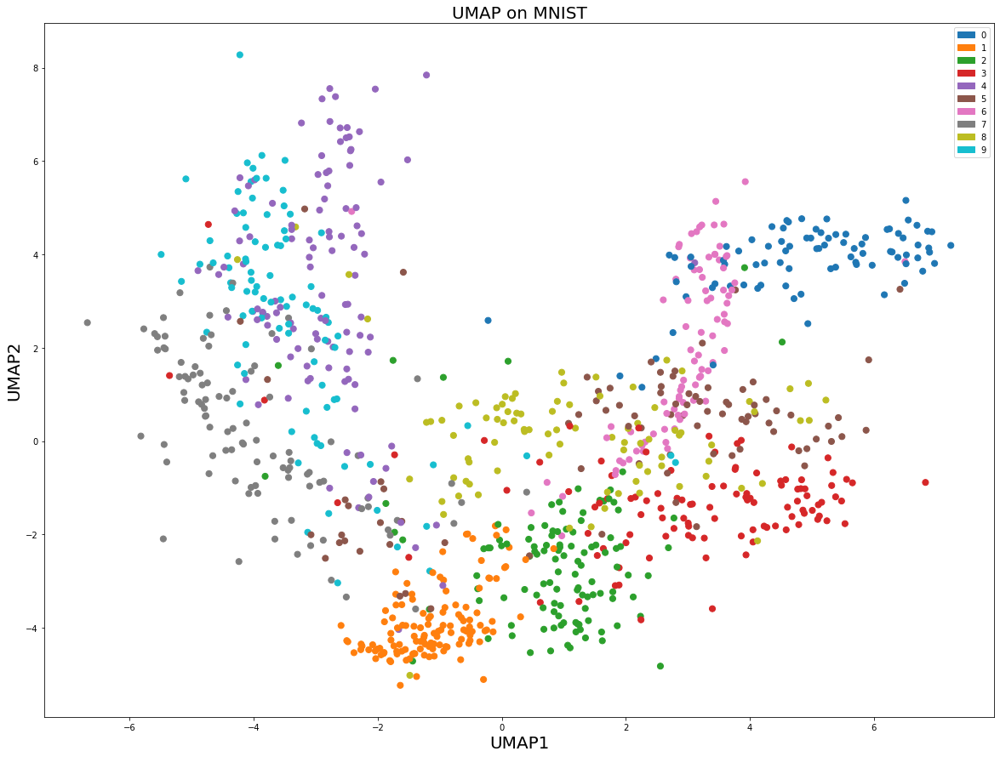


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 27.6784411000496 after 0 iterations
Cross-Entropy = 4.722952333388062 after 10 iterations
Cross-Entropy = 1.9519520032043216 after 20 iterations
Cross-Entropy = 1.1069758779900376 after 30 iterations
Cross-Entropy = 0.8433854884481391 after 40 iterations
Cross-Entropy = 0.7703048048899191 after 50 iterations
Cross-Entropy = 0.753224026636995 after 60 iterations
Cross-Entropy = 0.7249927145548587 after 70 iterations
Cross-Entropy

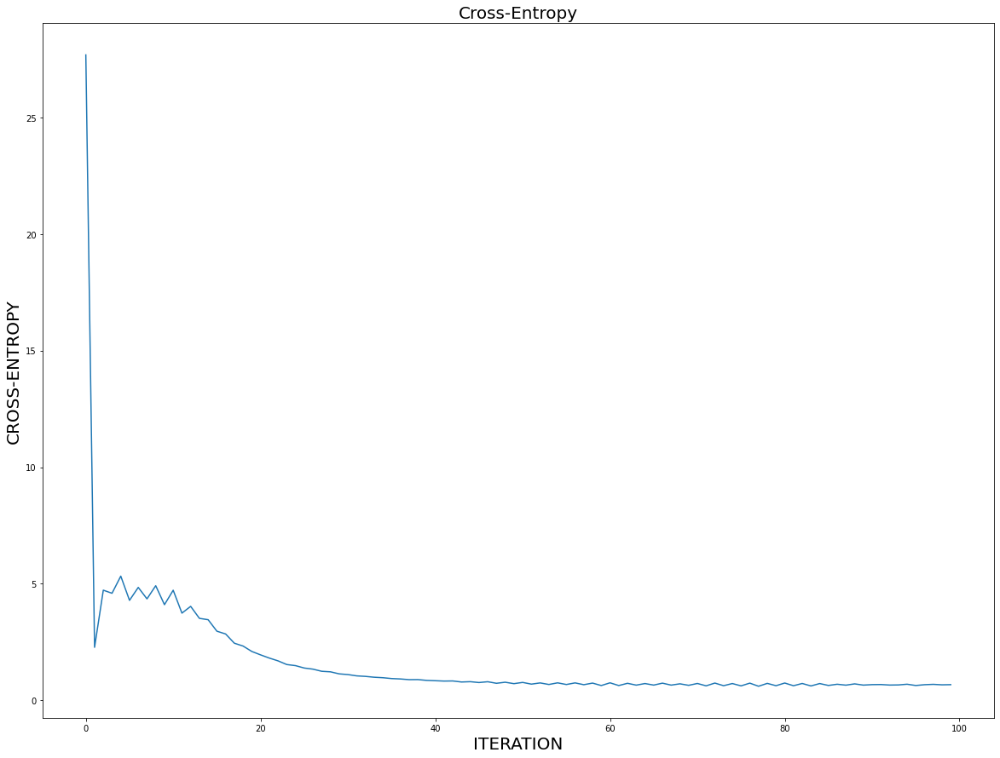

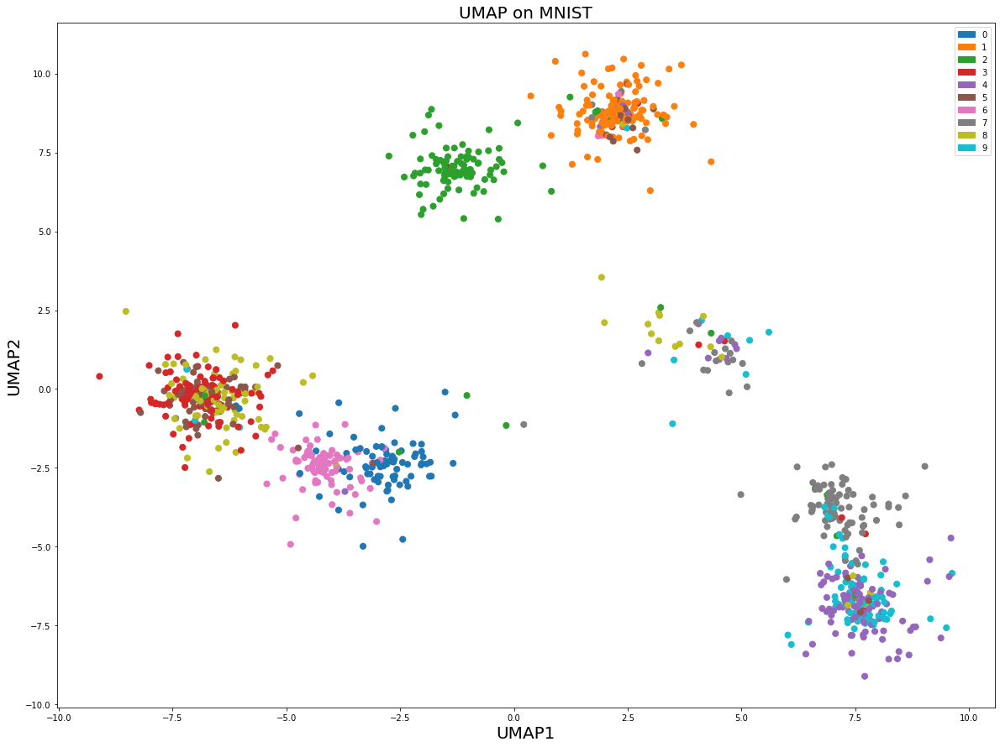


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 32.38042656983617 after 0 iterations
Cross-Entropy = 5.674093821639042 after 10 iterations
Cross-Entropy = 2.22718120665843 after 20 iterations
Cross-Entropy = 1.2091299330197585 after 30 iterations
Cross-Entropy = 0.9049267202825326 after 40 iterations
Cross-Entropy = 0.8002359991636928 after 50 iterations
Cross-Entropy = 0.7863607046177779 after 60 iterations
Cross-Entropy = 0.760567986371243 after 70 iterations
Cross-Entropy 

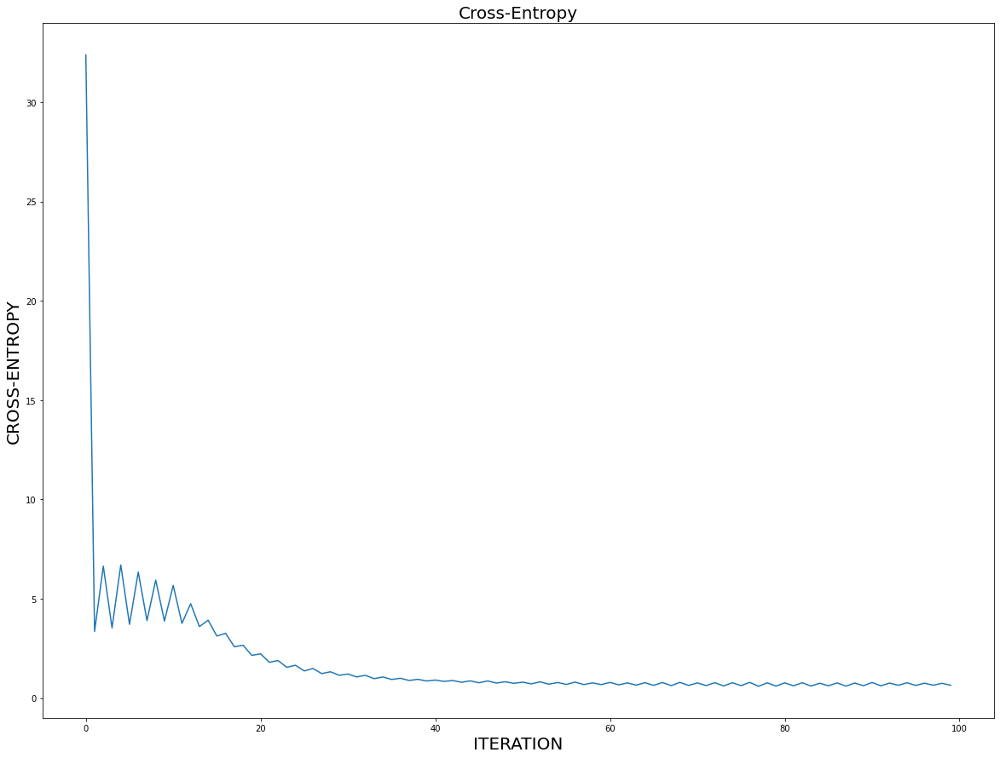

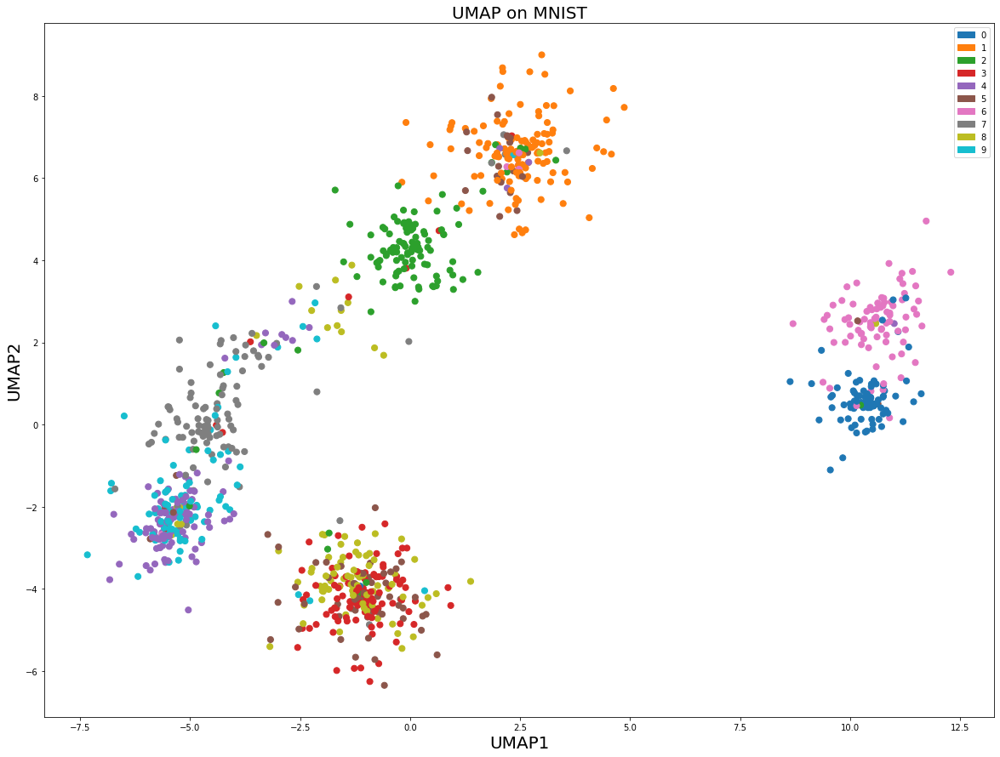


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 36.53197180826692 after 0 iterations
Cross-Entropy = 3.7470094738917465 after 10 iterations
Cross-Entropy = 1.6046841946088055 after 20 iterations
Cross-Entropy = 1.050944837499261 after 30 iterations
Cross-Entropy = 0.8423826039080635 after 40 iterations
Cross-Entropy = 0.7216024801057899 after 50 iterations
Cross-Entropy = 0.622645796833174 after 60 iterations
Cross-Entropy = 0.5863827851046151 after 70 iterations
Cross-Entrop

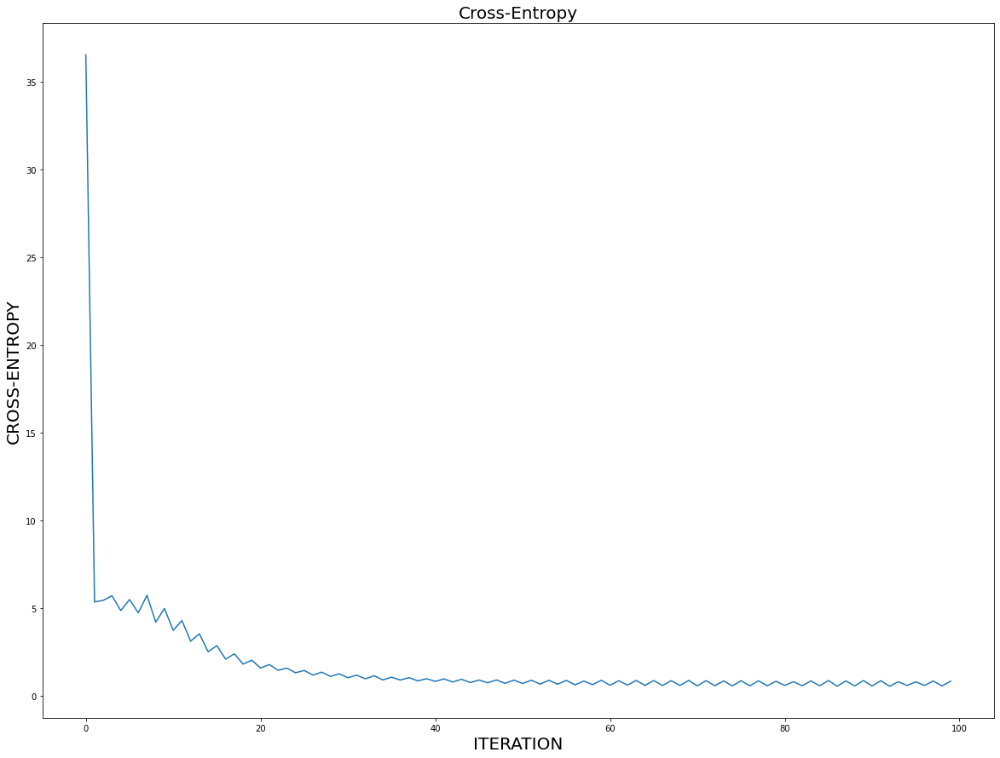

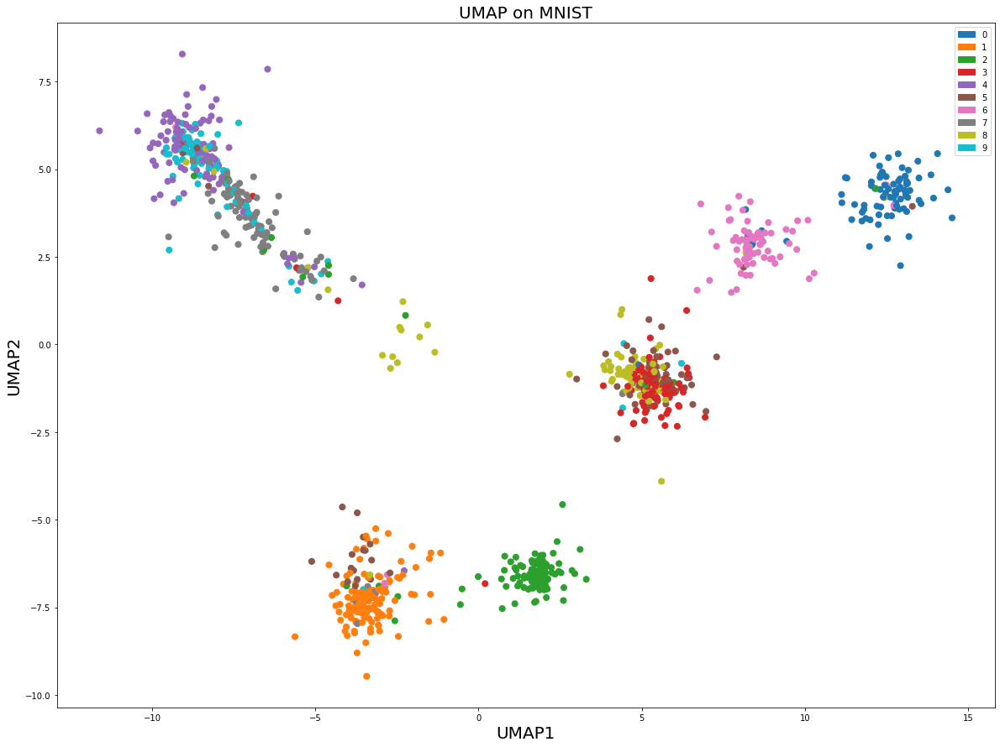


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 29.486524136774964 after 0 iterations
Cross-Entropy = 5.503593400003695 after 10 iterations
Cross-Entropy = 2.191224111211403 after 20 iterations
Cross-Entropy = 1.2611871455968895 after 30 iterations
Cross-Entropy = 0.9697740813398669 after 40 iterations
Cross-Entropy = 0.8548166324711336 after 50 iterations
Cross-Entropy = 0.809381892157858 after 60 iterations
Cross-Entropy = 0.7845027307885787 after 70 iterations
Cross-Entrop

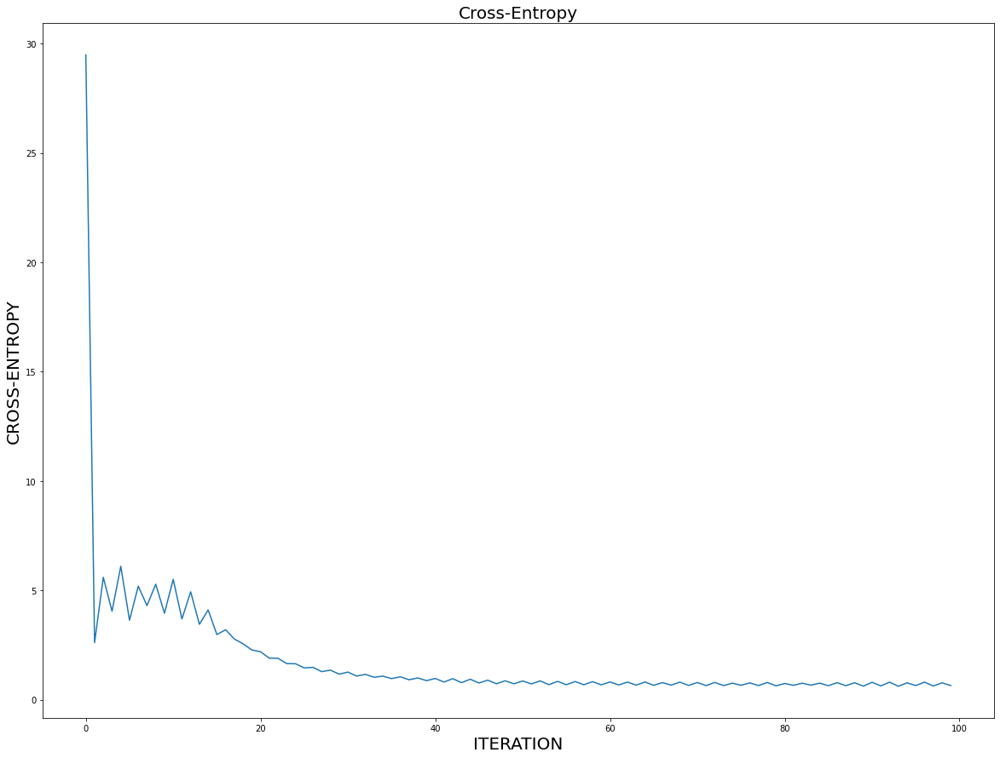

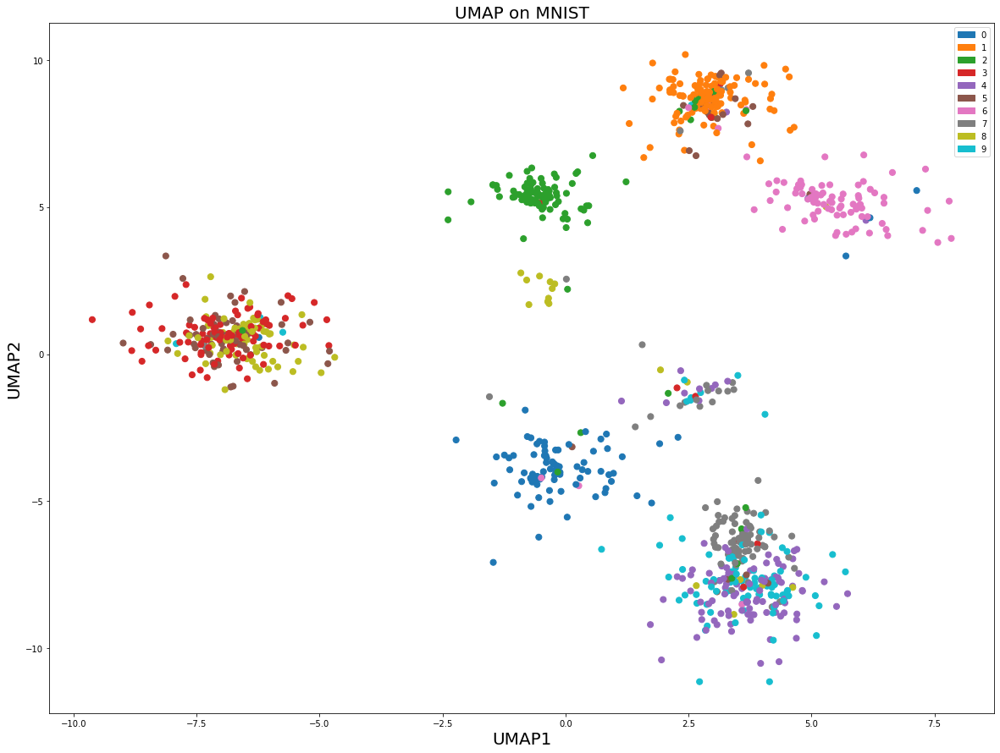


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 41.098202921219425 after 0 iterations
Cross-Entropy = 3.0479703818145474 after 10 iterations
Cross-Entropy = 1.3818496932525621 after 20 iterations
Cross-Entropy = 0.9751169784496946 after 30 iterations
Cross-Entropy = 0.845634916920831 after 40 iterations
Cross-Entropy = 0.8031104234719563 after 50 iterations
Cross-Entropy = 0.8135465161159309 after 60 iterations
Cross-Entropy = 0.8256200545877284 after 70 iterations
Cross-Entr

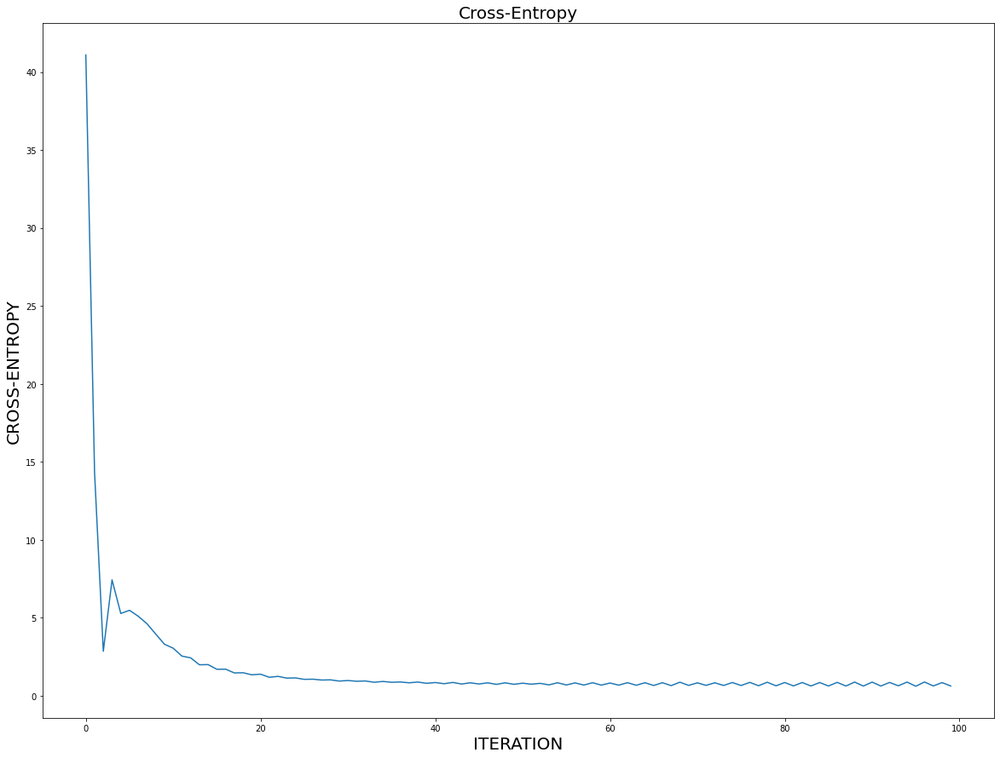

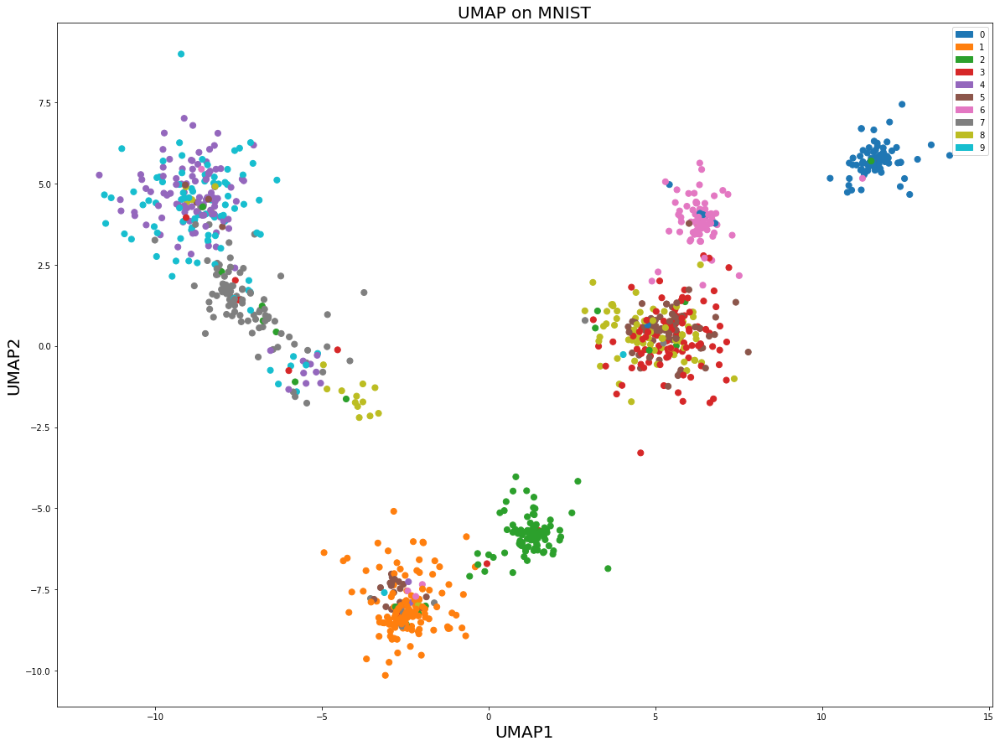


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 45.07421420707154 after 0 iterations
Cross-Entropy = 1.5866941443876694 after 10 iterations
Cross-Entropy = 0.9463001981194478 after 20 iterations
Cross-Entropy = 0.8366328090399914 after 30 iterations
Cross-Entropy = 0.7904186803227156 after 40 iterations
Cross-Entropy = 0.7799138834189082 after 50 iterations
Cross-Entropy = 0.7407293812653668 after 60 iterations
Cross-Entropy = 0.7241532934584416 after 70 iterations
Cross-Entr

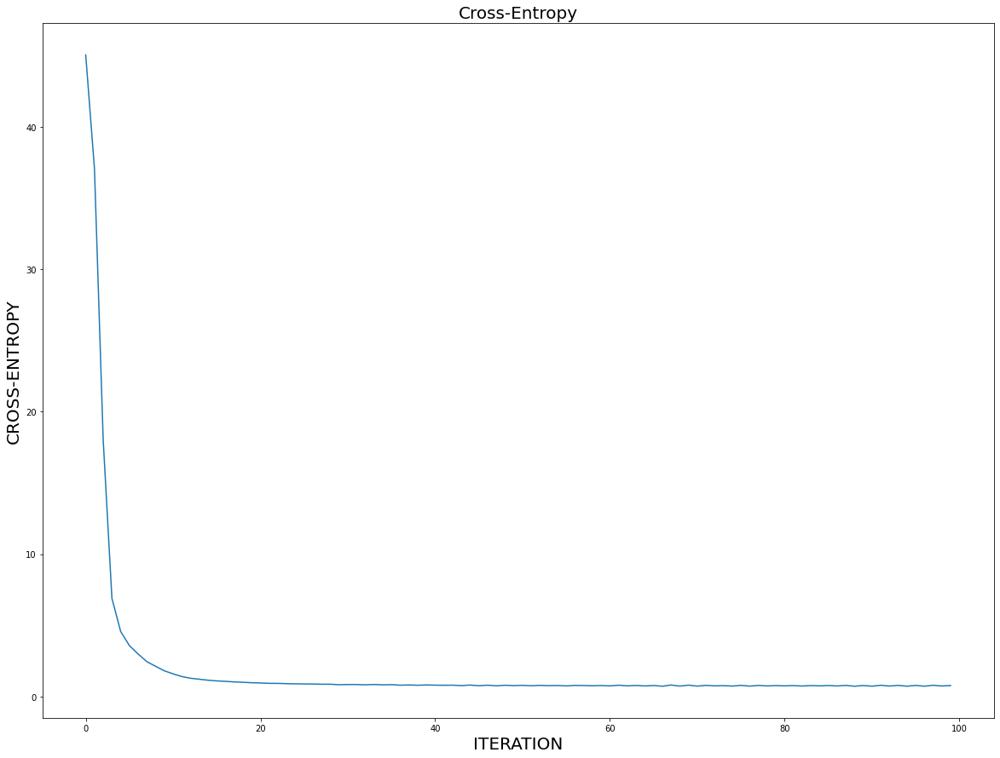

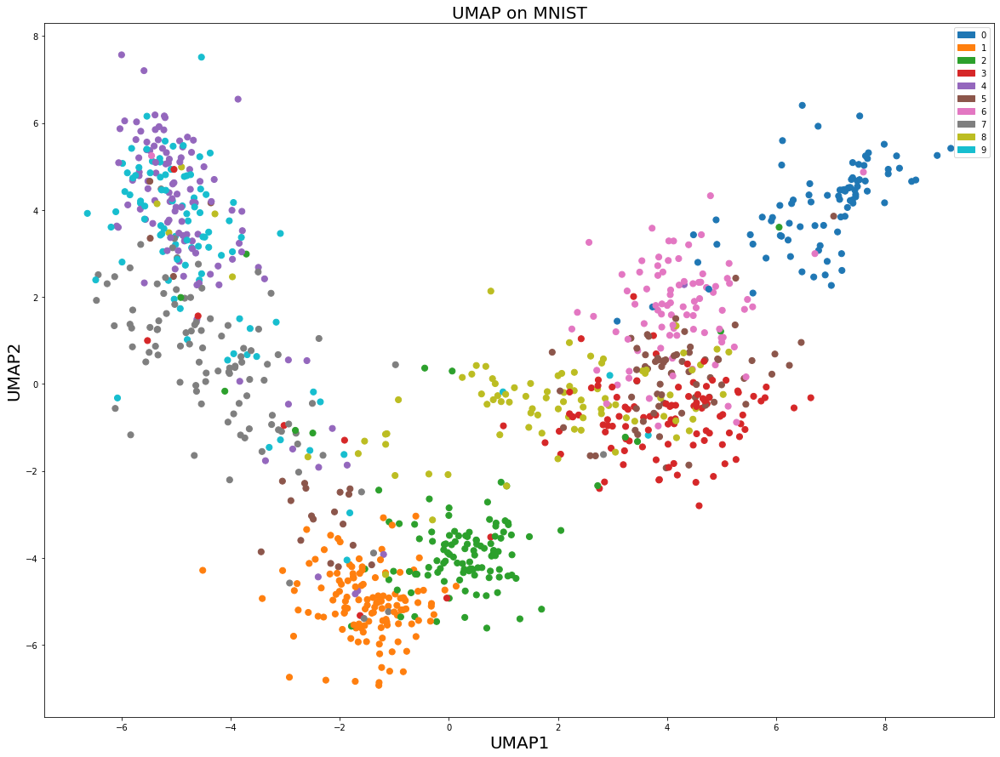


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 179.8473564354149
Running Gradient Descent: 

Cross-Entropy = 45.74763598658659 after 0 iterations
Cross-Entropy = 1.4976066110086126 after 10 iterations
Cross-Entropy = 1.20473814569011 after 20 iterations
Cross-Entropy = 1.1371603721899013 after 30 iterations
Cross-Entropy = 1.1093724400825828 after 40 iterations
Cross-Entropy = 1.096510519053268 after 50 iterations
Cross-Entropy = 1.0998857733049576 after 60 iterations
Cross-Entropy = 1.0903272820572247 after 70 iterations
Cross-Entropy

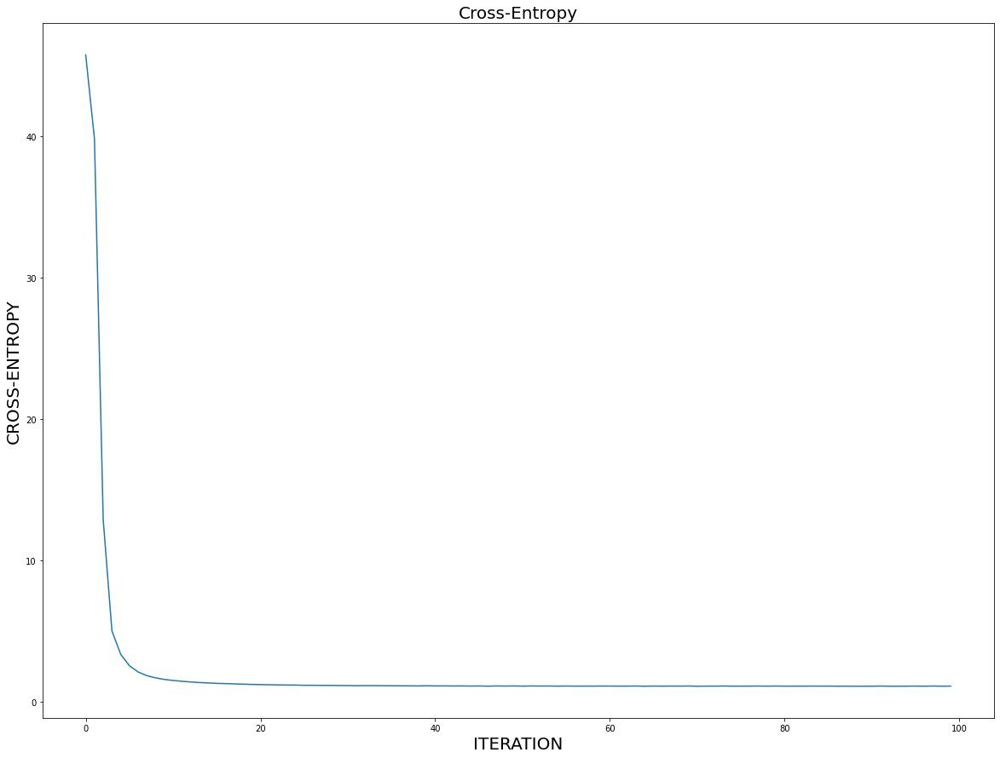

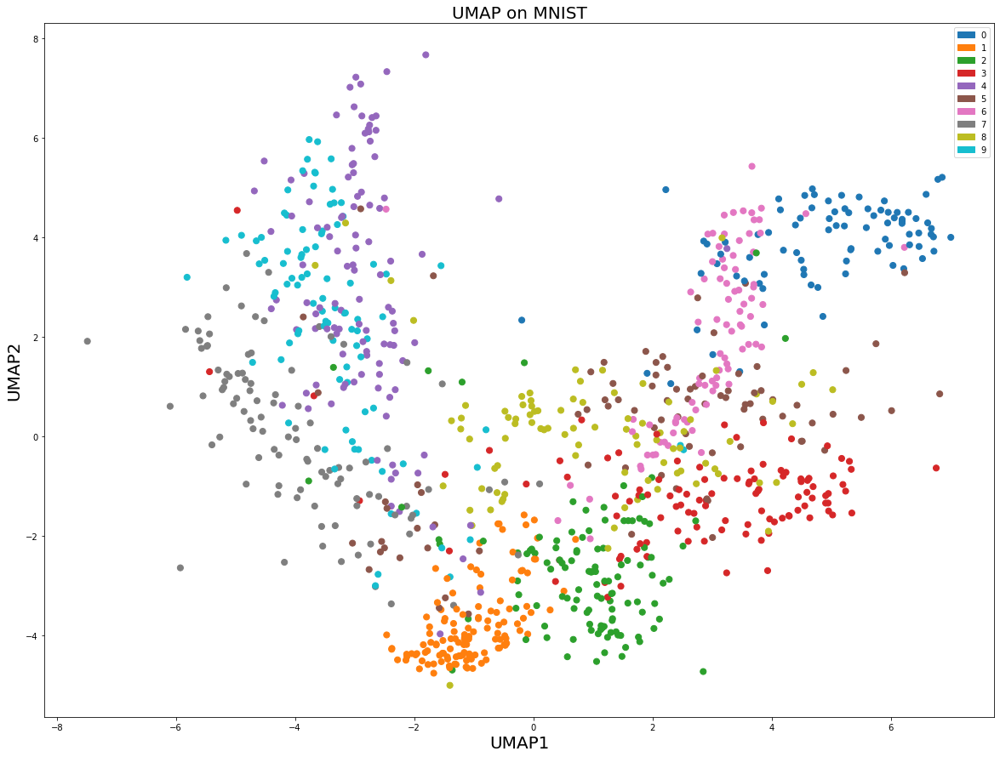


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 27.063311374460827 after 0 iterations
Cross-Entropy = 4.000638796532481 after 10 iterations
Cross-Entropy = 2.101962190502375 after 20 iterations
Cross-Entropy = 1.2321898083811682 after 30 iterations
Cross-Entropy = 0.9793003393061182 after 40 iterations
Cross-Entropy = 0.8258254687213595 after 50 iterations
Cross-Entropy = 0.7105534328422352 after 60 iterations
Cross-Entropy = 0.7154403543709057 after 70 iterations
Cross-Entr

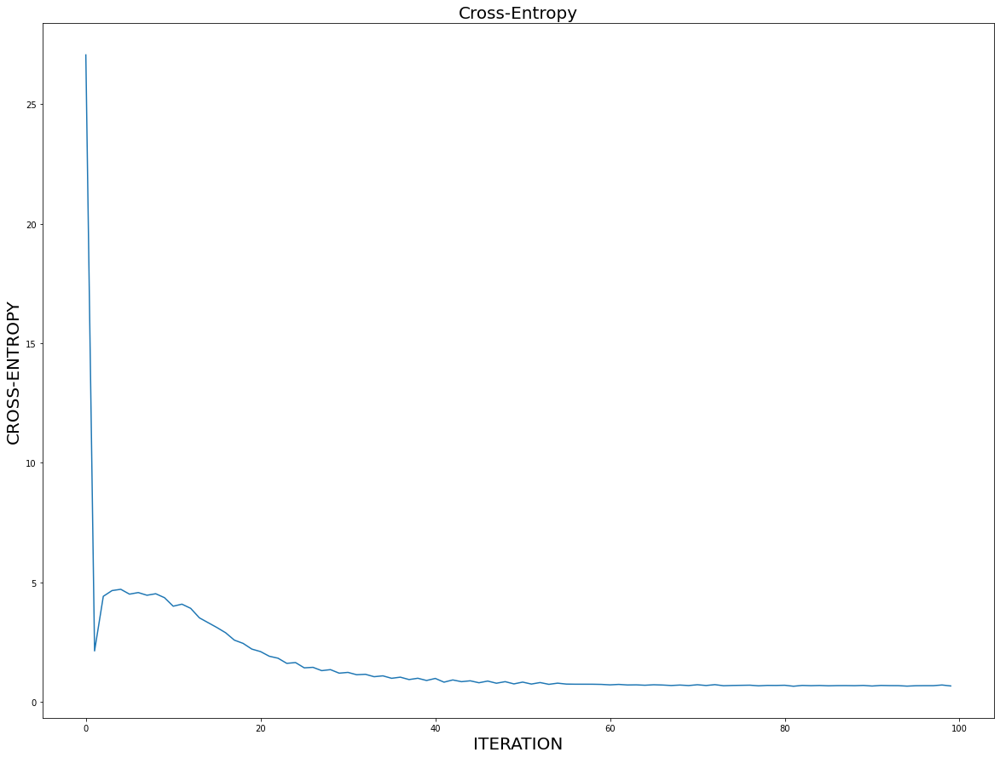

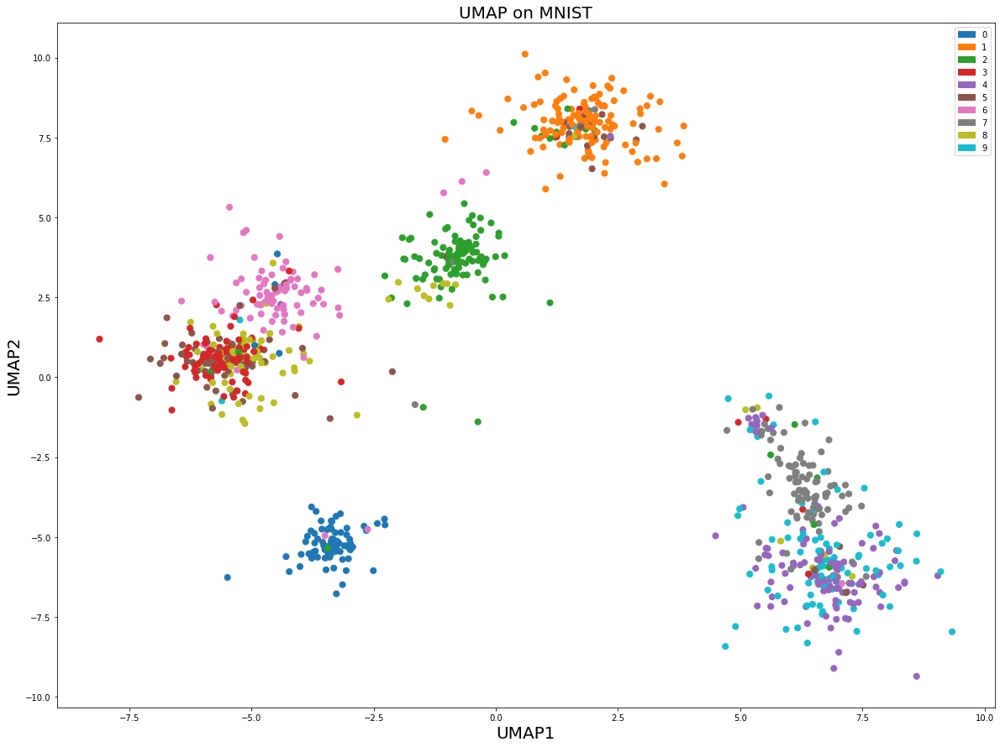


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 31.877912680036903 after 0 iterations
Cross-Entropy = 5.514338924699109 after 10 iterations
Cross-Entropy = 2.521700208019305 after 20 iterations
Cross-Entropy = 1.274365510243807 after 30 iterations
Cross-Entropy = 0.920525094505633 after 40 iterations
Cross-Entropy = 0.8212530908157062 after 50 iterations
Cross-Entropy = 0.764616827290081 after 60 iterations
Cross-Entropy = 0.709896971201138 after 70 iterations
Cross-Entropy 

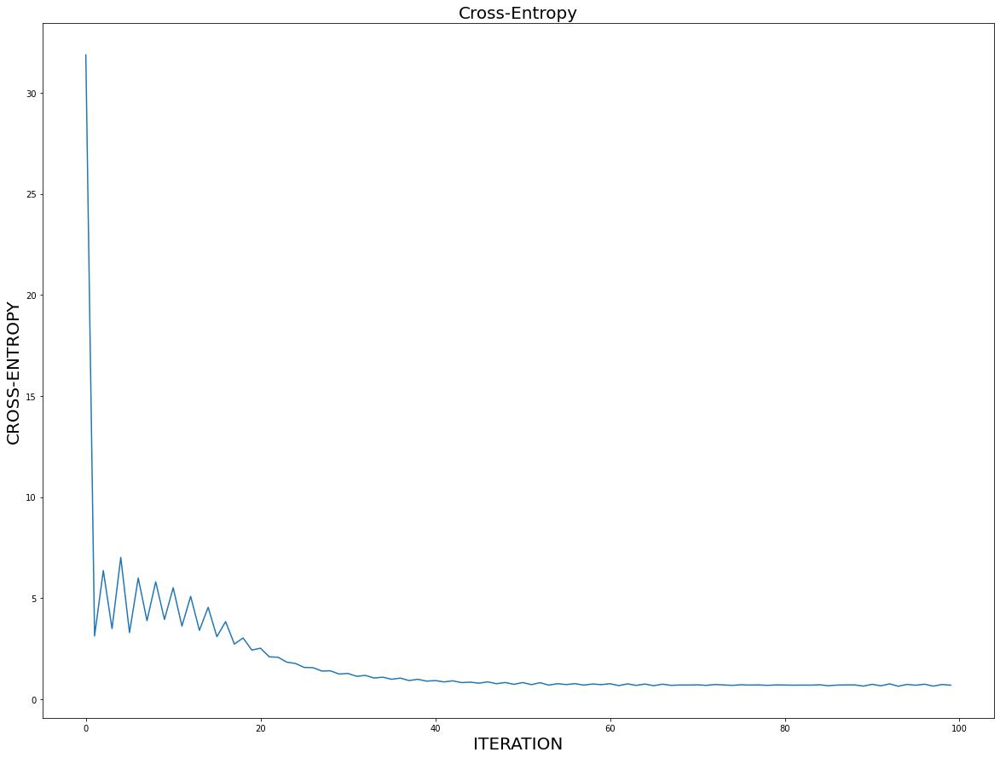

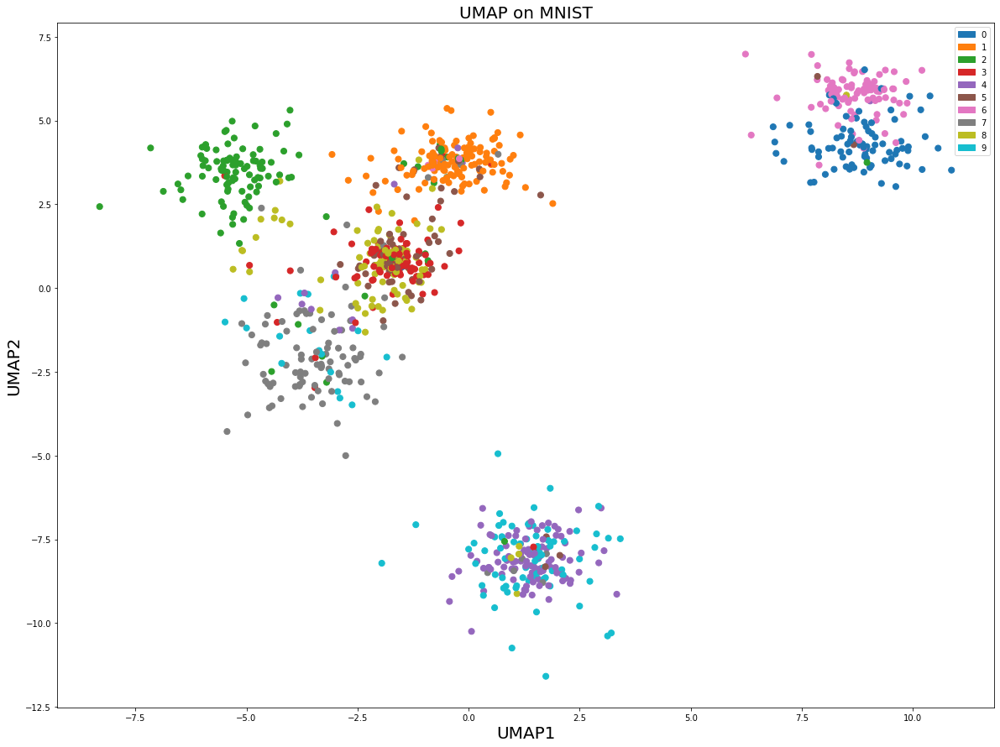


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 36.24737327683378 after 0 iterations
Cross-Entropy = 4.269111419049509 after 10 iterations
Cross-Entropy = 1.6587446809371715 after 20 iterations
Cross-Entropy = 1.0816046280081144 after 30 iterations
Cross-Entropy = 0.8818797104943318 after 40 iterations
Cross-Entropy = 0.7963238148177243 after 50 iterations
Cross-Entropy = 0.735188152946963 after 60 iterations
Cross-Entropy = 0.7366249419660332 after 70 iterations
Cross-Entro

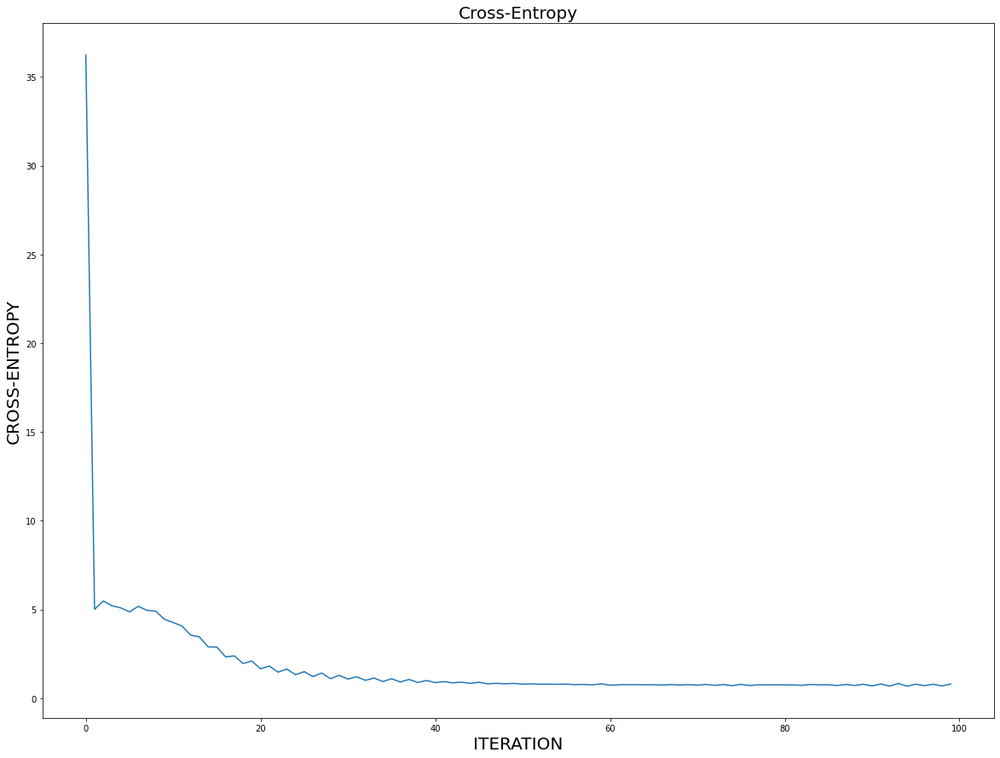

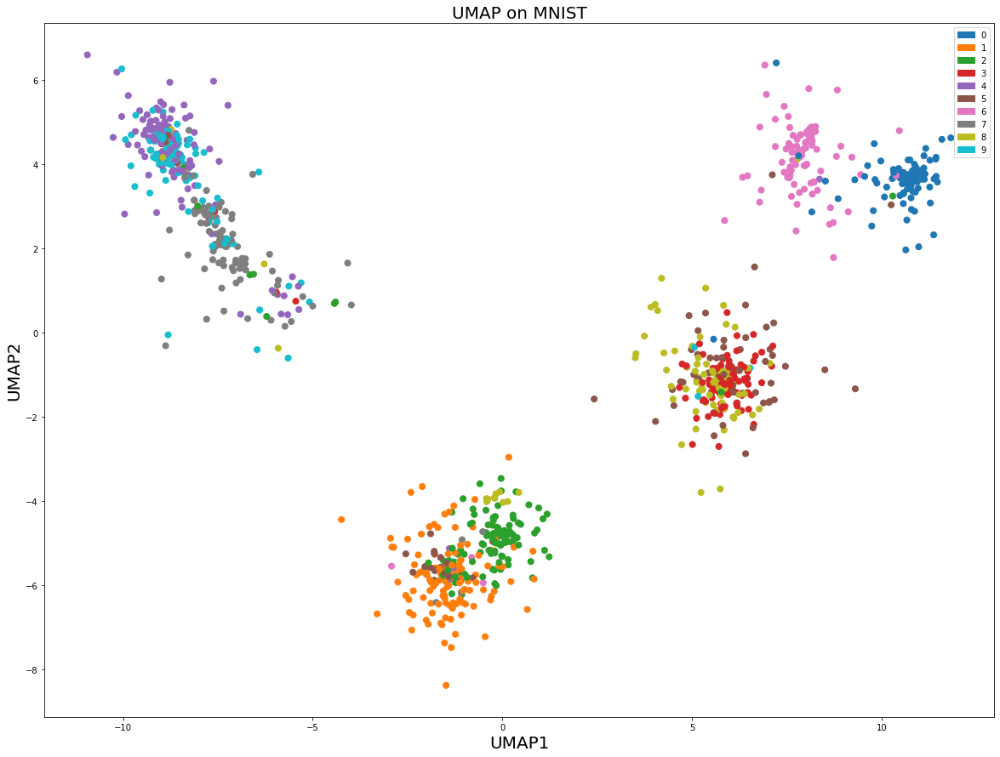


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 28.90103104801278 after 0 iterations
Cross-Entropy = 4.618030899252405 after 10 iterations
Cross-Entropy = 2.15755012718596 after 20 iterations
Cross-Entropy = 1.241300472523262 after 30 iterations
Cross-Entropy = 0.9232036210047047 after 40 iterations
Cross-Entropy = 0.7856622036039734 after 50 iterations
Cross-Entropy = 0.7076585422529136 after 60 iterations
Cross-Entropy = 0.7330461211123548 after 70 iterations
Cross-Entropy

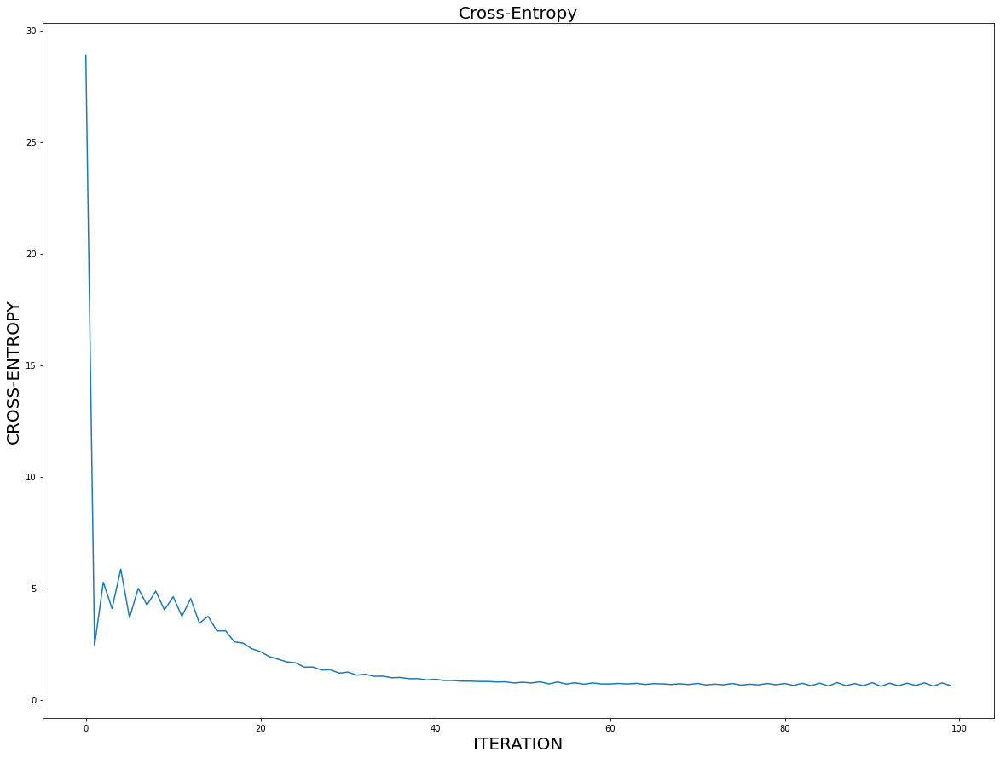

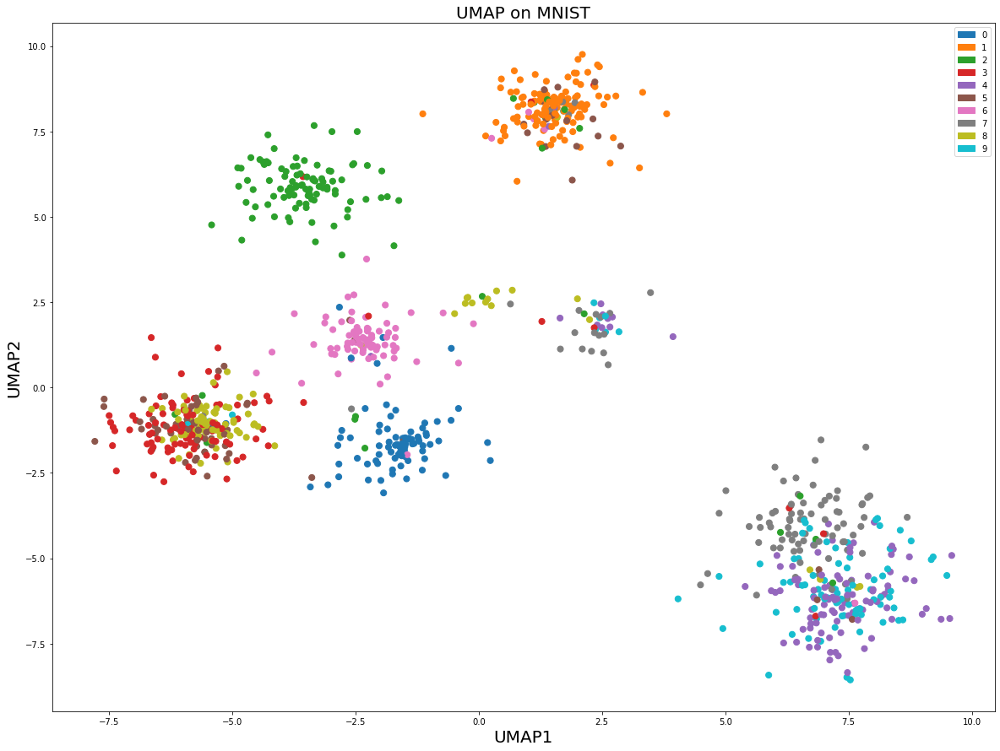


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 41.23424534990477 after 0 iterations
Cross-Entropy = 3.156046613088741 after 10 iterations
Cross-Entropy = 1.4455478600421905 after 20 iterations
Cross-Entropy = 1.106930156086575 after 30 iterations
Cross-Entropy = 0.9313857732870542 after 40 iterations
Cross-Entropy = 0.8853723026062694 after 50 iterations
Cross-Entropy = 0.8624064219227984 after 60 iterations
Cross-Entropy = 0.8712571577079168 after 70 iterations
Cross-Entro

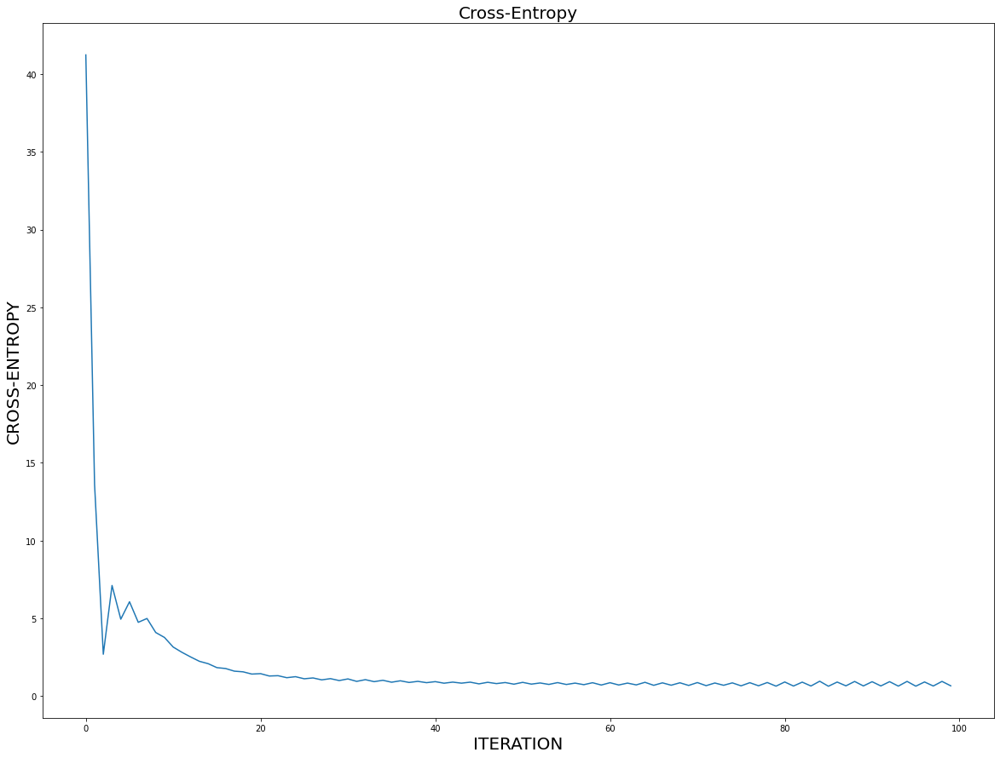

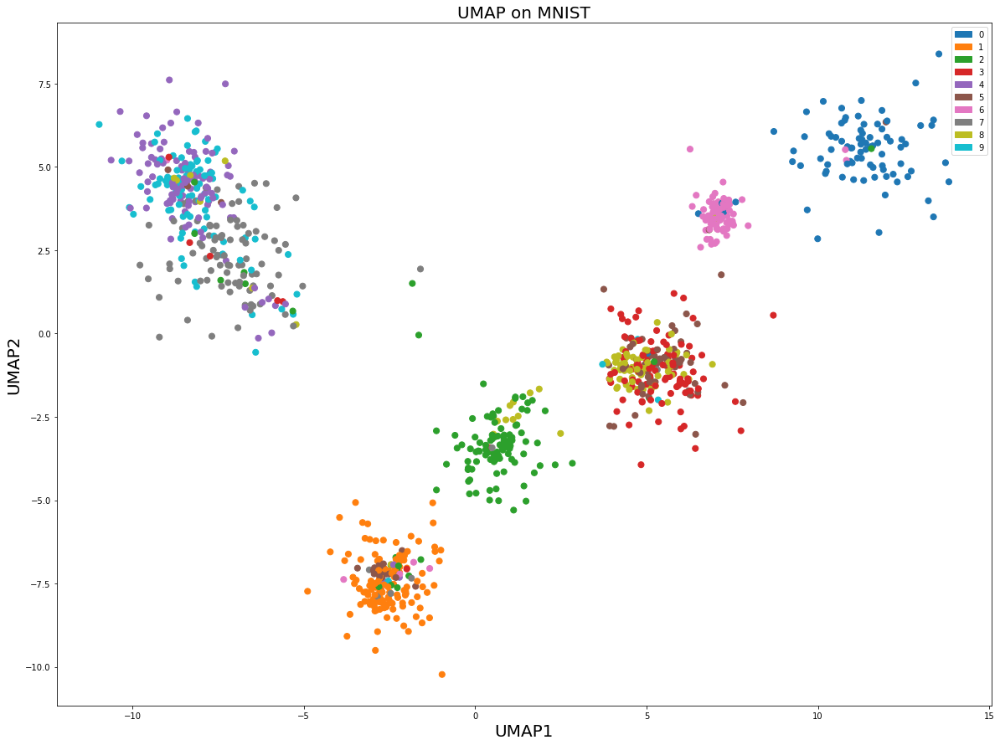


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 45.137922548268364 after 0 iterations
Cross-Entropy = 1.5830452383833236 after 10 iterations
Cross-Entropy = 0.995884440064639 after 20 iterations
Cross-Entropy = 0.8959712768099299 after 30 iterations
Cross-Entropy = 0.8134586265589308 after 40 iterations
Cross-Entropy = 0.7880536151675088 after 50 iterations
Cross-Entropy = 0.781894733700992 after 60 iterations
Cross-Entropy = 0.7745928581493138 after 70 iterations
Cross-Entr

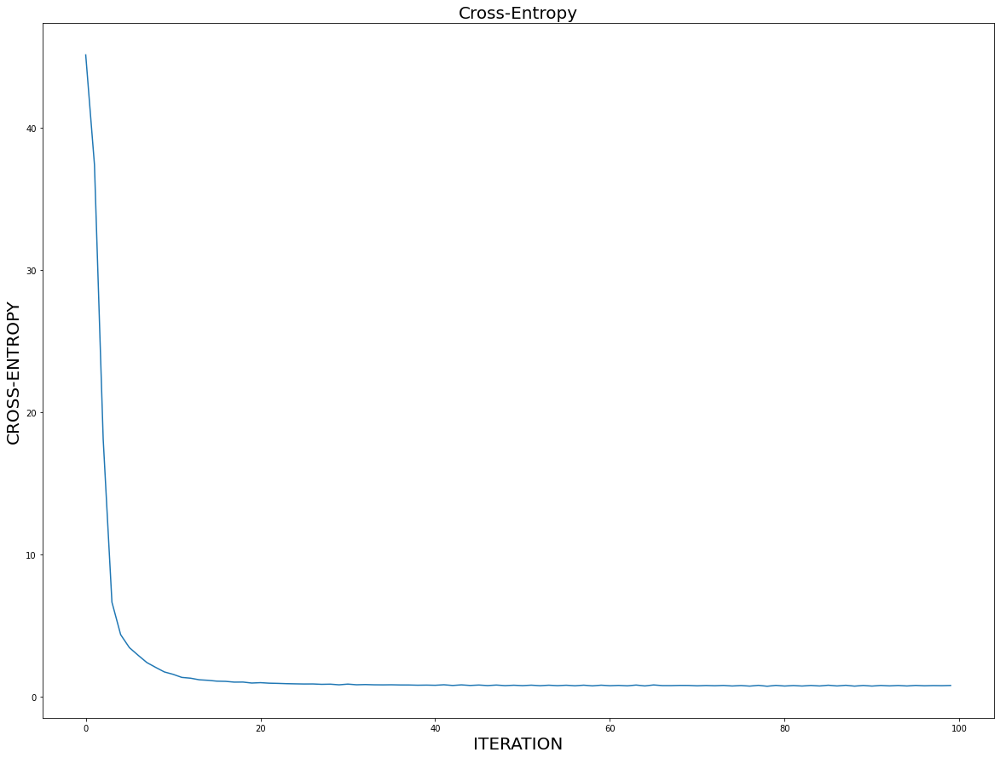

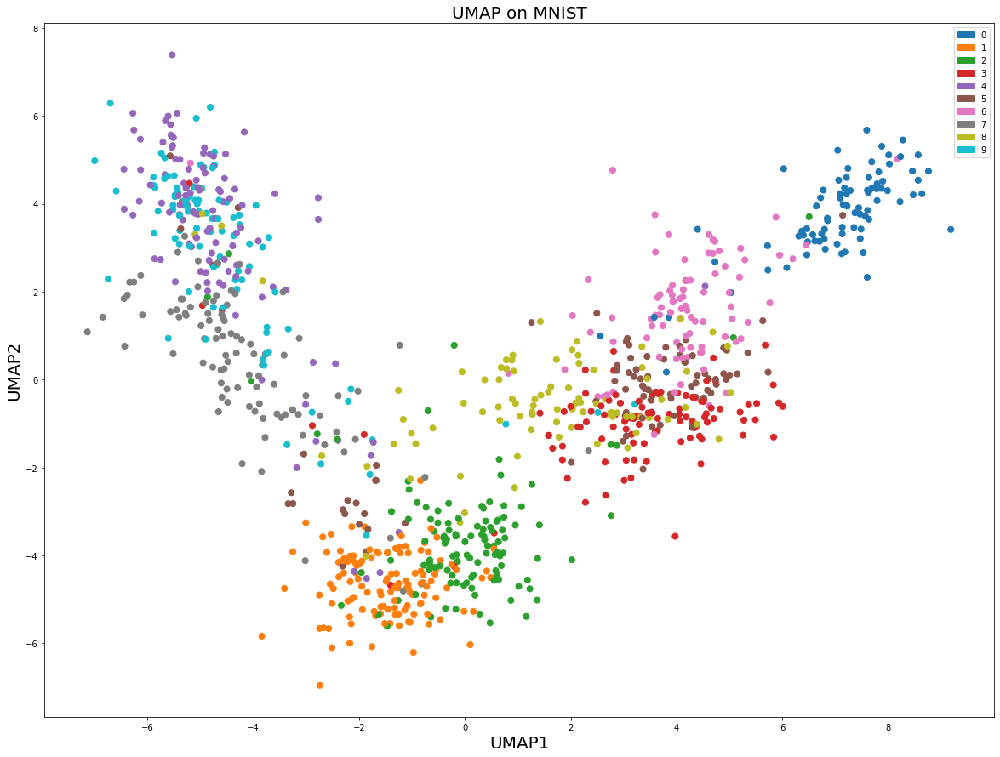


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 184.27838983239832
Running Gradient Descent: 

Cross-Entropy = 45.74923640274584 after 0 iterations
Cross-Entropy = 1.523382063898735 after 10 iterations
Cross-Entropy = 1.2655663481237875 after 20 iterations
Cross-Entropy = 1.2039069542019232 after 30 iterations
Cross-Entropy = 1.1769916521239254 after 40 iterations
Cross-Entropy = 1.170835873615082 after 50 iterations
Cross-Entropy = 1.1690301389312456 after 60 iterations
Cross-Entropy = 1.1604851689810325 after 70 iterations
Cross-Entro

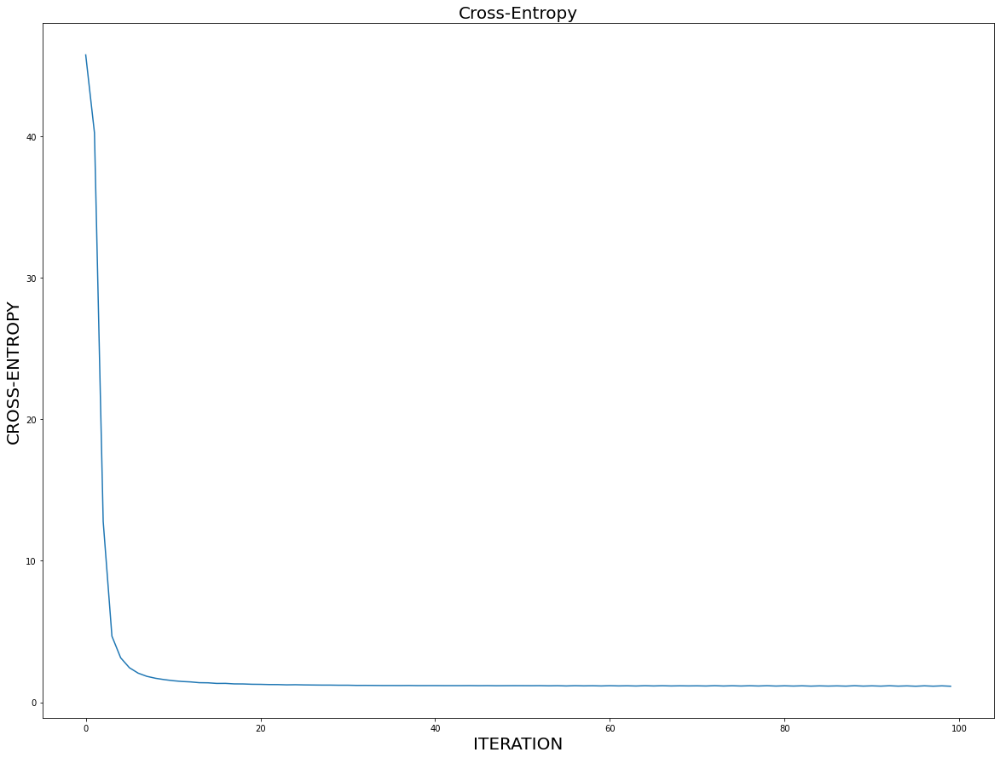

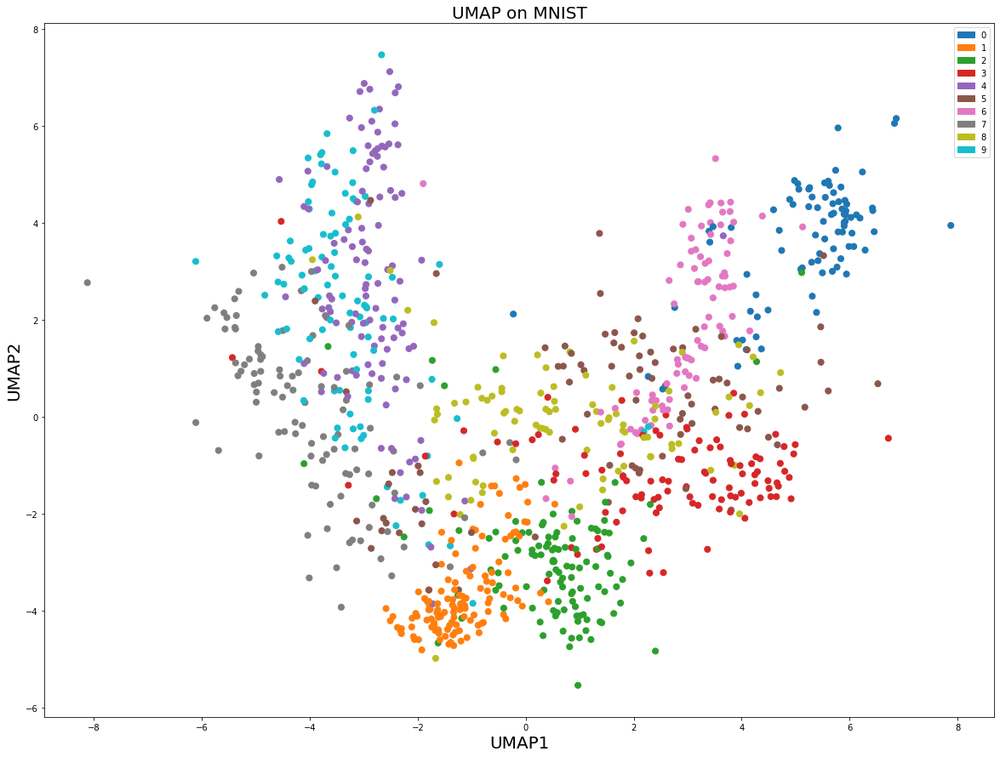


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 27.063864630980138 after 0 iterations
Cross-Entropy = 4.484710711388834 after 10 iterations
Cross-Entropy = 2.2696081129520236 after 20 iterations
Cross-Entropy = 1.2652495248841868 after 30 iterations
Cross-Entropy = 0.933510248420266 after 40 iterations
Cross-Entropy = 0.8483365032766864 after 50 iterations
Cross-Entropy = 0.7851217628174336 after 60 iterations
Cross-Entropy = 0.713928836330228 after 70 iterations
Cross-Entrop

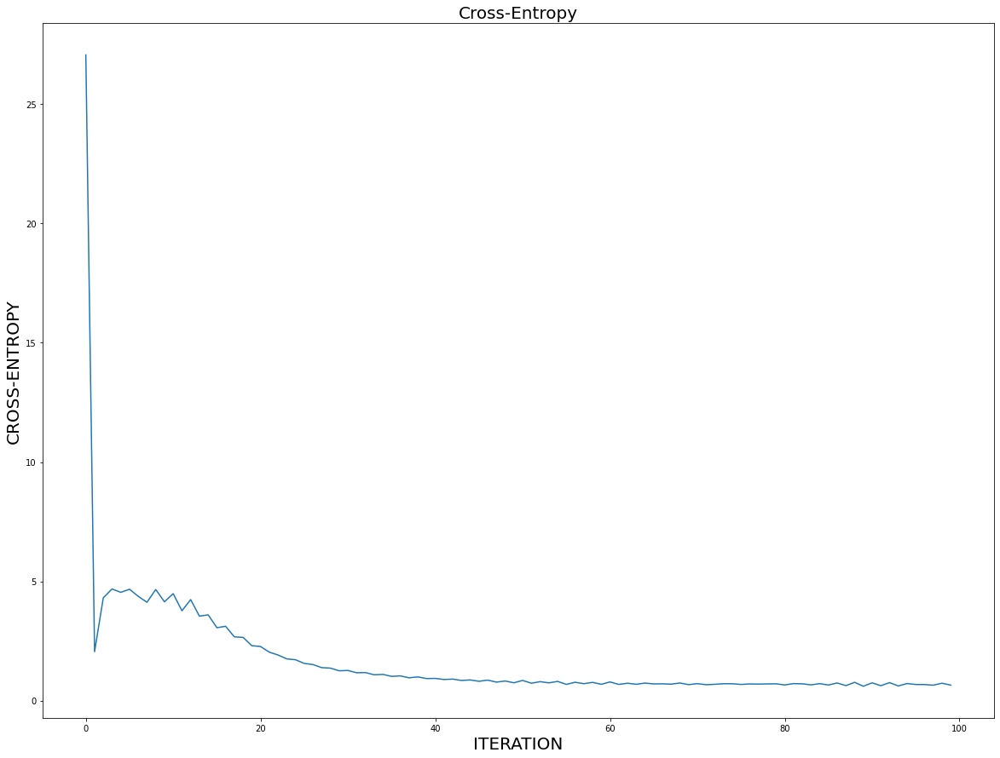

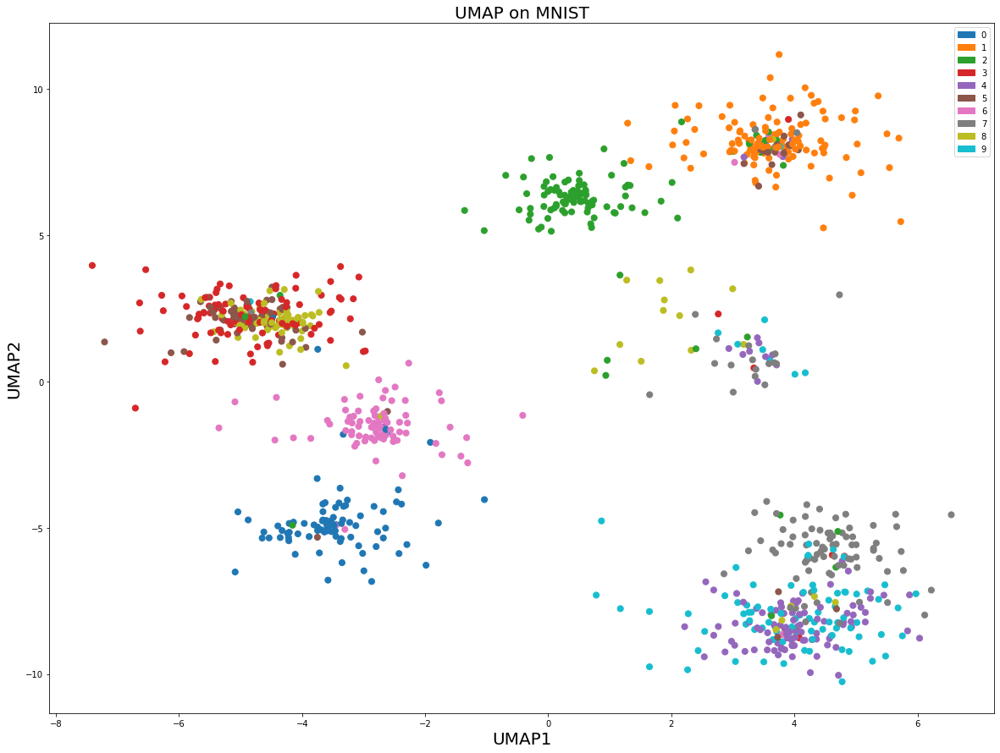


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 31.92036751727358 after 0 iterations
Cross-Entropy = 5.358267716873373 after 10 iterations
Cross-Entropy = 2.60964772731176 after 20 iterations
Cross-Entropy = 1.3739020953379564 after 30 iterations
Cross-Entropy = 1.0544484730715242 after 40 iterations
Cross-Entropy = 0.9275377173436148 after 50 iterations
Cross-Entropy = 0.8987814528230123 after 60 iterations
Cross-Entropy = 0.8468423560221371 after 70 iterations
Cross-Entropy

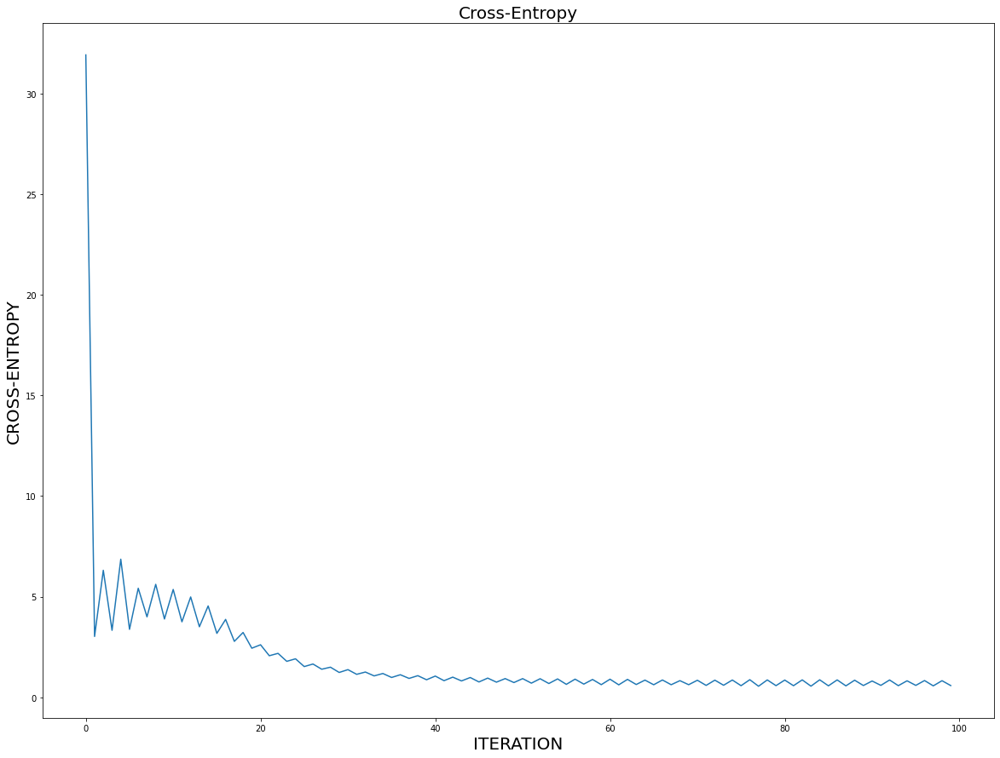

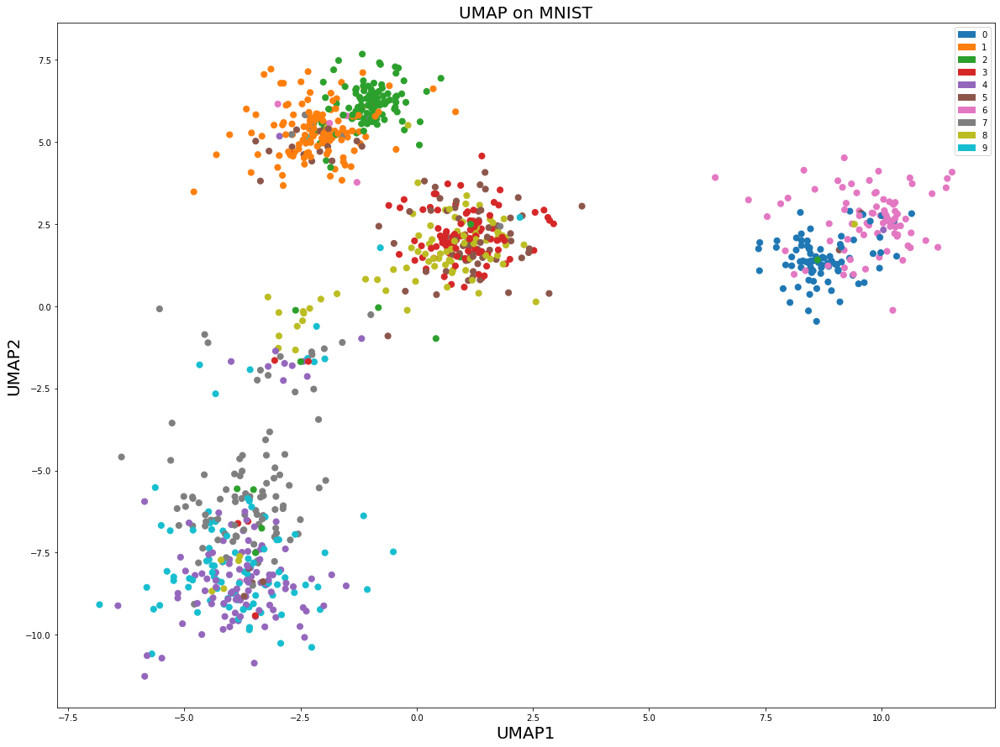


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 36.36531428233382 after 0 iterations
Cross-Entropy = 4.635535622713627 after 10 iterations
Cross-Entropy = 1.8553667334005377 after 20 iterations
Cross-Entropy = 1.1131089933208256 after 30 iterations
Cross-Entropy = 0.8704985568454052 after 40 iterations
Cross-Entropy = 0.7447973336178172 after 50 iterations
Cross-Entropy = 0.6571365445997187 after 60 iterations
Cross-Entropy = 0.646053189000932 after 70 iterations
Cross-Entrop

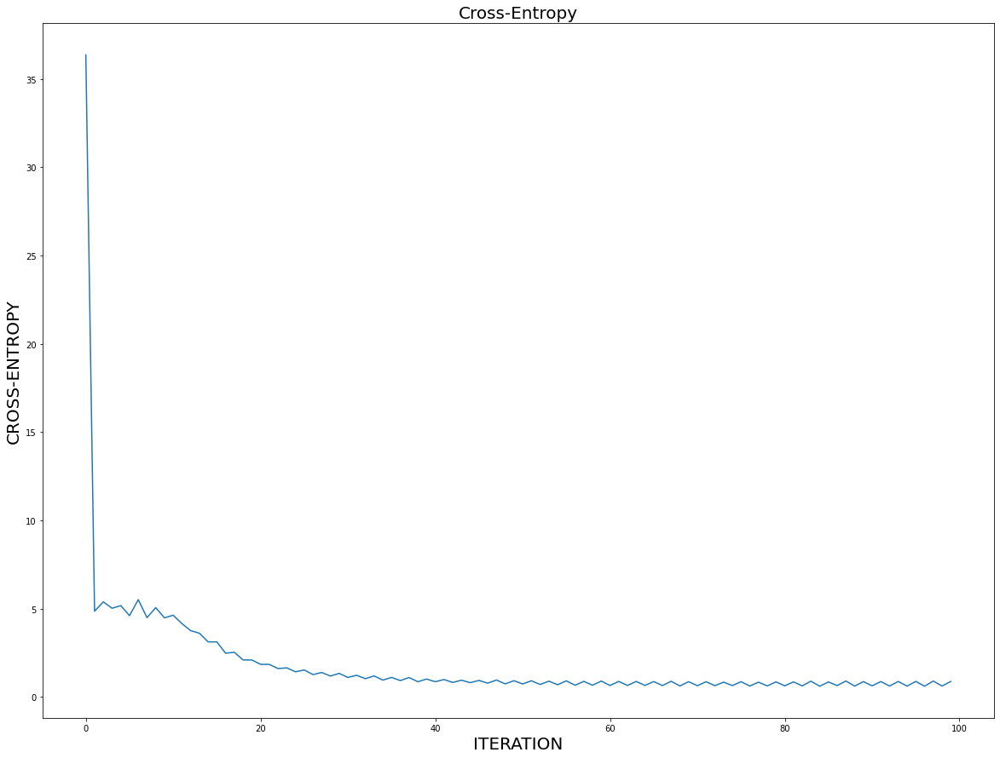

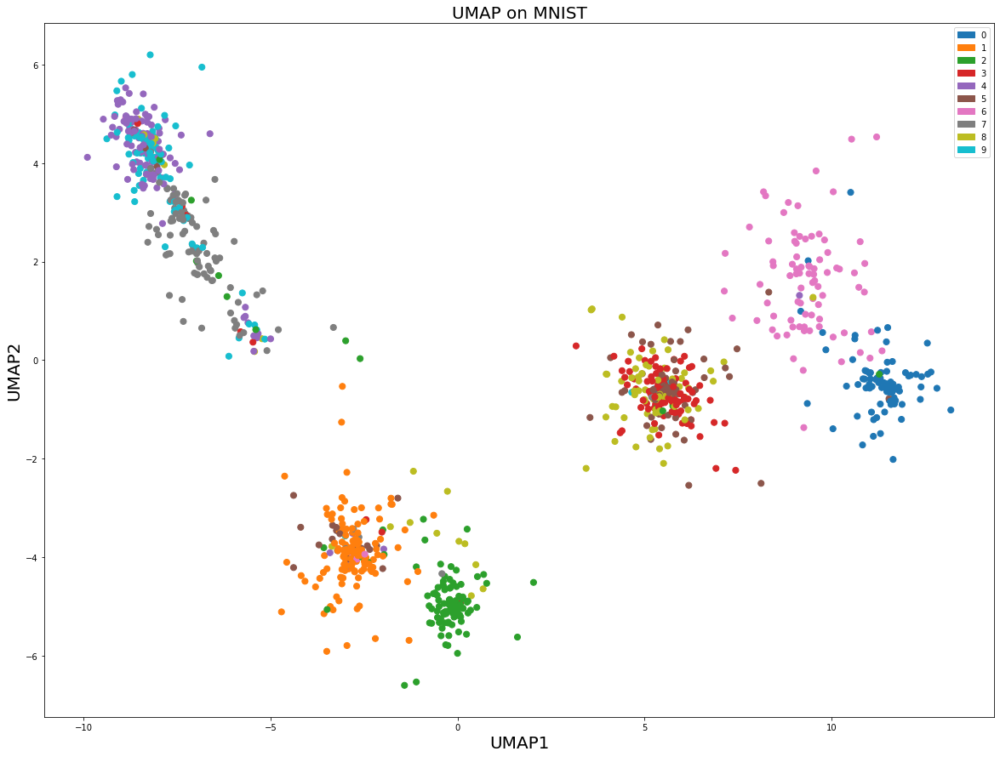


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 28.914102892595903 after 0 iterations
Cross-Entropy = 5.276936823015749 after 10 iterations
Cross-Entropy = 2.3275863853296808 after 20 iterations
Cross-Entropy = 1.381051037660458 after 30 iterations
Cross-Entropy = 0.9975246289121497 after 40 iterations
Cross-Entropy = 0.9321749281961341 after 50 iterations
Cross-Entropy = 0.8317740839781451 after 60 iterations
Cross-Entropy = 0.7809685140295922 after 70 iterations
Cross-Entro

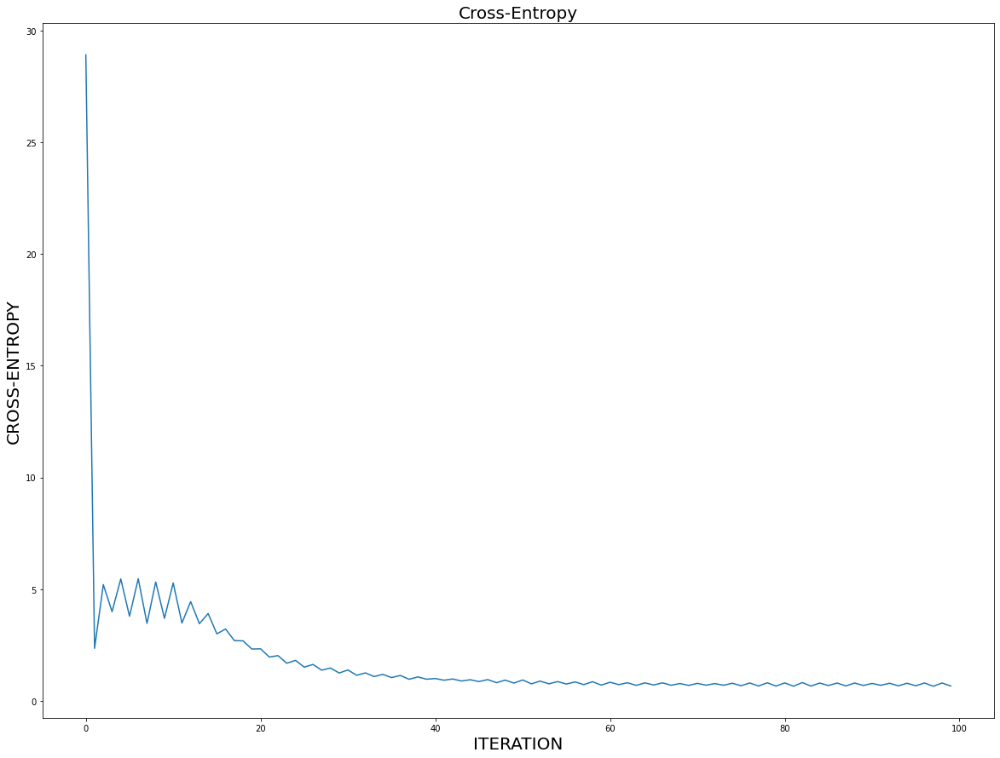

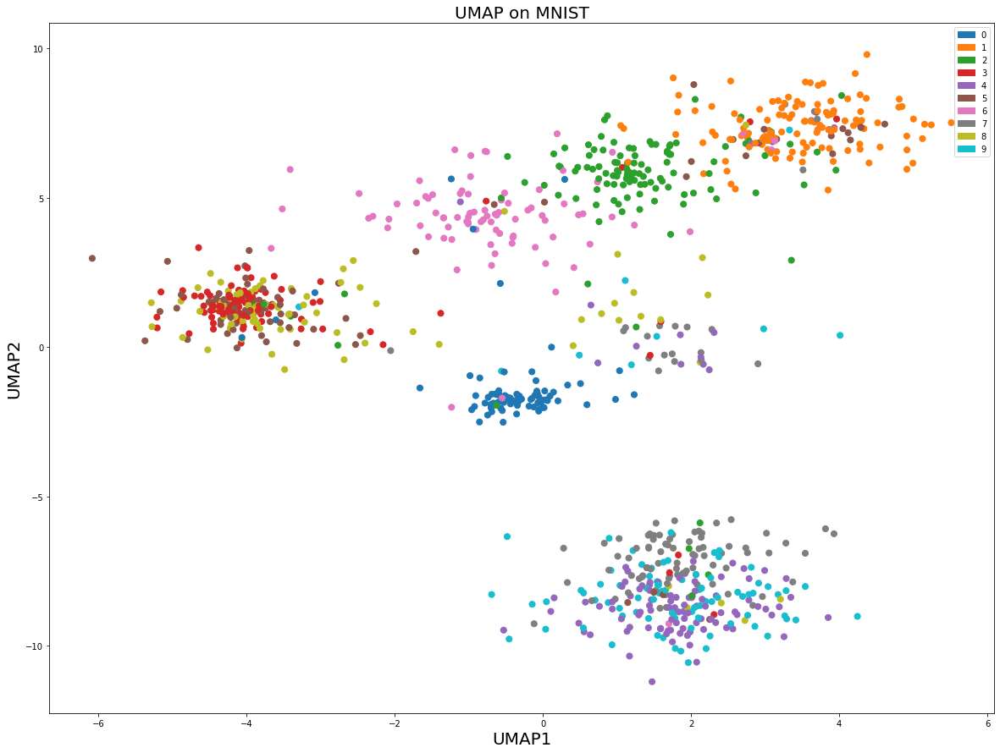


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 41.481332321581554 after 0 iterations
Cross-Entropy = 3.435952975620106 after 10 iterations
Cross-Entropy = 1.4911707428487861 after 20 iterations
Cross-Entropy = 1.127288484766147 after 30 iterations
Cross-Entropy = 0.9568705286355744 after 40 iterations
Cross-Entropy = 0.9030452012875672 after 50 iterations
Cross-Entropy = 0.8326113307183652 after 60 iterations
Cross-Entropy = 0.8507547367108814 after 70 iterations
Cross-Entro

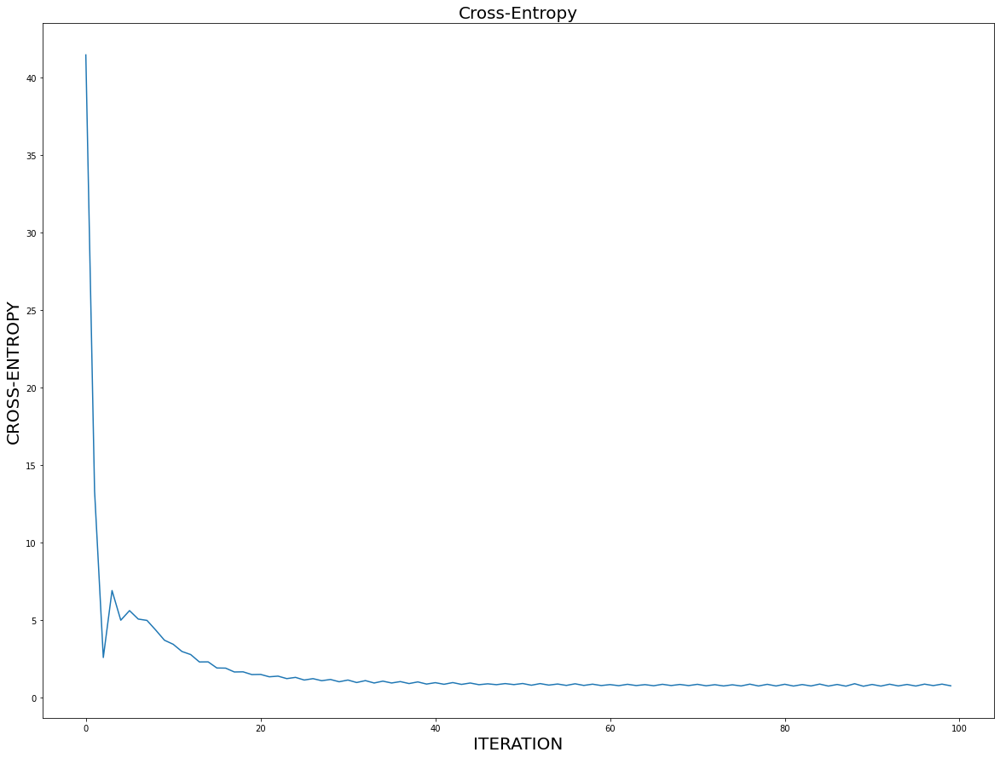

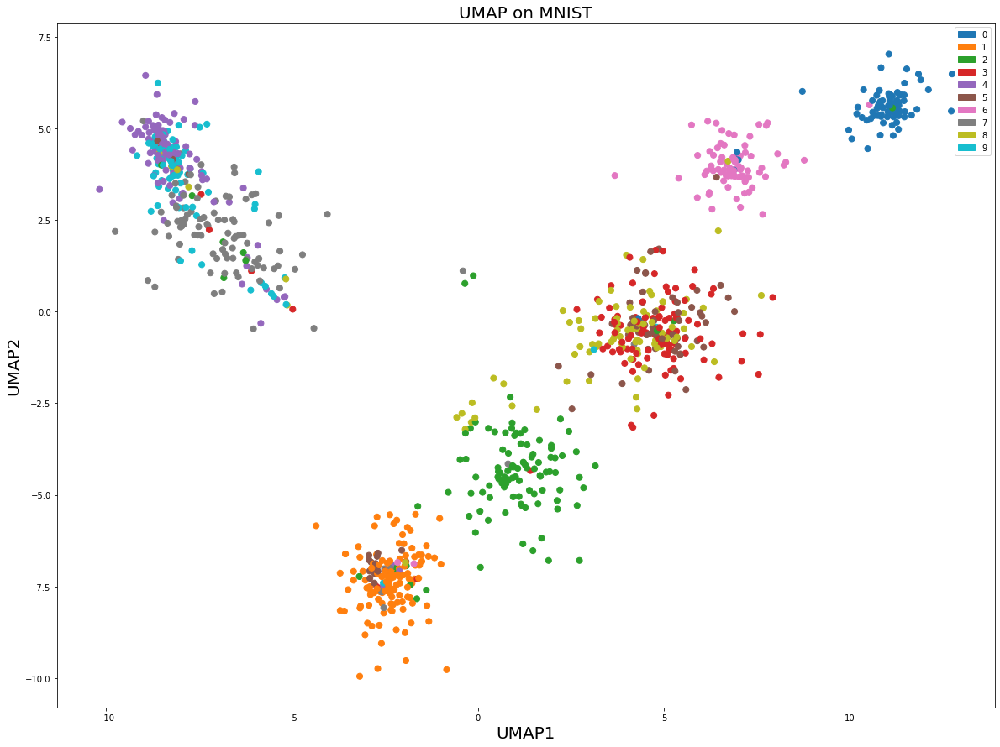


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 45.18518717882242 after 0 iterations
Cross-Entropy = 1.673417187514646 after 10 iterations
Cross-Entropy = 1.0337476013060165 after 20 iterations
Cross-Entropy = 0.9233955219460925 after 30 iterations
Cross-Entropy = 0.8690351665627462 after 40 iterations
Cross-Entropy = 0.8617253523626619 after 50 iterations
Cross-Entropy = 0.8526927515857432 after 60 iterations
Cross-Entropy = 0.8144683726399129 after 70 iterations
Cross-Entro

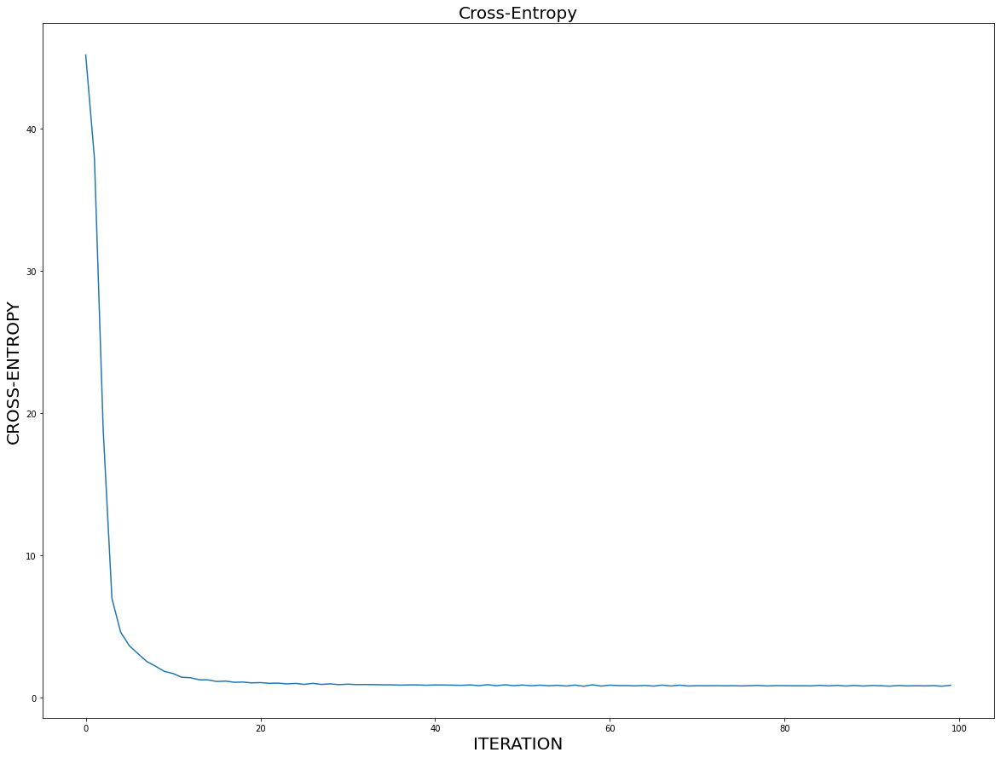

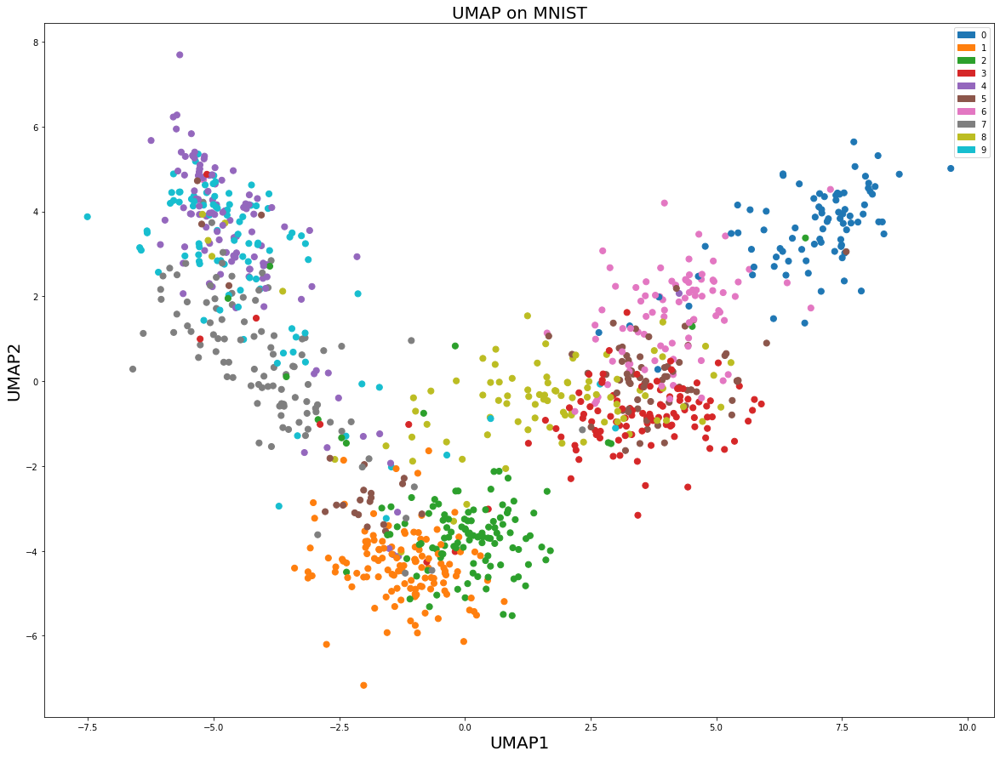


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 188.2904976815194
Running Gradient Descent: 

Cross-Entropy = 45.748276449673085 after 0 iterations
Cross-Entropy = 1.5872307857671928 after 10 iterations
Cross-Entropy = 1.3264844220937906 after 20 iterations
Cross-Entropy = 1.273024562545282 after 30 iterations
Cross-Entropy = 1.2461847006580933 after 40 iterations
Cross-Entropy = 1.2305782906420635 after 50 iterations
Cross-Entropy = 1.220181392414542 after 60 iterations
Cross-Entropy = 1.2169308134186925 after 70 iterations
Cross-Entro

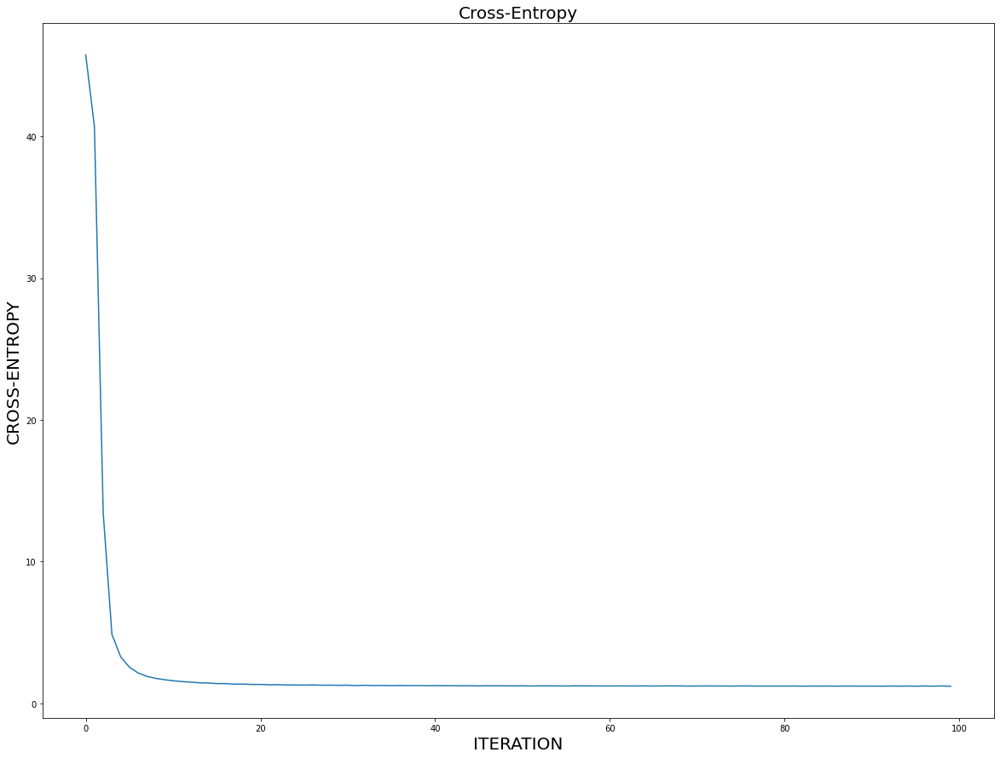

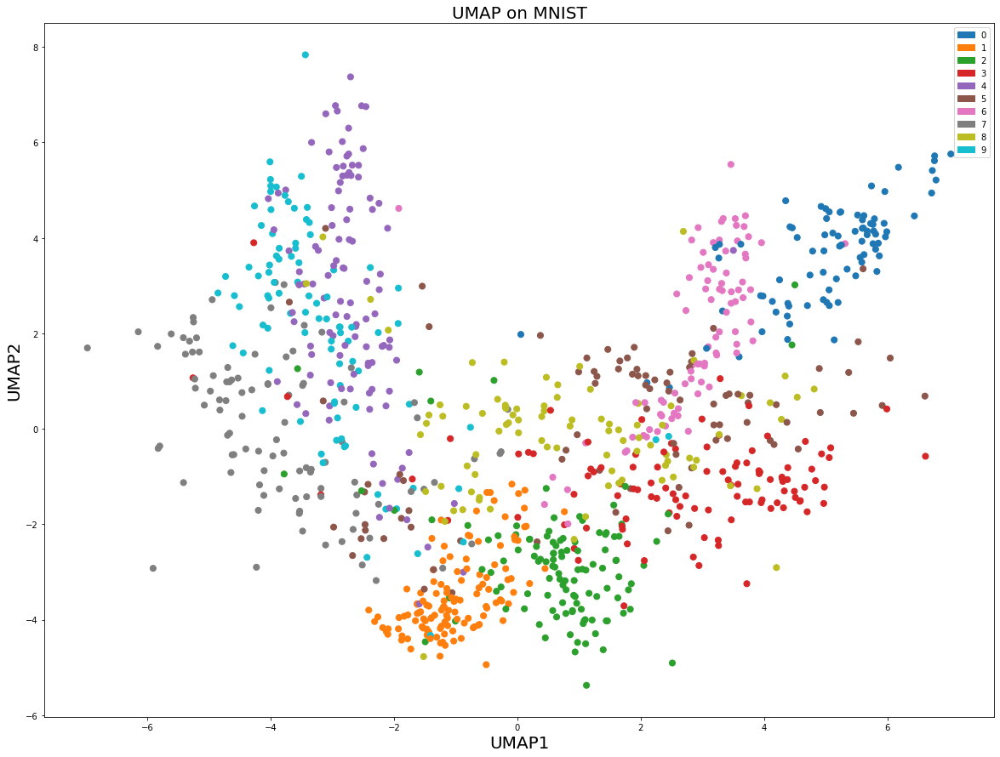


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 26.64426022753896 after 0 iterations
Cross-Entropy = 4.181521725997803 after 10 iterations
Cross-Entropy = 2.167188726307529 after 20 iterations
Cross-Entropy = 1.306099527268903 after 30 iterations
Cross-Entropy = 1.021820646463171 after 40 iterations
Cross-Entropy = 0.862725505743164 after 50 iterations
Cross-Entropy = 0.7826018439850405 after 60 iterations
Cross-Entropy = 0.7834900433060299 after 70 iterations
Cross-Entropy =

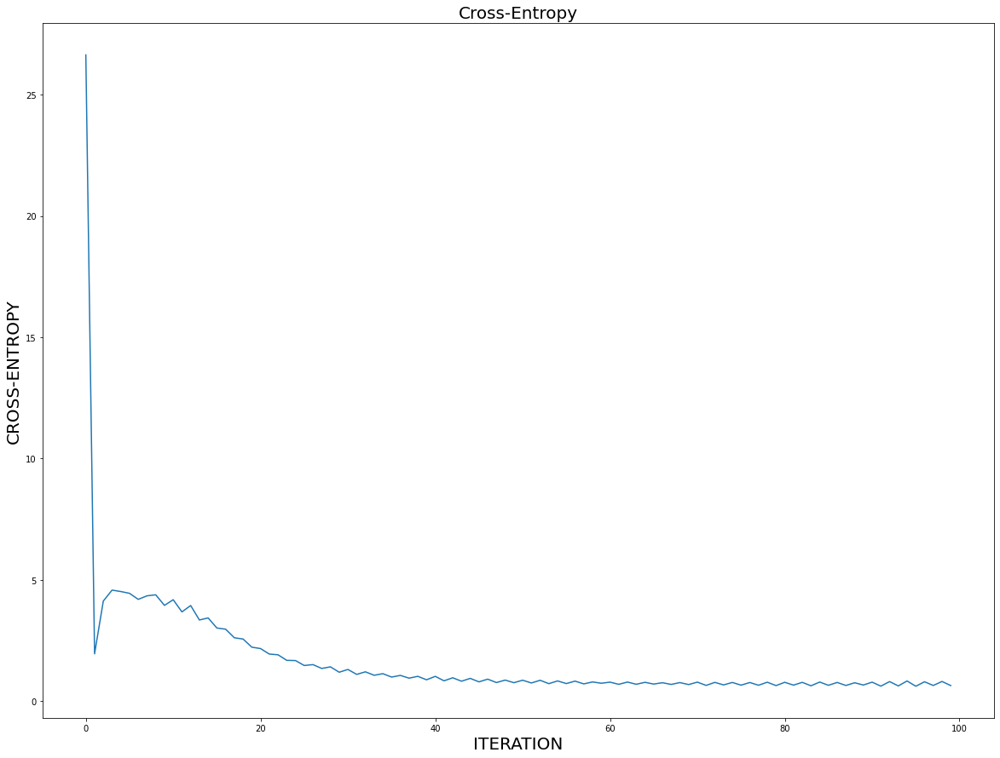

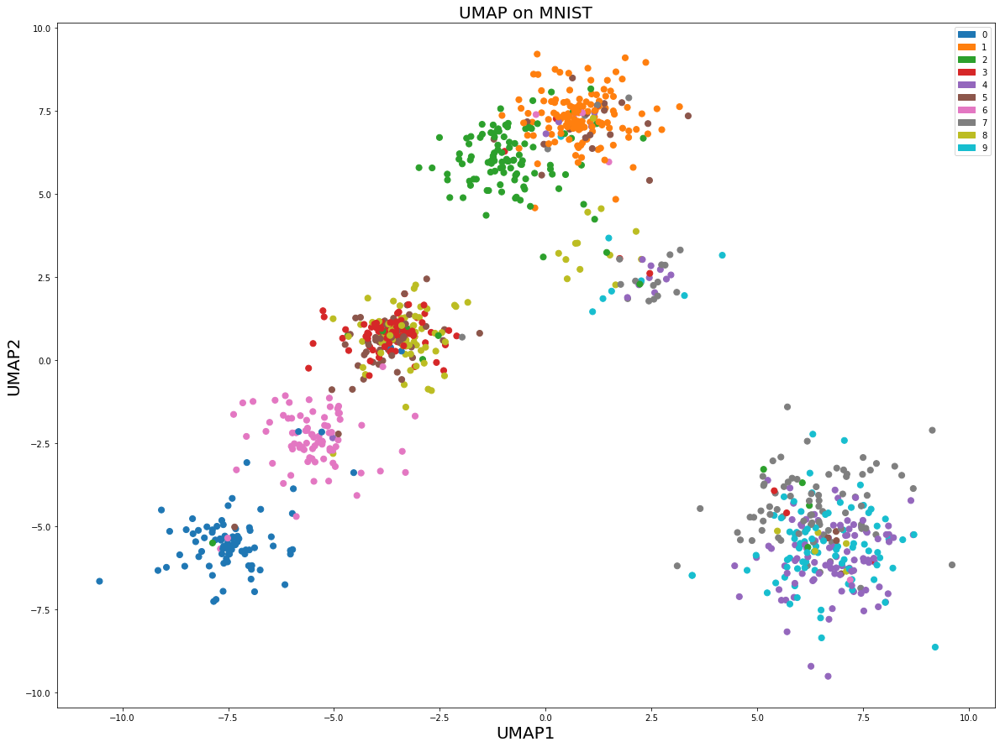


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 31.557126954592544 after 0 iterations
Cross-Entropy = 5.171622684455299 after 10 iterations
Cross-Entropy = 2.7405665797087835 after 20 iterations
Cross-Entropy = 1.5060404880361646 after 30 iterations
Cross-Entropy = 1.1533465562558356 after 40 iterations
Cross-Entropy = 1.025086128237733 after 50 iterations
Cross-Entropy = 0.9676715454366918 after 60 iterations
Cross-Entropy = 0.9520177869441699 after 70 iterations
Cross-Entro

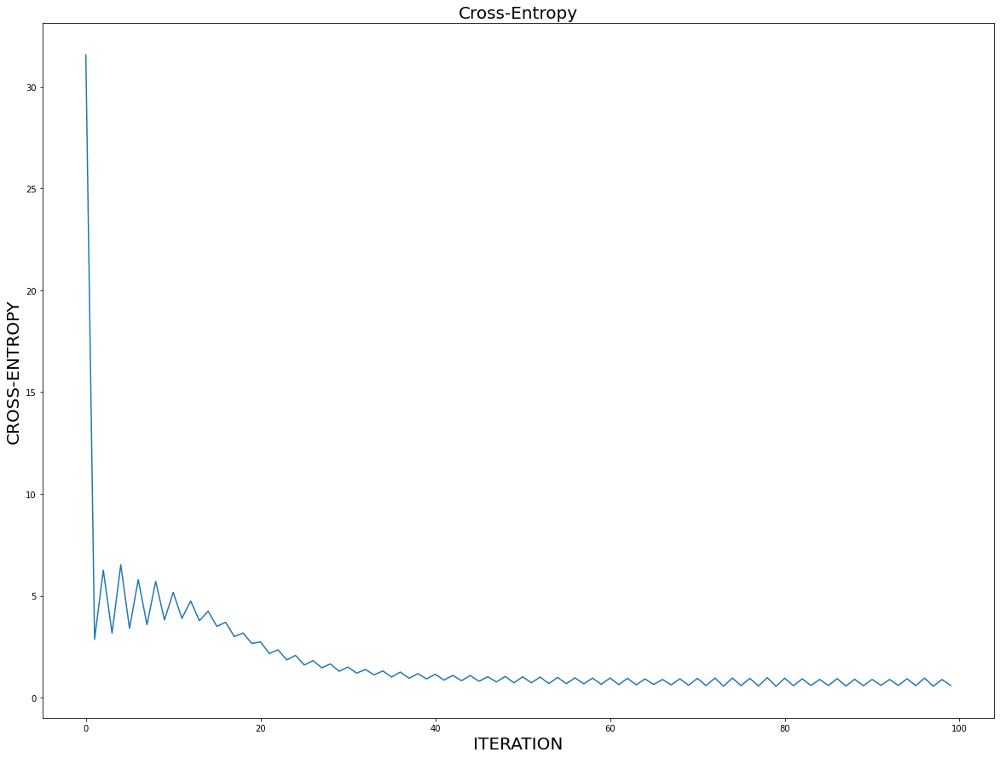

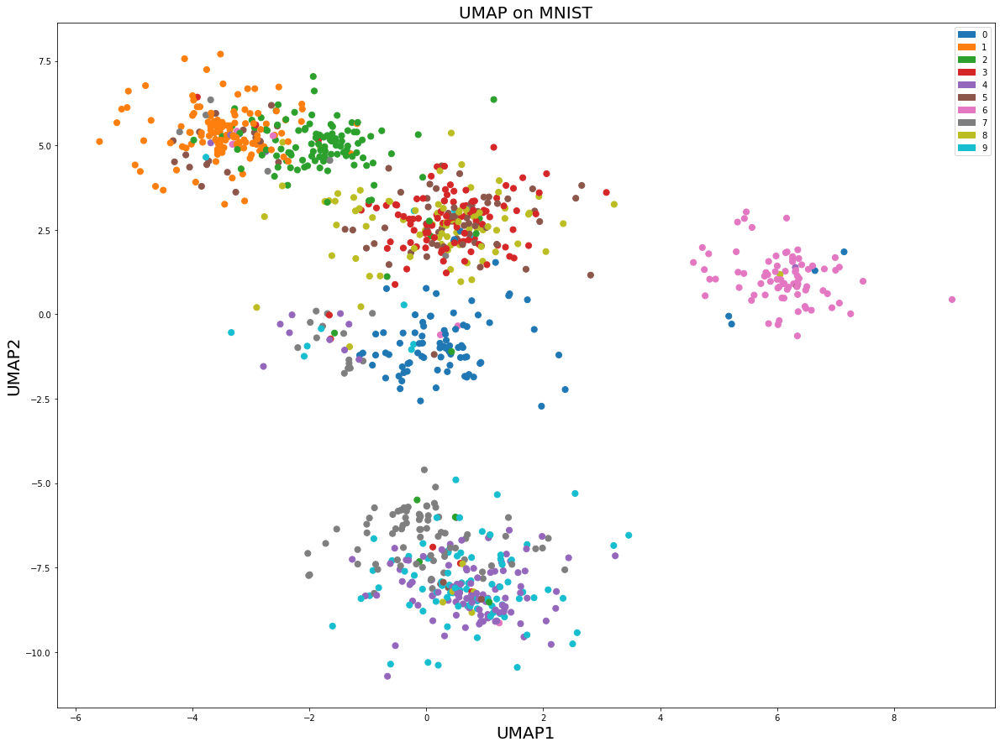


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 36.12185809105148 after 0 iterations
Cross-Entropy = 5.422578647421817 after 10 iterations
Cross-Entropy = 2.401102828236681 after 20 iterations
Cross-Entropy = 1.4236321117827477 after 30 iterations
Cross-Entropy = 1.1030173200579294 after 40 iterations
Cross-Entropy = 0.9705209965701932 after 50 iterations
Cross-Entropy = 0.8984352150049342 after 60 iterations
Cross-Entropy = 0.8352262023547649 after 70 iterations
Cross-Entrop

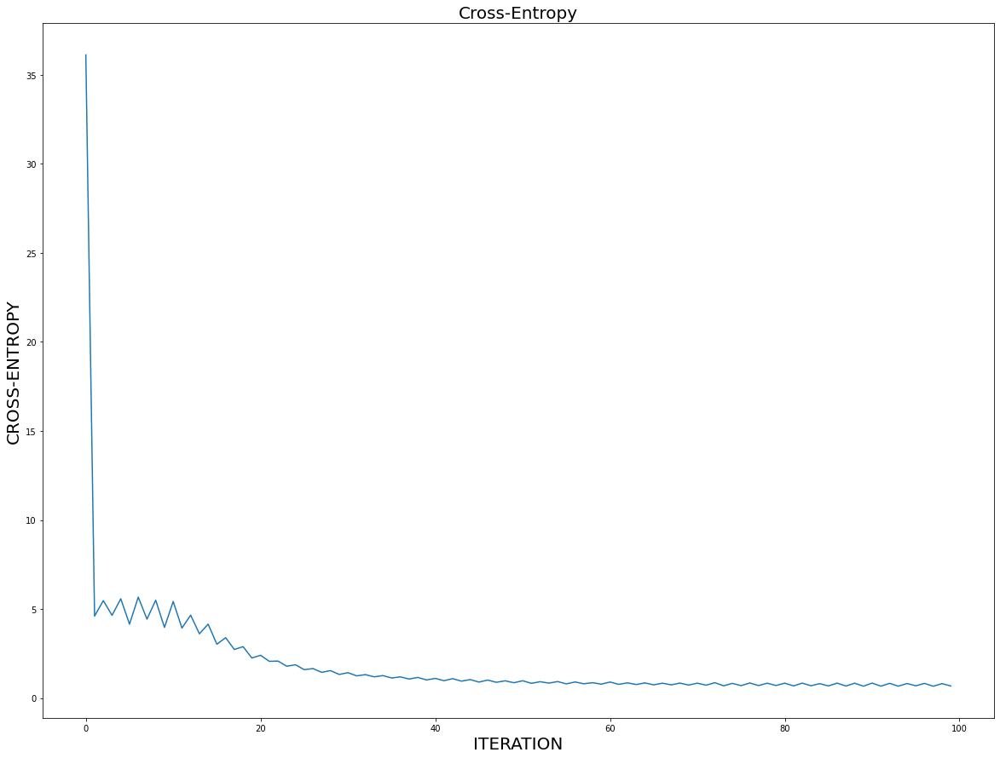

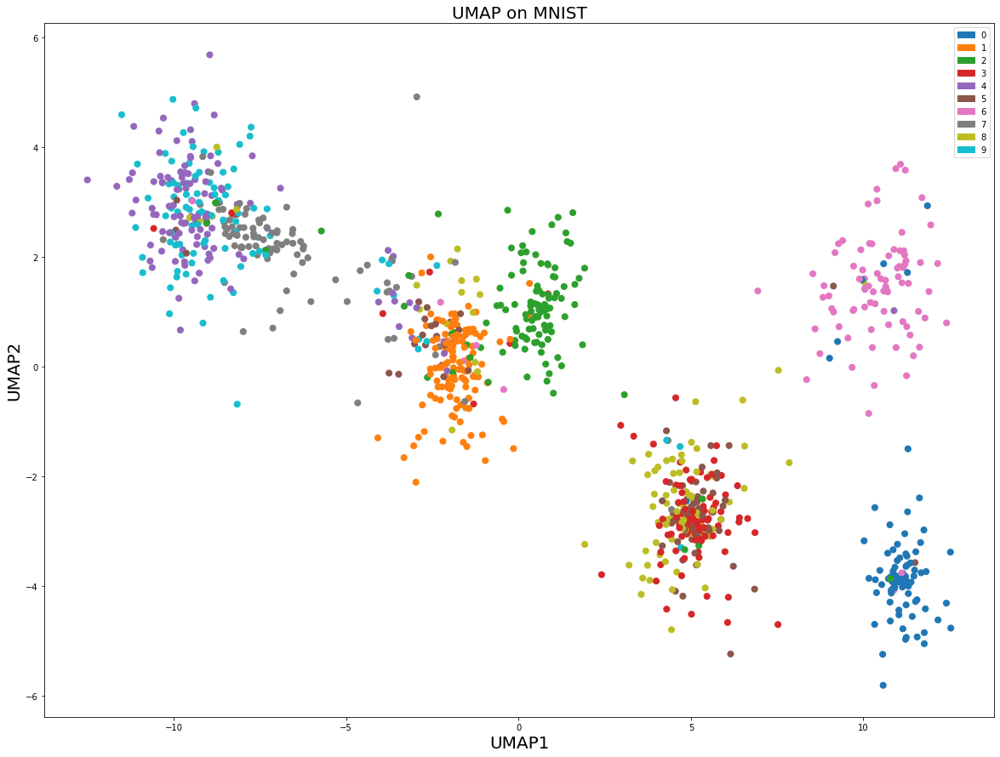


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 28.509048519671495 after 0 iterations
Cross-Entropy = 4.725820127516222 after 10 iterations
Cross-Entropy = 2.4961903281739573 after 20 iterations
Cross-Entropy = 1.3529198929703476 after 30 iterations
Cross-Entropy = 1.0226132372465113 after 40 iterations
Cross-Entropy = 0.8908534198419599 after 50 iterations
Cross-Entropy = 0.804191367946443 after 60 iterations
Cross-Entropy = 0.8798473194183624 after 70 iterations
Cross-Entro

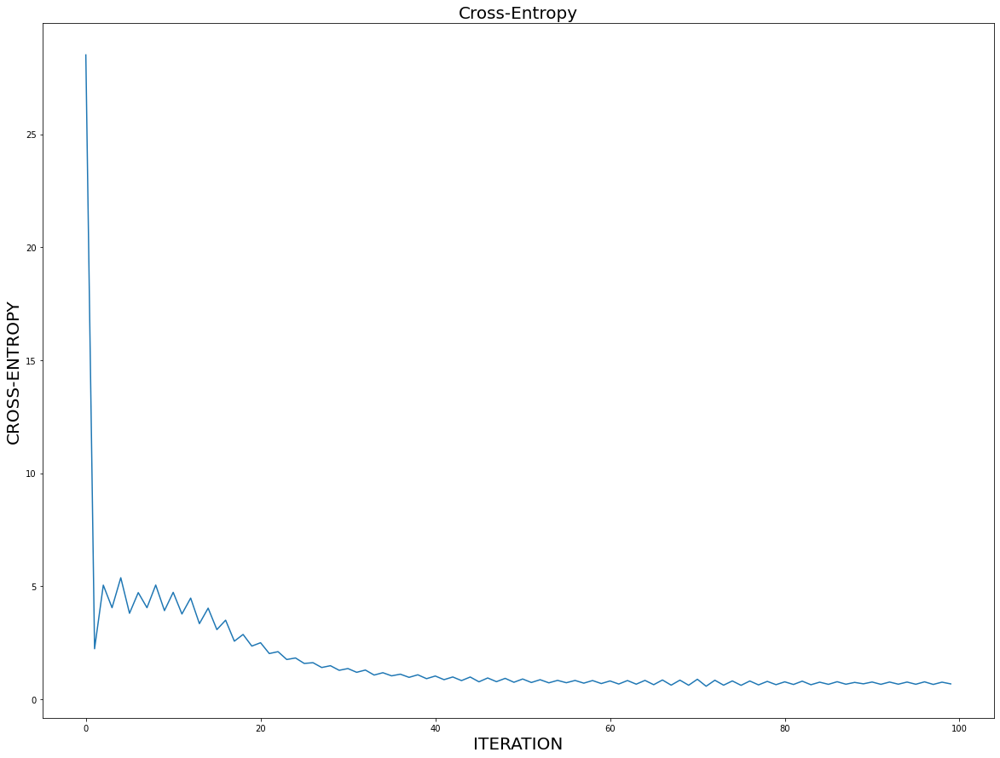

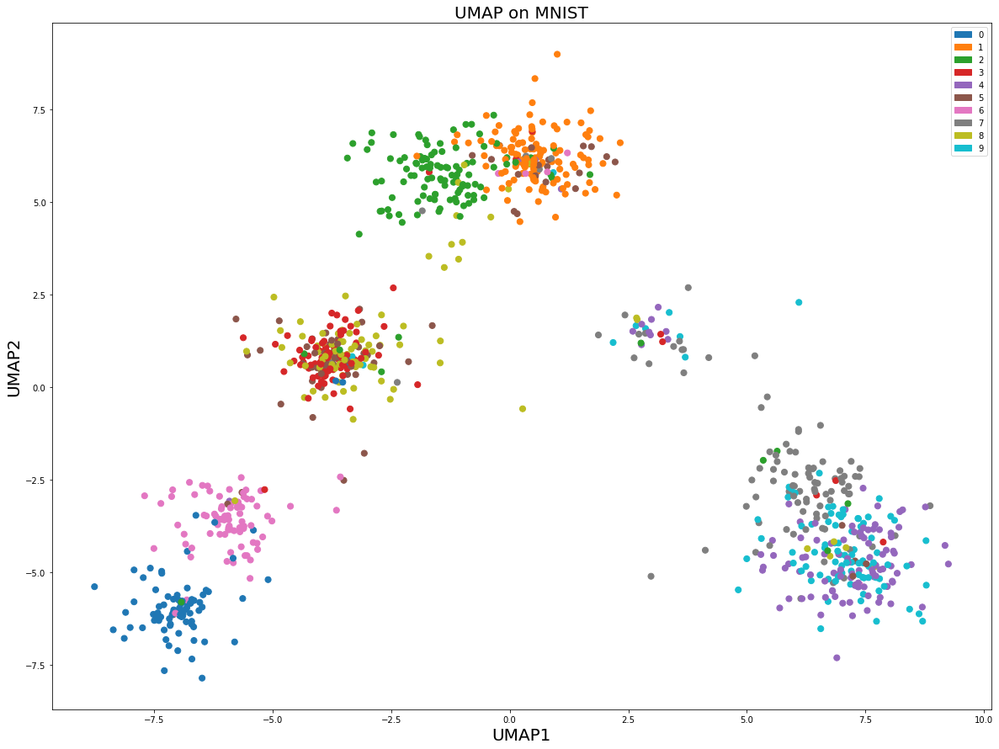


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 41.55755697100561 after 0 iterations
Cross-Entropy = 3.517629175738743 after 10 iterations
Cross-Entropy = 1.603578228205937 after 20 iterations
Cross-Entropy = 1.1835019617935538 after 30 iterations
Cross-Entropy = 0.99584669895755 after 40 iterations
Cross-Entropy = 0.9176557253321985 after 50 iterations
Cross-Entropy = 0.8552095577703855 after 60 iterations
Cross-Entropy = 0.8325756081846492 after 70 iterations
Cross-Entropy 

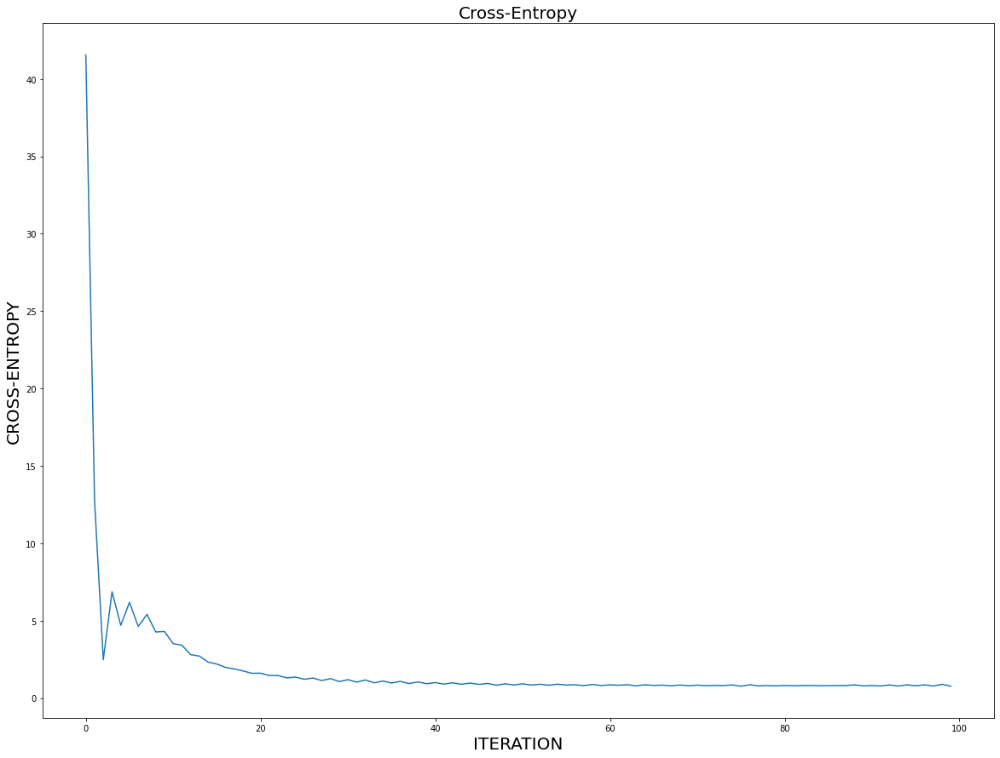

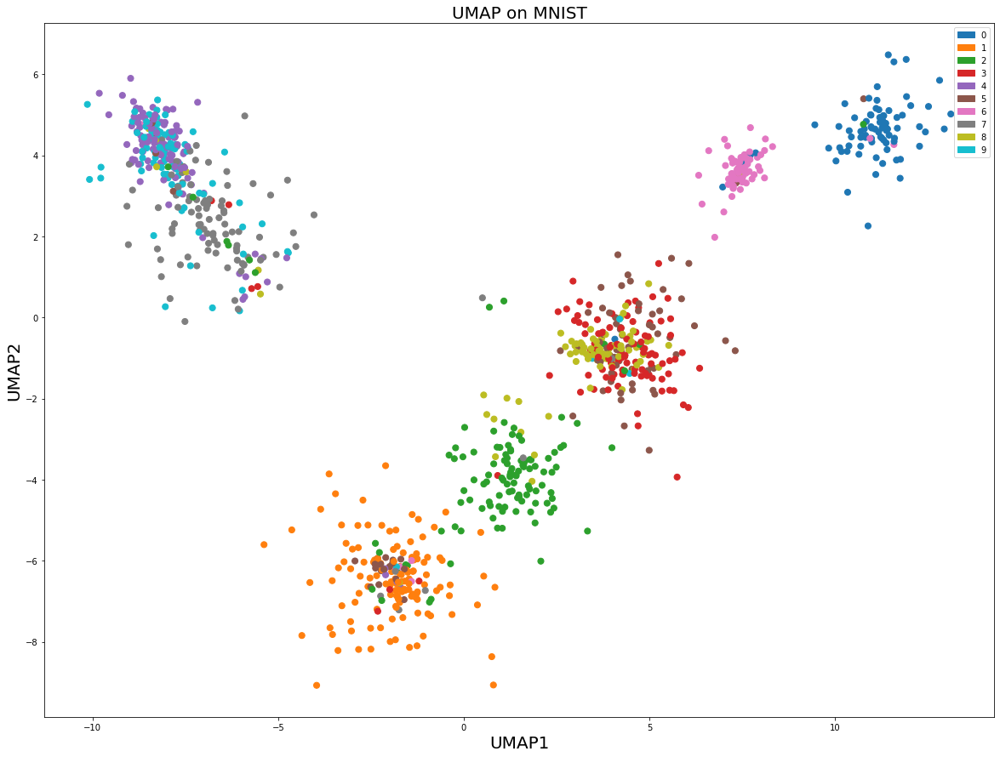


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 45.22983465823271 after 0 iterations
Cross-Entropy = 1.6559528368656697 after 10 iterations
Cross-Entropy = 1.0796148769455782 after 20 iterations
Cross-Entropy = 0.9420073162737382 after 30 iterations
Cross-Entropy = 0.922484238598305 after 40 iterations
Cross-Entropy = 0.9117274258218235 after 50 iterations
Cross-Entropy = 0.8842550763067113 after 60 iterations
Cross-Entropy = 0.869410458552343 after 70 iterations
Cross-Entrop

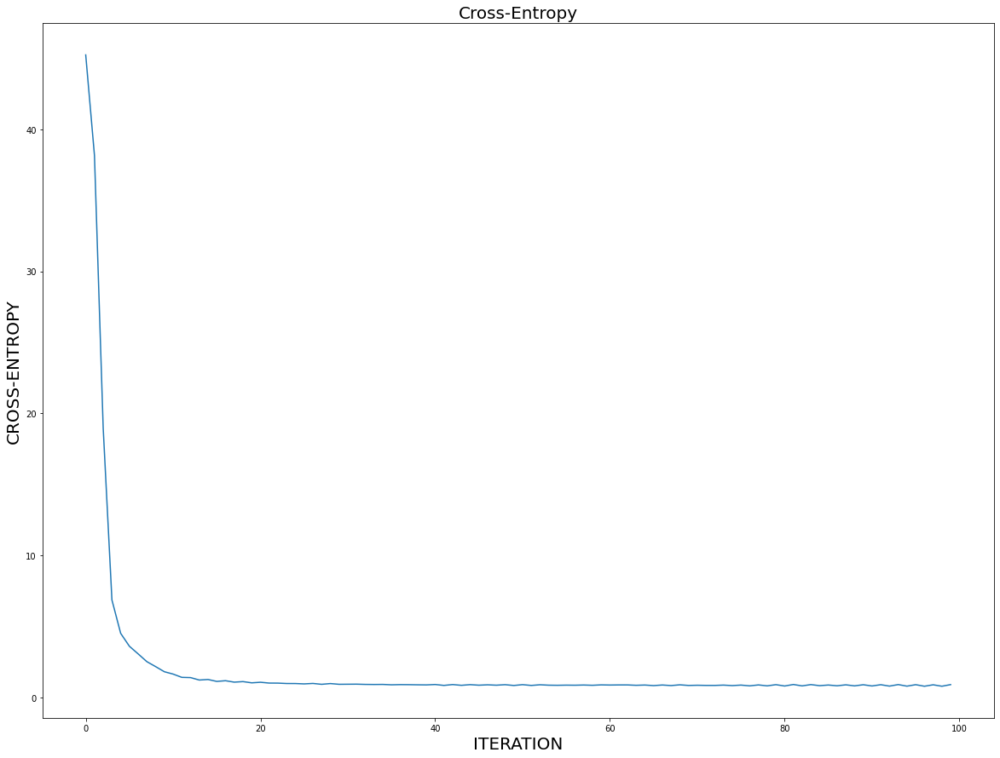

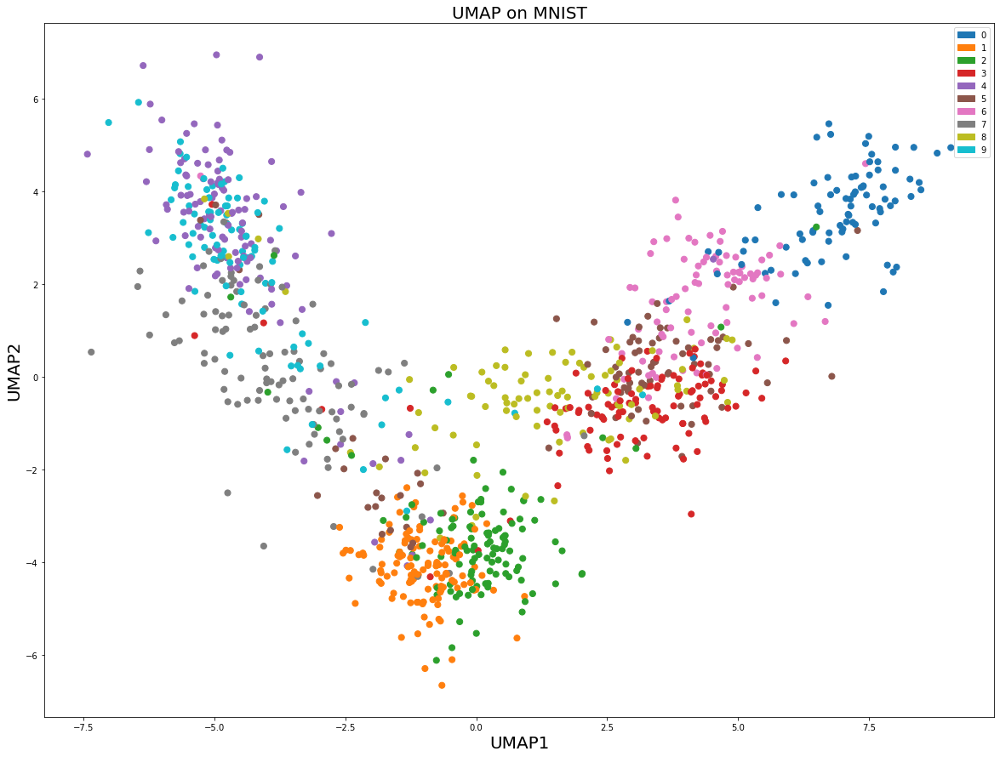


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 191.9507417115602
Running Gradient Descent: 

Cross-Entropy = 45.7481504878829 after 0 iterations
Cross-Entropy = 1.6390292500732917 after 10 iterations
Cross-Entropy = 1.392535256311822 after 20 iterations
Cross-Entropy = 1.3170030125243253 after 30 iterations
Cross-Entropy = 1.278082180433251 after 40 iterations
Cross-Entropy = 1.2636990472944267 after 50 iterations
Cross-Entropy = 1.2530013661201687 after 60 iterations
Cross-Entropy = 1.250465007872943 after 70 iterations
Cross-Entropy 

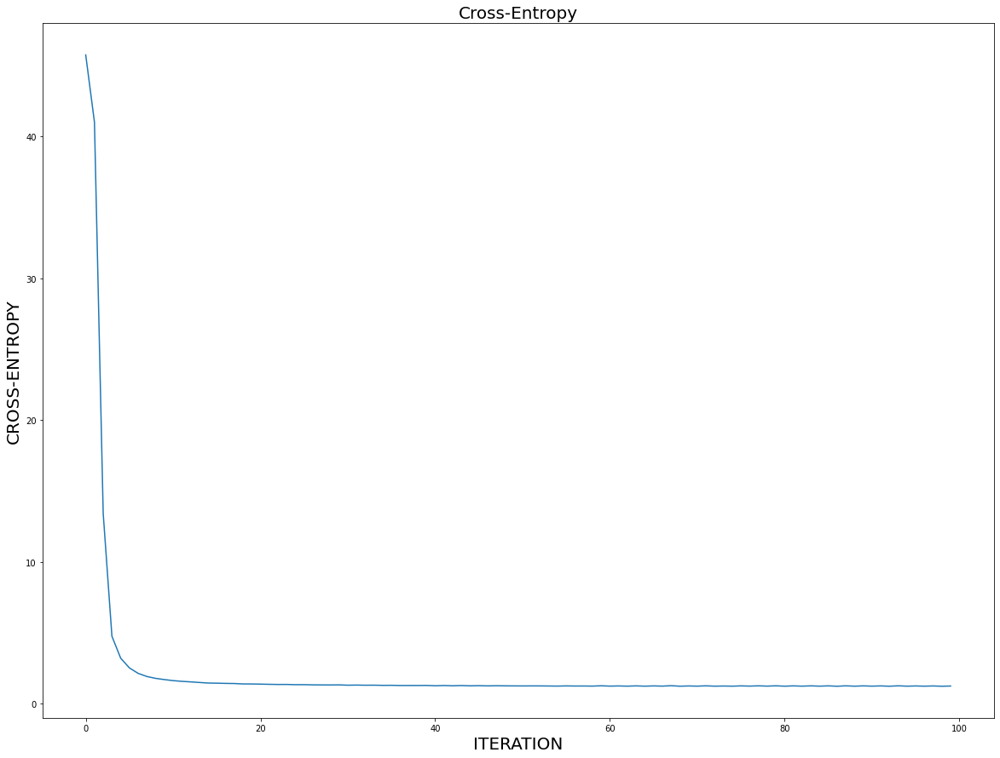

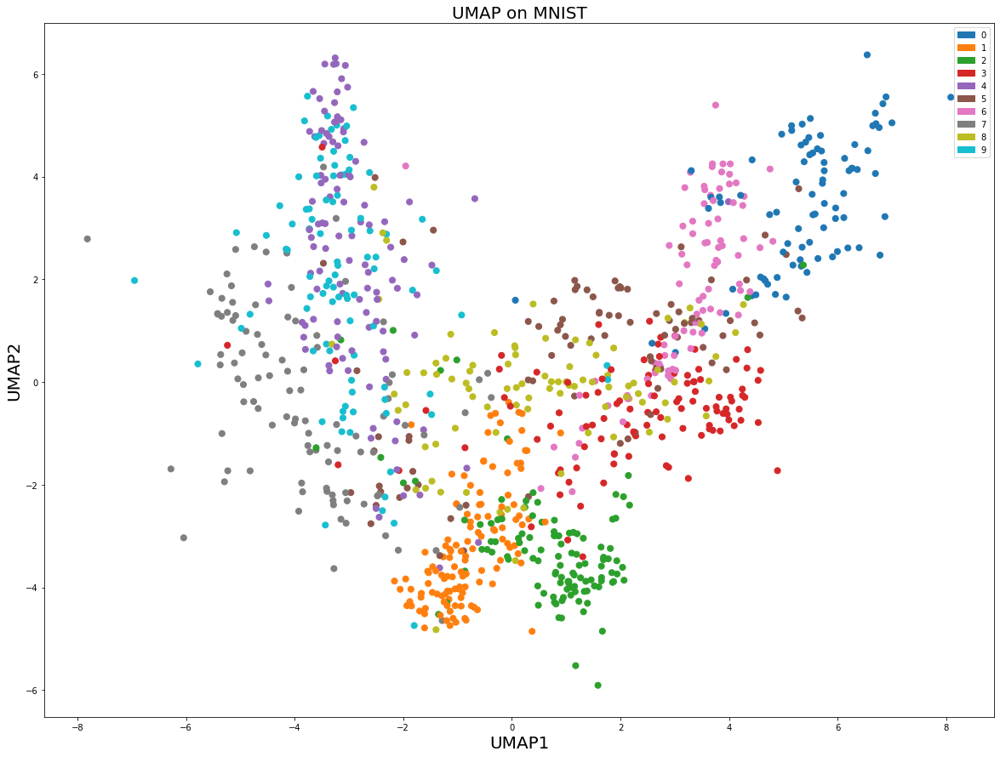


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 26.447422870203663 after 0 iterations
Cross-Entropy = 3.9871083578011 after 10 iterations
Cross-Entropy = 2.194361405971492 after 20 iterations
Cross-Entropy = 1.2903269575452188 after 30 iterations
Cross-Entropy = 0.991443200104728 after 40 iterations
Cross-Entropy = 0.8509208832708738 after 50 iterations
Cross-Entropy = 0.7555141237814688 after 60 iterations
Cross-Entropy = 0.7205289736408566 after 70 iterations
Cross-Entropy

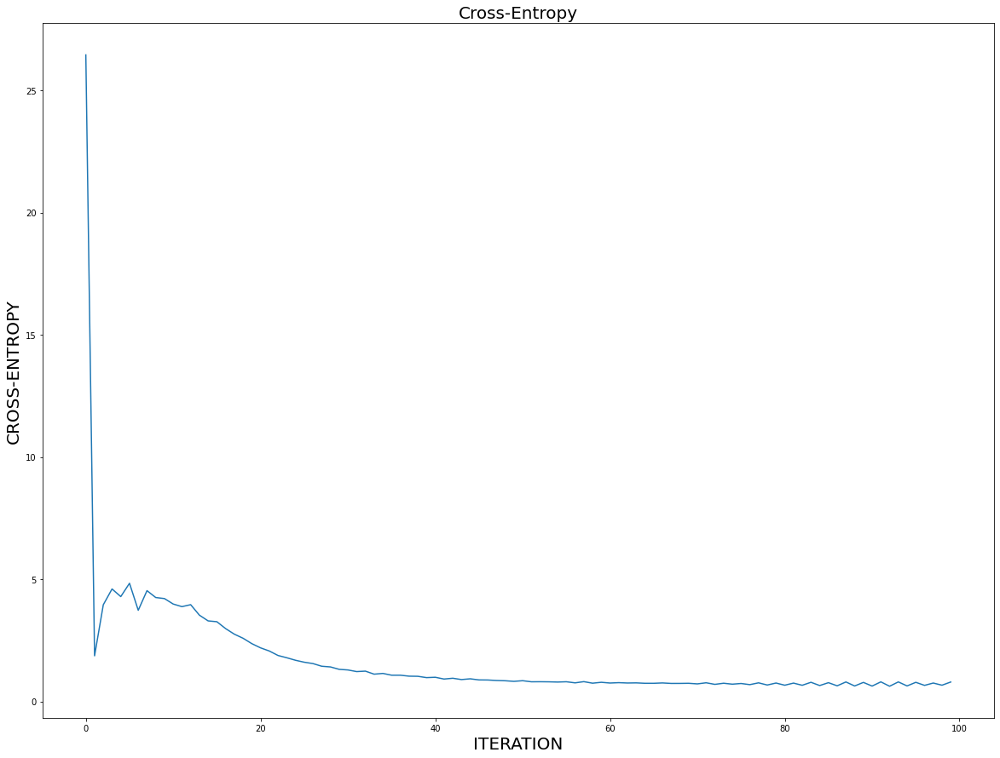

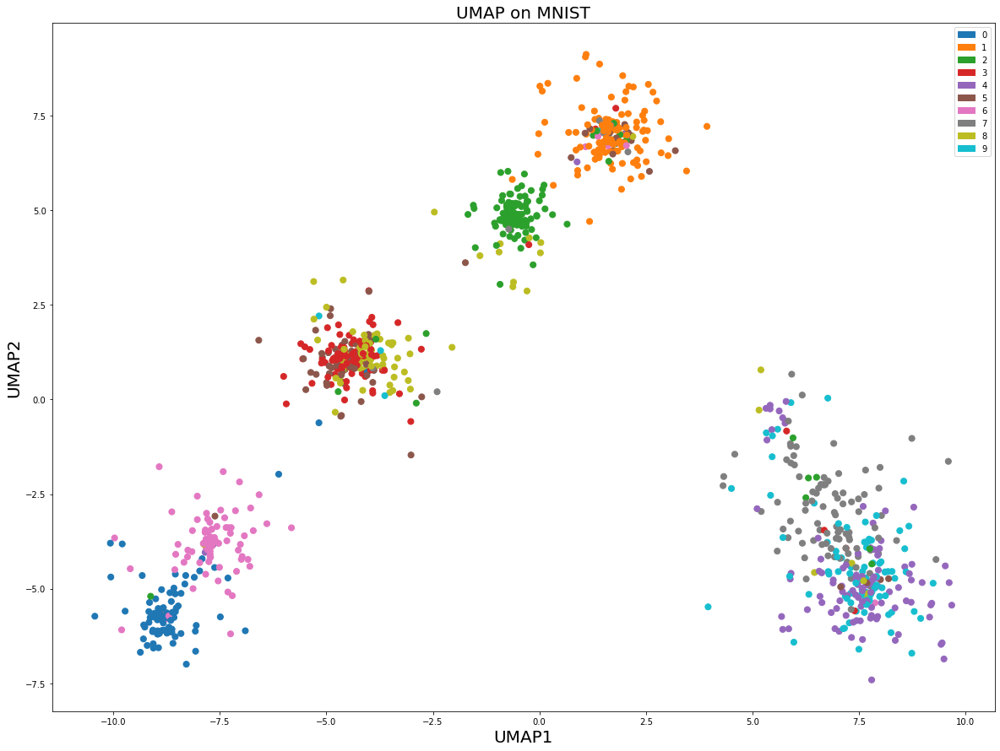


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 31.418490804086613 after 0 iterations
Cross-Entropy = 5.476908285471113 after 10 iterations
Cross-Entropy = 2.9434844279210264 after 20 iterations
Cross-Entropy = 1.806674770699689 after 30 iterations
Cross-Entropy = 1.3726121853825488 after 40 iterations
Cross-Entropy = 1.180039308570377 after 50 iterations
Cross-Entropy = 1.0696345154229494 after 60 iterations
Cross-Entropy = 0.9664624287385535 after 70 iterations
Cross-Entro

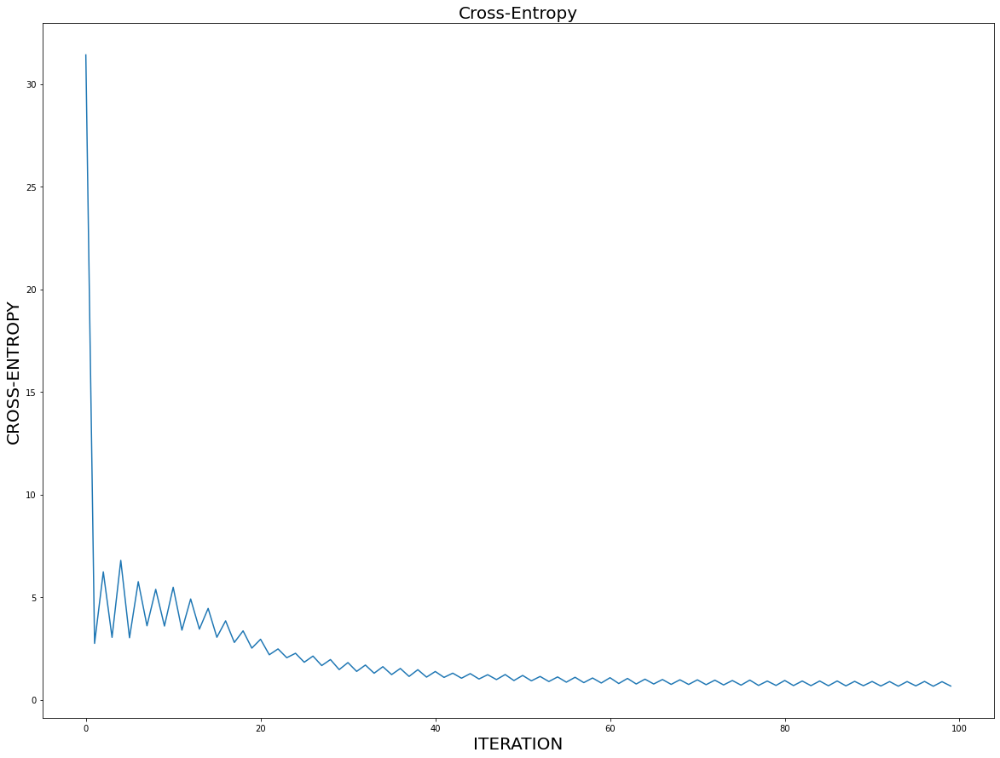

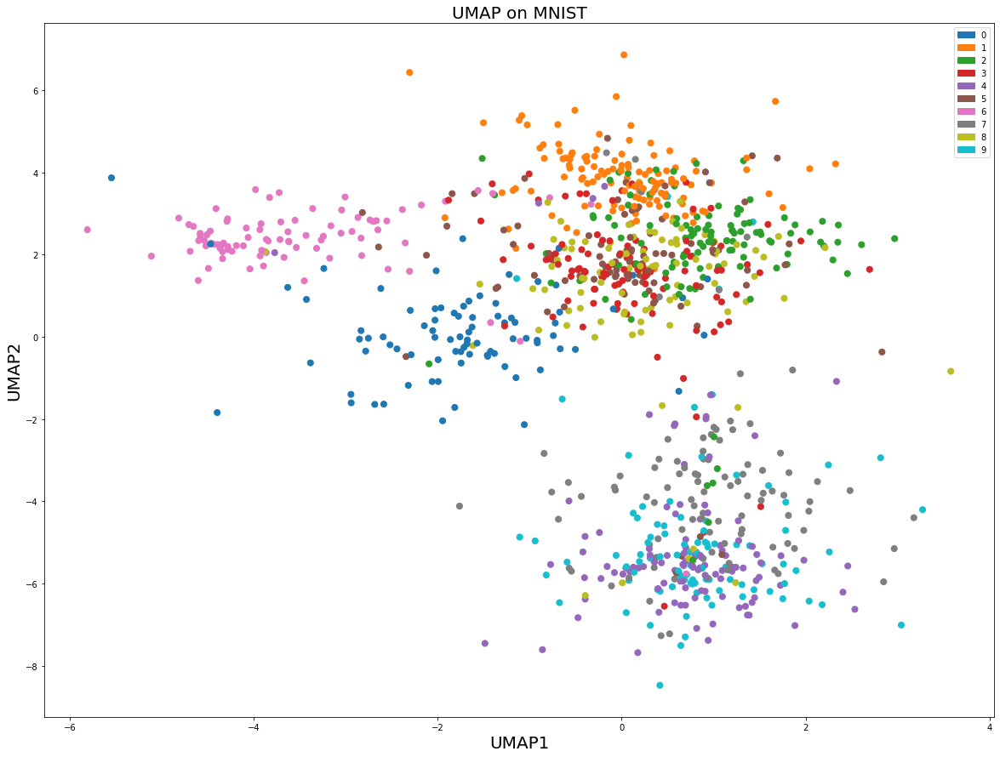


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 36.08600681466912 after 0 iterations
Cross-Entropy = 5.037824394962046 after 10 iterations
Cross-Entropy = 2.6204047530000683 after 20 iterations
Cross-Entropy = 1.5235721913108093 after 30 iterations
Cross-Entropy = 1.1471661807215543 after 40 iterations
Cross-Entropy = 0.9478226110263396 after 50 iterations
Cross-Entropy = 0.9201828557364462 after 60 iterations
Cross-Entropy = 0.8759591309463072 after 70 iterations
Cross-Entr

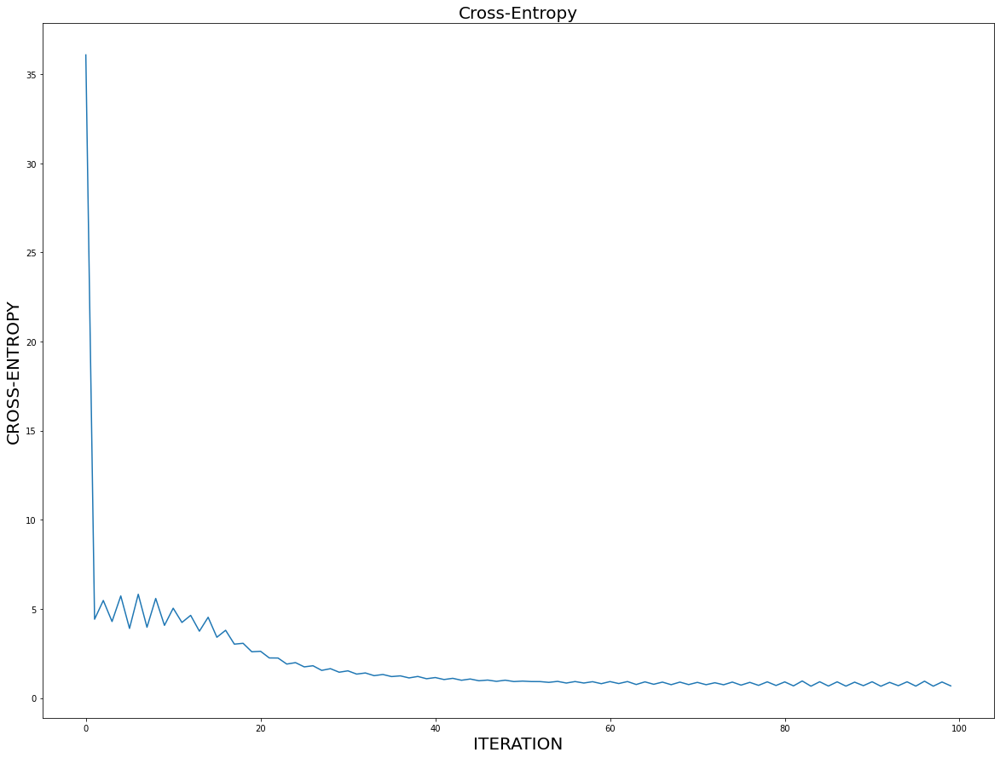

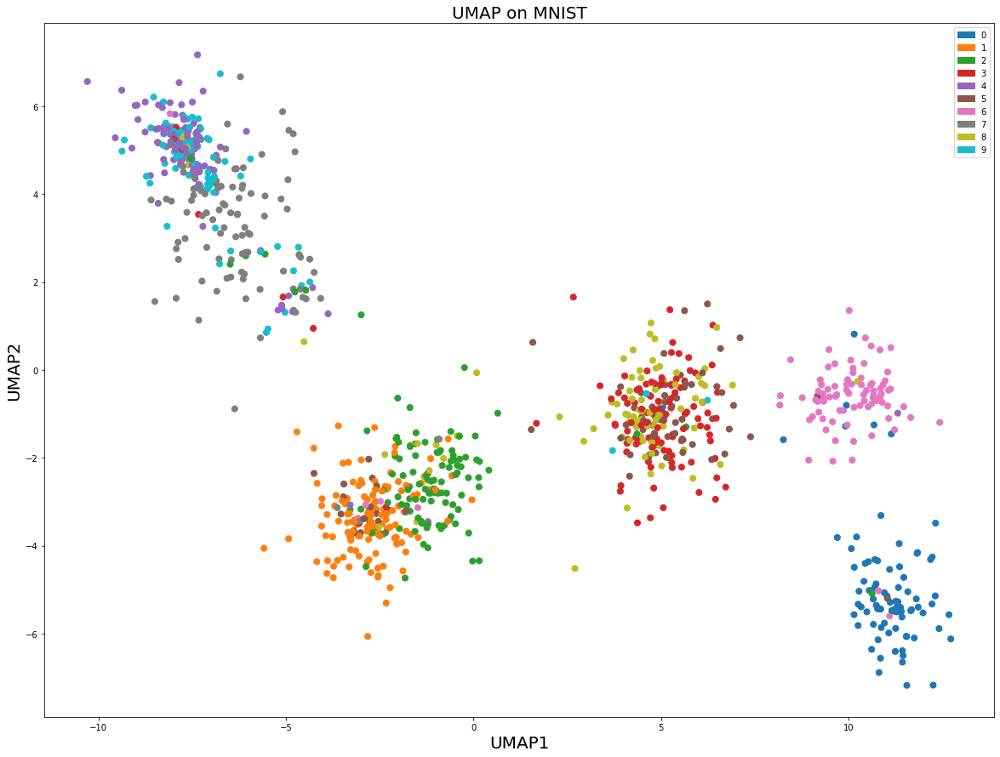


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 28.329317806822843 after 0 iterations
Cross-Entropy = 4.9632398178487005 after 10 iterations
Cross-Entropy = 2.364161997104387 after 20 iterations
Cross-Entropy = 1.380985760062384 after 30 iterations
Cross-Entropy = 1.0849581459594357 after 40 iterations
Cross-Entropy = 0.935375951861874 after 50 iterations
Cross-Entropy = 0.8627253551094916 after 60 iterations
Cross-Entropy = 0.8331973424575428 after 70 iterations
Cross-Entro

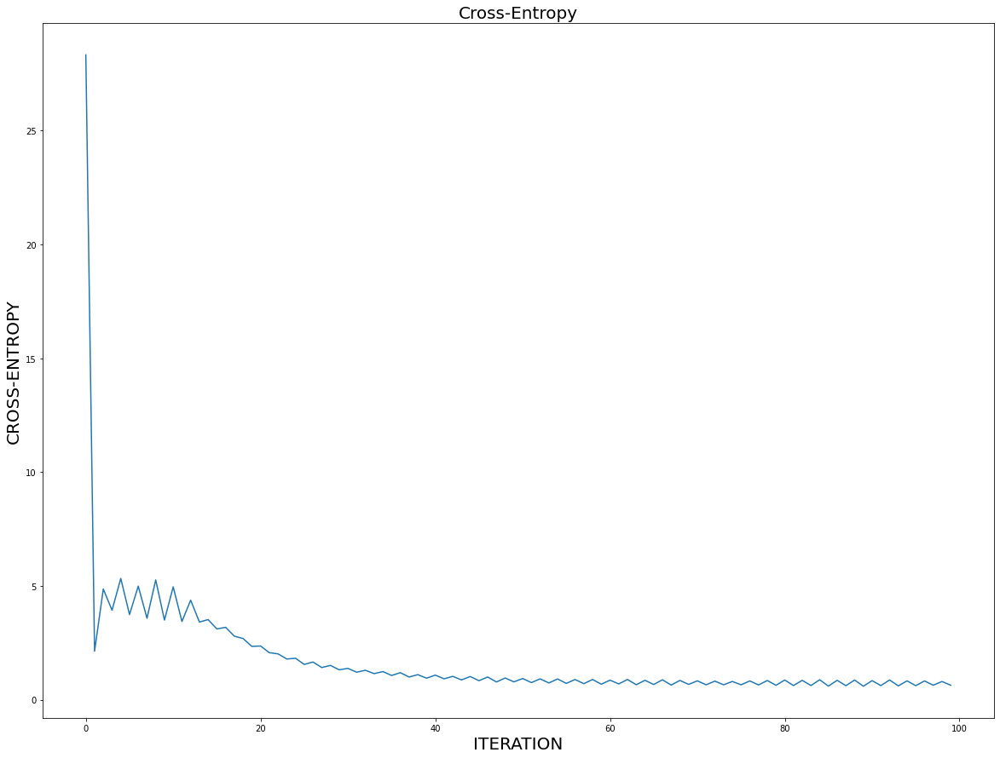

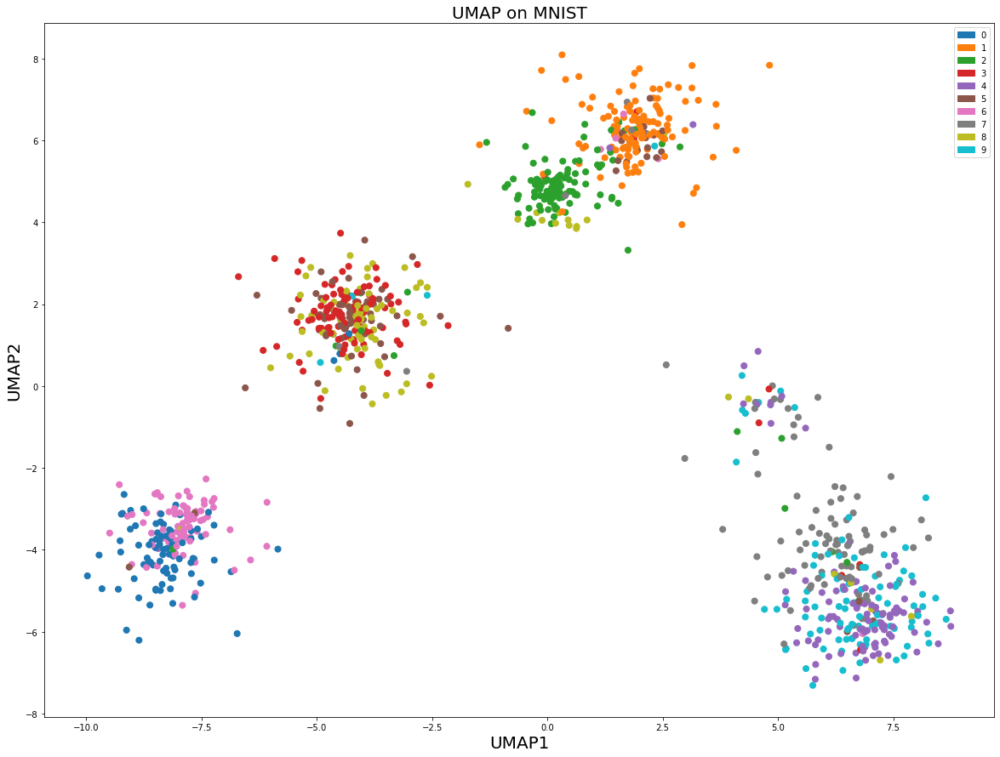


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 41.72257119709225 after 0 iterations
Cross-Entropy = 4.089412188489569 after 10 iterations
Cross-Entropy = 1.8362558286208912 after 20 iterations
Cross-Entropy = 1.3553502183589592 after 30 iterations
Cross-Entropy = 1.1556123918139927 after 40 iterations
Cross-Entropy = 1.0412691358479944 after 50 iterations
Cross-Entropy = 1.0711181199797366 after 60 iterations
Cross-Entropy = 1.0263882495401326 after 70 iterations
Cross-Entr

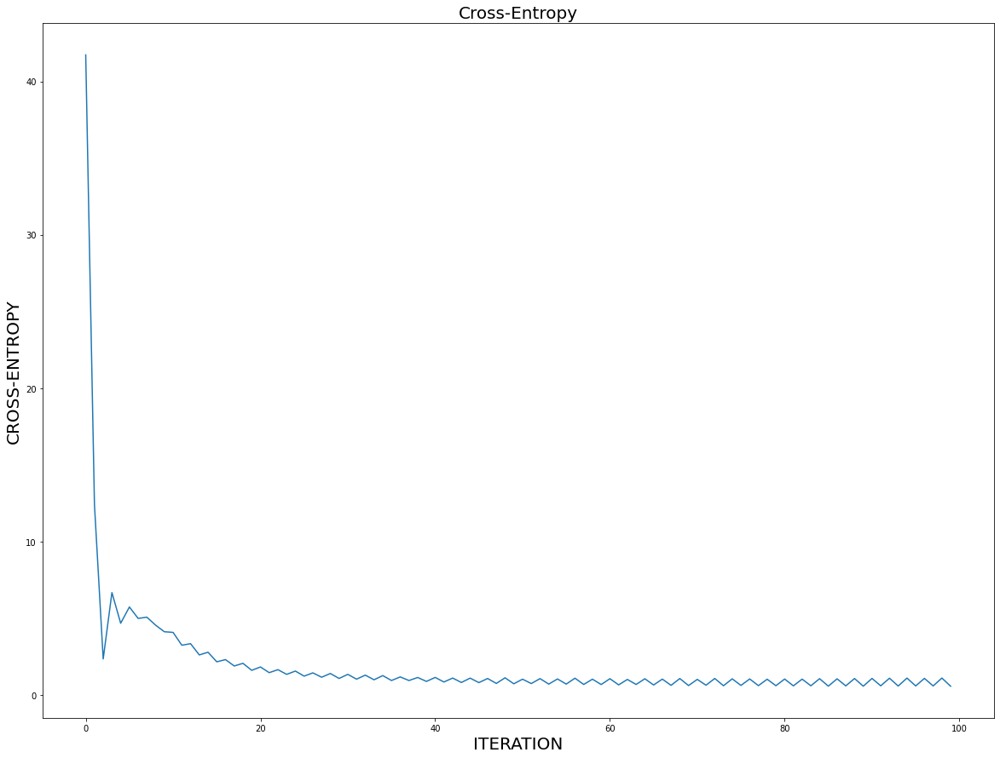

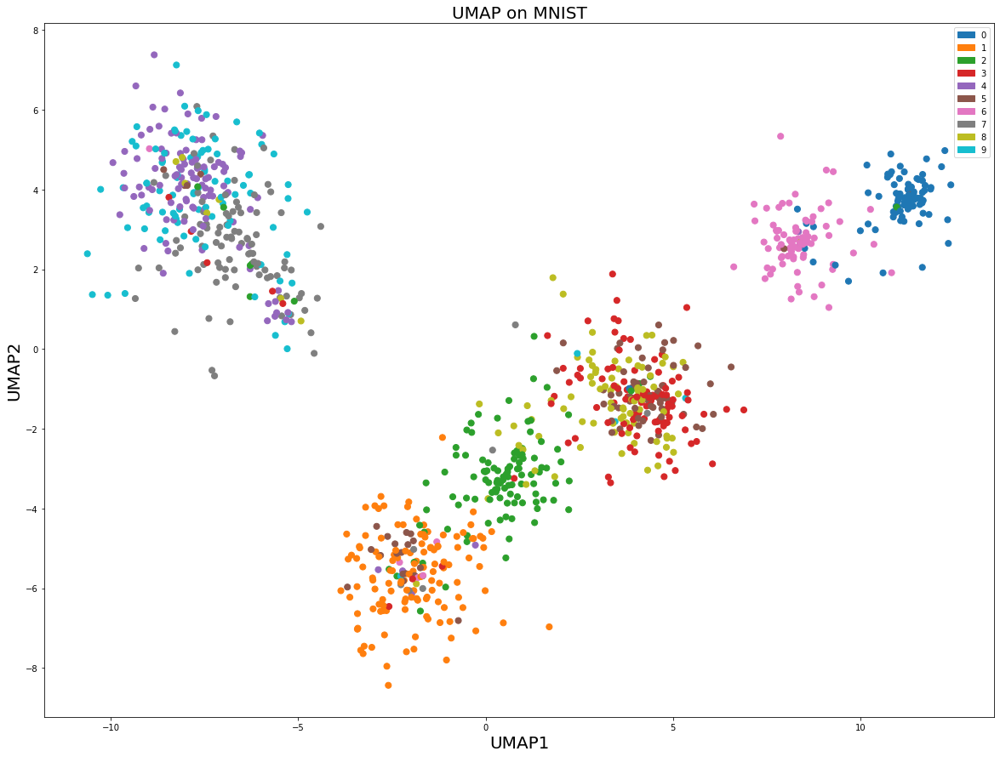


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 45.26828126013539 after 0 iterations
Cross-Entropy = 1.6836873491984254 after 10 iterations
Cross-Entropy = 1.1469531731955227 after 20 iterations
Cross-Entropy = 1.0785186231966326 after 30 iterations
Cross-Entropy = 0.9698378504669527 after 40 iterations
Cross-Entropy = 0.9284484157185481 after 50 iterations
Cross-Entropy = 0.904426778113501 after 60 iterations
Cross-Entropy = 0.8778068913894045 after 70 iterations
Cross-Entr

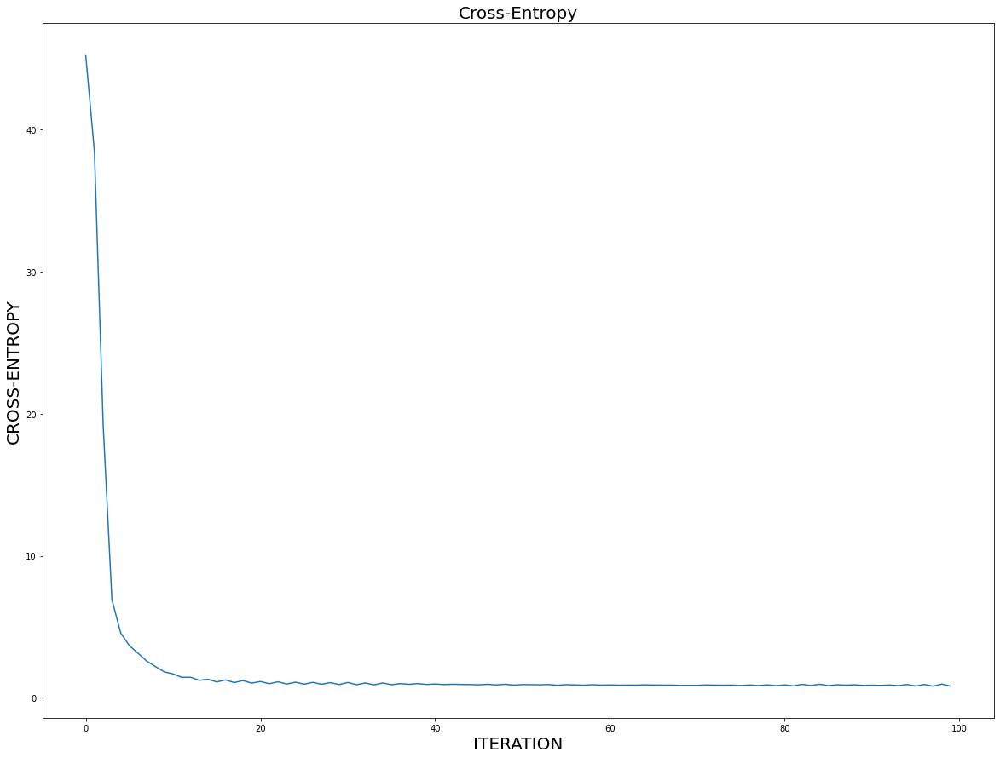

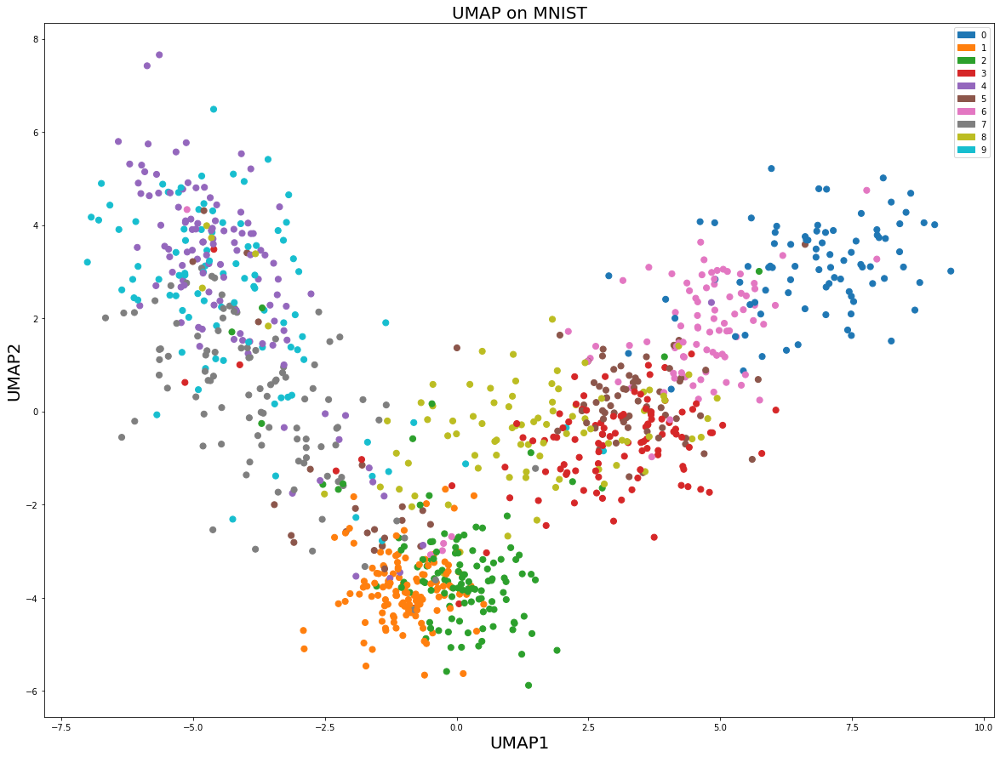


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 195.31169715705695
Running Gradient Descent: 

Cross-Entropy = 45.747399855341875 after 0 iterations
Cross-Entropy = 1.6864941713267727 after 10 iterations
Cross-Entropy = 1.4332554728617952 after 20 iterations
Cross-Entropy = 1.3787239181402526 after 30 iterations
Cross-Entropy = 1.3461136519689865 after 40 iterations
Cross-Entropy = 1.3307801656920224 after 50 iterations
Cross-Entropy = 1.320512635846903 after 60 iterations
Cross-Entropy = 1.3161741189794185 after 70 iterations
Cross-Ent

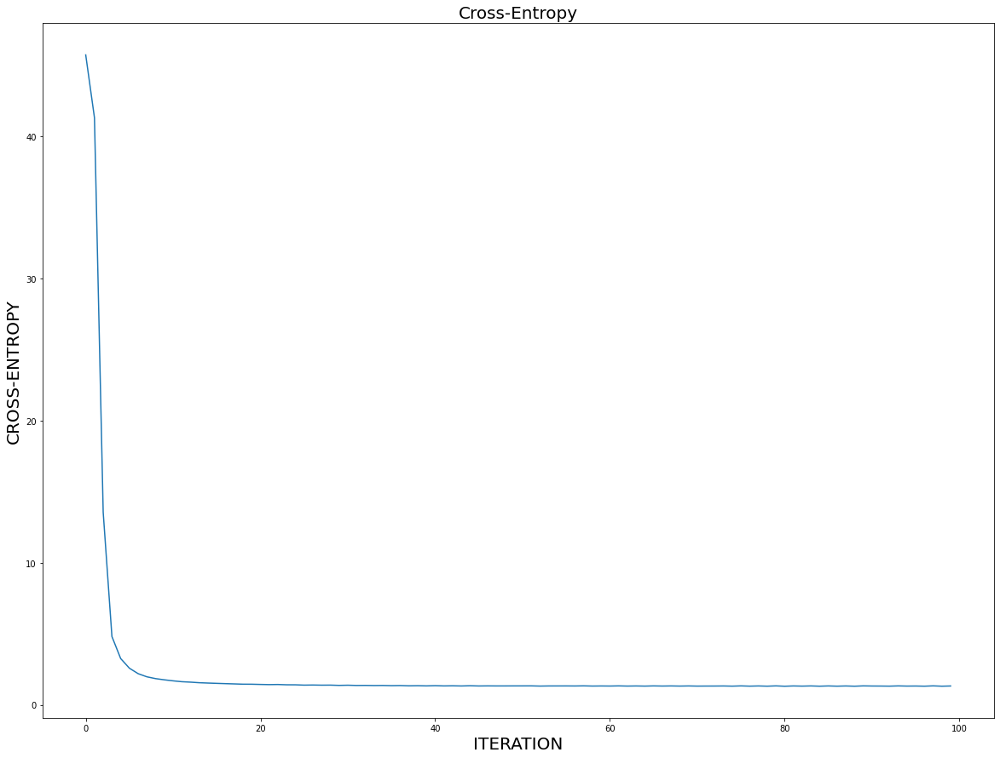

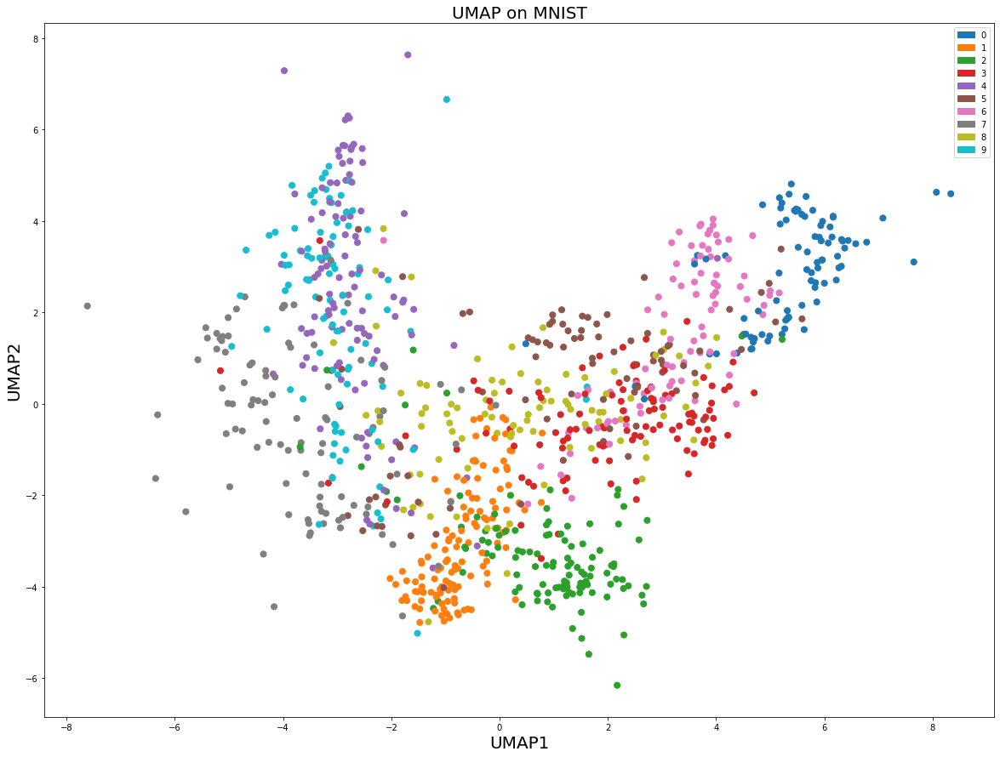


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 26.060929959659415 after 0 iterations
Cross-Entropy = 3.87933400531858 after 10 iterations
Cross-Entropy = 2.303810654794459 after 20 iterations
Cross-Entropy = 1.3714618412609845 after 30 iterations
Cross-Entropy = 1.033559372110451 after 40 iterations
Cross-Entropy = 0.8621539722293866 after 50 iterations
Cross-Entropy = 0.7996671432396496 after 60 iterations
Cross-Entropy = 0.7792514151786724 after 70 iterations
Cross-Entropy

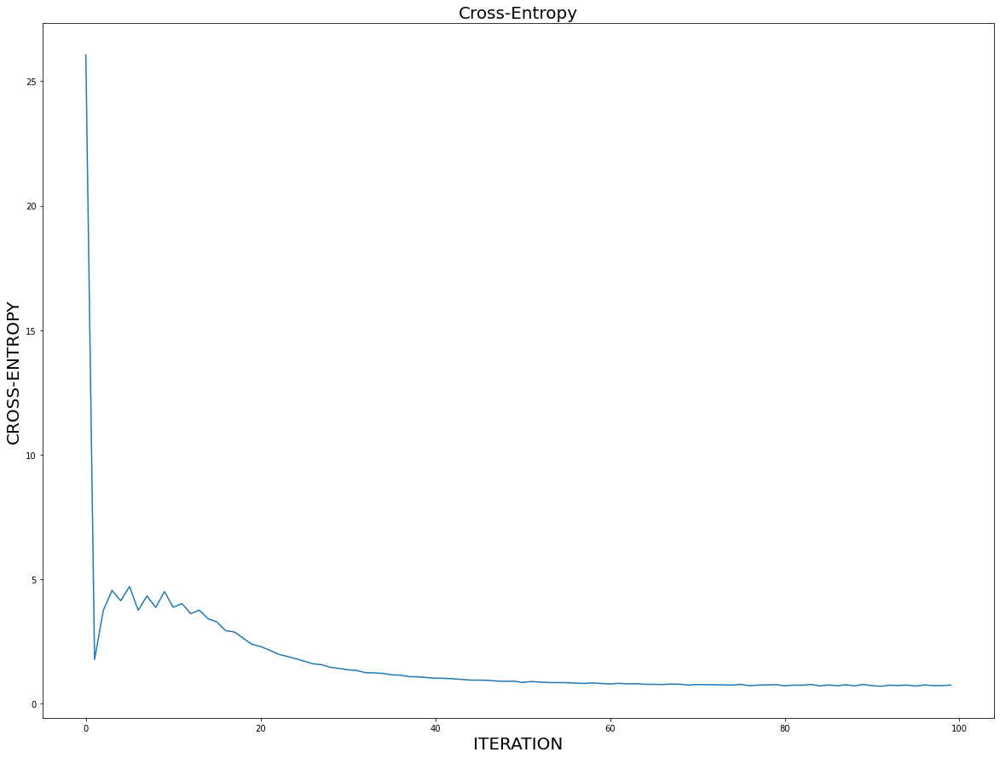

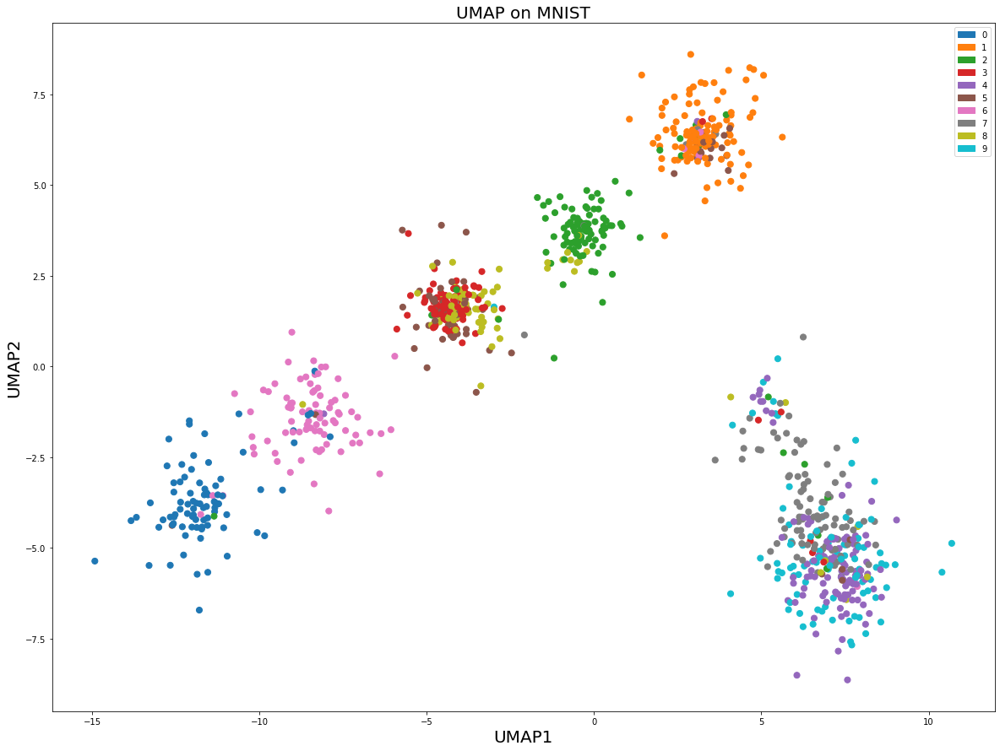


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 31.076515059696646 after 0 iterations
Cross-Entropy = 6.041168138138583 after 10 iterations
Cross-Entropy = 2.995142461881091 after 20 iterations
Cross-Entropy = 1.7646364168913657 after 30 iterations
Cross-Entropy = 1.2924774556588459 after 40 iterations
Cross-Entropy = 1.1187230366832892 after 50 iterations
Cross-Entropy = 0.9603960744507083 after 60 iterations
Cross-Entropy = 0.9203458891032115 after 70 iterations
Cross-Entro

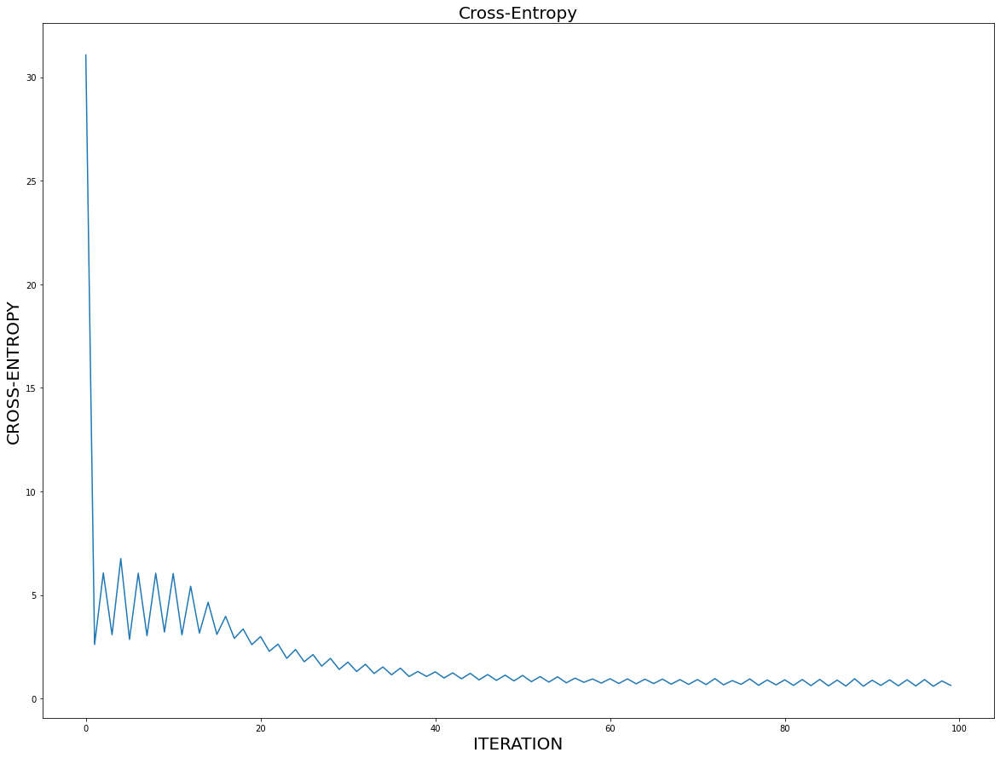

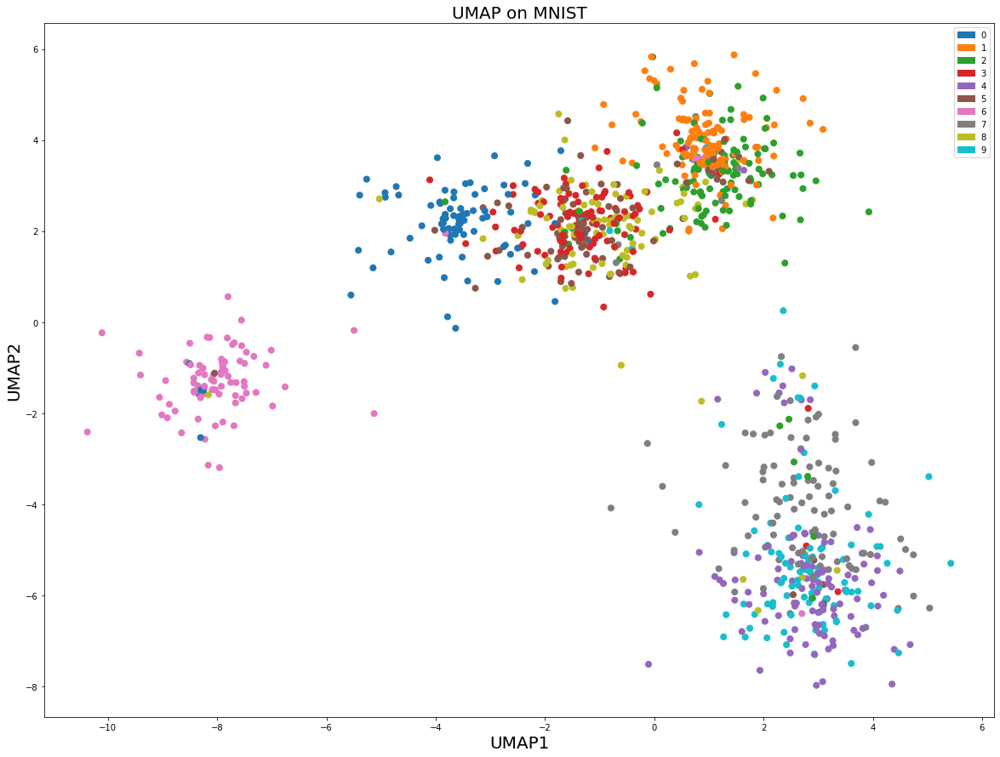


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 35.85420878578079 after 0 iterations
Cross-Entropy = 5.381766644163614 after 10 iterations
Cross-Entropy = 3.0668052447616745 after 20 iterations
Cross-Entropy = 1.6111652219571868 after 30 iterations
Cross-Entropy = 1.1531154051838417 after 40 iterations
Cross-Entropy = 0.9467442563893838 after 50 iterations
Cross-Entropy = 0.8194674496443116 after 60 iterations
Cross-Entropy = 0.7698535856853483 after 70 iterations
Cross-Entro

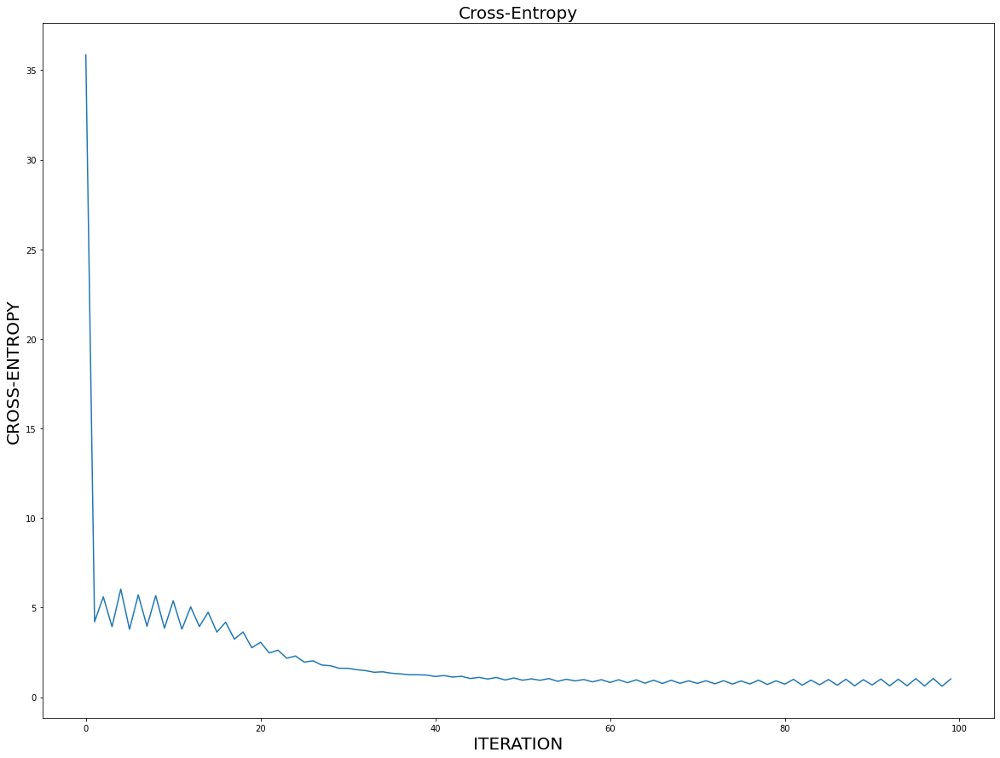

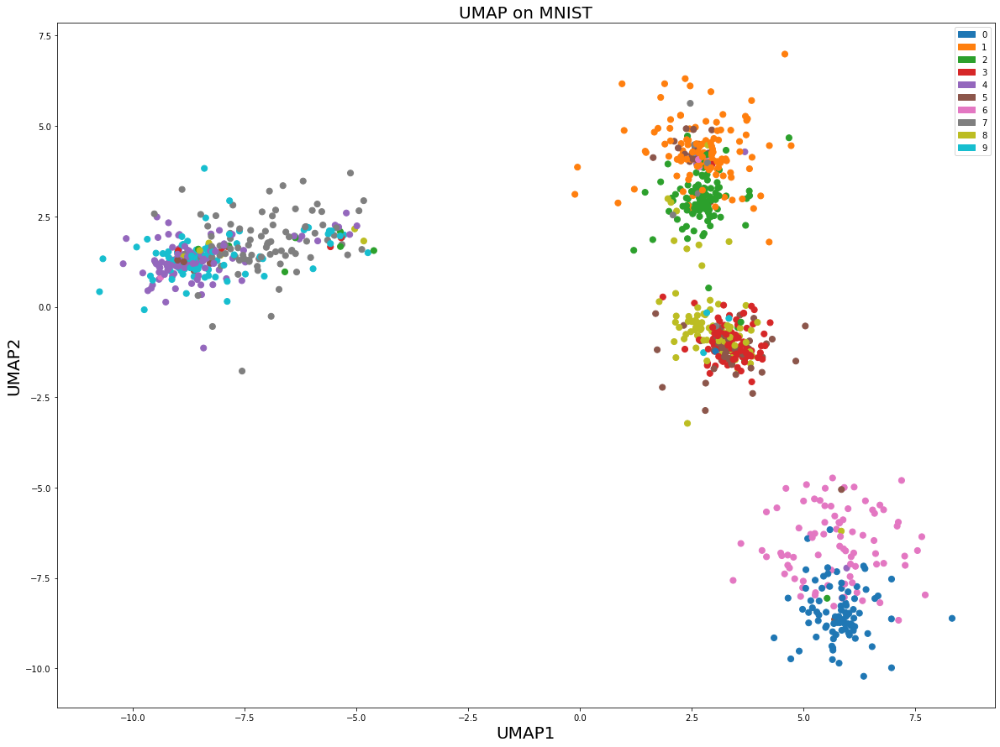


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 27.95301439655438 after 0 iterations
Cross-Entropy = 4.589370419181443 after 10 iterations
Cross-Entropy = 2.359117532642014 after 20 iterations
Cross-Entropy = 1.4515245799338952 after 30 iterations
Cross-Entropy = 1.1527086263012198 after 40 iterations
Cross-Entropy = 1.0374637952051073 after 50 iterations
Cross-Entropy = 0.9454865103997355 after 60 iterations
Cross-Entropy = 0.8926963775730974 after 70 iterations
Cross-Entrop

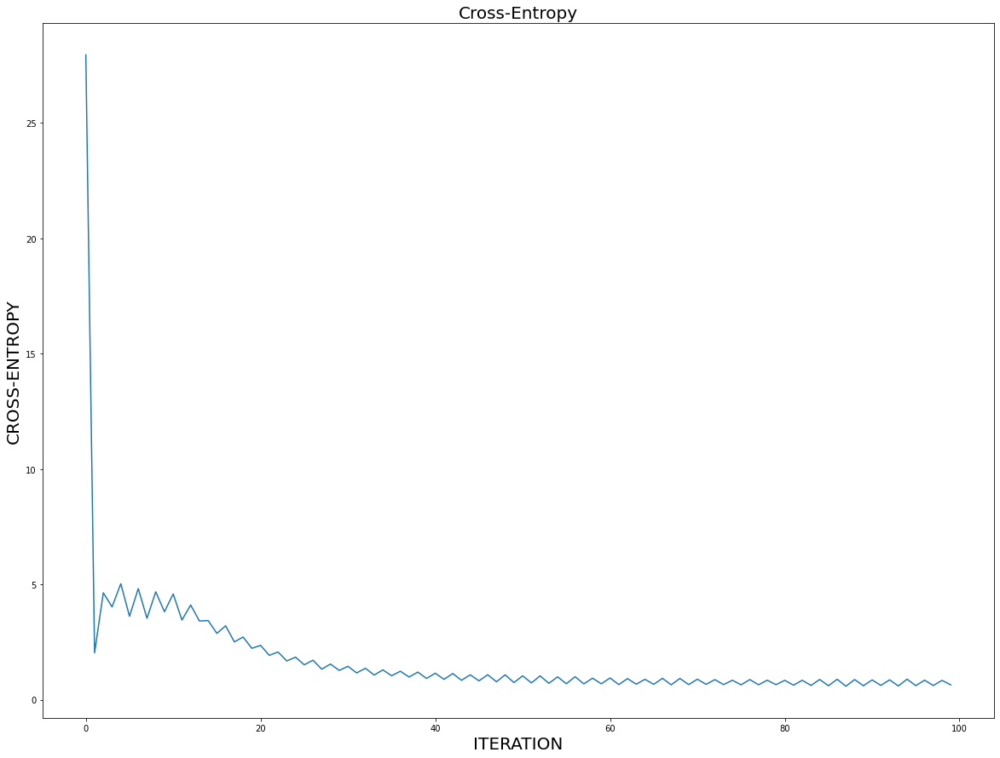

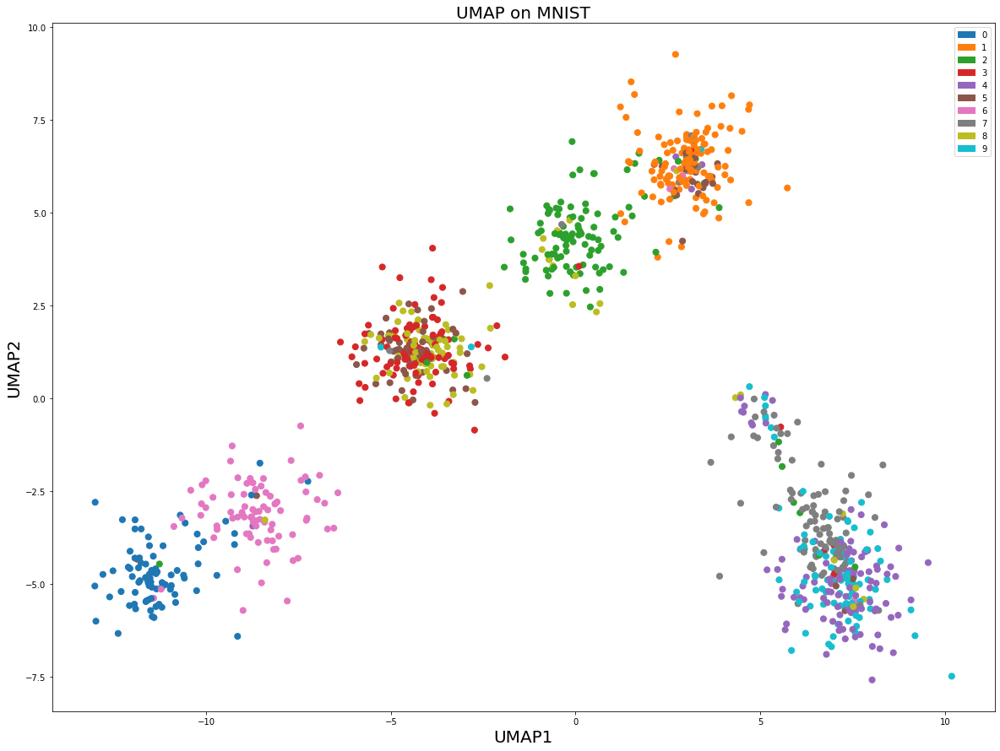


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 41.78045463691146 after 0 iterations
Cross-Entropy = 4.0620299412196195 after 10 iterations
Cross-Entropy = 1.8870311578605894 after 20 iterations
Cross-Entropy = 1.4220042965815565 after 30 iterations
Cross-Entropy = 1.206872418221693 after 40 iterations
Cross-Entropy = 1.1096323180111922 after 50 iterations
Cross-Entropy = 1.0515107266853954 after 60 iterations
Cross-Entropy = 1.081351113222791 after 70 iterations
Cross-Entrop

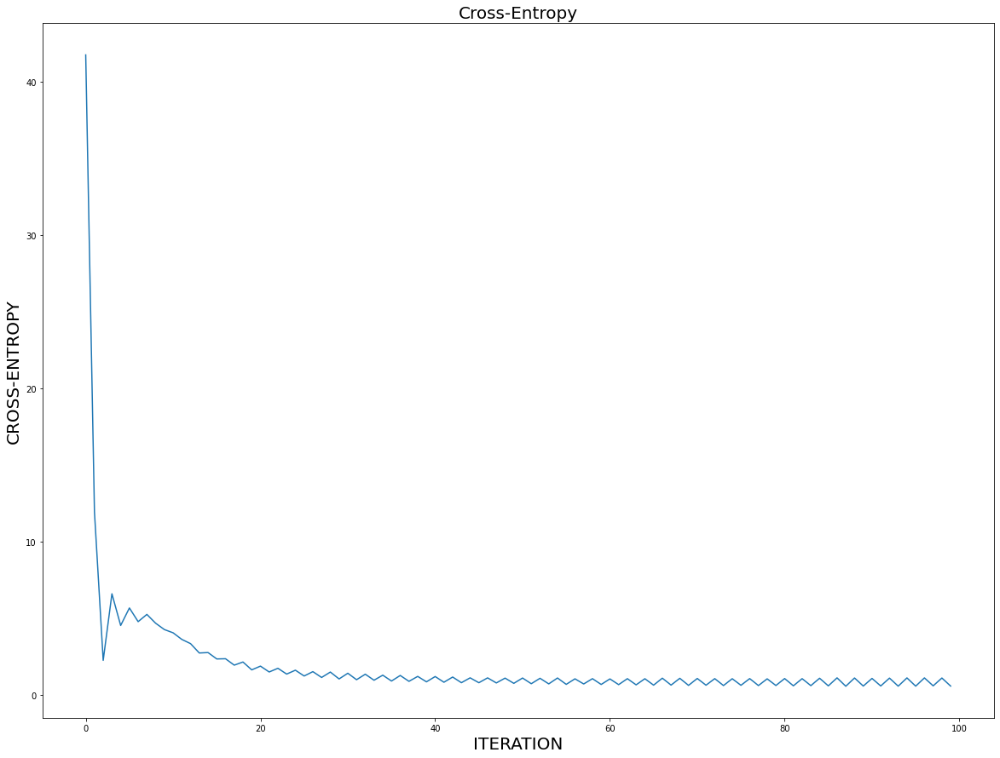

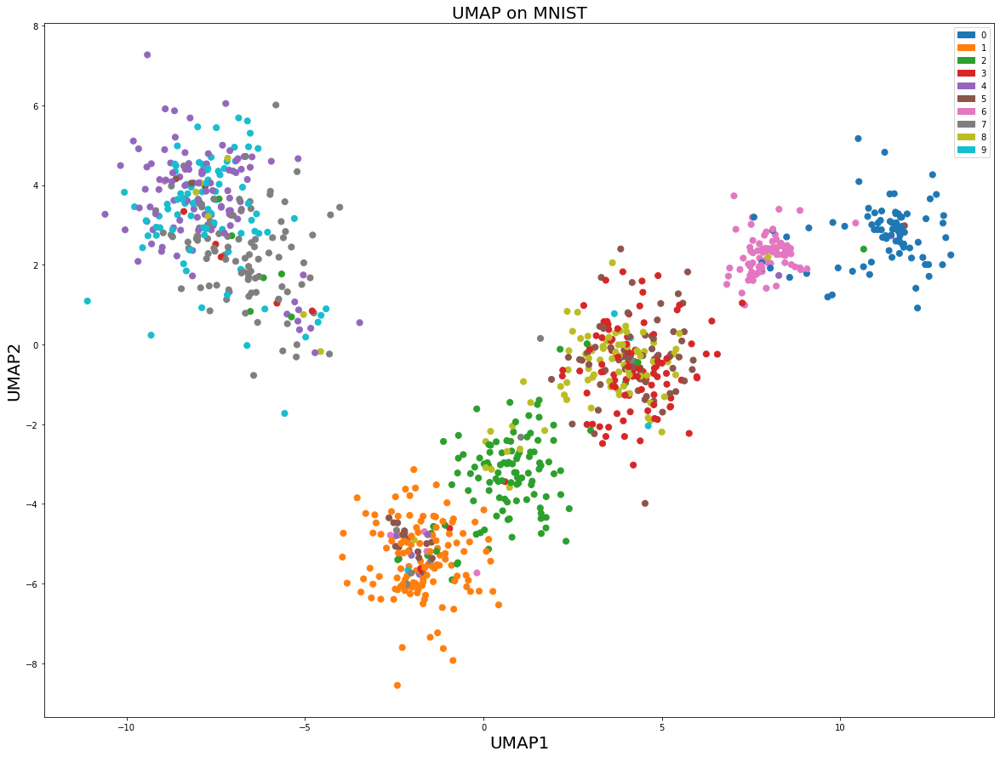


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 45.30339123272742 after 0 iterations
Cross-Entropy = 1.6656057229065846 after 10 iterations
Cross-Entropy = 1.1345985566574117 after 20 iterations
Cross-Entropy = 1.0584232130242976 after 30 iterations
Cross-Entropy = 1.0229564107620508 after 40 iterations
Cross-Entropy = 0.9714245996001091 after 50 iterations
Cross-Entropy = 0.9365422289792911 after 60 iterations
Cross-Entropy = 0.9041633435221184 after 70 iterations
Cross-Entr

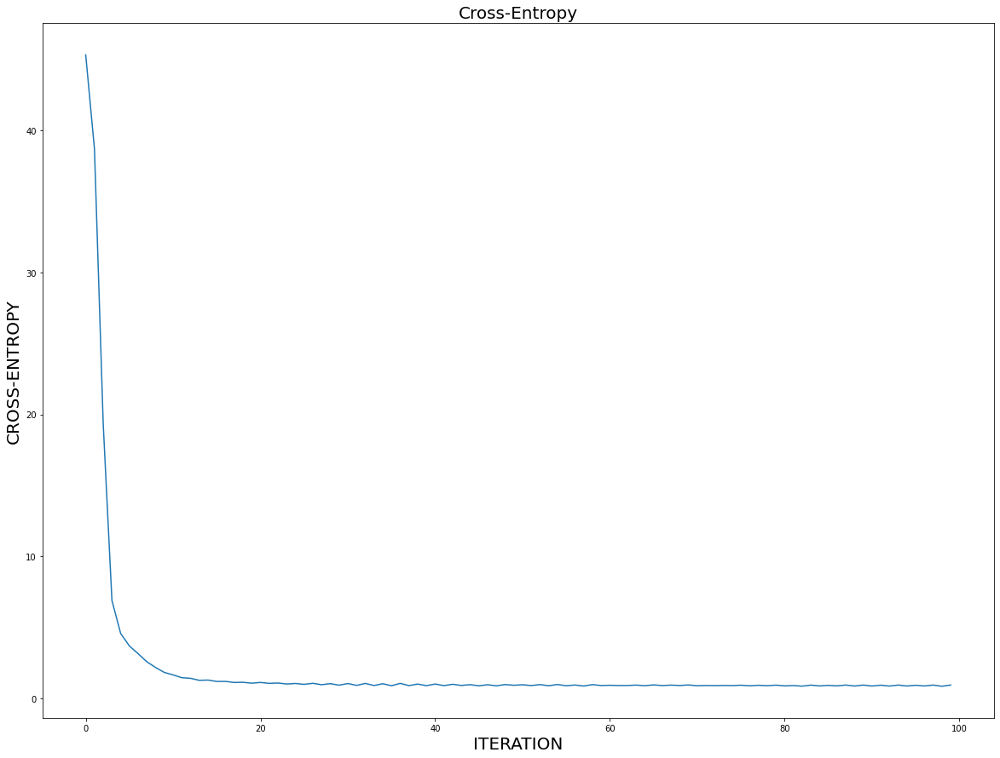

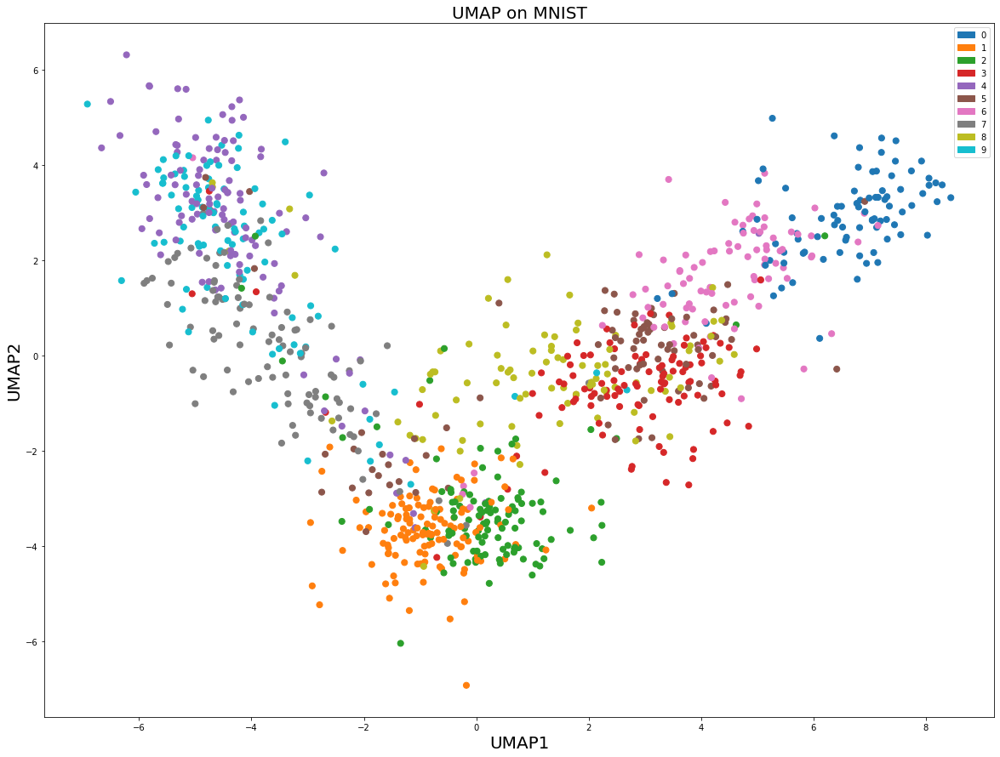


This data set contains 999 samples

Dimensions of the  data set: 
(999, 784)
Sigma binary search finished 100 of 999 cells
Sigma binary search finished 200 of 999 cells
Sigma binary search finished 300 of 999 cells
Sigma binary search finished 400 of 999 cells
Sigma binary search finished 500 of 999 cells
Sigma binary search finished 600 of 999 cells
Sigma binary search finished 700 of 999 cells
Sigma binary search finished 800 of 999 cells
Sigma binary search finished 900 of 999 cells

Mean sigma = 198.4153323703342
Running Gradient Descent: 

Cross-Entropy = 45.74660005761142 after 0 iterations
Cross-Entropy = 1.7302792873302772 after 10 iterations
Cross-Entropy = 1.4730853315040966 after 20 iterations
Cross-Entropy = 1.4205440021436069 after 30 iterations
Cross-Entropy = 1.396591209911559 after 40 iterations
Cross-Entropy = 1.3712425071692655 after 50 iterations
Cross-Entropy = 1.3737099098388434 after 60 iterations
Cross-Entropy = 1.3709933788480957 after 70 iterations
Cross-Entro

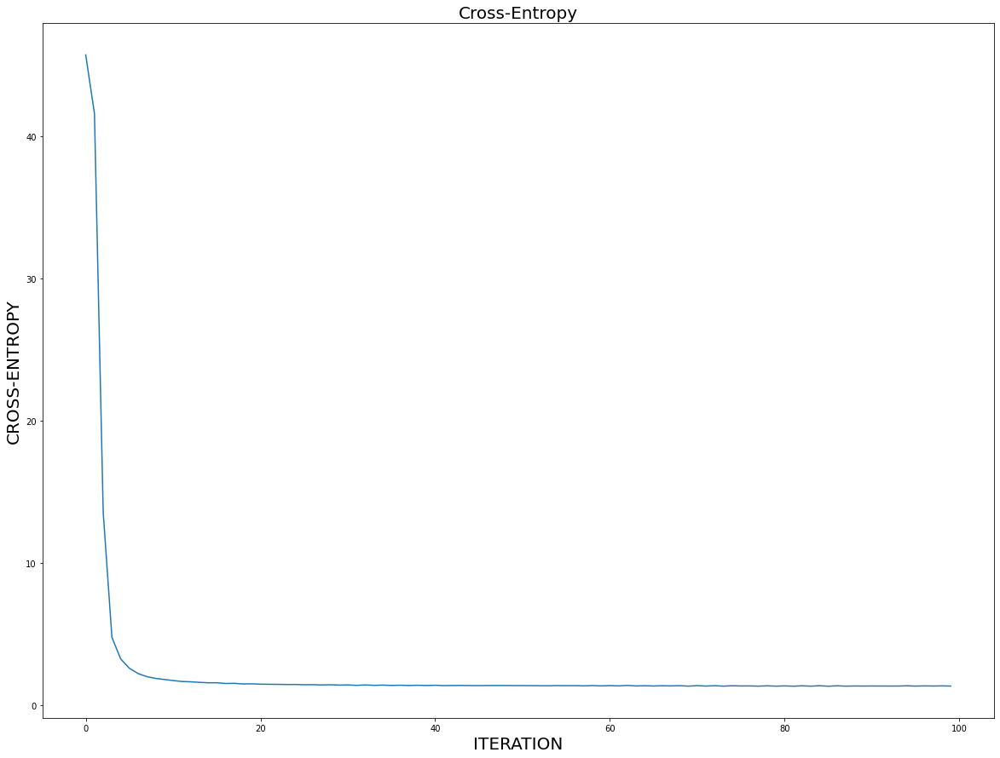

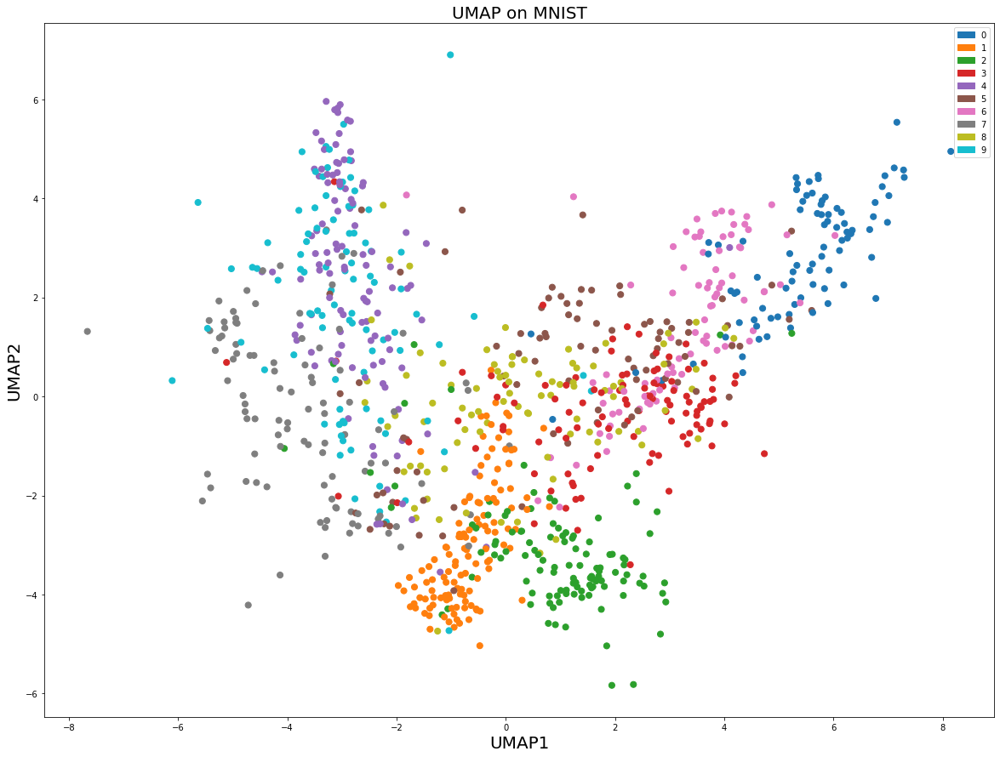

In [58]:
def Launch_UMAP(nOfNeighbours,minDistance,path):
    expr = pd.read_csv(path, sep=',')
    y_train = expr.values[:,0] # Les Labels (pour les couleurs du plot)
    X_train = expr.values[:,1:] # Les Coordonnées dans l'espace à 784 dimensions
    X_train = np.log(X_train + 1)
    n = X_train.shape[0] # Nombre d'échantillons
    print("\nThis data set contains " + str(n) + " samples")
    print("\nDimensions of the  data set: ")
    print(X_train.shape)
    dist = np.square(euclidean_distances(X_train,X_train)) #Matrice des distances euclidiennes des échantillons
    rho=[sorted(dist[i])[1] for i in range(len(dist))] #Pour chaque échantillon on prend le voisin le plus proche
    UMAP_func(nOfNeighbours,X_train, y_train, n, dist, rho,minDistance)

for nbOfNeighbours in range (1,20):
    for minDistance in [0.001,0.025,0.05,0.01,0.1,0.5,1]:
        Launch_UMAP(nbOfNeighbours,minDistance,'MNIST.csv')
